# RUNNING ENTIRE CODE BLOCKS ON NEW NOTEBOOK FOR SAKE OF CLARITY

# Creating Numbers/images with AI: A Hands-on Diffusion Model Exercise

## Introduction
In this assignment, you'll learn how to create an AI model that can generate realistic images from scratch using a powerful technique called 'diffusion'. Think of it like teaching AI to draw by first learning how images get blurry and then learning to make them clear again.

### What We'll Build
- A diffusion model capable of generating realistic images
- For most students: An AI that generates handwritten digits (0-9) using the MNIST dataset
- For students with more computational resources: Options to work with more complex datasets
- Visual demonstrations of how random noise gradually transforms into clear, recognizable images
- By the end, your AI should create images realistic enough for another AI to recognize them

### Dataset Options
This lab offers flexibility based on your available computational resources:

- Standard Option (Free Colab): We'll primarily use the MNIST handwritten digit dataset, which works well with limited GPU memory and completes training in a reasonable time frame. Most examples and code in this notebook are optimized for MNIST.

- Advanced Option: If you have access to more powerful GPUs (either through Colab Pro/Pro+ or your own hardware), you can experiment with more complex datasets like Fashion-MNIST, CIFAR-10, or even face generation. You'll need to adapt the model architecture, hyperparameters, and evaluation metrics accordingly.

### Resource Requirements
- Basic MNIST: Works with free Colab GPUs (2-4GB VRAM), ~30 minutes training
- Fashion-MNIST: Similar requirements to MNIST
CIFAR-10: Requires more memory (8-12GB VRAM) and longer training (~2 hours)
- Higher resolution images: Requires substantial GPU resources and several hours of training

### Before You Start
1. Make sure you're running this in Google Colab or another environment with GPU access
2. Go to 'Runtime' → 'Change runtime type' and select 'GPU' as your hardware accelerator
3. Each code cell has comments explaining what it does
4. Don't worry if you don't understand every detail - focus on the big picture!
5. If working with larger datasets, monitor your GPU memory usage carefully

The concepts you learn with MNIST will scale to more complex datasets, so even if you're using the basic option, you'll gain valuable knowledge about generative AI that applies to more advanced applications.



## Step 1: Setting Up Our Tools
First, let's install and import all the tools we need. Run this cell and wait for it to complete.

In [ ]:
# Step 1: Install required packages
%pip install einops
print("Package installation complete.")

# Step 2: Import libraries
# --- Core PyTorch libraries ---
import torch  # Main deep learning framework
import torch.nn.functional as F  # Neural network functions like activation functions
import torch.nn as nn  # Neural network building blocks (layers)
from torch.optim import Adam  # Optimization algorithm for training

# --- Data handling ---
from torch.utils.data import Dataset, DataLoader  # For organizing and loading our data
import torchvision  # Library for computer vision datasets and models
import torchvision.transforms as transforms  # For preprocessing images

# --- Tensor manipulation ---
import random  # For random operations
from einops.layers.torch import Rearrange  # For reshaping tensors in neural networks
from einops import rearrange  # For elegant tensor reshaping operations
import numpy as np  # For numerical operations on arrays

# --- System utilities ---
import os  # For operating system interactions (used for CPU count)

# --- Visualization tools ---
import matplotlib.pyplot as plt  # For plotting images and graphs
from PIL import Image  # For image processing
from torchvision.utils import save_image, make_grid  # For saving and displaying image grids

# Step 3: Set up device (GPU or CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"We'll be using: {device}")

# Check if we're actually using GPU (for students to verify)
if device.type == "cuda":
    print(f"GPU name: {torch.cuda.get_device_name(0)}")
    print(f"GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
else:
    print("Note: Training will be much slower on CPU. Consider using Google Colab with GPU enabled.")

Package installation complete.
We'll be using: cuda
GPU name: NVIDIA A100-SXM4-40GB
GPU memory: 42.47 GB



###  REPRODUCIBILITY AND DEVICE SETUP

In [ ]:
# Step 4: Set random seeds for reproducibility
# Diffusion models are sensitive to initialization, so reproducible results help with debugging
SEED = 42  # Universal seed value for reproducibility
torch.manual_seed(SEED)          # PyTorch random number generator
np.random.seed(SEED)             # NumPy random number generator
random.seed(SEED)                # Python's built-in random number generator

print(f"Random seeds set to {SEED} for reproducible results")

# Configure CUDA for GPU operations if available
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)       # GPU random number generator
    torch.cuda.manual_seed_all(SEED)   # All GPUs random number generator

    # Ensure deterministic GPU operations
    # Note: This slightly reduces performance but ensures results are reproducible
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

    try:
        # Check available GPU memory
        gpu_memory = torch.cuda.get_device_properties(0).total_memory / 1e9  # Convert to GB
        print(f"Available GPU Memory: {gpu_memory:.1f} GB")

        # Add recommendation based on memory
        if gpu_memory < 4:
            print("Warning: Low GPU memory. Consider reducing batch size if you encounter OOM errors.")
    except Exception as e:
        print(f"Could not check GPU memory: {e}")
else:
    print("No GPU detected. Training will be much slower on CPU.")
    print("If you're using Colab, go to Runtime > Change runtime type and select GPU.")

Random seeds set to 42 for reproducible results
Available GPU Memory: 42.5 GB


## Step 2: Choosing Your Dataset

You have several options for this exercise, depending on your computer's capabilities:

### Option 1: MNIST (Basic - Works on Free Colab)
- Content: Handwritten digits (0-9)
- Image size: 28x28 pixels, Grayscale
- Training samples: 60,000
- Memory needed: ~2GB GPU
- Training time: ~15-30 minutes on Colab
- **Choose this if**: You're using free Colab or have a basic GPU

### Option 2: Fashion-MNIST (Intermediate)
- Content: Clothing items (shirts, shoes, etc.)
- Image size: 28x28 pixels, Grayscale
- Training samples: 60,000
- Memory needed: ~2GB GPU
- Training time: ~15-30 minutes on Colab
- **Choose this if**: You want more interesting images but have limited GPU

### Option 3: CIFAR-10 (Advanced)
- Content: Real-world objects (cars, animals, etc.)
- Image size: 32x32 pixels, Color (RGB)
- Training samples: 50,000
- Memory needed: ~4GB GPU
- Training time: ~1-2 hours on Colab
- **Choose this if**: You have Colab Pro or a good local GPU (8GB+ memory)

### Option 4: CelebA (Expert)
- Content: Celebrity face images
- Image size: 64x64 pixels, Color (RGB)
- Training samples: 200,000
- Memory needed: ~8GB GPU
- Training time: ~3-4 hours on Colab
- **Choose this if**: You have excellent GPU (12GB+ memory)

To use your chosen dataset, uncomment its section in the code below and make sure all others are commented out.

In [ ]:
# #===============================================================================
# # SECTION 2: DATASET SELECTION AND CONFIGURATION
# #===============================================================================
# # STUDENT INSTRUCTIONS:
# # 1. Choose ONE dataset option based on your available GPU memory
# # 2. Uncomment ONLY ONE dataset section below
# # 3. Make sure all other dataset sections remain commented out

# #-------------------------------------------
# # OPTION 1: MNIST (Basic - 2GB GPU)
# #-------------------------------------------
# # Recommended for: Free Colab or basic GPU
# # Memory needed: ~2GB GPU
# # Training time: ~15-30 minutes

# # IMG_SIZE = 28
# # IMG_CH = 1
# # N_CLASSES = 10
# # BATCH_SIZE = 64
# # EPOCHS = 30

# # transform = transforms.Compose([
# #     transforms.ToTensor(),
# #     transforms.Normalize((0.5,), (0.5,))
# # ])

# # Your code to load the MNIST dataset
# # Hint: Use torchvision.datasets.MNIST with root='./data', train=True,
# #       transform=transform, and download=True
# # Then print a success message

# # Enter your code here:


# #-------------------------------------------
# # OPTION 2: Fashion-MNIST (Intermediate - 2GB GPU)
# #-------------------------------------------
# # Uncomment this section to use Fashion-MNIST instead
# # """
IMG_SIZE = 28
IMG_CH = 1       # Fashion-MNIST is grayscale
N_CLASSES = 10
BATCH_SIZE = 128 # Can likely increase batch size on A100
EPOCHS = 30      # Should be enough for good results, adjust if needed

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)) # Normalize for 1 channel
])

# # # Your code to load the Fashion-MNIST dataset
# # # Hint: Very similar to MNIST but use torchvision.datasets.FashionMNIST

# # # Enter your code here:

# tell validator which dataset I'm using
dataset = "Fashion-MNIST"
# # -------------------------------------------
# # OPTION 3: CIFAR-10 (Advanced - 4GB+ GPU)
# # -------------------------------------------
# # Uncomment this section to use CIFAR-10 instead

# IMG_SIZE = 32
# IMG_CH = 3
# N_CLASSES = 10
# BATCH_SIZE = 32  # Reduced batch size for memory
# EPOCHS = 50      # More epochs for complex data

#obsolete - not correct only for resnet
# model = torchvision.models.resnet18(pretrained=True)
# model.fc = nn.Linear(512, N_CLASSES)

# Hint: Use transforms.Normalize with RGB means and stds ((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
# Then load torchvision.datasets.CIFAR10

# Enter your code here:
# import torchvision
# import torchvision.transforms as transforms
# from torch.utils.data import DataLoader

# transform = transforms.Compose([
#     transforms.ToTensor(),
#     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
# ])

### TRIED CELEBA - IT WAS A GPU WARZONE AND TOO MUCH ROOT PATH ERRORS :/

In [ ]:
# !pip install kaggle
# !mkdir -p ~/.kaggle
# !cp /content/drive/MyDrive/Colab\ Notebooks/kaggle.json ~/.kaggle/
# !chmod 600 ~/.kaggle/kaggle.json


In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')


In [ ]:
# # Define paths for specific folders including images and annotations
# PATH_ROOT = '/content/drive/MyDrive/CelebA'       # The main CelebA folder
# PATH_ANNO = f'{PATH_ROOT}/Anno'                  # Where annotation .txt files live
# PATH_EVAL = f'{PATH_ROOT}/Eval'                  # Where list_eval_partition.txt is
# PATH_IMG  = f'{PATH_ROOT}/Img'                   # Where img_align_celeba.zip is


In [ ]:
# !unzip "{PATH_IMG}/img_align_celeba.zip" -d /content/celeba_data


In [ ]:
# # Copy all annotation files
# !cp "{PATH_ANNO}"/* /content/celeba_data/
# # Copy the eval partition file
# !cp "{PATH_EVAL}/list_eval_partition.txt" /content/celeba_data/


In [ ]:
# !ls -lh /content/celeba_data
# !ls -lh /content/celeba_data/img_align_celeba | head -n 10


In [ ]:
# # # -------------------------------------------
# # # OPTION 4: CelebA Dataset (Expert - 8GB+ GPU)
# # # -------------------------------------------
# # # Uncomment this section to use CelebA instead(teehee sorry couldnt resist! :))

# #Imports again with shortened form
# import torchvision.datasets as datasets
# import torchvision.transforms as transforms
# from torch.utils.data import DataLoader



In [ ]:
# # Hyperparams
# IMG_SIZE = 224 #Using native ResNet model
# BATCH_SIZE = 64 #nuanced complex classiification model --> more epochs

# # Transform: Resize -> CenterCrop -> ToTensor -> Normalize
# transform = transforms.Compose([
#     transforms.Resize((IMG_SIZE, IMG_SIZE)),
#     transforms.ToTensor(),
#     transforms.Normalize((0.5, 0.5, 0.5),  # mean
#                          (0.5, 0.5, 0.5)) # std
# ])

In [ ]:
# #Root path
# celeba_root = '/content/celeba_data'  # Where I consolidated everything


In [ ]:
# # Load Test, Train, Val Split
# celeba_train = datasets.CelebA(
#     root=celeba_root,
#     split='train',
#     target_type='attr',   # load the 40 attribute labels
#     download=False,       # we already have data
#     transform=transform
# )

# celeba_val = datasets.CelebA(
#     root=celeba_root,
#     split='val',
#     target_type='attr',
#     download=False,
#     transform=transform
# )

# celeba_test = datasets.CelebA(
#     root=celeba_root,
#     split='test',
#     target_type='attr',
#     download=False,
#     transform=transform
# )


RuntimeError: Dataset not found or corrupted. You can use download=True to download it

In [ ]:
# !ls -l "$celeba_root"
# !ls -l "$celeba_root/img_align_celeba" | head -n 10


total 67924
-r-------- 1 root root  3424458 Apr 16 00:30 identity_CelebA.txt
drwxr-xr-x 2 root root  5967872 Sep 28  2015 img_align_celeba
-r-------- 1 root root 26721026 Apr 16 00:30 list_attr_celeba.txt
-r-------- 1 root root  6082035 Apr 16 00:30 list_bbox_celeba.txt
-r-------- 1 root root  2836386 Apr 16 00:31 list_eval_partition.txt
-r-------- 1 root root 12156055 Apr 16 00:31 list_landmarks_align_celeba.txt
-r-------- 1 root root 12352635 Apr 16 00:31 list_landmarks_celeba.txt
total 1737936
-rw-r--r-- 1 root root 11440 Sep 28  2015 000001.jpg
-rw-r--r-- 1 root root  7448 Sep 28  2015 000002.jpg
-rw-r--r-- 1 root root  4253 Sep 28  2015 000003.jpg
-rw-r--r-- 1 root root 10747 Sep 28  2015 000004.jpg
-rw-r--r-- 1 root root  6351 Sep 28  2015 000005.jpg
-rw-r--r-- 1 root root  8073 Sep 28  2015 000006.jpg
-rw-r--r-- 1 root root  8203 Sep 28  2015 000007.jpg
-rw-r--r-- 1 root root  7725 Sep 28  2015 000008.jpg
-rw-r--r-- 1 root root  8641 Sep 28  2015 000009.jpg


In [ ]:
# celeba_train = datasets.CelebA(
#     root=celeba_root,
#     split='train',
#     target_type='attr',  # loads 40 binary attributes
#     download=False,      # dataset is already present
#     transform=transform
# )

# train_loader = DataLoader(celeba_train, batch_size=64, shuffle=True, num_workers=2)
# print("Number of images in train set:", len(celeba_train))

RuntimeError: Dataset not found or corrupted. You can use download=True to download it

In [ ]:
# # -------------------------------------------
# # OPTION 4: CelebA Dataset (Expert - 8GB+ GPU)
# # -------------------------------------------
# # Uncomment this section to use CelebA instead(teehee sorry couldnt resist! :))

# # !pip install kaggle
# # !mkdir -p ~/.kaggle
# # !cp kaggle.json ~/.kaggle/
# # !chmod 600 ~/.kaggle/kaggle.json
# # !kaggle datasets download -d jessicali9530/celeba-dataset
# # !unzip /content/celeba-dataset.zip -d /content/celeba-dataset

# # Hyperparams
# IMG_SIZE = 224 #Using native ResNet model
# BATCH_SIZE = 64 #nuanced complex classiification model --> more epochs

# # Transform: Resize -> CenterCrop -> ToTensor -> Normalize
# transform = transforms.Compose([
#     transforms.Resize((IMG_SIZE, IMG_SIZE)),
#     transforms.ToTensor(),
#     transforms.Normalize((0.5, 0.5, 0.5),  # mean
#                          (0.5, 0.5, 0.5)) # std
# ])

# # Define the root where your CelebA folder is located in Drive
# celeba_root = '/content/drive/MyDrive/CelebA'

# # Load the CelebA dataset
# train_ds = torchvision.datasets.CelebA(
#     root=celeba_root,
#     split='train',
#     target_type='attr',
#     download=False,
#     transform=transform
# )

# val_ds = torchvision.datasets.CelebA(
#     root='./data',
#     split='valid',
#     target_type='attr',
#     download=False,
#     transform=transform
# )
# test_ds = torchvision.datasets.CelebA(
#     root='./data',
#     split='test',
#     target_type='attr',
#     download=False,
#     transform=transform
# )

# #Wrap em up w DataLoader
# train_load = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
# val_load = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)
# test_load = DataLoader(test_ds, batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

### Continuation

In [ ]:
#Validating Dataset Selection
#Let's add code to validate that a dataset was selected
# and check if your GPU has enough memory:

# Validate dataset selection
if 'dataset' not in locals():
    raise ValueError("""
    ❌ ERROR: No dataset selected! Please uncomment exactly one dataset option.
    Available options:
    1. MNIST (Basic) - 2GB GPU
    2. Fashion-MNIST (Intermediate) - 2GB GPU
    3. CIFAR-10 (Advanced) - 4GB+ GPU
    4. CelebA (Expert) - 8GB+ GPU
    """)

# Your code to validate GPU memory requirements
# Hint: Check torch.cuda.is_available() and use torch.cuda.get_device_properties(0).total_memory
# to get available GPU memory, then compare with dataset requirements

# Enter your code here:
# tell validator which dataset I'm using

In [ ]:
#Dataset Properties and Data Loaders
#Now let's examine our dataset
#and set up the data loaders:

#Loading Dataset - MODIFIED FOR FASHION-MNIST
train_ds = torchvision.datasets.FashionMNIST(root='./data', train=True, download=True, transform=transform)
val_ds = torchvision.datasets.FashionMNIST(root='./data', train=False, download=True, transform=transform) # Use test set as validation data

#Wrapping into loaderr repollaced by split logic below

# #Wrapping into Loader
# train_load = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
# val_load = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False)

# Your code to check sample batch properties
# Hint: Get a sample batch using next(iter(DataLoader(dataset, batch_size=1)))
# Then print information about the dataset shape, type, and value ranges

# Enter your code here:

# ==== SAMPLE BATCH INSPECTION ====
# images, labels = next(iter(train_load))
# print(f"Images → shape: {images.shape}, dtype: {images.dtype}, range: [{images.min():.2f}, {images.max():.2f}]")
# print(f"Labels → shape: {labels.shape}, unique: {labels.unique().tolist()}")
#===============================================================================
# SECTION 3: DATASET SPLITTING AND DATALOADER CONFIGURATION
#===============================================================================
# Create train-validation split

# Your code to create a train-validation split (80% train, 20% validation)
# Hint: Use random_split() with appropriate train_size and val_size
# Be sure to use a fixed generator for reproducibility

# Enter your code here:
from torch.utils.data import random_split

# Define sizes for 80/20 split of the original training set
train_size = int(0.8 * len(train_ds))
val_size = len(train_ds) - train_size

# Set generator for reproducibility
generator = torch.Generator().manual_seed(SEED) # Use SEED from Cell 5

# Perform the split
train_split, val_split = random_split(train_ds, [train_size, val_size], generator=generator)


# Your code to create dataloaders for training and validation
# Hint: Use DataLoader with batch_size=BATCH_SIZE, appropriate shuffle settings,
# and num_workers based on available CPU cores

# Enter your code here:
# Create loaders for the split datasets
train_load = DataLoader(train_split, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
val_load   = DataLoader(val_split,   batch_size=BATCH_SIZE, shuffle=False, num_workers=2)

# Quick confirmation
print(f"Training set size: {len(train_load.dataset)}")
print(f"Validation set size: {len(val_load.dataset)}")

# ==== SAMPLE BATCH INSPECTION (Optional) ====
try:
    images, labels = next(iter(train_load))
    print(f"Images → shape: {images.shape}, dtype: {images.dtype}, range: [{images.min():.2f}, {images.max():.2f}]")
    print(f"Labels → shape: {labels.shape}, unique: {labels.unique().tolist()}")
    # show_noise_progression(images[0].to(device)) # Requires show_noise_progression defined
except Exception as e:
    print(f"Could not inspect batch: {e}")


100%|██████████| 26.4M/26.4M [00:02<00:00, 10.4MB/s]
100%|██████████| 29.5k/29.5k [00:00<00:00, 178kB/s]
100%|██████████| 4.42M/4.42M [00:01<00:00, 3.26MB/s]
100%|██████████| 5.15k/5.15k [00:00<00:00, 15.6MB/s]

Training set size: 48000
Validation set size: 12000


Images → shape: torch.Size([128, 1, 28, 28]), dtype: torch.float32, range: [-1.00, 1.00]
Labels → shape: torch.Size([128]), unique: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]


## Step 3: Building Our Model Components

Now we'll create the building blocks of our AI model. Think of these like LEGO pieces that we'll put together to make our number generator:

- GELUConvBlock: The basic building block that processes images
- DownBlock: Makes images smaller while finding important features
- UpBlock: Makes images bigger again while keeping the important features
- Other blocks: Help the model understand time and what number to generate

In [ ]:
# Basic building block that processes images
class GELUConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch, group_size):
        """
        Creates a block with convolution, normalization, and activation

        Args:
            in_ch (int): Number of input channels
            out_ch (int): Number of output channels
            group_size (int): Number of groups for GroupNorm
        """
        super().__init__()

        # Check that group_size is compatible with out_ch - ensures out_ch is divisible by group size for GroupName
        if out_ch % group_size != 0:
            print(f"Warning: out_ch ({out_ch}) is not divisible by group_size ({group_size})")
            # Adjust group_size to be compatible
            group_size = min(group_size, out_ch)
            while out_ch % group_size != 0:
                group_size -= 1
            print(f"Adjusted group_size to {group_size}")

        # Your code to create layers for the block
        # Hint: Use nn.Conv2d, nn.GroupNorm, and nn.GELU activation
        # Then combine them using nn.Sequential

        # Enter your code here:

        self.block = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=3, padding=1), #keep spatial dims
            nn.GroupNorm(group_size, out_ch), #normalize across channel groups
            nn.GELU() #smoother activation for diffusion
        )

    def forward(self, x):
        # Your code for the forward pass
        # Hint: Simply pass the input through the model


        # Enter your code here:
        return self.block(x)

In [ ]:
# Rearranges pixels to downsample the image (2x reduction in spatial dimensions)
class RearrangePoolBlock(nn.Module):
    def __init__(self, in_chs, group_size):
        """
        Downsamples the spatial dimensions by 2x while preserving information

        Args:
            in_chs (int): Number of input channels
            group_size (int): Number of groups for GroupNorm
        """
        super().__init__()

        # Your code to create the rearrange operation and convolution
        # Hint: Use Rearrange from einops.layers.torch to reshape pixels
        # Then add a GELUConvBlock to process the rearranged tensor

        # Enter your code here:
        self.rearrange = Rearrange('b c (h ph) (w pw) -> b (c ph pw) h w', ph=2, pw=2)
        self.conv = GELUConvBlock(in_chs * 4, in_chs, group_size)

    def forward(self, x):
        # Your code for the forward pass
        # Hint: Apply rearrange to downsample, then apply convolution
        # Enter your code here:
        x = self.rearrange(x)
        x = self.conv(x)
        return x

In [ ]:
#Let's implement the upsampling block for our U-Net architecture:
class DownBlock(nn.Module):
    """
    Downsampling block for encoding path in U-Net architecture.

    This block:
    1. Processes input features with two convolutional blocks
    2. Downsamples spatial dimensions by 2x using pixel rearrangement

    Args:
        in_chs (int): Number of input channels
        out_chs (int): Number of output channels
        group_size (int): Number of groups for GroupNorm
    """
    def __init__(self, in_chs, out_chs, group_size):
        super().__init__()  # Simplified super() call, equivalent to original

        # ── TWO SEQUENTIAL CONV BLOCKS ────────────────────────────────────────────────
        # We break these out into self.conv1 and self.conv2 so we can capture a 'skip'
        # tensor *between* them and the pooling step. If you leave them in a Sequential
        # container, you can still do skip = x before pooling, but it's much less explicit.
        self.conv1 = GELUConvBlock(in_chs, out_chs, group_size)
        self.conv2 = GELUConvBlock(out_chs, out_chs, group_size)

        # ── DOWNSAMPLE VIA PIXEL-REARRANGE ────────────────────────────────────────────
        # This halves H/W and keeps channel count at out_chs.
        self.pool = RearrangePoolBlock(out_chs, group_size)


        # Log the configuration for debugging
        print(f"Created DownBlock: in_chs={in_chs}, out_chs={out_chs}, spatial_reduction=2x")

    def forward(self, x):
        """
        Forward pass through the DownBlock.

        Args:
            x (torch.Tensor): Input tensor of shape [B, in_chs, H, W]

        Returns:
            torch.Tensor: Output tensor of shape [B, out_chs, H/2, W/2] and skip connection for UpBlock [B, out_chs, H, W]
        """
        # 1) Extract features
        x = self.conv1(x)
        x = self.conv2(x)

        # 2) Tricky part - save skip after conv2, before pooling
        # This is quintessential as it is what a U-Net needs to concatenate back on the upward pathway
        skip = x

        # 3) Downsample for next layer
        x = self.pool(x)

        # 4) Return both the downsampled tensor and skip connection
        return x, skip

In [ ]:
#Now let's implement the upsampling block for our U-Net architecture:
class UpBlock(nn.Module):
    """
    Upsampling block for decoding path in U-Net architecture.

    This block:
    1. Takes features from the decoding path and corresponding skip connection
    2. Concatenates them along the channel dimension
    3. Upsamples spatial dimensions by 2x using transposed convolution
    4. Processes features through multiple convolutional blocks

    Args:
        in_chs (int): Number of input channels from the previous layer
        out_chs (int): Number of output channels
        group_size (int): Number of groups for GroupNorm
    """
    def __init__(self, in_chs, out_chs, group_size):
        super().__init__()

        # Your code to create the upsampling operation
        # Hint: Use nn.ConvTranspose2d with kernel_size=2 and stride=2
        # Note that the input channels will be 2 * in_chs due to concatenation

        # Enter your code here:

        # ── TRANSPOSED CONV FOR UPSAMPLING ────────────────────────────────────────────
        # Upsamples H/W by 2. Note that it only changes *spatial* dims, not channels.
        self.upconv = nn.ConvTranspose2d(in_chs, out_chs, kernel_size=2, stride=2)

        # Your code to create the convolutional blocks
        # Hint: Use multiple GELUConvBlocks in sequence

        # Enter your code here:

        # 2) after upconv and concat, channels = out_chs + skip_chs (== in_chs)
        # so conv1 must accept in_chs + out_chs, not 2*out_chs
        self.conv1 = GELUConvBlock(in_chs + out_chs, out_chs, group_size)
        self.conv2 = GELUConvBlock(out_chs, out_chs, group_size)

        # Log the configuration for debugging
        print(f"Created UpBlock: in_chs={in_chs}, out_chs={out_chs}, spatial_increase=2x")

    def forward(self, x, skip):
        """
        Forward pass through the UpBlock.

        Args:
            x (torch.Tensor): Input tensor from previous layer [B, in_chs, H, W]
            skip (torch.Tensor): Skip connection tensor from encoder [B, in_chs, 2H, 2W]

        Returns:
            torch.Tensor: Output tensor with shape [B, out_chs, 2H, 2W]
        """
        # Your code for the forward pass
        # Hint: Concatenate x and skip, then upsample and process

        # Enter your code here:

        # 1) Upsample spatially
        x = self.upconv(x)

        # 2) Concat skip connection (from encoder) along channel dimension
        x = torch.cat([x, skip], dim=1)

        # 3) Process the merged features
        x = self.conv1(x)
        x = self.conv2(x)

        return x


In [ ]:
# Here we implement the time embedding block for our U-Net architecture:
# Helps the model understand time steps in diffusion process
class SinusoidalPositionEmbedBlock(nn.Module):
    """
    Creates sinusoidal embeddings for time steps in diffusion process.

    This embedding scheme is adapted from the Transformer architecture and
    provides a unique representation for each time step that preserves
    relative distance information.

    Args:
        dim (int): Embedding dimension
    """
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        """
        Computes sinusoidal embeddings for given time steps.

        Args:
            time (torch.Tensor): Time steps tensor of shape [batch_size]

        Returns:
            torch.Tensor: Time embeddings of shape [batch_size, dim]
        """
        device = time.device
        half_dim = self.dim // 2
        embeddings = torch.log(torch.tensor(10000.0, device=device)) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings



In [ ]:
# Helps the model understand which number/image to draw (class conditioning)
class EmbedBlock(nn.Module):
    """
    Creates embeddings for class conditioning in diffusion models.

    This module transforms a one-hot or index representation of a class
    into a rich embedding that can be added to feature maps.

    Args:
        input_dim (int): Input dimension (typically number of classes)
        emb_dim (int): Output embedding dimension
    """
    def __init__(self, input_dim, emb_dim):
        super(EmbedBlock, self).__init__()
        self.input_dim = input_dim

        # Your code to create the embedding layers
        # Hint: Use nn.Linear layers with a GELU activation, followed by
        # nn.Unflatten to reshape for broadcasting with feature maps

        # Enter your code here:
        self.emb_dim = emb_dim

        # 1) Project one‑hot (or equivalent) into a hidden space
        # 2) Non‑linear activation
        # 3) Project down (or up) to emb_dim
        # 4) Unflatten so output is [B, emb_dim, 1, 1]
        self.model = nn.Sequential(
            nn.Linear(input_dim, emb_dim),
            nn.GELU(),
            nn.Linear(emb_dim, emb_dim),
            nn.Unflatten(1, (emb_dim, 1, 1))
        )

    def forward(self, x):
        """
        Computes class embeddings for the given class indices.

        Args:
            x (torch.Tensor): Class indices or one-hot encodings [batch_size, input_dim]

        Returns:
            torch.Tensor: Class embeddings of shape [batch_size, emb_dim, 1, 1]
                          (ready to be added to feature maps)
        """
        # If x is shape [B] of class indices, convert to one‑hot (linear embedding)
        if x.dim() == 1 or (x.dim() == 2 and x.size(1) == 1):
            x = x.view(-1)                        # [B]
            x = F.one_hot(x, num_classes=self.input_dim).float()  # [B, input_dim]
        else:
            # assume already one‑hot [B, input_dim]
            x = x.float()

        # Project + reshape
        return self.model(x)  # → [B, emb_dim, 1, 1]



In [ ]:
# Main U-Net model that puts everything together
class UNet(nn.Module):
    """
    U-Net architecture for diffusion models with time and class conditioning.

    This architecture follows the standard U-Net design with:
    1. Downsampling path that reduces spatial dimensions
    2. Middle processing blocks
    3. Upsampling path that reconstructs spatial dimensions
    4. Skip connections between symmetric layers

    The model is conditioned on:
    - Time step (where we are in the diffusion process)
    - Class labels (what we want to generate)

    Args:
        T (int): Number of diffusion time steps
        img_ch (int): Number of image channels
        img_size (int): Size of input images
        down_chs (list): Channel dimensions for each level of U-Net
        t_embed_dim (int): Dimension for time embeddings
        c_embed_dim (int): Dimension for class embeddings
    """
    def __init__(self, T, img_ch, img_size, down_chs, t_embed_dim, c_embed_dim):
        super().__init__()

        # Your code to create the time embedding
        # Hint: Use SinusoidalPositionEmbedBlock, nn.Linear, and nn.GELU in sequence

        # Enter your code here:

        # ── 1) Time embedding ──────────────────────────────────────────────────────
        # Sinusoidal → Linear → GELU → Linear → reshape to [B, C_mid, 1,1]
        self.time_embedding = nn.Sequential(
            SinusoidalPositionEmbedBlock(t_embed_dim), # [B, t_embed_dim]
            nn.Linear(t_embed_dim, down_chs[-1]),      # project to mid channels
            nn.GELU(),
            nn.Linear(down_chs[-1], down_chs[-1]),     # keep same size
            nn.Unflatten(1, (down_chs[-1], 1, 1))      # → [B, C_mid,1,1]
        )

        # Your code to create the class embedding
        # Hint: Use the EmbedBlock class you defined earlier

        # Enter your code here:

        # 2) Class embedding: EmbedBlock must output [B, C_mid, 1, 1]
        # self.class_embed = EmbedBlock(input_dim=N_CLASSES, emb_dim=down_chs[-1])

        # ── 2) Class embedding ─────────────────────────────────────────────────────
        # One‑hot or index → MLP → reshape to [B, C_mid,1,1]
        # Note: instantiate with emb_dim=c_embed_dim, but project to down_chs[-1]
        self.class_embedding = nn.Sequential(
            EmbedBlock(input_dim=N_CLASSES, emb_dim=c_embed_dim),  # [B, c_embed_dim,1,1]
            nn.Flatten(1),                                         # → [B, c_embed_dim]
            nn.Linear(c_embed_dim, down_chs[-1]),
            nn.GELU(),
            nn.Linear(down_chs[-1], down_chs[-1]),
            nn.Unflatten(1, (down_chs[-1], 1, 1))                 # → [B, C_mid,1,1]
        )

        # Your code to create the initial convolution
        # Hint: Use GELUConvBlock to process the input image

        # Enter your code here:

        # 3) Initial conv: lift input image to first channel depth
        self.init_conv = GELUConvBlock(img_ch, down_chs[0], group_size=4)

        # Your code to create the downsampling path
        # Hint: Use nn.ModuleList with DownBlock for each level

        # Enter your code here:

        # 4) Encoder: Downsampling path
        self.down_path = nn.ModuleList([
            DownBlock(in_chs=down_chs[i], out_chs=down_chs[i+1], group_size=4)
            for i in range(len(down_chs)-1)
        ])

        # Your code to create the middle blocks
        # Hint: Use GELUConvBlock twice to process features at lowest resolution

        # Enter your code here:

        # #5) Middle processing blocks - processing at lowest res
        self.middle_blocks = nn.Sequential(
            GELUConvBlock(down_chs[-1], down_chs[-1], group_size=4),
            GELUConvBlock(down_chs[-1], down_chs[-1], group_size=4)
        )

        # Your code to create the upsampling path
        # Hint: Use nn.ModuleList with UpBlock for each level (in reverse order)

        # Enter your code here:

        # 6) Decoder: Upsampling path
        self.up_path = nn.ModuleList([
            UpBlock(in_chs=down_chs[i], out_chs=down_chs[i-1], group_size=4)
            for i in range(len(down_chs)-1, 0, -1)
        ])

        # Your code to create the final convolution
        # Hint: Use nn.Conv2d to project back to the original image channels

        # Enter your code here:

        # 7) Final projection to image space
        self.final_conv = nn.Conv2d(down_chs[0], img_ch, kernel_size=1)

        print(f"Created UNet with {len(down_chs)} scale levels")
        print(f"Channel dimensions: {down_chs}")

    def forward(self, x, t, c, c_mask):
        """
        Forward pass through the UNet.

        Args:
            x (torch.Tensor): Input noisy image [B, img_ch, H, W]
            t (torch.Tensor): Diffusion time steps [B]
            c (torch.Tensor): Class labels [B, c_embed_dim]
            c_mask (torch.Tensor): Mask for conditional generation [B, 1]

        Returns:
            torch.Tensor: Predicted noise in the input image [B, img_ch, H, W]
        """
        # Your code for the time embedding
        # Hint: Process the time steps through the time embedding module

        # Enter your code here:

        # Time embedding
        t_emb = self.time_embedding(t)   # [B, C_mid,1,1]

        # Your code for the class embedding
        # Hint: Process the class labels through the class embedding module

        # Enter your code here:

        # Class embedding
        c_emb = self.class_embedding(c)  # [B, C_mid,1,1]

        # Your code for the initial feature extraction
        # Hint: Apply initial convolution to the input

        # Enter your code here:

        x = self.init_conv(x)       # → [B, down_chs[0], H, W]

        # Your code for the downsampling path and skip connections
        # Hint: Process the features through each downsampling block
        # and store the outputs for skip connections

        # Enter your code here:

        # Downsampling path and storing skip connections
        skips = []
        for down_block in self.down_path:
            x, skip = down_block(x)      # each down returns (downsampled, skip)
            skips.append(skip)

        # Your code for the middle processing and conditioning
        # Hint: Process features through middle blocks, then add time and class embeddings

        # Enter your code here:

        #Middle processing blocks
        x = self.middle_blocks(x)   # → [B, C_mid, H_min, W_min]

        # Add masked embeddings ───────────────────────────────────────────────
        # Expand mask to [B,1,1,1] so it multiplies every channel & spatial pos
        cm = c_mask.view(-1, 1, 1, 1).to(x.dtype)
        x = x + t_emb * cm + c_emb * cm

        # Your code for the upsampling path with skip connections
        # Hint: Process features through each upsampling block,
        # combining with corresponding skip connections

        # Enter your code here:

        #Decoder (Upsampling and process skips)
        for up, skip in zip(self.up_path, reversed(skips)):
            x = up(x, skip)

        # Your code for the final projection
        # Hint: Apply the final convolution to get output in image space

        # Enter your code here:
        # Final convolution -> image space
        x = self.final_conv(x)           # → [B, img_ch, H, W]
        return x

## Step 4: Setting Up The Diffusion Process

Now we'll create the process of adding and removing noise from images. Think of it like:
1. Adding fog: Slowly making the image more and more blurry until you can't see it
2. Removing fog: Teaching the AI to gradually make the image clearer
3. Controlling the process: Making sure we can generate specific numbers we want

In [ ]:
# ## OBSOLETE
# # Set up the noise schedule
# n_steps = 100  # How many steps to go from clear image to noise
# beta_start = 0.0001  # Starting noise level (small)
# beta_end = 0.02      # Ending noise level (larger)

# # Create schedule of gradually increasing noise levels
# beta = torch.linspace(beta_start, beta_end, n_steps).to(device)

# # Calculate important values used in diffusion equations
# alpha = 1 - beta  # Portion of original image to keep at each step
# alpha_bar = torch.cumprod(alpha, dim=0)  # Cumulative product of alphas
# sqrt_alpha_bar = torch.sqrt(alpha_bar)  # For scaling the original image
# sqrt_one_minus_alpha_bar = torch.sqrt(1 - alpha_bar)  # For scaling the noise


In [ ]:
# --- Redefine Hyperparameters & Cosine Schedule for Fashion-MNIST ---
import math # Ensure math is imported

print("Redefining hyperparameters for Fashion-MNIST...")
N_STEPS = 200 # REDUCED steps for faster training/generation on Fashion-MNIST
# IMG_CH, IMG_SIZE, N_CLASSES, BATCH_SIZE, EPOCHS defined in Cell 7

# Define U-Net architecture parameters (simplified slightly for 28x28 grayscale)
DOWN_CHS = (64, 128, 256) # Fewer levels might be sufficient
T_EMBED_DIM = 256 # Can reduce embedding dim
C_EMBED_DIM = N_CLASSES

# --- Define Cosine Beta Schedule Function ---
def cosine_beta_schedule(T, s=0.008):
    """Cosine schedule"""
    steps = T + 1
    x = torch.linspace(0, T, steps, dtype=torch.float64)
    alphas_cumprod = torch.cos(((x / T + s) / (1 + s)) * math.pi * 0.5) ** 2
    alphas_cumprod = alphas_cumprod / alphas_cumprod[0]
    betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])
    return torch.clip(betas, 0, 0.999)

# --- Recalculate Schedule Variables ---
print(f"Calculating cosine schedule for N_STEPS={N_STEPS}...")
beta = cosine_beta_schedule(N_STEPS).to(device).float() # Ensure float32
alpha = 1. - beta
alpha_bar = torch.cumprod(alpha, dim=0)
sqrt_alpha_bar = torch.sqrt(alpha_bar)
sqrt_one_minus_alpha_bar = torch.sqrt(1. - alpha_bar)

print("Diffusion schedule variables recalculated using cosine schedule.")
print(f"beta shape: {beta.shape}")

Redefining hyperparameters for Fashion-MNIST...
Calculating cosine schedule for N_STEPS=200...
Diffusion schedule variables recalculated using cosine schedule.
beta shape: torch.Size([200])


In [ ]:
# Function to add noise to images (forward diffusion process)
def add_noise(x_0, t):
    """
    Add noise to images according to the forward diffusion process.

    The formula is: x_t = √(α_bar_t) * x_0 + √(1-α_bar_t) * ε
    where ε is random noise and α_bar_t is the cumulative product of (1-β).

    Args:
        x_0 (torch.Tensor): Original clean image [B, C, H, W]
        t (torch.Tensor): Timestep indices indicating noise level [B]

    Returns:
        tuple: (noisy_image, noise_added)
            - noisy_image is the image with noise added
            - noise_added is the actual noise that was added (for training)
    """
    # Create random Gaussian noise with same shape as image
    noise = torch.randn_like(x_0)

    # Get noise schedule values for the specified timesteps
    # Reshape to allow broadcasting with image dimensions
    sqrt_alpha_bar_t = sqrt_alpha_bar[t].reshape(-1, 1, 1, 1)
    sqrt_one_minus_alpha_bar_t = sqrt_one_minus_alpha_bar[t].reshape(-1, 1, 1, 1)

    # Apply the forward diffusion equation:
    # Mixture of original image (scaled down) and noise (scaled up)     # Your code to apply the forward diffusion equation
    # Hint: Mix the original image and noise according to the noise schedule

    # Enter your code here:
    x_t = sqrt_alpha_bar_t * x_0 + sqrt_one_minus_alpha_bar_t * noise




    return x_t, noise

In [ ]:
# Function to remove noise from images (reverse diffusion process)
@torch.no_grad()  # Don't track gradients during sampling (inference only)
def remove_noise(x_t, t, model, c, c_mask):
    """
    Remove noise from images using the learned reverse diffusion process.

    This implements a single step of the reverse diffusion sampling process.
    The model predicts the noise in the image, which we then use to partially
    denoise the image.

    Args:
        x_t (torch.Tensor): Noisy image at timestep t [B, C, H, W]
        t (torch.Tensor): Current timestep indices [B]
        model (nn.Module): U-Net model that predicts noise
        c (torch.Tensor): Class conditioning (what digit to generate) [B, C]
        c_mask (torch.Tensor): Mask for conditional generation [B, 1]

    Returns:
        torch.Tensor: Less noisy image for the next timestep [B, C, H, W]
    """
    # Predict the noise in the image using our model
    predicted_noise = model(x_t, t, c, c_mask)

    # Get noise schedule values for the current timestep
    alpha_t = alpha[t].reshape(-1, 1, 1, 1)
    alpha_bar_t = alpha_bar[t].reshape(-1, 1, 1, 1)
    beta_t = beta[t].reshape(-1, 1, 1, 1)

    # Special case: if we're at the first timestep (t=0), we're done
    if t[0] == 0:
        return x_t
    else:
        #lookup sqrt(1-alpha_bar[t])
        sqrt_one_minus_alpha_bar_t = sqrt_one_minus_alpha_bar[t].reshape(-1, 1, 1, 1)

        # Calculate the mean of the denoised distribution
        # This is derived from Bayes' rule and the diffusion process equations
        mean = (1 / torch.sqrt(alpha_t)) * (
            x_t - (beta_t / sqrt_one_minus_alpha_bar_t) * predicted_noise
        )

        # Add a small amount of random noise (variance depends on timestep)
        # This helps prevent the generation from becoming too deterministic
        noise = torch.randn_like(x_t)

        # Return the partially denoised image with a bit of new random noise
        return mean + torch.sqrt(beta_t) * noise

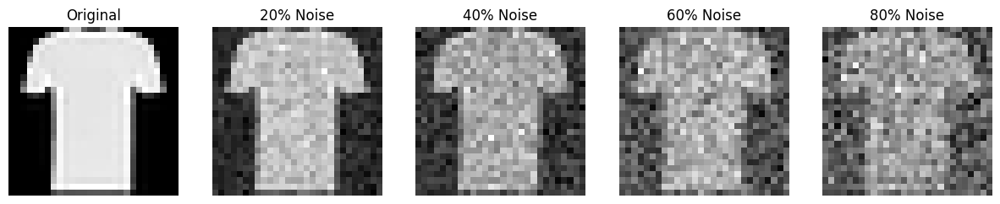

'\n# Try a non-linear noise schedule\nbeta_alt = torch.linspace(beta_start, beta_end, n_steps)**2\nalpha_alt = 1 - beta_alt\nalpha_bar_alt = torch.cumprod(alpha_alt, dim=0)\n# How would this affect the diffusion process?\n'

In [ ]:
# Visualization function to show how noise progressively affects images
def show_noise_progression(image, num_steps=5):
    """
    Visualize how an image gets progressively noisier in the diffusion process.

    Args:
        image (torch.Tensor): Original clean image [C, H, W]
        num_steps (int): Number of noise levels to show
    """
    plt.figure(figsize=(15, 3))

    # Show original image
    plt.subplot(1, num_steps, 1)
    if IMG_CH == 1:  # Grayscale image
        plt.imshow(image[0].cpu(), cmap='gray')
    else:  # Color image
        img = image.permute(1, 2, 0).cpu()  # Change from [C,H,W] to [H,W,C]
        if img.min() < 0:  # If normalized between -1 and 1
            img = (img + 1) / 2  # Rescale to [0,1] for display
        plt.imshow(img)
    plt.title('Original')
    plt.axis('off')

    # Show progressively noisier versions
    for i in range(1, num_steps):
        # Calculate timestep index based on percentage through the process
        t_idx = int((i/num_steps) * n_steps)
        t = torch.tensor([t_idx]).to(device)

        # Add noise corresponding to timestep t
        noisy_image, _ = add_noise(image.unsqueeze(0), t)

        # Display the noisy image
        plt.subplot(1, num_steps, i+1)
        if IMG_CH == 1:
            plt.imshow(noisy_image[0][0].cpu(), cmap='gray')
        else:
            img = noisy_image[0].permute(1, 2, 0).cpu()
            if img.min() < 0:
                img = (img + 1) / 2
            plt.imshow(img)
        plt.title(f'{int((i/num_steps) * 100)}% Noise')
        plt.axis('off')
    plt.show()

# Show an example of noise progression on a real image
sample_batch = next(iter(train_load))  # Get first batch
sample_image = sample_batch[0][0].to(device)  # Get first image
show_noise_progression(sample_image)

# Student Activity: Try different noise schedules
# Uncomment and modify these lines to experiment:
"""
# Try a non-linear noise schedule
beta_alt = torch.linspace(beta_start, beta_end, n_steps)**2
alpha_alt = 1 - beta_alt
alpha_bar_alt = torch.cumprod(alpha_alt, dim=0)
# How would this affect the diffusion process?
"""

## Step 5: Training Our Model

Now we'll teach our AI to generate images. This process:
1. Takes a clear image
2. Adds random noise to it
3. Asks our AI to predict what noise was added
4. Helps our AI learn from its mistakes

This will take a while, but we'll see progress as it learns!

In [ ]:
# Define helper functions needed for training and evaluation
def validate_model_parameters(model):
    """
    Counts model parameters and estimates memory usage.
    """
    total_params = sum(p.numel() for p in model.parameters())
    trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)

    print(f"Total parameters: {total_params:,}")
    print(f"Trainable parameters: {trainable_params:,}")

    # Estimate memory requirements (very approximate)
    param_memory = total_params * 4 / (1024 ** 2)  # MB for params (float32)
    grad_memory = trainable_params * 4 / (1024 ** 2)  # MB for gradients
    buffer_memory = param_memory * 2  # Optimizer state, forward activations, etc.

    print(f"Estimated GPU memory usage: {param_memory + grad_memory + buffer_memory:.1f} MB")

# Define helper functions for verifying data ranges
def verify_data_range(dataloader, name="Dataset"):
    """
    Verifies the range and integrity of the data.
    """
    batch = next(iter(dataloader))[0]
    print(f"\n{name} range check:")
    print(f"Shape: {batch.shape}")
    print(f"Data type: {batch.dtype}")
    print(f"Min value: {batch.min().item():.2f}")
    print(f"Max value: {batch.max().item():.2f}")
    print(f"Contains NaN: {torch.isnan(batch).any().item()}")
    print(f"Contains Inf: {torch.isinf(batch).any().item()}")

# Define helper functions for generating samples during training\
@torch.no_grad()
def generate_samples(model, n_samples=10, cfg_scale=3.0):
    """Generates sample images using the model with CFG."""
    print(f"Generating samples with CFG (scale={cfg_scale})...")
    model.eval()
    samples_list = []
    num_to_generate = min(n_samples, N_CLASSES)

    for digit in range(num_to_generate):
        x = torch.randn(1, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)
        c = torch.tensor([digit], dtype=torch.long).to(device)
        c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float()
        c_mask_cond = torch.ones(1, dtype=torch.bool, device=device)
        c_mask_uncond = torch.zeros(1, dtype=torch.bool, device=device)

        for t_val in range(N_STEPS - 1, -1, -1):
            t_batch = torch.full((1,), t_val, device=device, dtype=torch.long)
            eps_uncond = model(x, t_batch, c_one_hot, c_mask_uncond)
            eps_cond = model(x, t_batch, c_one_hot, c_mask_cond)
            eps = (1 + cfg_scale) * eps_cond - cfg_scale * eps_uncond # CFG combination

            alpha_t = alpha[t_val]
            alpha_bar_t = alpha_bar[t_val]
            beta_t = beta[t_val]
            sqrt_one_minus_alpha_bar_t = sqrt_one_minus_alpha_bar[t_val]

            mean = (1 / torch.sqrt(alpha_t)) * (x - (beta_t / sqrt_one_minus_alpha_bar_t) * eps)

            if t_val > 0:
                noise = torch.randn_like(x)
                variance = torch.sqrt(beta_t) # DDPM variance
                x = mean + variance * noise
            else:
                x = mean
        samples_list.append(x)

    samples = torch.cat(samples_list, dim=0)
    samples = to_image(samples) # Un-normalize to [0, 1]

    grid = make_grid(samples, nrow=min(n_samples, 5))
    plt.figure(figsize=(10, 4))
    if IMG_CH == 1:
        plt.imshow(grid[0].cpu(), cmap='gray') # Display grayscale
    else:
        plt.imshow(grid.permute(1, 2, 0).cpu())
    plt.axis('off')
    plt.title(f'Generated Samples (CFG Scale: {cfg_scale})')
    plt.show()
    model.train() # Set back to train mode

# Define helper functions for safely saving models
def safe_save_model(model, path, optimizer=None, epoch=None, best_loss=None):
    """
    Safely saves model with error handling and backup.
    """
    try:
        # Create a dictionary with all the elements to save
        save_dict = {
            'model_state_dict': model.state_dict(),
        }

        # Add optional elements if provided
        if optimizer is not None:
            save_dict['optimizer_state_dict'] = optimizer.state_dict()
        if epoch is not None:
            save_dict['epoch'] = epoch
        if best_loss is not None:
            save_dict['best_loss'] = best_loss

        # Create a backup of previous checkpoint if it exists
        if os.path.exists(path):
            backup_path = path + '.backup'
            try:
                os.replace(path, backup_path)
                print(f"Created backup at {backup_path}")
            except Exception as e:
                print(f"Warning: Could not create backup - {e}")

        # Save the new checkpoint
        torch.save(save_dict, path)
        print(f"Model successfully saved to {path}")

    except Exception as e:
        print(f"Error saving model: {e}")
        print("Attempting emergency save...")

        try:
            emergency_path = path + '.emergency'
            torch.save(model.state_dict(), emergency_path)
            print(f"Emergency save successful: {emergency_path}")
        except:
            print("Emergency save failed. Could not save model.")

In [ ]:
#  Implementation of the training step function
def train_step(x, c):
    """
    Performs a single training step for the diffusion model.

    This function:
    1. Prepares class conditioning
    2. Samples random timesteps for each image
    3. Adds corresponding noise to the images
    4. Asks the model to predict the noise
    5. Calculates the loss between predicted and actual noise

    Args:
        x (torch.Tensor): Batch of clean images [batch_size, channels, height, width]
        c (torch.Tensor): Batch of class labels [batch_size]

    Returns:
        torch.Tensor: Mean squared error loss value
    """
    c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float().to(device)
    prob_uncond = 0.1
    c_mask_cfg = (torch.rand(c.shape[0], device=device) > prob_uncond)
    t = torch.randint(0, N_STEPS, (x.shape[0],), device=device, dtype=torch.long)
    x_t, noise = add_noise(x, t) # Uses global schedule vars
    predicted_noise = model(x_t, t, c_one_hot, c_mask_cfg)
    loss = F.mse_loss(predicted_noise, noise)
    return loss # Return tensor


In [ ]:
# --- Add new calculate_val_loss function ---
@torch.no_grad()
def calculate_val_loss(model, x, c):
    """Calculates validation loss without CFG training strategy and no grads."""
    model.eval()
    c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float().to(device)
    c_mask_cond = torch.ones(c.shape[0], dtype=torch.bool, device=device) # Always condition
    t = torch.randint(0, N_STEPS, (x.shape[0],), device=device, dtype=torch.long)
    x_t, noise = add_noise(x, t)
    predicted_noise = model(x_t, t, c_one_hot, c_mask_cond)
    loss = F.mse_loss(predicted_noise, noise)
    return loss.item() # Return scalar value

print("Helper functions redefined/added.")

Helper functions redefined/added.


## Obsolete - initial attempt at training

In [ ]:
# Create our model and move it to GPU if available
model = UNet(
    T=n_steps,                 # Number of diffusion time steps
    img_ch=IMG_CH,             # Number of channels in our images (1 for grayscale, 3 for RGB)
    img_size=IMG_SIZE,         # Size of input images (28 for MNIST, 32 for CIFAR-10)
    down_chs=(32, 64, 128),    # Channel dimensions for each downsampling level
    t_embed_dim=8,             # Dimension for time step embeddings
    c_embed_dim=N_CLASSES      # Number of classes for conditioning
).to(device)

# Print model summary
print(f"\n{'='*50}")
print(f"MODEL ARCHITECTURE SUMMARY")
print(f"{'='*50}")
print(f"Input resolution: {IMG_SIZE}x{IMG_SIZE}")
print(f"Input channels: {IMG_CH}")
print(f"Time steps: {n_steps}")
print(f"Condition classes: {N_CLASSES}")
print(f"GPU acceleration: {'Yes' if device.type == 'cuda' else 'No'}")

# Validate model parameters and estimate memory requirements
# Hint: Create functions to count parameters and estimate memory usage

# Enter your code here:

# 1) Validate model size & memory
validate_model_parameters(model)

# Your code to verify data ranges and integrity
# Hint: Create functions to check data ranges in training and validation data

# Enter your code here:

# 2) Verify data ranges on your loaders
verify_data_range(train_load, name="Training set")
verify_data_range(val_load,   name="Validation set")

# Set up the optimizer with parameters tuned for diffusion models
# Note: Lower learning rates tend to work better for diffusion models
initial_lr = 0.001  # Starting learning rate
weight_decay = 1e-5  # L2 regularization to prevent overfitting

optimizer = Adam(
    model.parameters(),
    lr=initial_lr,
    weight_decay=weight_decay
)

# Learning rate scheduler to reduce LR when validation loss plateaus
# This helps fine-tune the model toward the end of training
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',              # Reduce LR when monitored value stops decreasing
    factor=0.5,              # Multiply LR by this factor
    patience=5,              # Number of epochs with no improvement after which LR will be reduced
    verbose=True,            # Print message when LR is reduced
    min_lr=1e-6              # Lower bound on the learning rate
)

# STUDENT EXPERIMENT:
# Try different channel configurations and see how they affect:
# 1. Model size (parameter count)
# 2. Training time
# 3. Generated image quality
#
# Suggestions:
# - Smaller: down_chs=(16, 32, 64)
# - Larger: down_chs=(64, 128, 256, 512)

Created DownBlock: in_chs=32, out_chs=64, spatial_reduction=2x
Created DownBlock: in_chs=64, out_chs=128, spatial_reduction=2x
Created UpBlock: in_chs=128, out_chs=64, spatial_increase=2x
Created UpBlock: in_chs=64, out_chs=32, spatial_increase=2x
Created UNet with 3 scale levels
Channel dimensions: (32, 64, 128)

MODEL ARCHITECTURE SUMMARY
Input resolution: 32x32
Input channels: 3
Time steps: 100
Condition classes: 10
GPU acceleration: Yes
Total parameters: 1,573,983
Trainable parameters: 1,573,983
Estimated GPU memory usage: 24.0 MB

Training set range check:
Shape: torch.Size([32, 3, 32, 32])
Data type: torch.float32
Min value: -1.00
Max value: 1.00
Contains NaN: False
Contains Inf: False

Validation set range check:
Shape: torch.Size([32, 3, 32, 32])
Data type: torch.float32
Min value: -1.00
Max value: 1.00
Contains NaN: False
Contains Inf: False


#### Student Experiment: Smaller UNET

In [ ]:
down_chs_small = (16, 32, 64)
model_small = UNet(
    T=n_steps,
    img_ch=IMG_CH,
    img_size=IMG_SIZE,
    down_chs=down_chs_small,
    t_embed_dim=8,
    c_embed_dim=N_CLASSES
).to(device)

print("\n>> Small U-Net:", down_chs_small)
validate_model_parameters(model_small)

Created DownBlock: in_chs=16, out_chs=32, spatial_reduction=2x
Created DownBlock: in_chs=32, out_chs=64, spatial_reduction=2x
Created UpBlock: in_chs=64, out_chs=32, spatial_increase=2x
Created UpBlock: in_chs=32, out_chs=16, spatial_increase=2x
Created UNet with 3 scale levels
Channel dimensions: (16, 32, 64)

>> Small U-Net: (16, 32, 64)
Total parameters: 395,423
Trainable parameters: 395,423
Estimated GPU memory usage: 6.0 MB


In [ ]:
sample_x, _ = next(iter(train_load))
# Gen quick forward‐pass sample - sanity‐checking dims and shapes
sample_x, sample_y = next(iter(train_load))
with torch.no_grad():
    out_small = model_small(
        sample_x[:1].to(device),                             # image
        torch.tensor([0], device=device),                    # t=0
        F.one_hot(torch.tensor([0]), N_CLASSES).float().to(device),
        torch.ones((1,1), device=device)                     # mask
    )
print("→ small output shape:", out_small.shape)


→ small output shape: torch.Size([1, 3, 32, 32])


#### Student Experiment: Larger UNET

In [ ]:
down_chs_large = (64, 128, 256, 512)
model_large = UNet(
    T=n_steps,
    img_ch=IMG_CH,
    img_size=IMG_SIZE,
    down_chs=down_chs_large,
    t_embed_dim=8,
    c_embed_dim=N_CLASSES
).to(device)

print("\n>> Large U-Net:", down_chs_large)
validate_model_parameters(model_large)

Created DownBlock: in_chs=64, out_chs=128, spatial_reduction=2x
Created DownBlock: in_chs=128, out_chs=256, spatial_reduction=2x
Created DownBlock: in_chs=256, out_chs=512, spatial_reduction=2x
Created UpBlock: in_chs=512, out_chs=256, spatial_increase=2x
Created UpBlock: in_chs=256, out_chs=128, spatial_increase=2x
Created UpBlock: in_chs=128, out_chs=64, spatial_increase=2x
Created UNet with 4 scale levels
Channel dimensions: (64, 128, 256, 512)

>> Large U-Net: (64, 128, 256, 512)
Total parameters: 26,086,623
Trainable parameters: 26,086,623
Estimated GPU memory usage: 398.1 MB


In [ ]:
sample_x, _ = next(iter(train_load))
# Sanity‐check forward pass
with torch.no_grad():
    out_large = model_large(
        sample_x[:1].to(device),
        torch.tensor([0], device=device),
        F.one_hot(torch.tensor([0]), N_CLASSES).float().to(device),
        torch.ones((1,1), device=device)
    )
print("→ large output shape:", out_large.shape)

→ large output shape: torch.Size([1, 3, 32, 32])



STARTING TRAINING

Epoch 1/50
--------------------
  Step 0/1250, Loss: 1.1094
  Step 100/1250, Loss: 0.1736
  Step 200/1250, Loss: 0.1784
  Step 300/1250, Loss: 0.1151
  Step 400/1250, Loss: 0.1075
  Step 500/1250, Loss: 0.1335
  Generating samples...


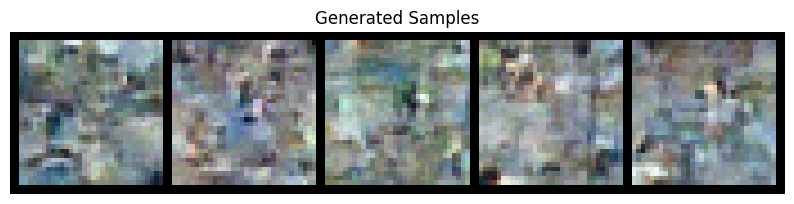

  Step 600/1250, Loss: 0.1812
  Step 700/1250, Loss: 0.1003
  Step 800/1250, Loss: 0.1389
  Step 900/1250, Loss: 0.1094
  Step 1000/1250, Loss: 0.1111
  Generating samples...


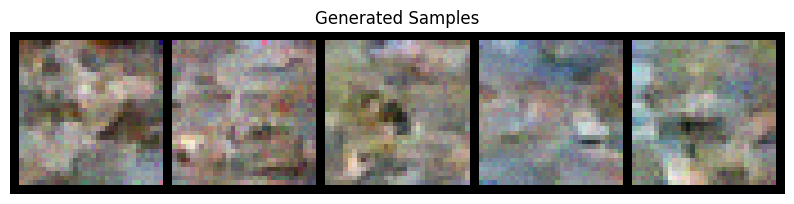

  Step 1100/1250, Loss: 0.1647
  Step 1200/1250, Loss: 0.1371

Training - Epoch 1 average loss: 0.1457
Running validation...
Validation - Epoch 1 average loss: 0.1208
Learning rate: 0.001000

Generating samples for visual progress check...


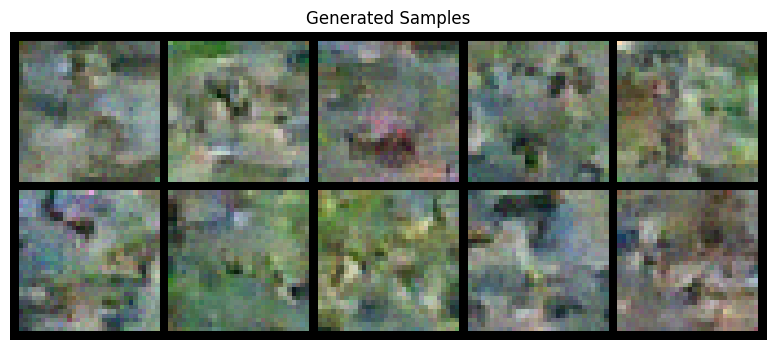

Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1208)


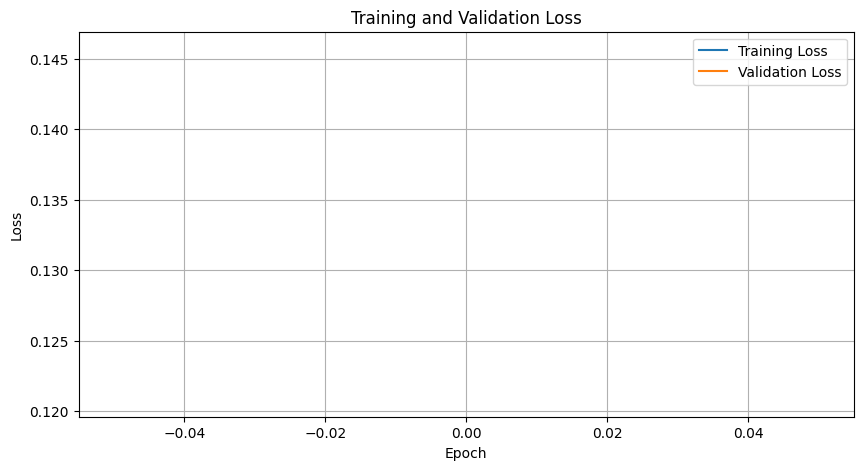


Epoch 2/50
--------------------
  Step 0/1250, Loss: 0.1232
  Step 100/1250, Loss: 0.1321
  Step 200/1250, Loss: 0.1053
  Step 300/1250, Loss: 0.1256
  Step 400/1250, Loss: 0.1117
  Step 500/1250, Loss: 0.0989
  Generating samples...


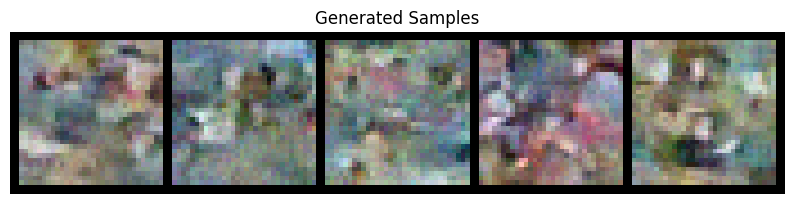

  Step 600/1250, Loss: 0.0794
  Step 700/1250, Loss: 0.1334
  Step 800/1250, Loss: 0.0929
  Step 900/1250, Loss: 0.1539
  Step 1000/1250, Loss: 0.1019
  Generating samples...


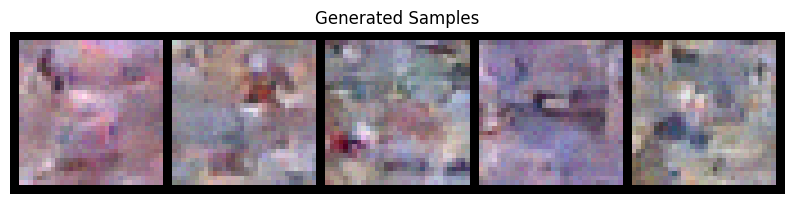

  Step 1100/1250, Loss: 0.1158
  Step 1200/1250, Loss: 0.0949

Training - Epoch 2 average loss: 0.1162
Running validation...
Validation - Epoch 2 average loss: 0.1156
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1156)

Epoch 3/50
--------------------
  Step 0/1250, Loss: 0.0933
  Step 100/1250, Loss: 0.0813
  Step 200/1250, Loss: 0.1228
  Step 300/1250, Loss: 0.1074
  Step 400/1250, Loss: 0.1253
  Step 500/1250, Loss: 0.0979
  Generating samples...


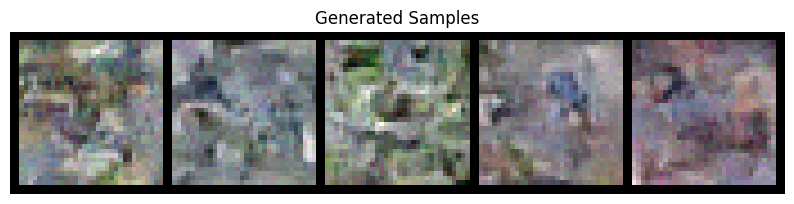

  Step 600/1250, Loss: 0.1028
  Step 700/1250, Loss: 0.1159
  Step 800/1250, Loss: 0.1230
  Step 900/1250, Loss: 0.1055
  Step 1000/1250, Loss: 0.1104
  Generating samples...


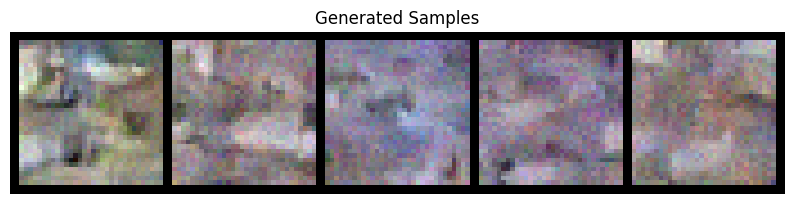

  Step 1100/1250, Loss: 0.1143
  Step 1200/1250, Loss: 0.1136

Training - Epoch 3 average loss: 0.1108
Running validation...
Validation - Epoch 3 average loss: 0.1083
Learning rate: 0.001000

Generating samples for visual progress check...


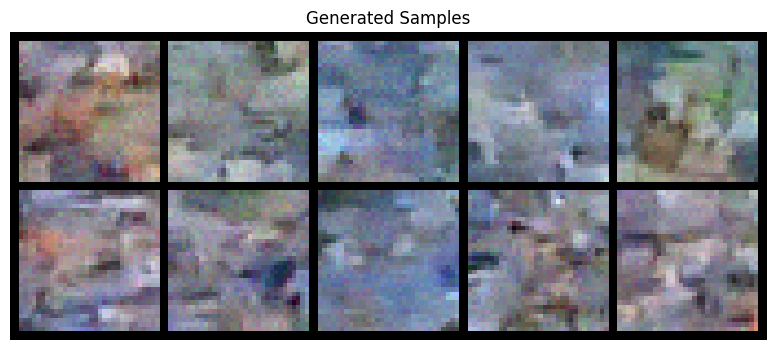

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1083)

Epoch 4/50
--------------------
  Step 0/1250, Loss: 0.0998
  Step 100/1250, Loss: 0.1007
  Step 200/1250, Loss: 0.1087
  Step 300/1250, Loss: 0.1557
  Step 400/1250, Loss: 0.0910
  Step 500/1250, Loss: 0.1037
  Generating samples...


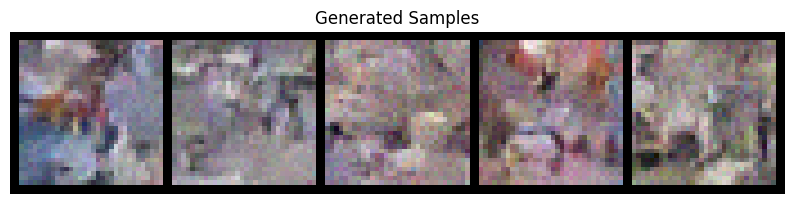

  Step 600/1250, Loss: 0.1190
  Step 700/1250, Loss: 0.1073
  Step 800/1250, Loss: 0.1002
  Step 900/1250, Loss: 0.1154
  Step 1000/1250, Loss: 0.1299
  Generating samples...


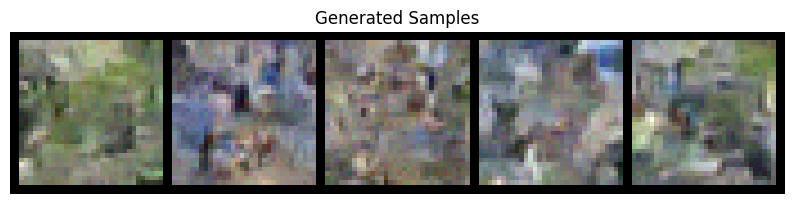

  Step 1100/1250, Loss: 0.0741
  Step 1200/1250, Loss: 0.0725

Training - Epoch 4 average loss: 0.1080
Running validation...
Validation - Epoch 4 average loss: 0.1083
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1083)

Epoch 5/50
--------------------
  Step 0/1250, Loss: 0.0931
  Step 100/1250, Loss: 0.0881
  Step 200/1250, Loss: 0.0819
  Step 300/1250, Loss: 0.1373
  Step 400/1250, Loss: 0.0845
  Step 500/1250, Loss: 0.1302
  Generating samples...


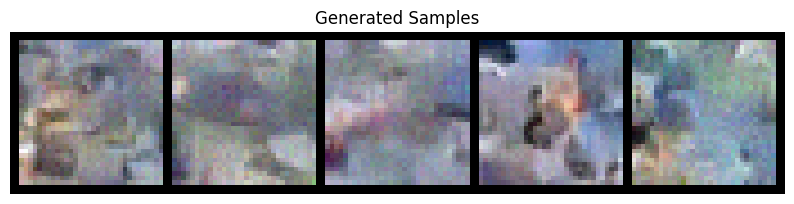

  Step 600/1250, Loss: 0.1036
  Step 700/1250, Loss: 0.0981
  Step 800/1250, Loss: 0.1276
  Step 900/1250, Loss: 0.1016
  Step 1000/1250, Loss: 0.0603
  Generating samples...


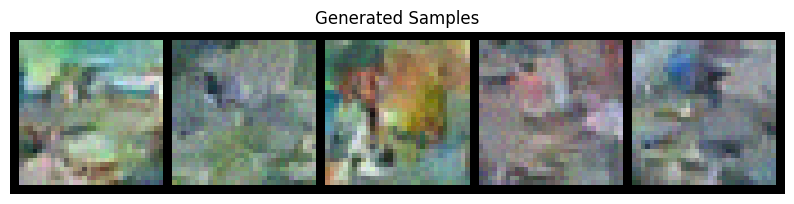

  Step 1100/1250, Loss: 0.0908
  Step 1200/1250, Loss: 0.1509

Training - Epoch 5 average loss: 0.1068
Running validation...
Validation - Epoch 5 average loss: 0.1076
Learning rate: 0.001000

Generating samples for visual progress check...


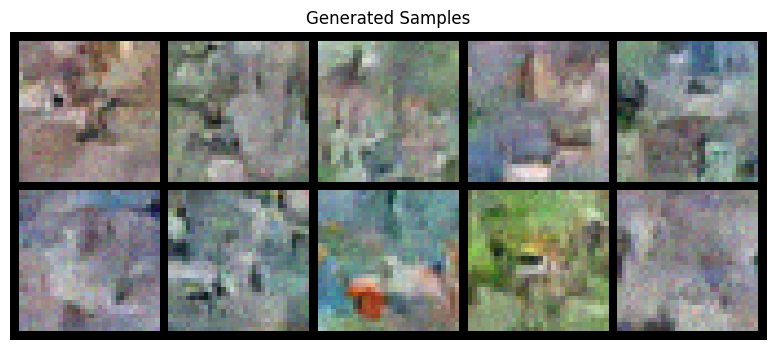

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1076)

Epoch 6/50
--------------------
  Step 0/1250, Loss: 0.0755
  Step 100/1250, Loss: 0.1159
  Step 200/1250, Loss: 0.1011
  Step 300/1250, Loss: 0.1080
  Step 400/1250, Loss: 0.0729
  Step 500/1250, Loss: 0.1089
  Generating samples...


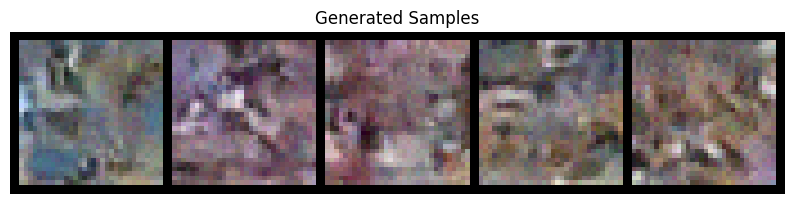

  Step 600/1250, Loss: 0.1154
  Step 700/1250, Loss: 0.1103
  Step 800/1250, Loss: 0.1066
  Step 900/1250, Loss: 0.0868
  Step 1000/1250, Loss: 0.0984
  Generating samples...


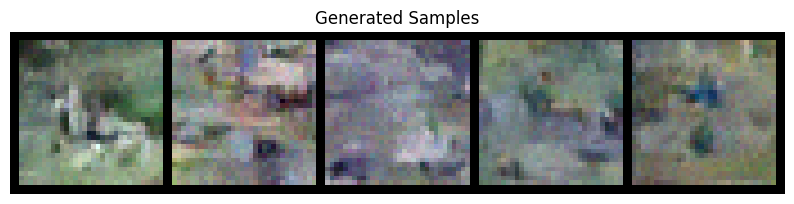

  Step 1100/1250, Loss: 0.0871
  Step 1200/1250, Loss: 0.1080

Training - Epoch 6 average loss: 0.1058
Running validation...
Validation - Epoch 6 average loss: 0.1044
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1044)


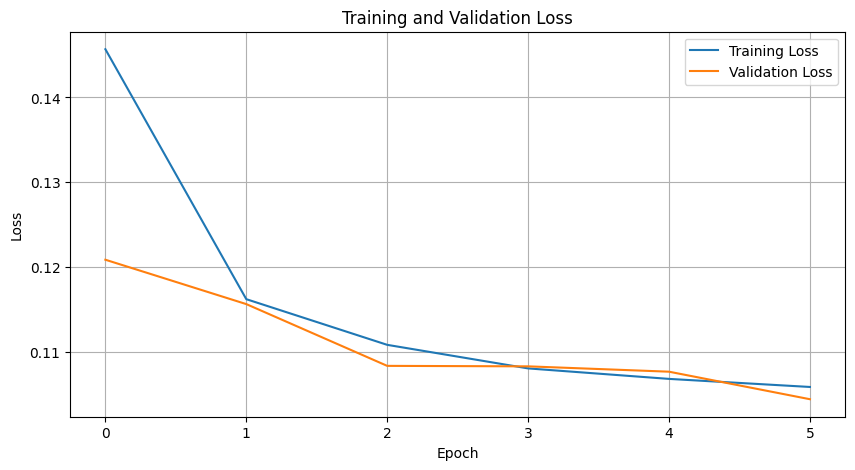


Epoch 7/50
--------------------
  Step 0/1250, Loss: 0.1097
  Step 100/1250, Loss: 0.1398
  Step 200/1250, Loss: 0.0883
  Step 300/1250, Loss: 0.1104
  Step 400/1250, Loss: 0.1094
  Step 500/1250, Loss: 0.0920
  Generating samples...


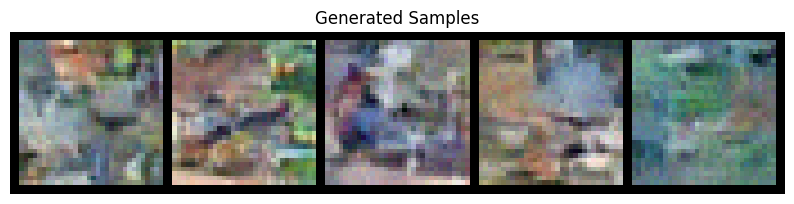

  Step 600/1250, Loss: 0.0967
  Step 700/1250, Loss: 0.1300
  Step 800/1250, Loss: 0.1295
  Step 900/1250, Loss: 0.0873
  Step 1000/1250, Loss: 0.0849
  Generating samples...


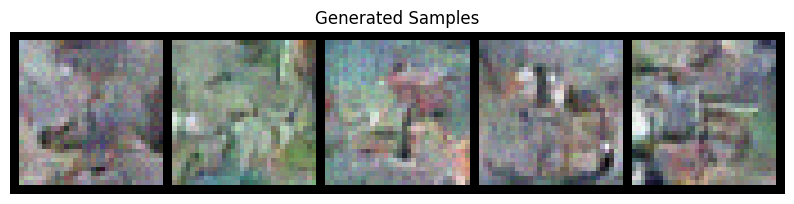

  Step 1100/1250, Loss: 0.1361
  Step 1200/1250, Loss: 0.0765

Training - Epoch 7 average loss: 0.1050
Running validation...
Validation - Epoch 7 average loss: 0.1062
Learning rate: 0.001000

Generating samples for visual progress check...


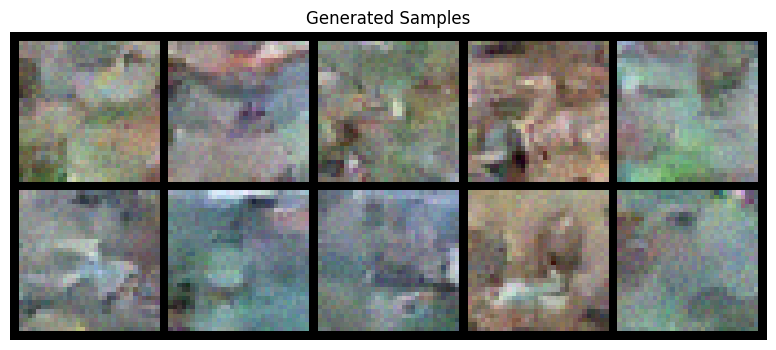

No improvement for 1/10 epochs

Epoch 8/50
--------------------
  Step 0/1250, Loss: 0.1014
  Step 100/1250, Loss: 0.0719
  Step 200/1250, Loss: 0.1079
  Step 300/1250, Loss: 0.1222
  Step 400/1250, Loss: 0.0806
  Step 500/1250, Loss: 0.1001
  Generating samples...


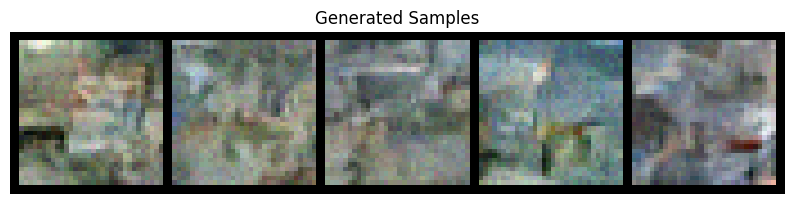

  Step 600/1250, Loss: 0.1333
  Step 700/1250, Loss: 0.0920
  Step 800/1250, Loss: 0.1243
  Step 900/1250, Loss: 0.1339
  Step 1000/1250, Loss: 0.0826
  Generating samples...


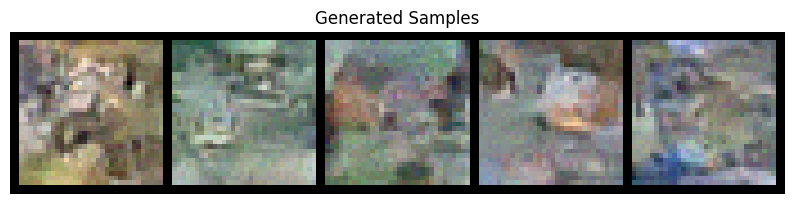

  Step 1100/1250, Loss: 0.0782
  Step 1200/1250, Loss: 0.0883

Training - Epoch 8 average loss: 0.1031
Running validation...
Validation - Epoch 8 average loss: 0.1030
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1030)

Epoch 9/50
--------------------
  Step 0/1250, Loss: 0.1233
  Step 100/1250, Loss: 0.1005
  Step 200/1250, Loss: 0.0924
  Step 300/1250, Loss: 0.0814
  Step 400/1250, Loss: 0.0763
  Step 500/1250, Loss: 0.1163
  Generating samples...


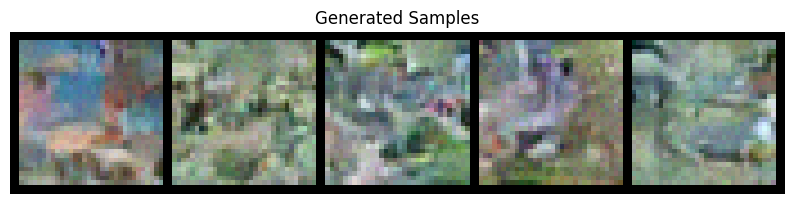

  Step 600/1250, Loss: 0.0951
  Step 700/1250, Loss: 0.0884
  Step 800/1250, Loss: 0.0775
  Step 900/1250, Loss: 0.0909
  Step 1000/1250, Loss: 0.0914
  Generating samples...


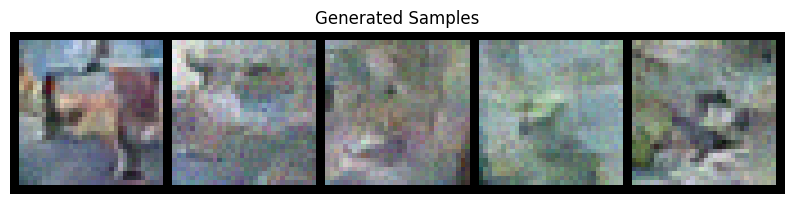

  Step 1100/1250, Loss: 0.1200
  Step 1200/1250, Loss: 0.0691

Training - Epoch 9 average loss: 0.1038
Running validation...
Validation - Epoch 9 average loss: 0.1049
Learning rate: 0.001000

Generating samples for visual progress check...


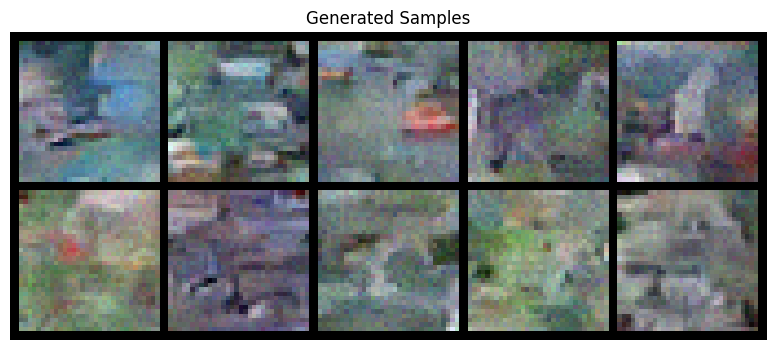

No improvement for 1/10 epochs

Epoch 10/50
--------------------
  Step 0/1250, Loss: 0.1342
  Step 100/1250, Loss: 0.1045
  Step 200/1250, Loss: 0.1511
  Step 300/1250, Loss: 0.1286
  Step 400/1250, Loss: 0.1135
  Step 500/1250, Loss: 0.1159
  Generating samples...


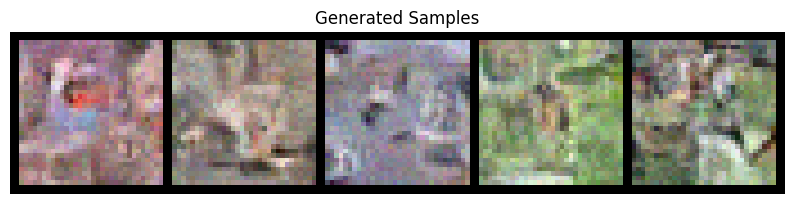

  Step 600/1250, Loss: 0.1076
  Step 700/1250, Loss: 0.1249
  Step 800/1250, Loss: 0.0810
  Step 900/1250, Loss: 0.1147
  Step 1000/1250, Loss: 0.0956
  Generating samples...


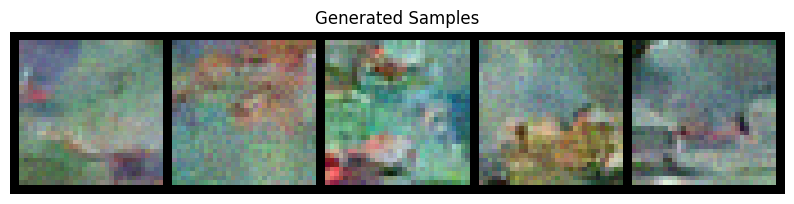

  Step 1100/1250, Loss: 0.1033
  Step 1200/1250, Loss: 0.0991

Training - Epoch 10 average loss: 0.1030
Running validation...
Validation - Epoch 10 average loss: 0.1029
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1029)

Epoch 11/50
--------------------
  Step 0/1250, Loss: 0.1412
  Step 100/1250, Loss: 0.1245
  Step 200/1250, Loss: 0.1215
  Step 300/1250, Loss: 0.0883
  Step 400/1250, Loss: 0.0829
  Step 500/1250, Loss: 0.0963
  Generating samples...


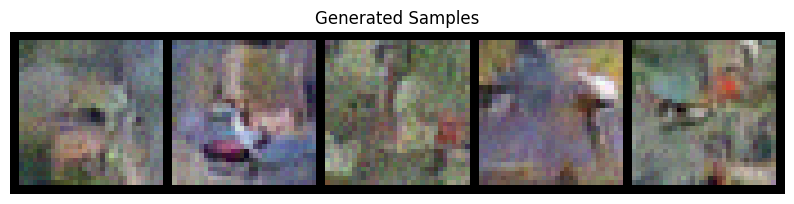

  Step 600/1250, Loss: 0.1133
  Step 700/1250, Loss: 0.0780
  Step 800/1250, Loss: 0.0858
  Step 900/1250, Loss: 0.0939
  Step 1000/1250, Loss: 0.1227
  Generating samples...


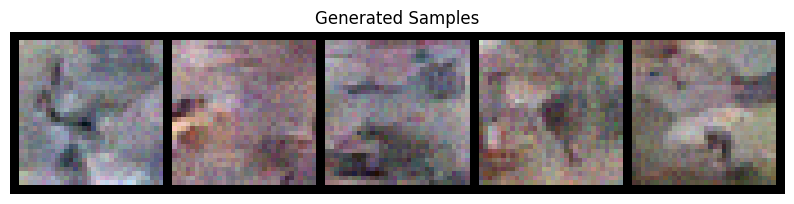

  Step 1100/1250, Loss: 0.0946
  Step 1200/1250, Loss: 0.0982

Training - Epoch 11 average loss: 0.1032
Running validation...
Validation - Epoch 11 average loss: 0.1029
Learning rate: 0.001000

Generating samples for visual progress check...


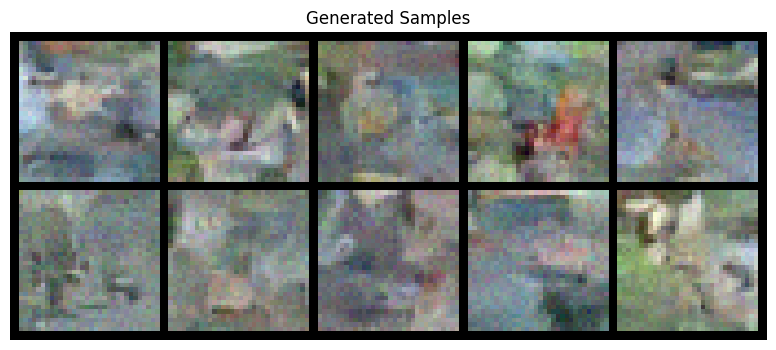

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1029)


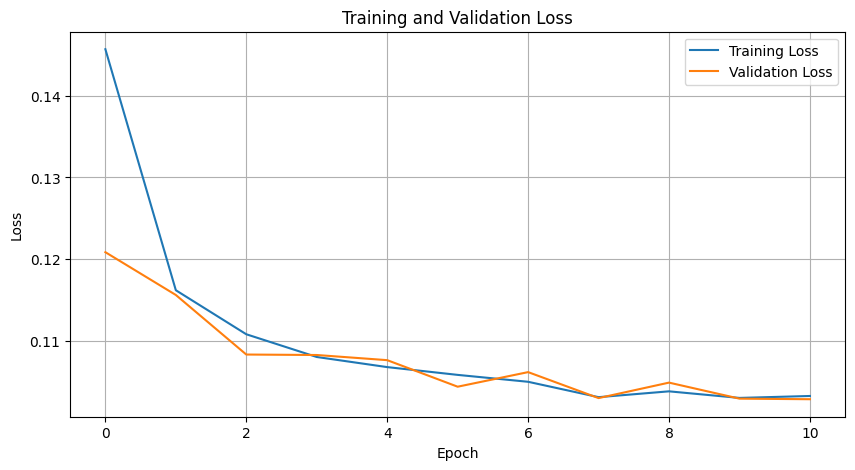


Epoch 12/50
--------------------
  Step 0/1250, Loss: 0.0884
  Step 100/1250, Loss: 0.1074
  Step 200/1250, Loss: 0.1076
  Step 300/1250, Loss: 0.0897
  Step 400/1250, Loss: 0.0951
  Step 500/1250, Loss: 0.1008
  Generating samples...


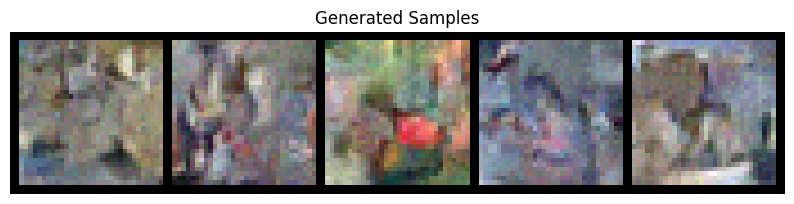

  Step 600/1250, Loss: 0.1673
  Step 700/1250, Loss: 0.1237
  Step 800/1250, Loss: 0.1041
  Step 900/1250, Loss: 0.1466
  Step 1000/1250, Loss: 0.1133
  Generating samples...


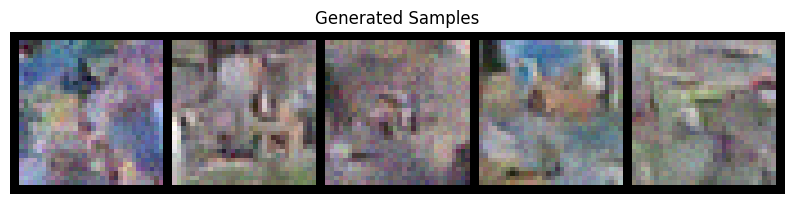

  Step 1100/1250, Loss: 0.1070
  Step 1200/1250, Loss: 0.1002

Training - Epoch 12 average loss: 0.1033
Running validation...
Validation - Epoch 12 average loss: 0.1003
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.1003)

Epoch 13/50
--------------------
  Step 0/1250, Loss: 0.0910
  Step 100/1250, Loss: 0.0760
  Step 200/1250, Loss: 0.1353
  Step 300/1250, Loss: 0.1075
  Step 400/1250, Loss: 0.1026
  Step 500/1250, Loss: 0.0995
  Generating samples...


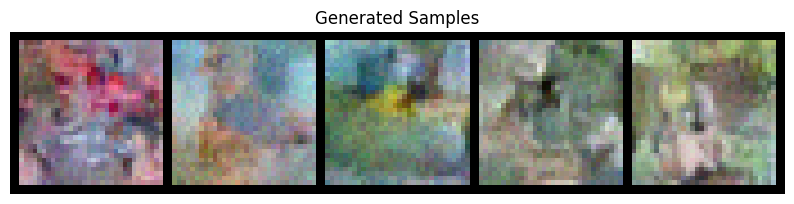

  Step 600/1250, Loss: 0.1212
  Step 700/1250, Loss: 0.1200
  Step 800/1250, Loss: 0.0779
  Step 900/1250, Loss: 0.1295
  Step 1000/1250, Loss: 0.1011
  Generating samples...


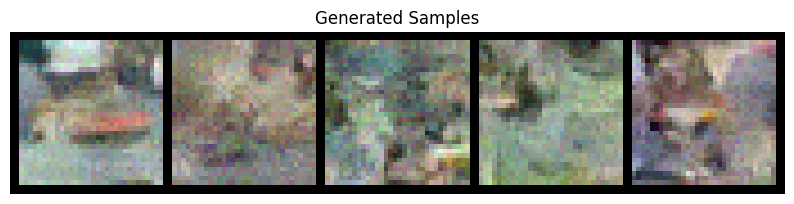

  Step 1100/1250, Loss: 0.1216
  Step 1200/1250, Loss: 0.0889

Training - Epoch 13 average loss: 0.1020
Running validation...
Validation - Epoch 13 average loss: 0.1043
Learning rate: 0.001000

Generating samples for visual progress check...


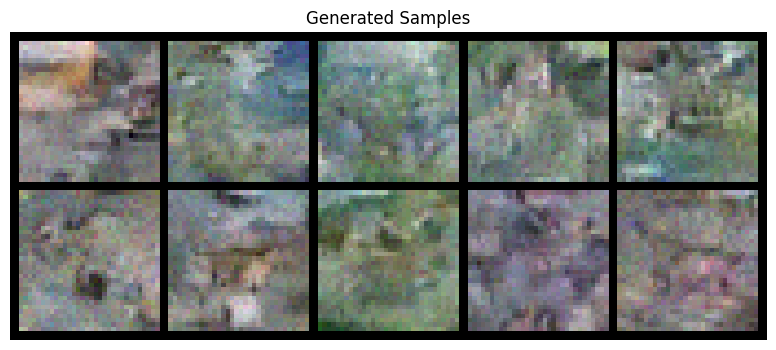

No improvement for 1/10 epochs

Epoch 14/50
--------------------
  Step 0/1250, Loss: 0.1253
  Step 100/1250, Loss: 0.1002
  Step 200/1250, Loss: 0.0813
  Step 300/1250, Loss: 0.1412
  Step 400/1250, Loss: 0.0931
  Step 500/1250, Loss: 0.0692
  Generating samples...


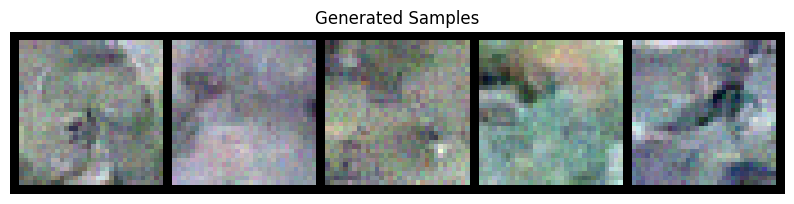

  Step 600/1250, Loss: 0.0782
  Step 700/1250, Loss: 0.0764
  Step 800/1250, Loss: 0.0908
  Step 900/1250, Loss: 0.0969
  Step 1000/1250, Loss: 0.0832
  Generating samples...


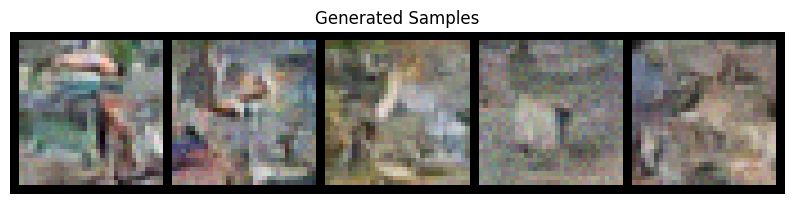

  Step 1100/1250, Loss: 0.1165
  Step 1200/1250, Loss: 0.1054

Training - Epoch 14 average loss: 0.1020
Running validation...
Validation - Epoch 14 average loss: 0.1012
Learning rate: 0.001000
No improvement for 2/10 epochs

Epoch 15/50
--------------------
  Step 0/1250, Loss: 0.1233
  Step 100/1250, Loss: 0.0707
  Step 200/1250, Loss: 0.1421
  Step 300/1250, Loss: 0.0986
  Step 400/1250, Loss: 0.1154
  Step 500/1250, Loss: 0.1051
  Generating samples...


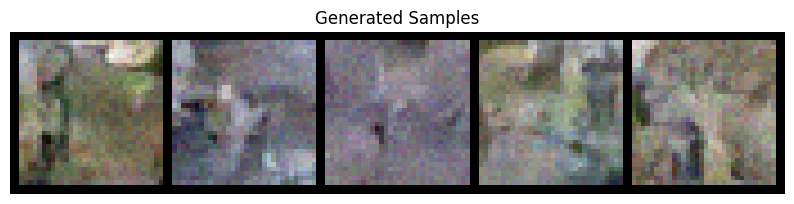

  Step 600/1250, Loss: 0.0608
  Step 700/1250, Loss: 0.0945
  Step 800/1250, Loss: 0.0751
  Step 900/1250, Loss: 0.1290
  Step 1000/1250, Loss: 0.1112
  Generating samples...


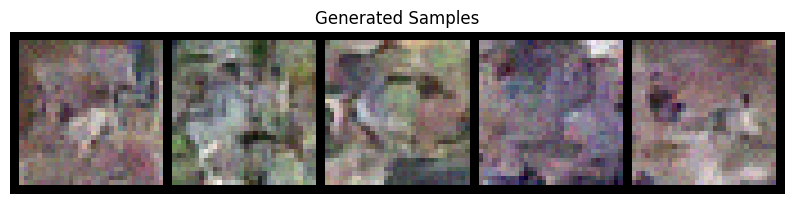

  Step 1100/1250, Loss: 0.1061
  Step 1200/1250, Loss: 0.1071

Training - Epoch 15 average loss: 0.1016
Running validation...
Validation - Epoch 15 average loss: 0.1014
Learning rate: 0.001000

Generating samples for visual progress check...


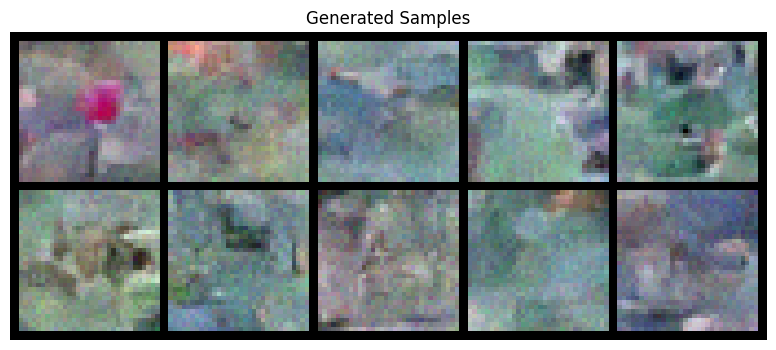

No improvement for 3/10 epochs

Epoch 16/50
--------------------
  Step 0/1250, Loss: 0.1107
  Step 100/1250, Loss: 0.0873
  Step 200/1250, Loss: 0.0910
  Step 300/1250, Loss: 0.1135
  Step 400/1250, Loss: 0.1038
  Step 500/1250, Loss: 0.1108
  Generating samples...


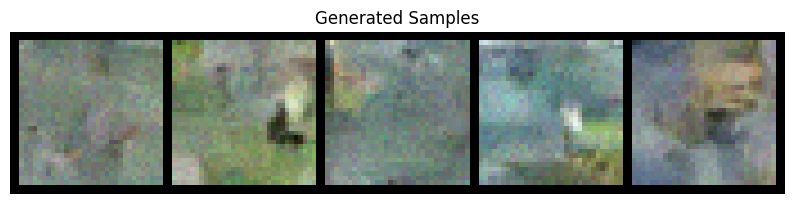

  Step 600/1250, Loss: 0.1050
  Step 700/1250, Loss: 0.1177
  Step 800/1250, Loss: 0.1177
  Step 900/1250, Loss: 0.1026
  Step 1000/1250, Loss: 0.0896
  Generating samples...


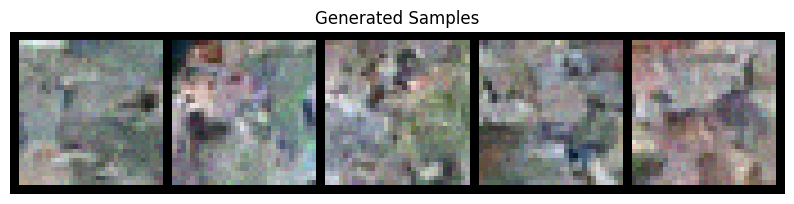

  Step 1100/1250, Loss: 0.1361
  Step 1200/1250, Loss: 0.0988

Training - Epoch 16 average loss: 0.1013
Running validation...
Validation - Epoch 16 average loss: 0.1017
Learning rate: 0.001000
No improvement for 4/10 epochs


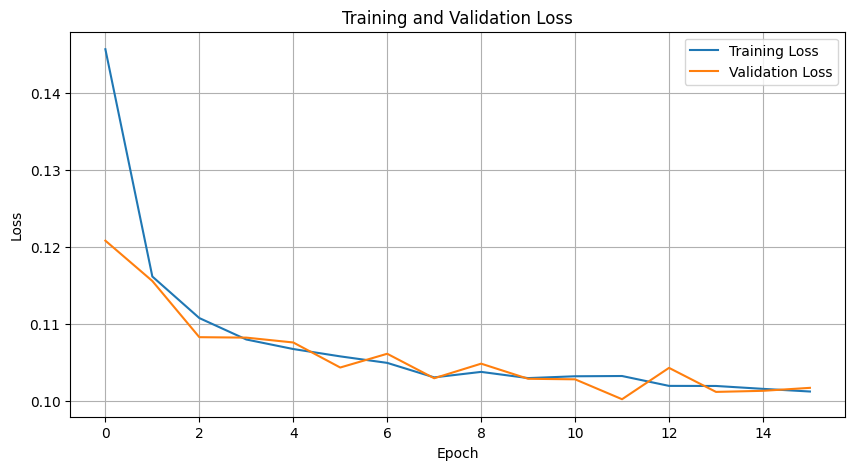


Epoch 17/50
--------------------
  Step 0/1250, Loss: 0.1143
  Step 100/1250, Loss: 0.0890
  Step 200/1250, Loss: 0.0990
  Step 300/1250, Loss: 0.1182
  Step 400/1250, Loss: 0.0857
  Step 500/1250, Loss: 0.0815
  Generating samples...


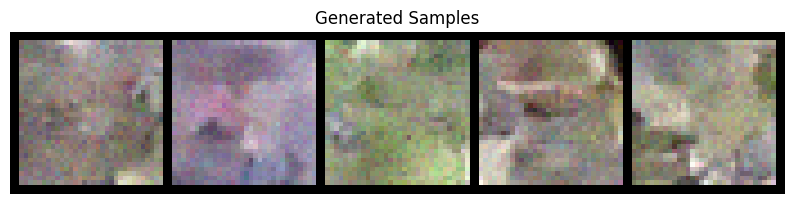

  Step 600/1250, Loss: 0.1036
  Step 700/1250, Loss: 0.1312
  Step 800/1250, Loss: 0.1179
  Step 900/1250, Loss: 0.1074
  Step 1000/1250, Loss: 0.0768
  Generating samples...


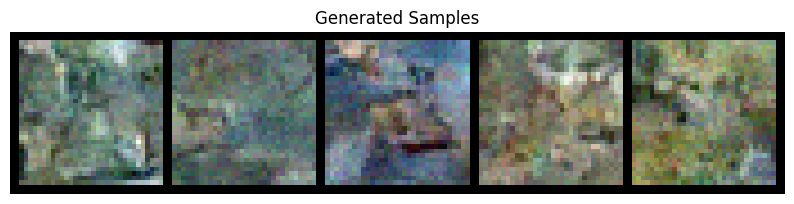

  Step 1100/1250, Loss: 0.1047
  Step 1200/1250, Loss: 0.0841

Training - Epoch 17 average loss: 0.0997
Running validation...
Validation - Epoch 17 average loss: 0.1015
Learning rate: 0.001000

Generating samples for visual progress check...


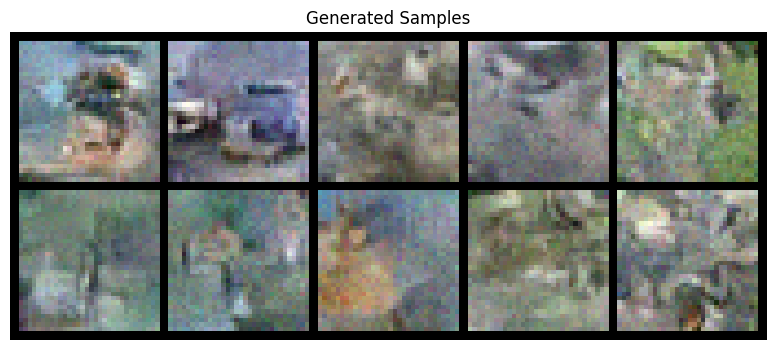

No improvement for 5/10 epochs

Epoch 18/50
--------------------
  Step 0/1250, Loss: 0.1130
  Step 100/1250, Loss: 0.1061
  Step 200/1250, Loss: 0.0794
  Step 300/1250, Loss: 0.1003
  Step 400/1250, Loss: 0.1101
  Step 500/1250, Loss: 0.0943
  Generating samples...


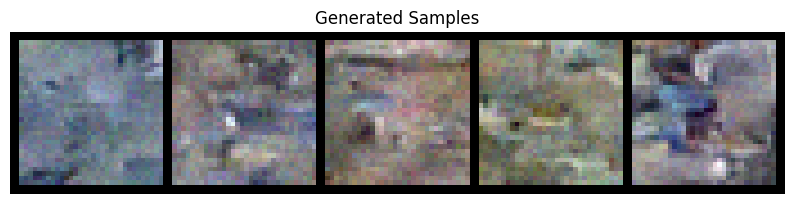

  Step 600/1250, Loss: 0.1005
  Step 700/1250, Loss: 0.0773
  Step 800/1250, Loss: 0.0848
  Step 900/1250, Loss: 0.1413
  Step 1000/1250, Loss: 0.1101
  Generating samples...


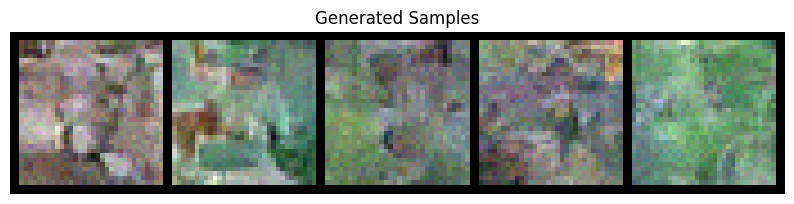

  Step 1100/1250, Loss: 0.0999
  Step 1200/1250, Loss: 0.0878

Training - Epoch 18 average loss: 0.1002
Running validation...
Validation - Epoch 18 average loss: 0.0997
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0997)

Epoch 19/50
--------------------
  Step 0/1250, Loss: 0.1634
  Step 100/1250, Loss: 0.1098
  Step 200/1250, Loss: 0.0924
  Step 300/1250, Loss: 0.1078
  Step 400/1250, Loss: 0.0952
  Step 500/1250, Loss: 0.0810
  Generating samples...


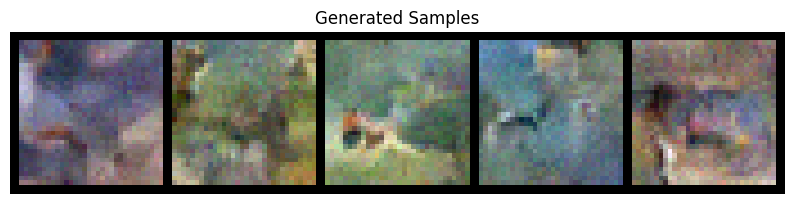

  Step 600/1250, Loss: 0.0823
  Step 700/1250, Loss: 0.0839
  Step 800/1250, Loss: 0.1087
  Step 900/1250, Loss: 0.0969
  Step 1000/1250, Loss: 0.1127
  Generating samples...


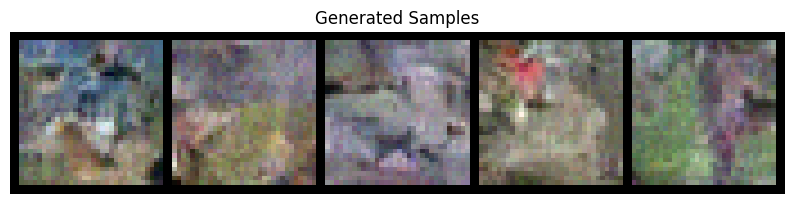

  Step 1100/1250, Loss: 0.0934
  Step 1200/1250, Loss: 0.0852

Training - Epoch 19 average loss: 0.0997
Running validation...
Validation - Epoch 19 average loss: 0.1007
Learning rate: 0.001000

Generating samples for visual progress check...


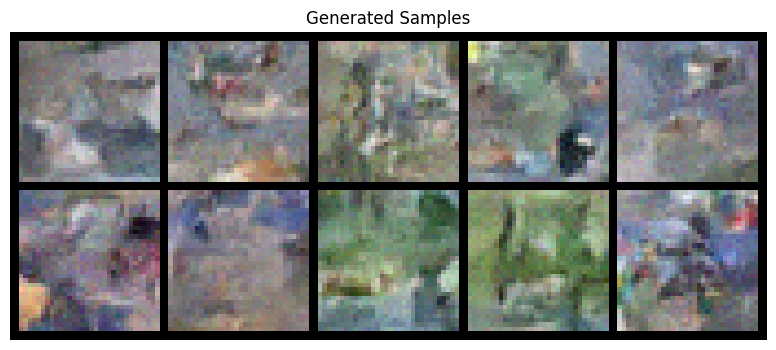

No improvement for 1/10 epochs

Epoch 20/50
--------------------
  Step 0/1250, Loss: 0.0963
  Step 100/1250, Loss: 0.0730
  Step 200/1250, Loss: 0.0966
  Step 300/1250, Loss: 0.0857
  Step 400/1250, Loss: 0.1037
  Step 500/1250, Loss: 0.0679
  Generating samples...


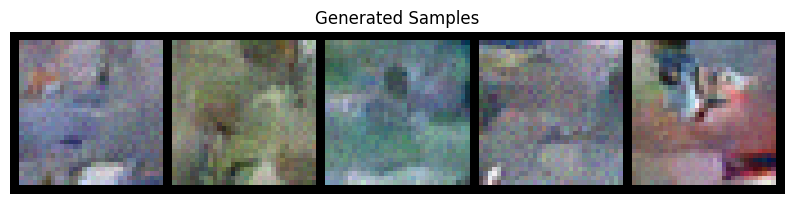

  Step 600/1250, Loss: 0.0835
  Step 700/1250, Loss: 0.0969
  Step 800/1250, Loss: 0.1042
  Step 900/1250, Loss: 0.1059
  Step 1000/1250, Loss: 0.0983
  Generating samples...


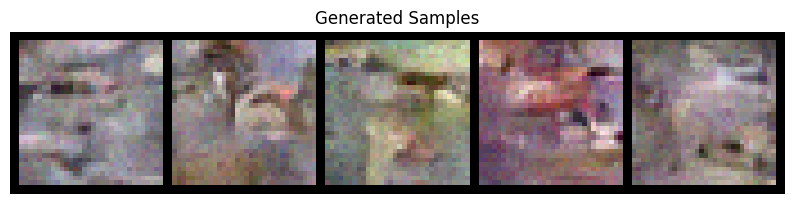

  Step 1100/1250, Loss: 0.1094
  Step 1200/1250, Loss: 0.1057

Training - Epoch 20 average loss: 0.1011
Running validation...
Validation - Epoch 20 average loss: 0.0995
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0995)

Epoch 21/50
--------------------
  Step 0/1250, Loss: 0.0759
  Step 100/1250, Loss: 0.0818
  Step 200/1250, Loss: 0.1428
  Step 300/1250, Loss: 0.0733
  Step 400/1250, Loss: 0.0797
  Step 500/1250, Loss: 0.1276
  Generating samples...


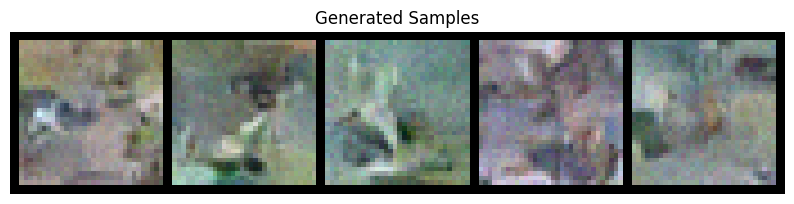

  Step 600/1250, Loss: 0.1090
  Step 700/1250, Loss: 0.1076
  Step 800/1250, Loss: 0.1007
  Step 900/1250, Loss: 0.0953
  Step 1000/1250, Loss: 0.0780
  Generating samples...


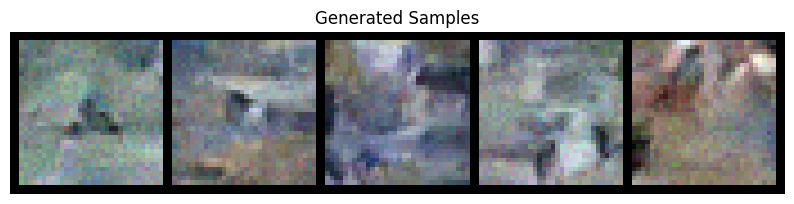

  Step 1100/1250, Loss: 0.1042
  Step 1200/1250, Loss: 0.0919

Training - Epoch 21 average loss: 0.1002
Running validation...
Validation - Epoch 21 average loss: 0.1018
Learning rate: 0.001000

Generating samples for visual progress check...


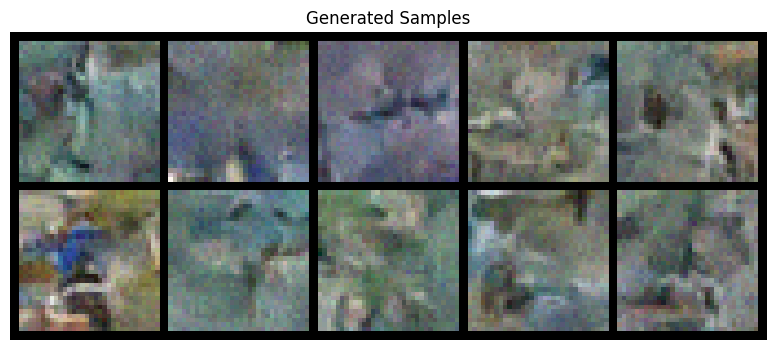

No improvement for 1/10 epochs


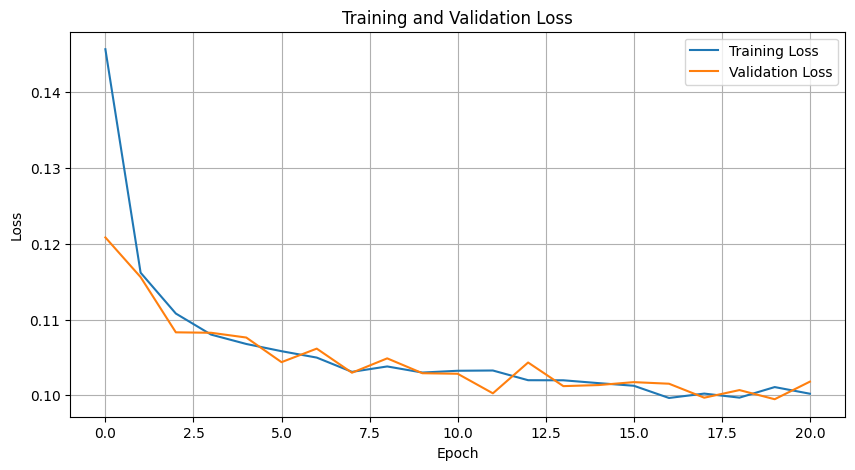


Epoch 22/50
--------------------
  Step 0/1250, Loss: 0.0870
  Step 100/1250, Loss: 0.0801
  Step 200/1250, Loss: 0.1004
  Step 300/1250, Loss: 0.1241
  Step 400/1250, Loss: 0.0906
  Step 500/1250, Loss: 0.1240
  Generating samples...


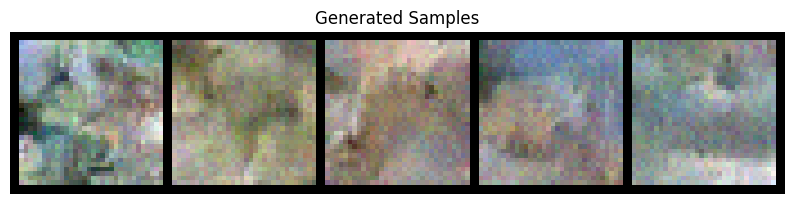

  Step 600/1250, Loss: 0.0878
  Step 700/1250, Loss: 0.0693
  Step 800/1250, Loss: 0.1165
  Step 900/1250, Loss: 0.0886
  Step 1000/1250, Loss: 0.0996
  Generating samples...


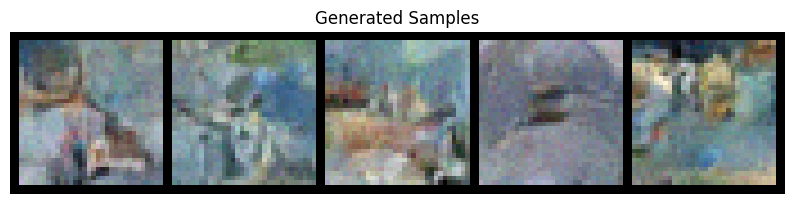

  Step 1100/1250, Loss: 0.0832
  Step 1200/1250, Loss: 0.1161

Training - Epoch 22 average loss: 0.1005
Running validation...
Validation - Epoch 22 average loss: 0.1004
Learning rate: 0.001000
No improvement for 2/10 epochs

Epoch 23/50
--------------------
  Step 0/1250, Loss: 0.1124
  Step 100/1250, Loss: 0.0843
  Step 200/1250, Loss: 0.1426
  Step 300/1250, Loss: 0.0940
  Step 400/1250, Loss: 0.0895
  Step 500/1250, Loss: 0.0886
  Generating samples...


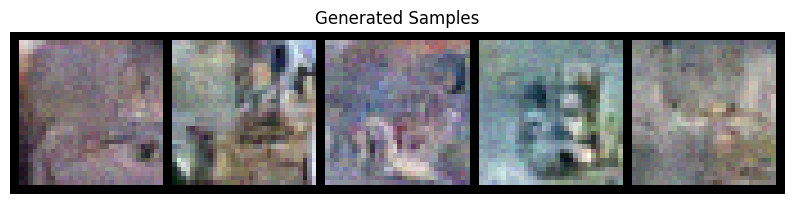

  Step 600/1250, Loss: 0.1417
  Step 700/1250, Loss: 0.0972
  Step 800/1250, Loss: 0.0750
  Step 900/1250, Loss: 0.1253
  Step 1000/1250, Loss: 0.0939
  Generating samples...


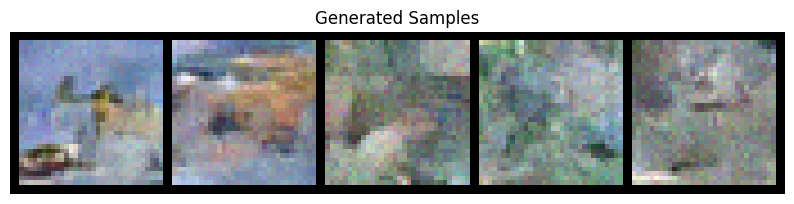

  Step 1100/1250, Loss: 0.1018
  Step 1200/1250, Loss: 0.1382

Training - Epoch 23 average loss: 0.1010
Running validation...
Validation - Epoch 23 average loss: 0.0991
Learning rate: 0.001000

Generating samples for visual progress check...


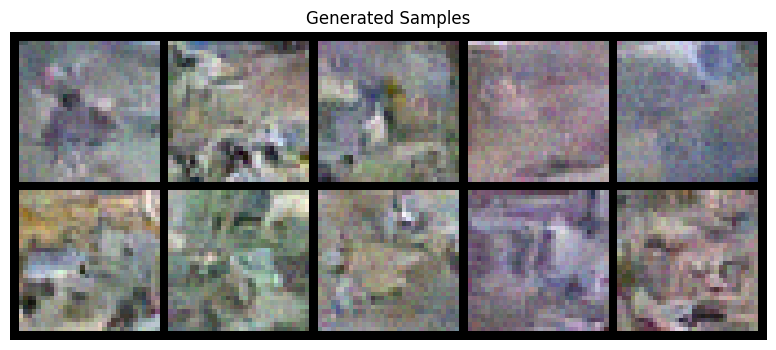

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0991)

Epoch 24/50
--------------------
  Step 0/1250, Loss: 0.0970
  Step 100/1250, Loss: 0.1075
  Step 200/1250, Loss: 0.1122
  Step 300/1250, Loss: 0.0619
  Step 400/1250, Loss: 0.1097
  Step 500/1250, Loss: 0.0717
  Generating samples...


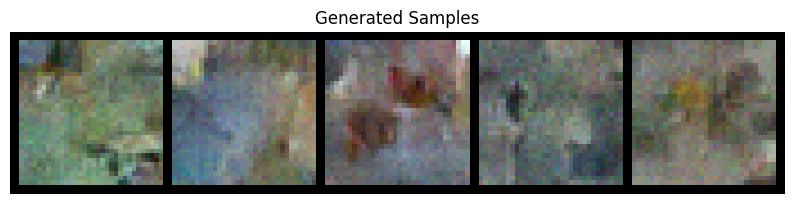

  Step 600/1250, Loss: 0.1431
  Step 700/1250, Loss: 0.0976
  Step 800/1250, Loss: 0.0785
  Step 900/1250, Loss: 0.0764
  Step 1000/1250, Loss: 0.0823
  Generating samples...


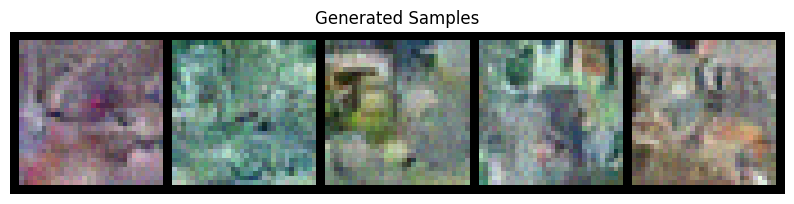

  Step 1100/1250, Loss: 0.0861
  Step 1200/1250, Loss: 0.1021

Training - Epoch 24 average loss: 0.1004
Running validation...
Validation - Epoch 24 average loss: 0.1006
Learning rate: 0.001000
No improvement for 1/10 epochs

Epoch 25/50
--------------------
  Step 0/1250, Loss: 0.0880
  Step 100/1250, Loss: 0.1025
  Step 200/1250, Loss: 0.1029
  Step 300/1250, Loss: 0.1115
  Step 400/1250, Loss: 0.1059
  Step 500/1250, Loss: 0.1045
  Generating samples...


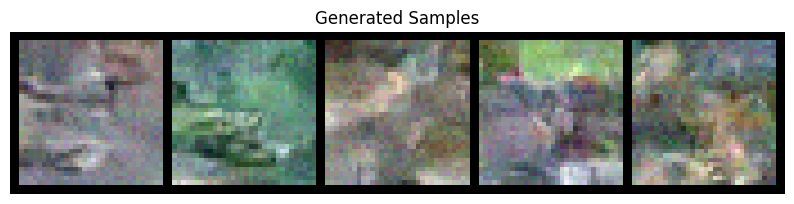

  Step 600/1250, Loss: 0.0696
  Step 700/1250, Loss: 0.1099
  Step 800/1250, Loss: 0.0766
  Step 900/1250, Loss: 0.1084
  Step 1000/1250, Loss: 0.0920
  Generating samples...


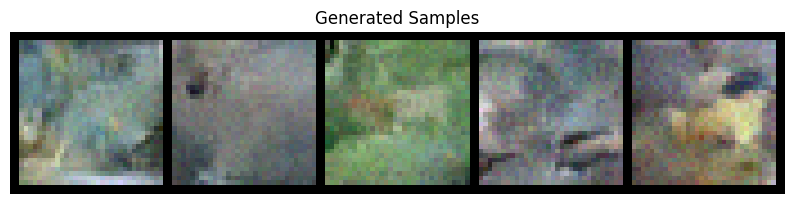

  Step 1100/1250, Loss: 0.1030
  Step 1200/1250, Loss: 0.1368

Training - Epoch 25 average loss: 0.1000
Running validation...
Validation - Epoch 25 average loss: 0.1008
Learning rate: 0.001000

Generating samples for visual progress check...


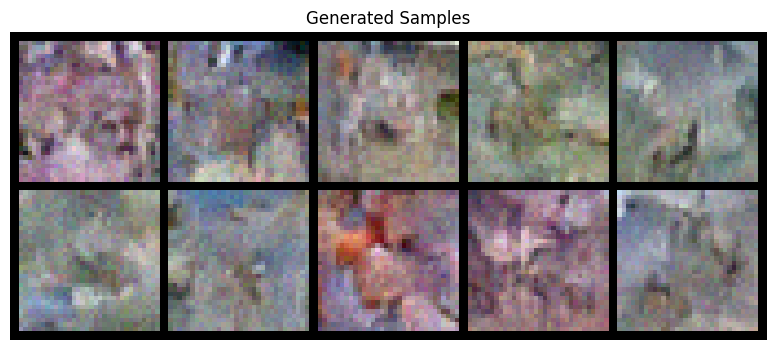

No improvement for 2/10 epochs

Epoch 26/50
--------------------
  Step 0/1250, Loss: 0.1164
  Step 100/1250, Loss: 0.1213
  Step 200/1250, Loss: 0.1217
  Step 300/1250, Loss: 0.1022
  Step 400/1250, Loss: 0.1257
  Step 500/1250, Loss: 0.0841
  Generating samples...


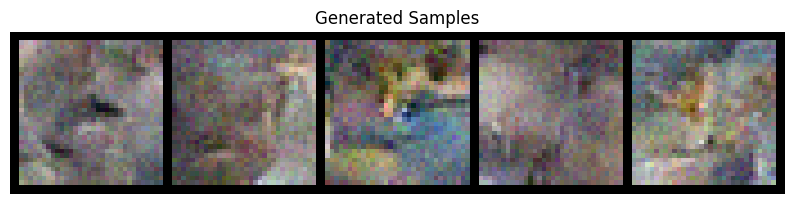

  Step 600/1250, Loss: 0.0814
  Step 700/1250, Loss: 0.0791
  Step 800/1250, Loss: 0.1331
  Step 900/1250, Loss: 0.1034
  Step 1000/1250, Loss: 0.1048
  Generating samples...


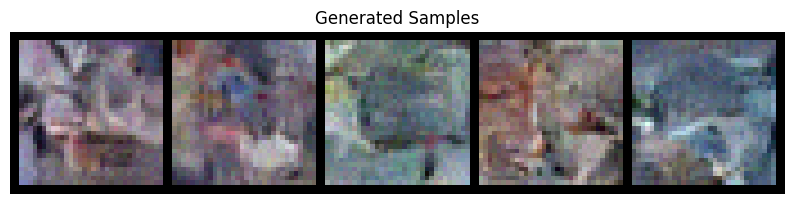

  Step 1100/1250, Loss: 0.0807
  Step 1200/1250, Loss: 0.0921

Training - Epoch 26 average loss: 0.0998
Running validation...
Validation - Epoch 26 average loss: 0.1020
Learning rate: 0.001000
No improvement for 3/10 epochs


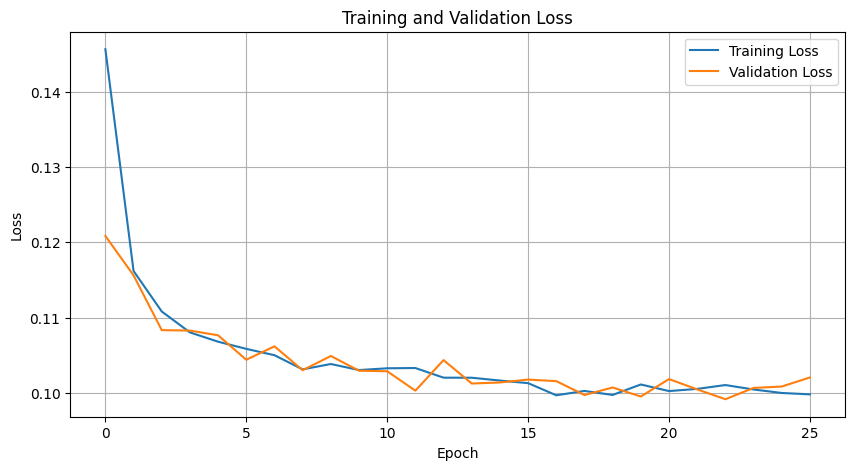


Epoch 27/50
--------------------
  Step 0/1250, Loss: 0.0943
  Step 100/1250, Loss: 0.1260
  Step 200/1250, Loss: 0.1142
  Step 300/1250, Loss: 0.0760
  Step 400/1250, Loss: 0.0958
  Step 500/1250, Loss: 0.1070
  Generating samples...


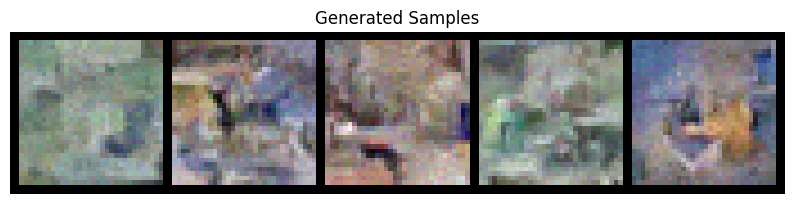

  Step 600/1250, Loss: 0.0891
  Step 700/1250, Loss: 0.1194
  Step 800/1250, Loss: 0.1051
  Step 900/1250, Loss: 0.0674
  Step 1000/1250, Loss: 0.0993
  Generating samples...


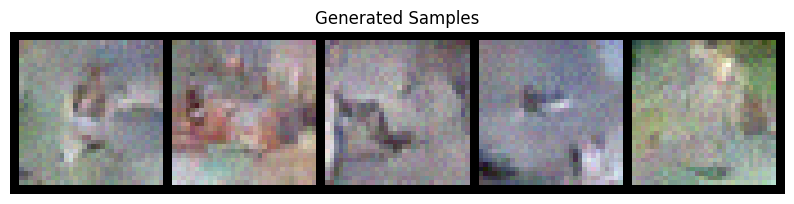

  Step 1100/1250, Loss: 0.1035
  Step 1200/1250, Loss: 0.1556

Training - Epoch 27 average loss: 0.0995
Running validation...
Validation - Epoch 27 average loss: 0.0996
Learning rate: 0.001000

Generating samples for visual progress check...


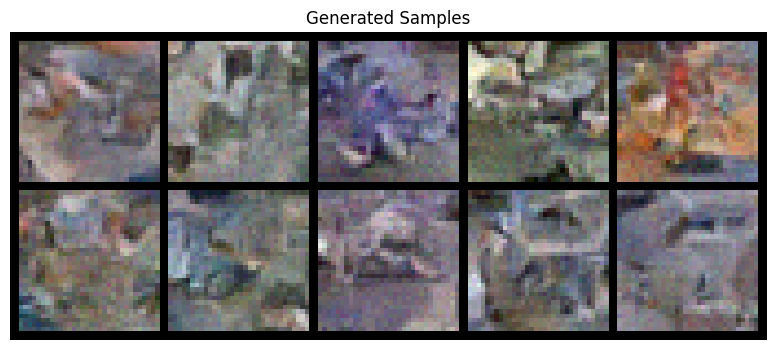

No improvement for 4/10 epochs

Epoch 28/50
--------------------
  Step 0/1250, Loss: 0.1072
  Step 100/1250, Loss: 0.0792
  Step 200/1250, Loss: 0.0769
  Step 300/1250, Loss: 0.1553
  Step 400/1250, Loss: 0.0916
  Step 500/1250, Loss: 0.0862
  Generating samples...


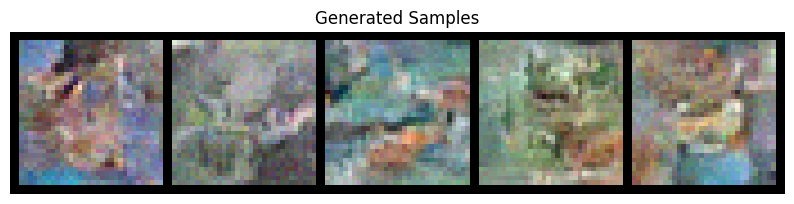

  Step 600/1250, Loss: 0.0879
  Step 700/1250, Loss: 0.0859
  Step 800/1250, Loss: 0.0946
  Step 900/1250, Loss: 0.1034
  Step 1000/1250, Loss: 0.0996
  Generating samples...


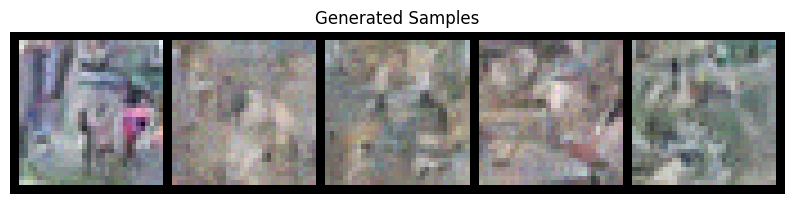

  Step 1100/1250, Loss: 0.1156
  Step 1200/1250, Loss: 0.1038

Training - Epoch 28 average loss: 0.0995
Running validation...
Validation - Epoch 28 average loss: 0.1000
Learning rate: 0.001000
No improvement for 5/10 epochs

Epoch 29/50
--------------------
  Step 0/1250, Loss: 0.0886
  Step 100/1250, Loss: 0.1349
  Step 200/1250, Loss: 0.0802
  Step 300/1250, Loss: 0.1069
  Step 400/1250, Loss: 0.1096
  Step 500/1250, Loss: 0.0898
  Generating samples...


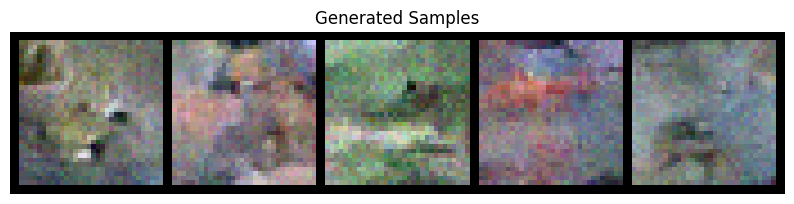

  Step 600/1250, Loss: 0.1244
  Step 700/1250, Loss: 0.1107
  Step 800/1250, Loss: 0.1084
  Step 900/1250, Loss: 0.0859
  Step 1000/1250, Loss: 0.0879
  Generating samples...


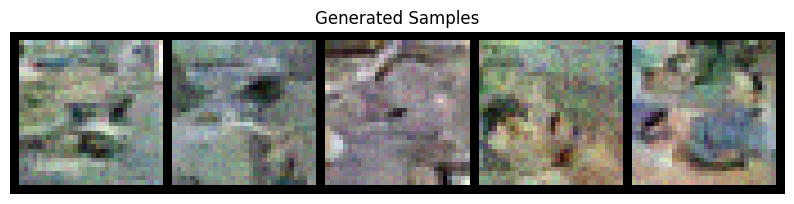

  Step 1100/1250, Loss: 0.1010
  Step 1200/1250, Loss: 0.1313

Training - Epoch 29 average loss: 0.0995
Running validation...
Validation - Epoch 29 average loss: 0.0998
Learning rate: 0.000500

Generating samples for visual progress check...


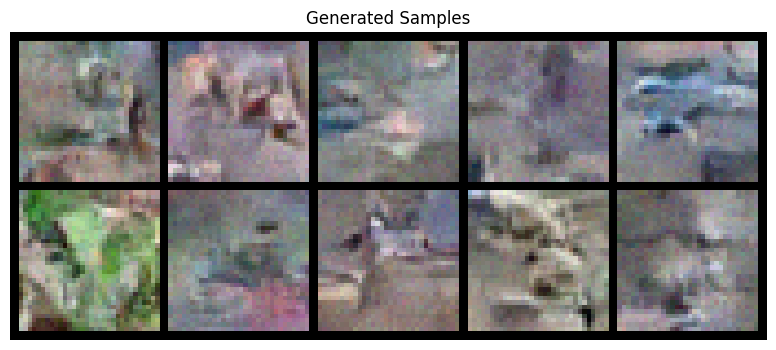

No improvement for 6/10 epochs

Epoch 30/50
--------------------
  Step 0/1250, Loss: 0.0832
  Step 100/1250, Loss: 0.1282
  Step 200/1250, Loss: 0.1404
  Step 300/1250, Loss: 0.0881
  Step 400/1250, Loss: 0.0735
  Step 500/1250, Loss: 0.0955
  Generating samples...


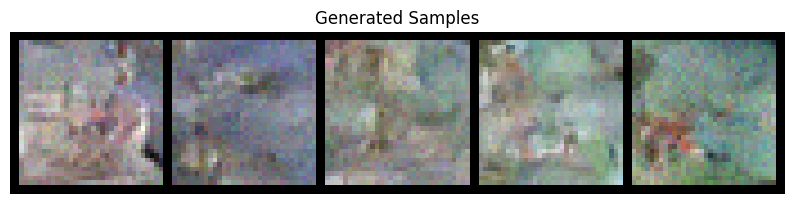

  Step 600/1250, Loss: 0.0922
  Step 700/1250, Loss: 0.0896
  Step 800/1250, Loss: 0.0851
  Step 900/1250, Loss: 0.1104
  Step 1000/1250, Loss: 0.0808
  Generating samples...


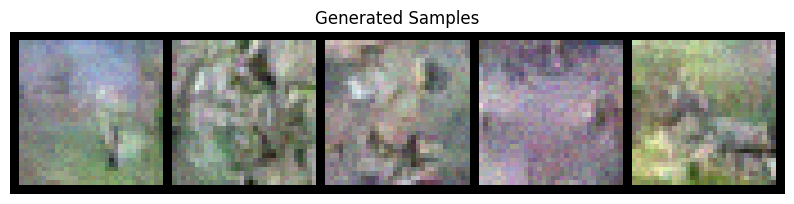

  Step 1100/1250, Loss: 0.1057
  Step 1200/1250, Loss: 0.0943

Training - Epoch 30 average loss: 0.0986
Running validation...
Validation - Epoch 30 average loss: 0.0988
Learning rate: 0.000500
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0988)

Epoch 31/50
--------------------
  Step 0/1250, Loss: 0.0974
  Step 100/1250, Loss: 0.1319
  Step 200/1250, Loss: 0.1173
  Step 300/1250, Loss: 0.1219
  Step 400/1250, Loss: 0.0904
  Step 500/1250, Loss: 0.1194
  Generating samples...


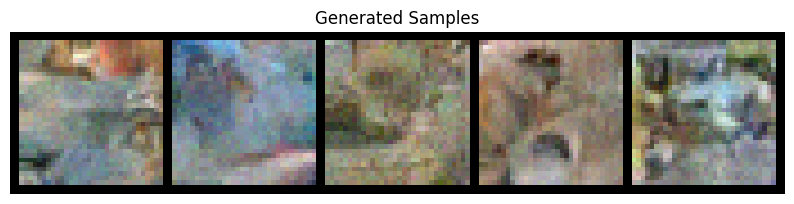

  Step 600/1250, Loss: 0.0732
  Step 700/1250, Loss: 0.1027
  Step 800/1250, Loss: 0.0801
  Step 900/1250, Loss: 0.0723
  Step 1000/1250, Loss: 0.0643
  Generating samples...


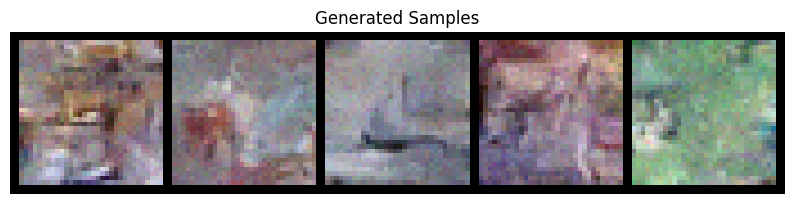

  Step 1100/1250, Loss: 0.0888
  Step 1200/1250, Loss: 0.1093

Training - Epoch 31 average loss: 0.0976
Running validation...
Validation - Epoch 31 average loss: 0.1006
Learning rate: 0.000500

Generating samples for visual progress check...


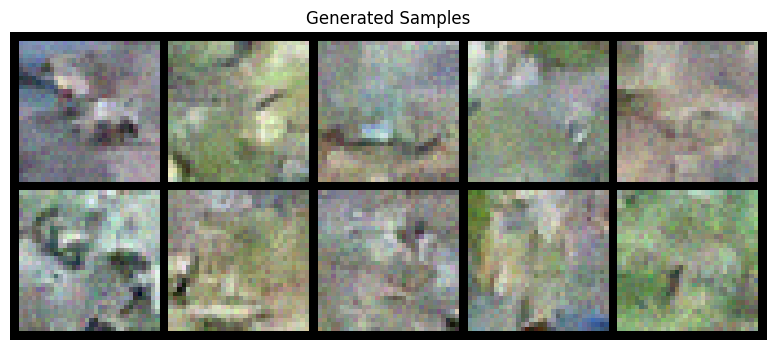

No improvement for 1/10 epochs


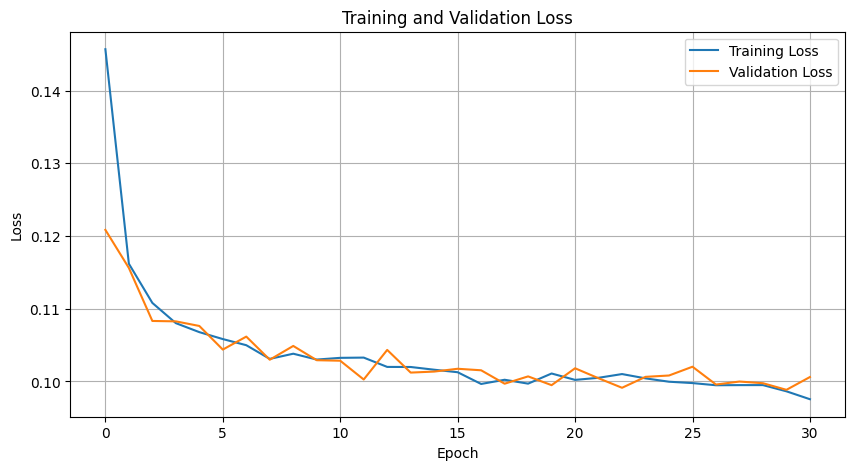


Epoch 32/50
--------------------
  Step 0/1250, Loss: 0.0760
  Step 100/1250, Loss: 0.0948
  Step 200/1250, Loss: 0.1250
  Step 300/1250, Loss: 0.0894
  Step 400/1250, Loss: 0.1003
  Step 500/1250, Loss: 0.1221
  Generating samples...


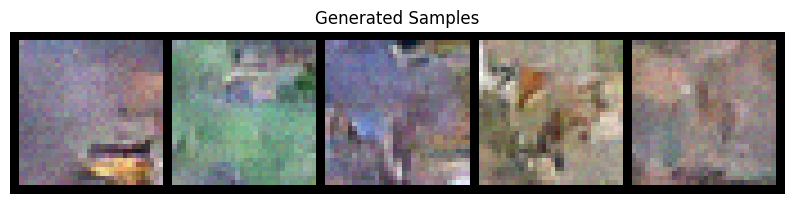

  Step 600/1250, Loss: 0.1062
  Step 700/1250, Loss: 0.0928
  Step 800/1250, Loss: 0.1259
  Step 900/1250, Loss: 0.0915
  Step 1000/1250, Loss: 0.0940
  Generating samples...


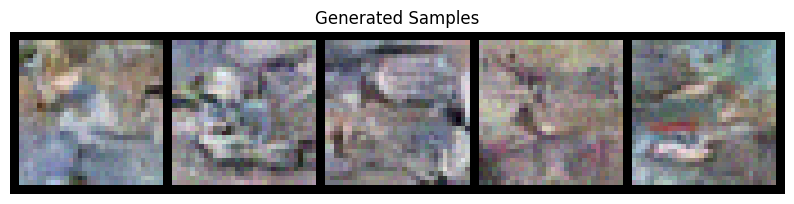

  Step 1100/1250, Loss: 0.0819
  Step 1200/1250, Loss: 0.1175

Training - Epoch 32 average loss: 0.0979
Running validation...
Validation - Epoch 32 average loss: 0.0975
Learning rate: 0.000500
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0975)

Epoch 33/50
--------------------
  Step 0/1250, Loss: 0.0823
  Step 100/1250, Loss: 0.0874
  Step 200/1250, Loss: 0.1262
  Step 300/1250, Loss: 0.1050
  Step 400/1250, Loss: 0.1059
  Step 500/1250, Loss: 0.0836
  Generating samples...


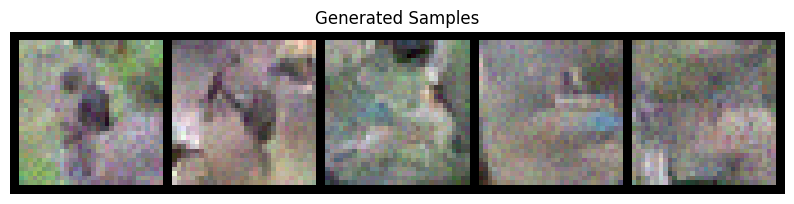

  Step 600/1250, Loss: 0.0882
  Step 700/1250, Loss: 0.1218
  Step 800/1250, Loss: 0.0813
  Step 900/1250, Loss: 0.1290
  Step 1000/1250, Loss: 0.1060
  Generating samples...


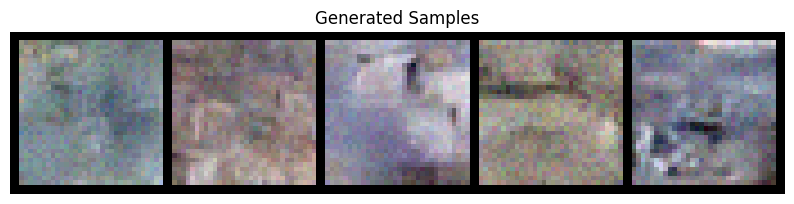

  Step 1100/1250, Loss: 0.1083
  Step 1200/1250, Loss: 0.1202

Training - Epoch 33 average loss: 0.0983
Running validation...
Validation - Epoch 33 average loss: 0.0991
Learning rate: 0.000500

Generating samples for visual progress check...


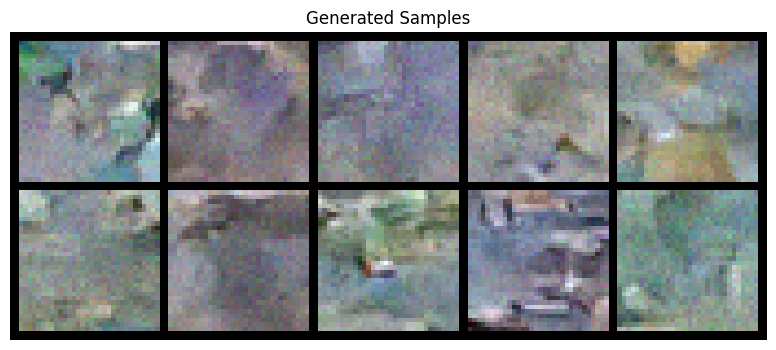

No improvement for 1/10 epochs

Epoch 34/50
--------------------
  Step 0/1250, Loss: 0.1278
  Step 100/1250, Loss: 0.0856
  Step 200/1250, Loss: 0.0953
  Step 300/1250, Loss: 0.1156
  Step 400/1250, Loss: 0.0737
  Step 500/1250, Loss: 0.0858
  Generating samples...


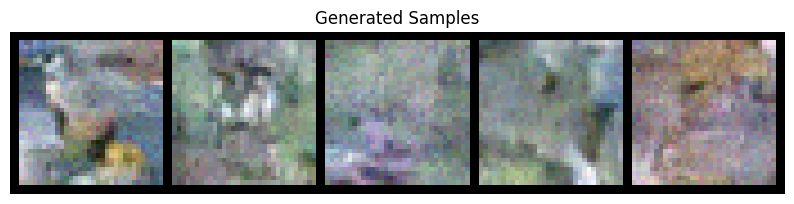

  Step 600/1250, Loss: 0.0977
  Step 700/1250, Loss: 0.1053
  Step 800/1250, Loss: 0.1011
  Step 900/1250, Loss: 0.1128
  Step 1000/1250, Loss: 0.0703
  Generating samples...


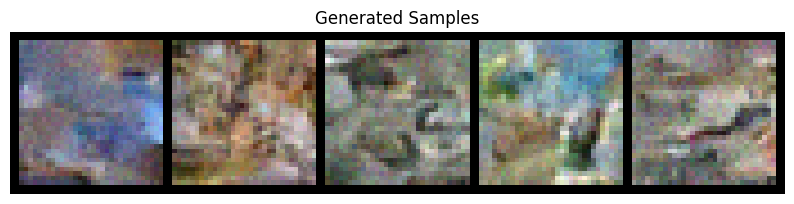

  Step 1100/1250, Loss: 0.0809
  Step 1200/1250, Loss: 0.0952

Training - Epoch 34 average loss: 0.0987
Running validation...
Validation - Epoch 34 average loss: 0.0995
Learning rate: 0.000500
No improvement for 2/10 epochs

Epoch 35/50
--------------------
  Step 0/1250, Loss: 0.1074
  Step 100/1250, Loss: 0.0865
  Step 200/1250, Loss: 0.0721
  Step 300/1250, Loss: 0.0740
  Step 400/1250, Loss: 0.1014
  Step 500/1250, Loss: 0.1267
  Generating samples...


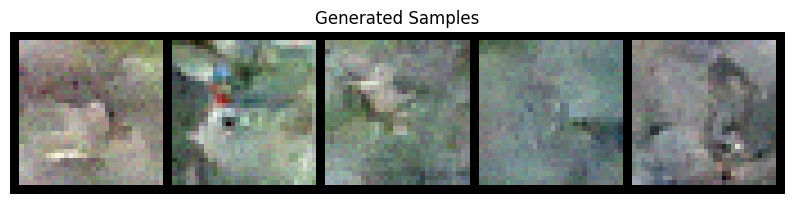

  Step 600/1250, Loss: 0.0958
  Step 700/1250, Loss: 0.1058
  Step 800/1250, Loss: 0.1126
  Step 900/1250, Loss: 0.0949
  Step 1000/1250, Loss: 0.1383
  Generating samples...


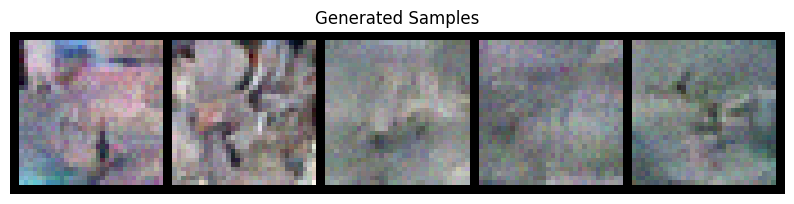

  Step 1100/1250, Loss: 0.0720
  Step 1200/1250, Loss: 0.1045

Training - Epoch 35 average loss: 0.0987
Running validation...
Validation - Epoch 35 average loss: 0.0989
Learning rate: 0.000500

Generating samples for visual progress check...


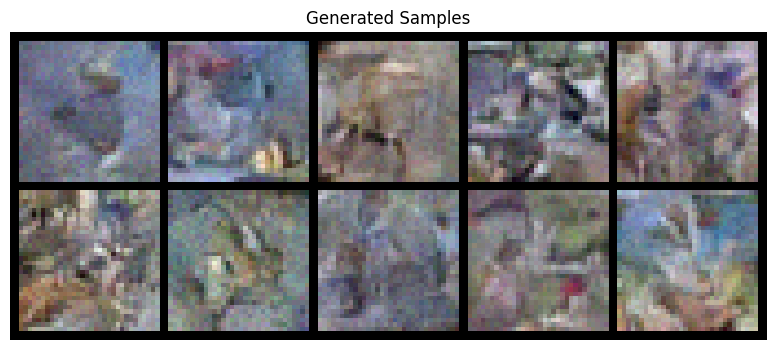

No improvement for 3/10 epochs

Epoch 36/50
--------------------
  Step 0/1250, Loss: 0.0822
  Step 100/1250, Loss: 0.1046
  Step 200/1250, Loss: 0.0920
  Step 300/1250, Loss: 0.0816
  Step 400/1250, Loss: 0.0879
  Step 500/1250, Loss: 0.1182
  Generating samples...


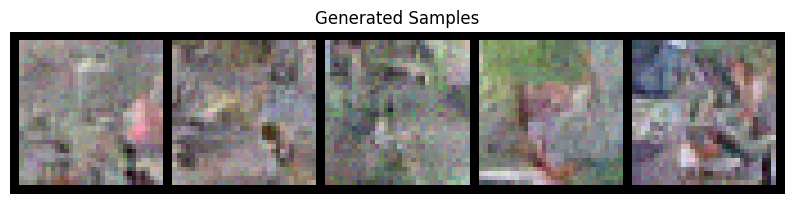

  Step 600/1250, Loss: 0.0632
  Step 700/1250, Loss: 0.0718
  Step 800/1250, Loss: 0.1025
  Step 900/1250, Loss: 0.1125
  Step 1000/1250, Loss: 0.0834
  Generating samples...


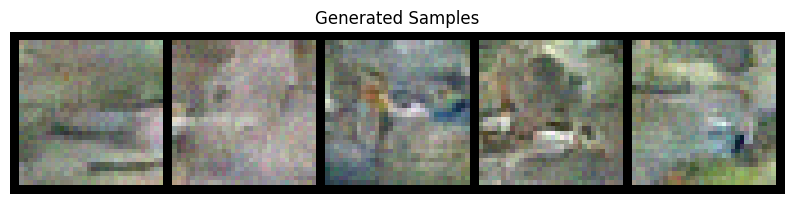

  Step 1100/1250, Loss: 0.1092
  Step 1200/1250, Loss: 0.0822

Training - Epoch 36 average loss: 0.0983
Running validation...
Validation - Epoch 36 average loss: 0.0987
Learning rate: 0.000500
No improvement for 4/10 epochs


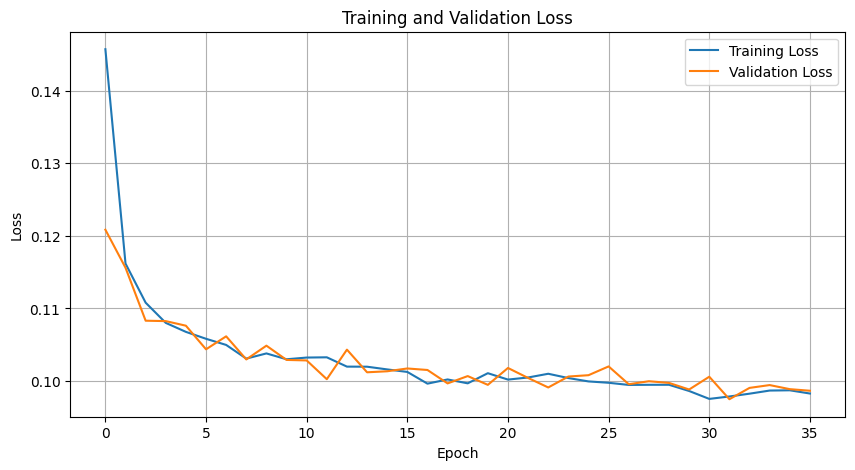


Epoch 37/50
--------------------
  Step 0/1250, Loss: 0.1053
  Step 100/1250, Loss: 0.1064
  Step 200/1250, Loss: 0.1084
  Step 300/1250, Loss: 0.1505
  Step 400/1250, Loss: 0.0863
  Step 500/1250, Loss: 0.0881
  Generating samples...


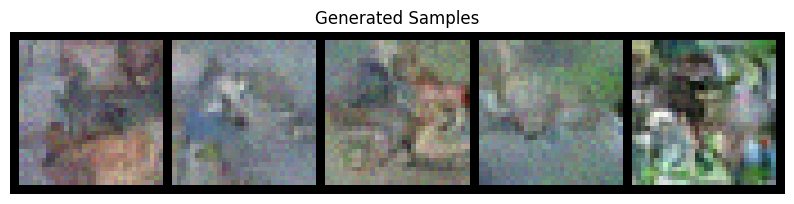

  Step 600/1250, Loss: 0.0918
  Step 700/1250, Loss: 0.0957
  Step 800/1250, Loss: 0.0819
  Step 900/1250, Loss: 0.0726
  Step 1000/1250, Loss: 0.0814
  Generating samples...


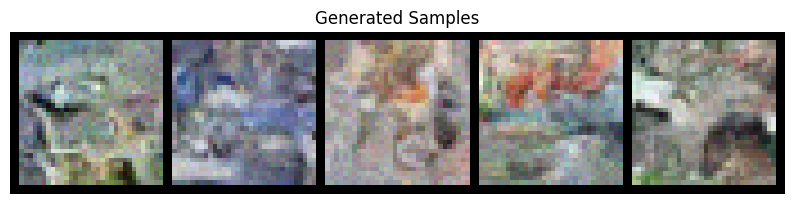

  Step 1100/1250, Loss: 0.0640
  Step 1200/1250, Loss: 0.1640

Training - Epoch 37 average loss: 0.0982
Running validation...
Validation - Epoch 37 average loss: 0.0966
Learning rate: 0.000500

Generating samples for visual progress check...


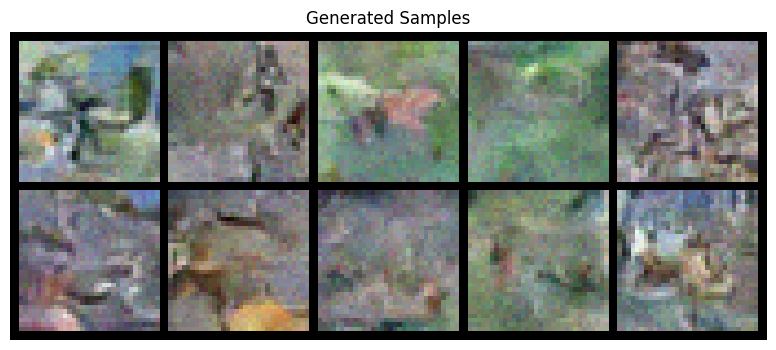

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0966)

Epoch 38/50
--------------------
  Step 0/1250, Loss: 0.1045
  Step 100/1250, Loss: 0.1091
  Step 200/1250, Loss: 0.1250
  Step 300/1250, Loss: 0.0987
  Step 400/1250, Loss: 0.0835
  Step 500/1250, Loss: 0.0879
  Generating samples...


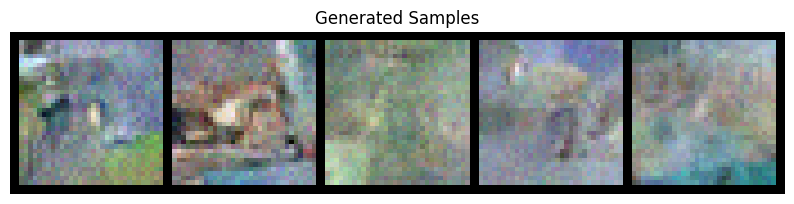

  Step 600/1250, Loss: 0.0707
  Step 700/1250, Loss: 0.0943
  Step 800/1250, Loss: 0.0871
  Step 900/1250, Loss: 0.1330
  Step 1000/1250, Loss: 0.1024
  Generating samples...


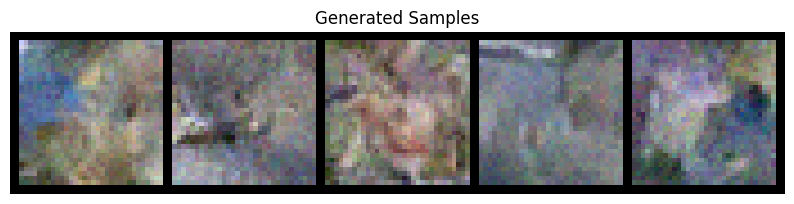

  Step 1100/1250, Loss: 0.1028
  Step 1200/1250, Loss: 0.0888

Training - Epoch 38 average loss: 0.0980
Running validation...
Validation - Epoch 38 average loss: 0.0975
Learning rate: 0.000500
No improvement for 1/10 epochs

Epoch 39/50
--------------------
  Step 0/1250, Loss: 0.1121
  Step 100/1250, Loss: 0.0822
  Step 200/1250, Loss: 0.0960
  Step 300/1250, Loss: 0.1375
  Step 400/1250, Loss: 0.0994
  Step 500/1250, Loss: 0.0732
  Generating samples...


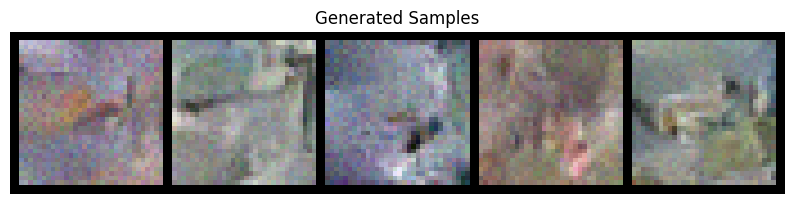

  Step 600/1250, Loss: 0.0994
  Step 700/1250, Loss: 0.1257
  Step 800/1250, Loss: 0.0891
  Step 900/1250, Loss: 0.0948
  Step 1000/1250, Loss: 0.0929
  Generating samples...


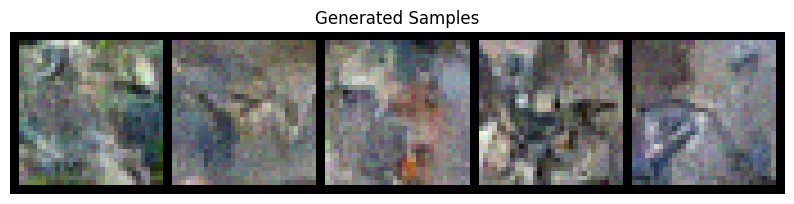

  Step 1100/1250, Loss: 0.0920
  Step 1200/1250, Loss: 0.1015

Training - Epoch 39 average loss: 0.0972
Running validation...
Validation - Epoch 39 average loss: 0.1007
Learning rate: 0.000500

Generating samples for visual progress check...


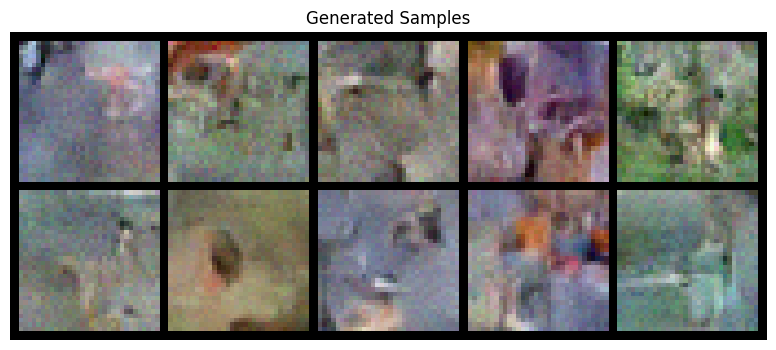

No improvement for 2/10 epochs

Epoch 40/50
--------------------
  Step 0/1250, Loss: 0.1061
  Step 100/1250, Loss: 0.0787
  Step 200/1250, Loss: 0.1191
  Step 300/1250, Loss: 0.0837
  Step 400/1250, Loss: 0.0908
  Step 500/1250, Loss: 0.1184
  Generating samples...


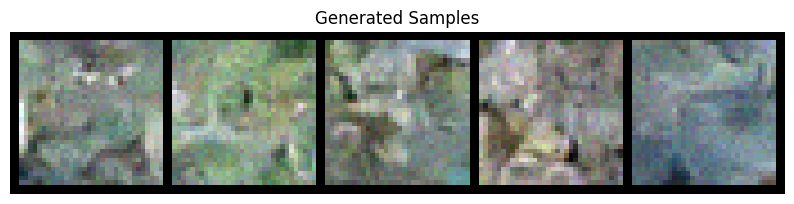

  Step 600/1250, Loss: 0.1292
  Step 700/1250, Loss: 0.0873
  Step 800/1250, Loss: 0.0978
  Step 900/1250, Loss: 0.1351
  Step 1000/1250, Loss: 0.0786
  Generating samples...


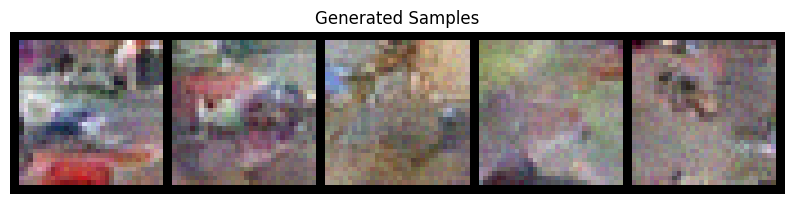

  Step 1100/1250, Loss: 0.0746
  Step 1200/1250, Loss: 0.1283

Training - Epoch 40 average loss: 0.0989
Running validation...
Validation - Epoch 40 average loss: 0.0986
Learning rate: 0.000500
No improvement for 3/10 epochs

Epoch 41/50
--------------------
  Step 0/1250, Loss: 0.0681
  Step 100/1250, Loss: 0.0803
  Step 200/1250, Loss: 0.0858
  Step 300/1250, Loss: 0.1295
  Step 400/1250, Loss: 0.0781
  Step 500/1250, Loss: 0.0848
  Generating samples...


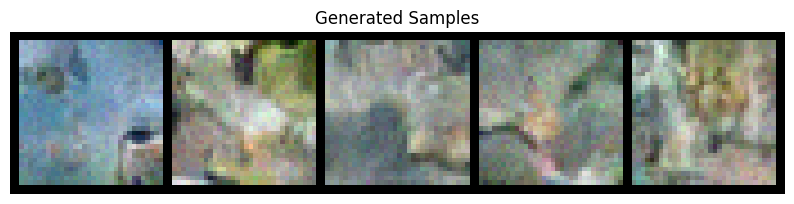

  Step 600/1250, Loss: 0.0815
  Step 700/1250, Loss: 0.0616
  Step 800/1250, Loss: 0.0790
  Step 900/1250, Loss: 0.0816
  Step 1000/1250, Loss: 0.1027
  Generating samples...


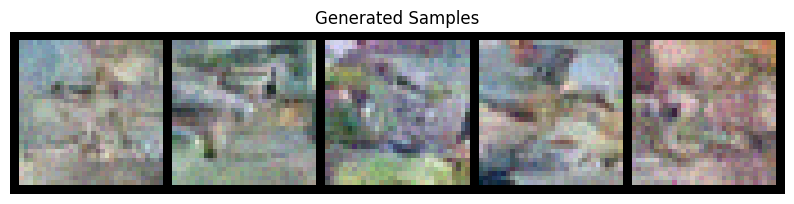

  Step 1100/1250, Loss: 0.0971
  Step 1200/1250, Loss: 0.1224

Training - Epoch 41 average loss: 0.0979
Running validation...
Validation - Epoch 41 average loss: 0.0975
Learning rate: 0.000500

Generating samples for visual progress check...


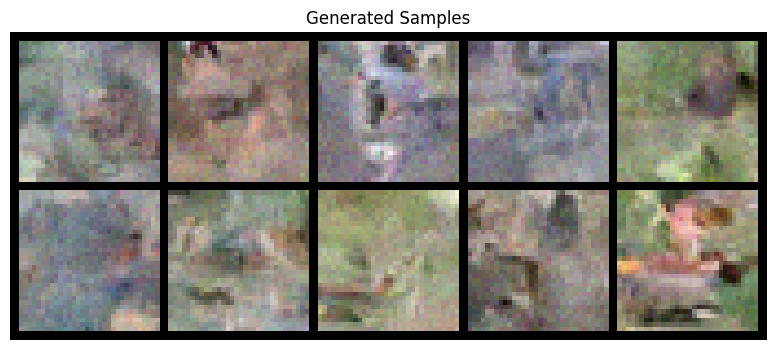

No improvement for 4/10 epochs


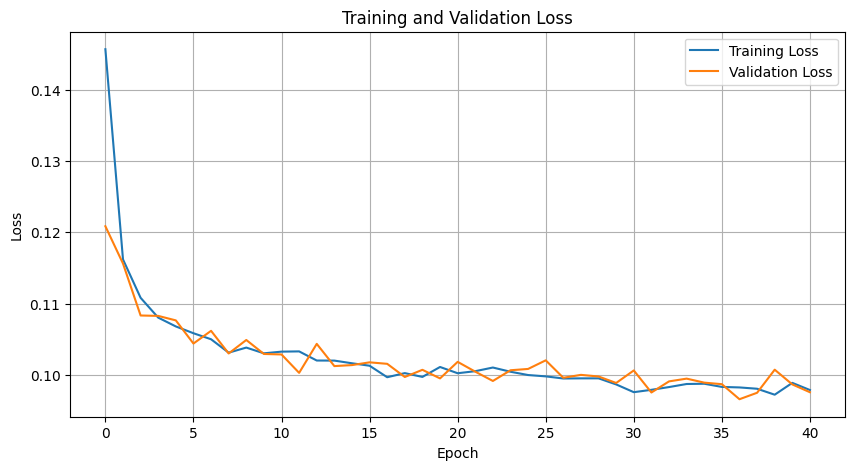


Epoch 42/50
--------------------
  Step 0/1250, Loss: 0.0973
  Step 100/1250, Loss: 0.0879
  Step 200/1250, Loss: 0.1081
  Step 300/1250, Loss: 0.0942
  Step 400/1250, Loss: 0.0943
  Step 500/1250, Loss: 0.0755
  Generating samples...


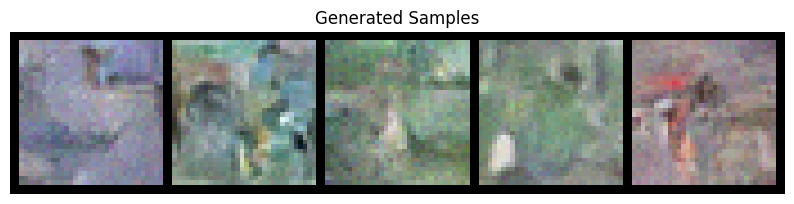

  Step 600/1250, Loss: 0.1120
  Step 700/1250, Loss: 0.0804
  Step 800/1250, Loss: 0.1277
  Step 900/1250, Loss: 0.1198
  Step 1000/1250, Loss: 0.0635
  Generating samples...


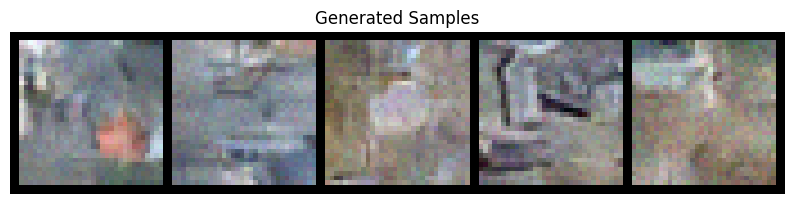

  Step 1100/1250, Loss: 0.1050
  Step 1200/1250, Loss: 0.0781

Training - Epoch 42 average loss: 0.0989
Running validation...
Validation - Epoch 42 average loss: 0.0986
Learning rate: 0.000500
No improvement for 5/10 epochs

Epoch 43/50
--------------------
  Step 0/1250, Loss: 0.1135
  Step 100/1250, Loss: 0.0809
  Step 200/1250, Loss: 0.0827
  Step 300/1250, Loss: 0.0818
  Step 400/1250, Loss: 0.1269
  Step 500/1250, Loss: 0.1076
  Generating samples...


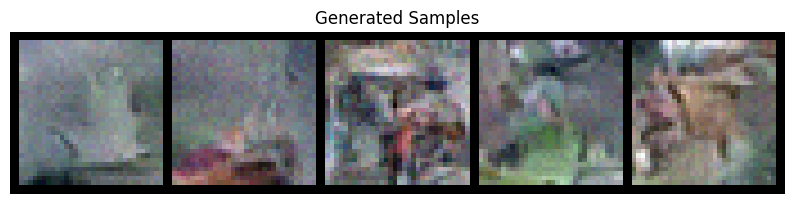

  Step 600/1250, Loss: 0.0999
  Step 700/1250, Loss: 0.1216
  Step 800/1250, Loss: 0.1019
  Step 900/1250, Loss: 0.1280
  Step 1000/1250, Loss: 0.0711
  Generating samples...


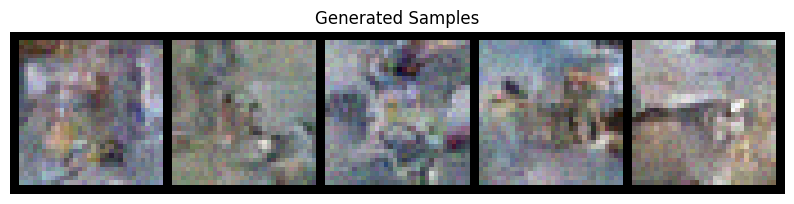

  Step 1100/1250, Loss: 0.0876
  Step 1200/1250, Loss: 0.1058

Training - Epoch 43 average loss: 0.0976
Running validation...
Validation - Epoch 43 average loss: 0.0996
Learning rate: 0.000250

Generating samples for visual progress check...


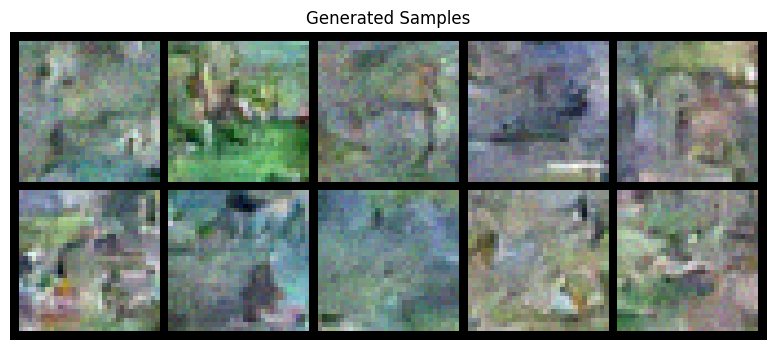

No improvement for 6/10 epochs

Epoch 44/50
--------------------
  Step 0/1250, Loss: 0.0757
  Step 100/1250, Loss: 0.0799
  Step 200/1250, Loss: 0.1021
  Step 300/1250, Loss: 0.0735
  Step 400/1250, Loss: 0.0873
  Step 500/1250, Loss: 0.1150
  Generating samples...


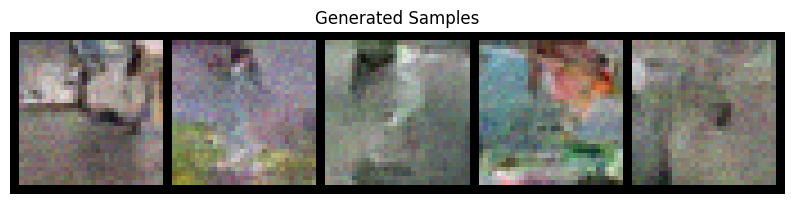

  Step 600/1250, Loss: 0.0739
  Step 700/1250, Loss: 0.1080
  Step 800/1250, Loss: 0.0971
  Step 900/1250, Loss: 0.1051
  Step 1000/1250, Loss: 0.0987
  Generating samples...


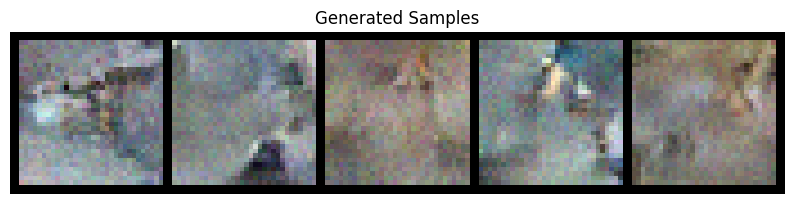

  Step 1100/1250, Loss: 0.1225
  Step 1200/1250, Loss: 0.0998

Training - Epoch 44 average loss: 0.0979
Running validation...
Validation - Epoch 44 average loss: 0.0979
Learning rate: 0.000250
No improvement for 7/10 epochs

Epoch 45/50
--------------------
  Step 0/1250, Loss: 0.0757
  Step 100/1250, Loss: 0.0808
  Step 200/1250, Loss: 0.0976
  Step 300/1250, Loss: 0.0822
  Step 400/1250, Loss: 0.0909
  Step 500/1250, Loss: 0.0931
  Generating samples...


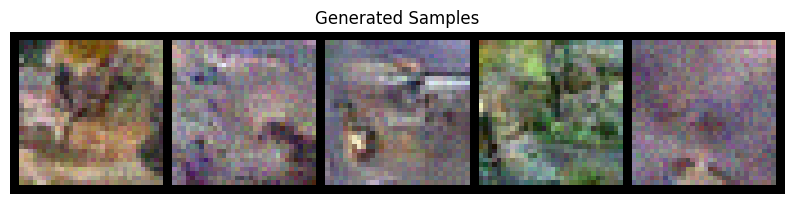

  Step 600/1250, Loss: 0.0820
  Step 700/1250, Loss: 0.0925
  Step 800/1250, Loss: 0.1393
  Step 900/1250, Loss: 0.0720
  Step 1000/1250, Loss: 0.0807
  Generating samples...


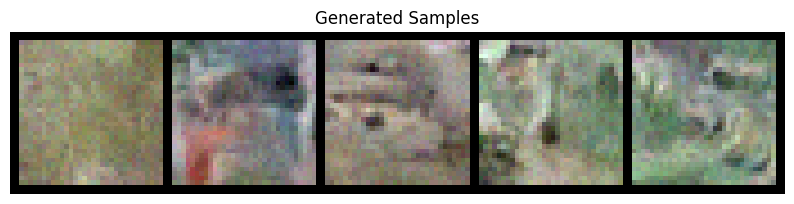

  Step 1100/1250, Loss: 0.0835
  Step 1200/1250, Loss: 0.1160

Training - Epoch 45 average loss: 0.0968
Running validation...
Validation - Epoch 45 average loss: 0.0971
Learning rate: 0.000250

Generating samples for visual progress check...


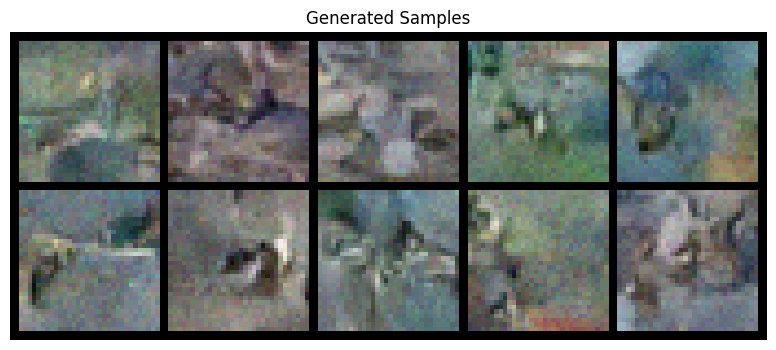

No improvement for 8/10 epochs

Epoch 46/50
--------------------
  Step 0/1250, Loss: 0.1096
  Step 100/1250, Loss: 0.1055
  Step 200/1250, Loss: 0.0707
  Step 300/1250, Loss: 0.0732
  Step 400/1250, Loss: 0.1175
  Step 500/1250, Loss: 0.0710
  Generating samples...


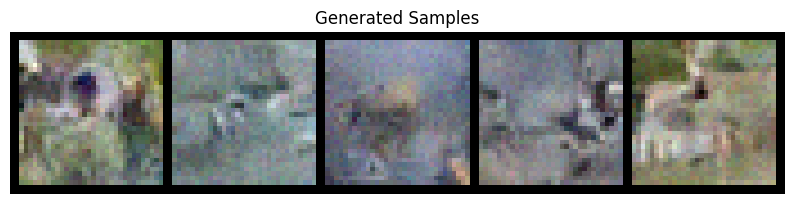

  Step 600/1250, Loss: 0.0833
  Step 700/1250, Loss: 0.1037
  Step 800/1250, Loss: 0.1037
  Step 900/1250, Loss: 0.0772
  Step 1000/1250, Loss: 0.0714
  Generating samples...


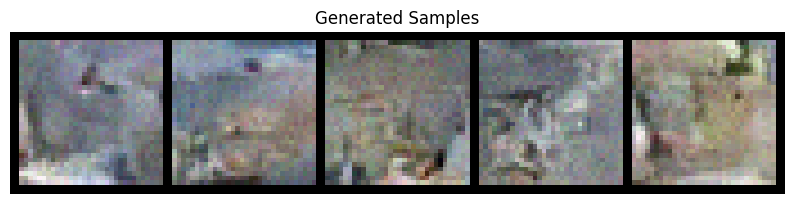

  Step 1100/1250, Loss: 0.1048
  Step 1200/1250, Loss: 0.1102

Training - Epoch 46 average loss: 0.0975
Running validation...
Validation - Epoch 46 average loss: 0.0955
Learning rate: 0.000250
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0955)


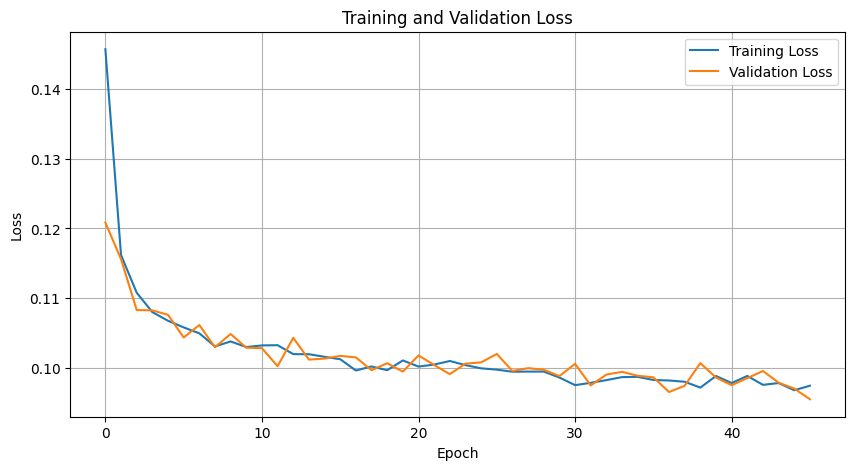


Epoch 47/50
--------------------
  Step 0/1250, Loss: 0.0978
  Step 100/1250, Loss: 0.1220
  Step 200/1250, Loss: 0.0904
  Step 300/1250, Loss: 0.0897
  Step 400/1250, Loss: 0.0684
  Step 500/1250, Loss: 0.0854
  Generating samples...


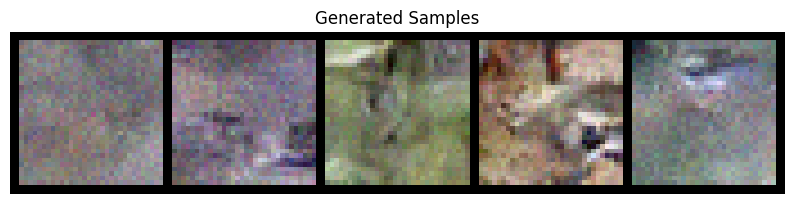

  Step 600/1250, Loss: 0.0875
  Step 700/1250, Loss: 0.0907
  Step 800/1250, Loss: 0.0902
  Step 900/1250, Loss: 0.0886
  Step 1000/1250, Loss: 0.0970
  Generating samples...


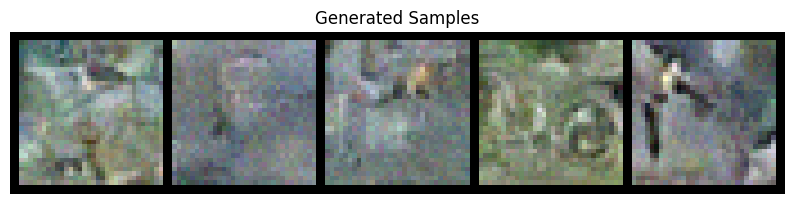

  Step 1100/1250, Loss: 0.1124
  Step 1200/1250, Loss: 0.1153

Training - Epoch 47 average loss: 0.0977
Running validation...
Validation - Epoch 47 average loss: 0.0977
Learning rate: 0.000250

Generating samples for visual progress check...


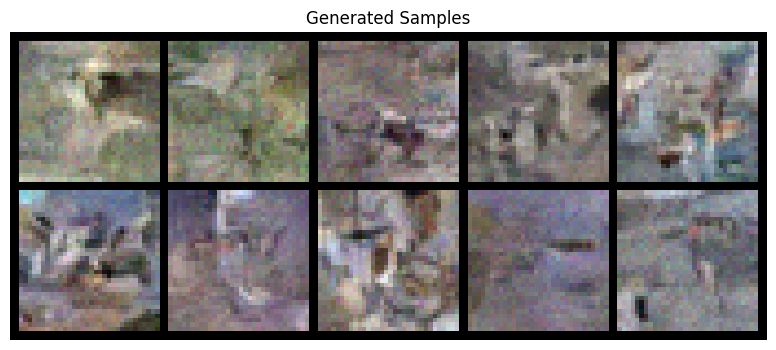

No improvement for 1/10 epochs

Epoch 48/50
--------------------
  Step 0/1250, Loss: 0.1011
  Step 100/1250, Loss: 0.0786
  Step 200/1250, Loss: 0.1002
  Step 300/1250, Loss: 0.1047
  Step 400/1250, Loss: 0.0847
  Step 500/1250, Loss: 0.1039
  Generating samples...


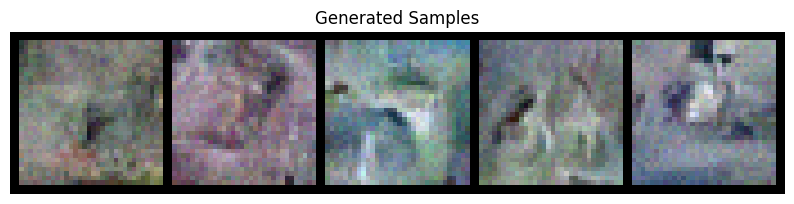

  Step 600/1250, Loss: 0.1056
  Step 700/1250, Loss: 0.1029
  Step 800/1250, Loss: 0.1321
  Step 900/1250, Loss: 0.1006
  Step 1000/1250, Loss: 0.0944
  Generating samples...


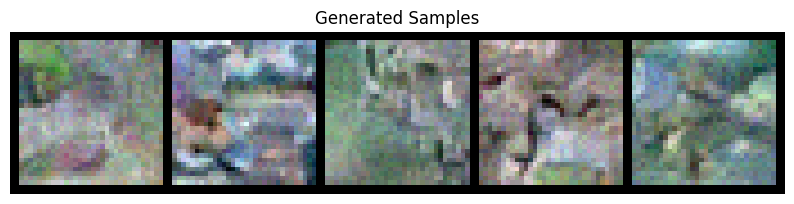

  Step 1100/1250, Loss: 0.1126
  Step 1200/1250, Loss: 0.1218

Training - Epoch 48 average loss: 0.0964
Running validation...
Validation - Epoch 48 average loss: 0.0968
Learning rate: 0.000250
No improvement for 2/10 epochs

Epoch 49/50
--------------------
  Step 0/1250, Loss: 0.0854
  Step 100/1250, Loss: 0.0896
  Step 200/1250, Loss: 0.0729
  Step 300/1250, Loss: 0.1008
  Step 400/1250, Loss: 0.0710
  Step 500/1250, Loss: 0.0973
  Generating samples...


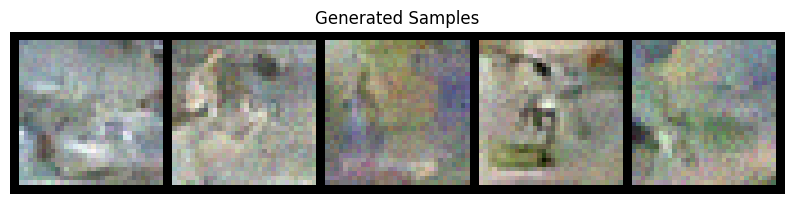

  Step 600/1250, Loss: 0.0786
  Step 700/1250, Loss: 0.0775
  Step 800/1250, Loss: 0.1060
  Step 900/1250, Loss: 0.0788
  Step 1000/1250, Loss: 0.0953
  Generating samples...


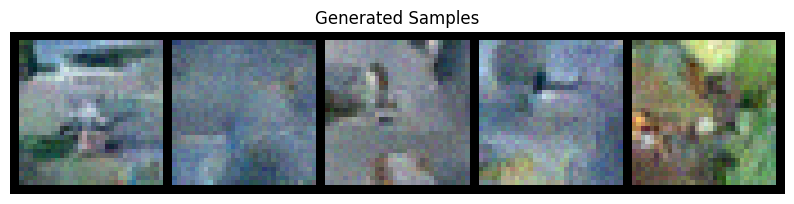

  Step 1100/1250, Loss: 0.0630
  Step 1200/1250, Loss: 0.0862

Training - Epoch 49 average loss: 0.0964
Running validation...
Validation - Epoch 49 average loss: 0.0965
Learning rate: 0.000250

Generating samples for visual progress check...


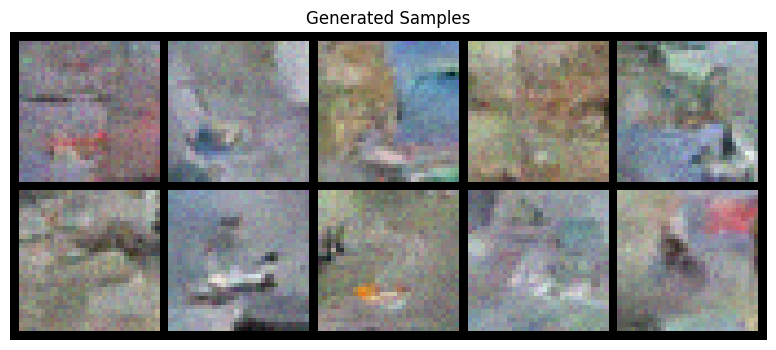

No improvement for 3/10 epochs

Epoch 50/50
--------------------
  Step 0/1250, Loss: 0.0786
  Step 100/1250, Loss: 0.1095
  Step 200/1250, Loss: 0.1082
  Step 300/1250, Loss: 0.0569
  Step 400/1250, Loss: 0.0934
  Step 500/1250, Loss: 0.0980
  Generating samples...


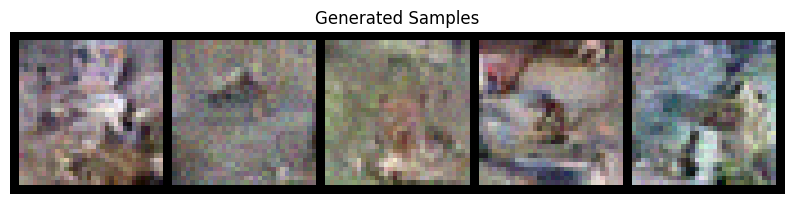

  Step 600/1250, Loss: 0.0878
  Step 700/1250, Loss: 0.1009
  Step 800/1250, Loss: 0.1146
  Step 900/1250, Loss: 0.0678
  Step 1000/1250, Loss: 0.0815
  Generating samples...


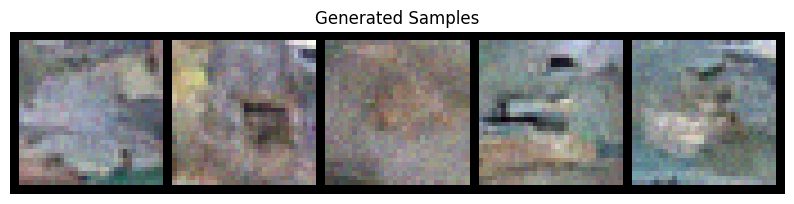

  Step 1100/1250, Loss: 0.1076
  Step 1200/1250, Loss: 0.1011

Training - Epoch 50 average loss: 0.0969
Running validation...
Validation - Epoch 50 average loss: 0.0984
Learning rate: 0.000250

Generating samples for visual progress check...


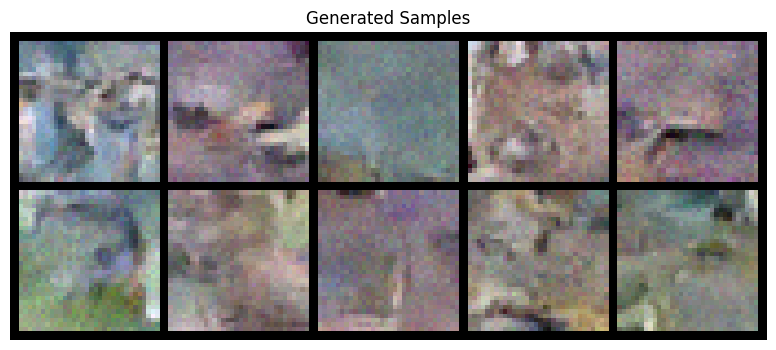

No improvement for 4/10 epochs


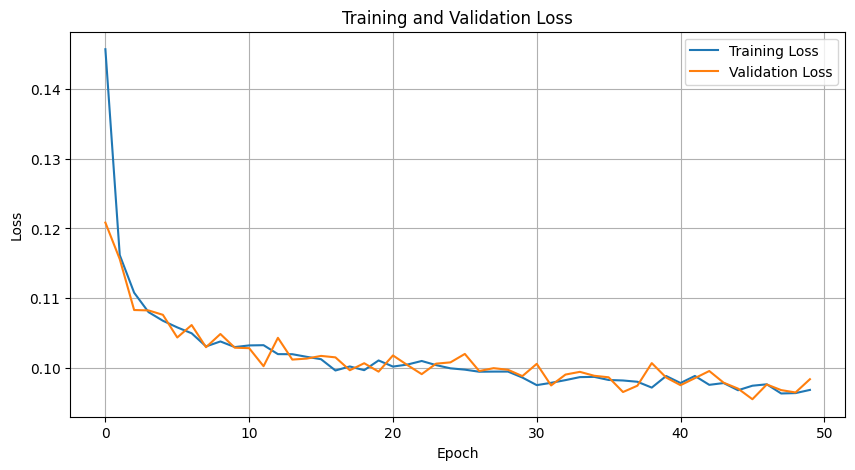


TRAINING COMPLETE
Best validation loss: 0.0955
Generating final samples...


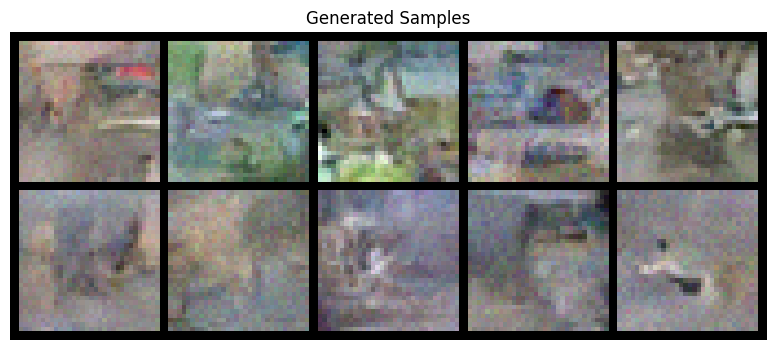

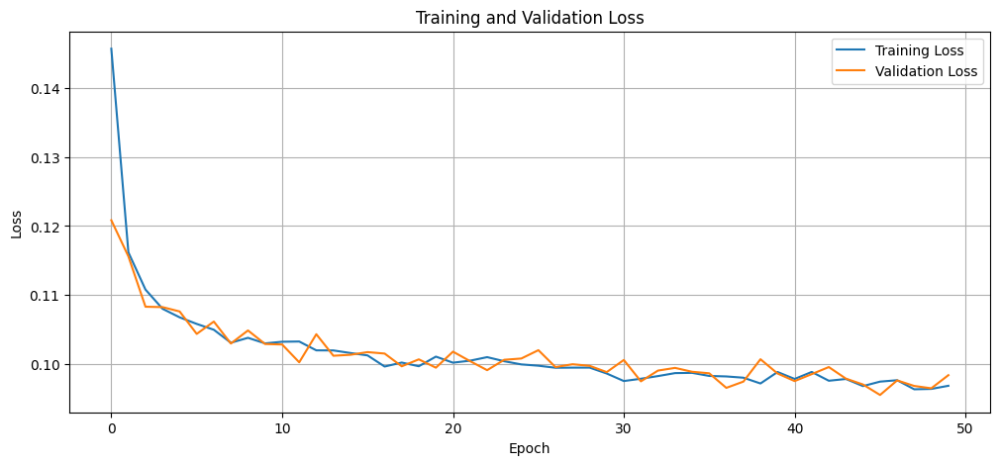

In [ ]:
# Implementation of the main training loop
# Training configuration
early_stopping_patience = 10  # Number of epochs without improvement before stopping
gradient_clip_value = 1.0     # Maximum gradient norm for stability
display_frequency = 100       # How often to show progress (in steps)
generate_frequency = 500      # How often to generate samples (in steps)

# Progress tracking variables
best_loss = float('inf')
train_losses = []
val_losses = []
no_improve_epochs = 0

# Training loop
print("\n" + "="*50)
print("STARTING TRAINING")
print("="*50)
model.train()

# Wrap the training loop in a try-except block for better error handling:
# Your code for the training loop
# Hint: Use a try-except block for better error handling
# Process each epoch and each batch, with validation after each epoch

# Enter your code here:

# Code
try:
    for epoch in range(EPOCHS):
        print(f"\nEpoch {epoch+1}/{EPOCHS}")
        print("-" * 20)

        # Training phase
        model.train()
        epoch_losses = []

        # Process each batch
        for step, (images, labels) in enumerate(train_load):
            images = images.to(device)
            labels = labels.to(device)

            # Training step
            optimizer.zero_grad()
            loss = train_step(images, labels)
            loss.backward()

            # Add gradient clipping for stability
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip_value)

            optimizer.step()
            epoch_losses.append(loss.item())

            # Show progress at regular intervals
            if step % display_frequency == 0:
                print(f"  Step {step}/{len(train_load)}, Loss: {loss.item():.4f}")

                # Generate samples less frequently to save time
                if step % generate_frequency == 0 and step > 0:
                    print("  Generating samples...")
                    generate_samples(model, n_samples=5)

        # End of epoch - calculate average training loss
        avg_train_loss = sum(epoch_losses) / len(epoch_losses)
        train_losses.append(avg_train_loss)
        print(f"\nTraining - Epoch {epoch+1} average loss: {avg_train_loss:.4f}")

        # Validation phase
        model.eval()
        val_epoch_losses = []
        print("Running validation...")

        with torch.no_grad():  # Disable gradients for validation
            for val_images, val_labels in val_load:
                val_images = val_images.to(device)
                val_labels = val_labels.to(device)

                # Calculate validation loss
                val_loss = train_step(val_images, val_labels)
                val_epoch_losses.append(val_loss.item())

        # Calculate average validation loss
        avg_val_loss = sum(val_epoch_losses) / len(val_epoch_losses)
        val_losses.append(avg_val_loss)
        print(f"Validation - Epoch {epoch+1} average loss: {avg_val_loss:.4f}")

        # Learning rate scheduling based on validation loss
        scheduler.step(avg_val_loss)
        current_lr = optimizer.param_groups[0]['lr']
        print(f"Learning rate: {current_lr:.6f}")

        # Generate samples at the end of each epoch
        if epoch % 2 == 0 or epoch == EPOCHS - 1:
            print("\nGenerating samples for visual progress check...")
            generate_samples(model, n_samples=10)

        # Save best model based on validation loss
        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            safe_save_model(model, 'best_diffusion_model.pt', optimizer, epoch, best_loss)
            print(f"✓ New best model saved! (Val Loss: {best_loss:.4f})")
            no_improve_epochs = 0
        else:
            no_improve_epochs += 1
            print(f"No improvement for {no_improve_epochs}/{early_stopping_patience} epochs")

        # Early stopping
        if no_improve_epochs >= early_stopping_patience:
            print("\nEarly stopping triggered! No improvement in validation loss.")
            break

        # Plot loss curves every few epochs
        if epoch % 5 == 0 or epoch == EPOCHS - 1:
            plt.figure(figsize=(10, 5))
            plt.plot(train_losses, label='Training Loss')
            plt.plot(val_losses,   label='Validation Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Training and Validation Loss')
            plt.legend()
            plt.grid(True)
            plt.show()

except KeyboardInterrupt:
    print("\nTraining interrupted by user.")

# ––– Final wrap-up ––––––––––––––––––––––––––––––––––––––––––––––––––––––––––
print("\n" + "="*50)
print("TRAINING COMPLETE")
print("="*50)
print(f"Best validation loss: {best_loss:.4f}")

# Generate final samples
print("Generating final samples...")
generate_samples(model, n_samples=10)

# Display final loss curves
plt.figure(figsize=(12, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses,   label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

# Clean up memory
torch.cuda.empty_cache()


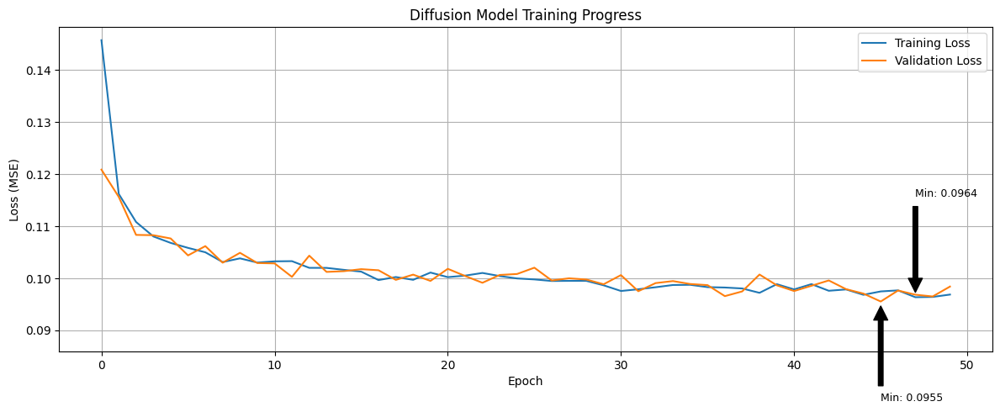


Training Statistics:
------------------------------
Starting training loss:    0.1457
Final training loss:       0.0969
Best training loss:        0.0964
Training loss improvement: 33.9%

Validation Statistics:
------------------------------
Starting validation loss: 0.1208
Final validation loss:    0.0984
Best validation loss:     0.0955


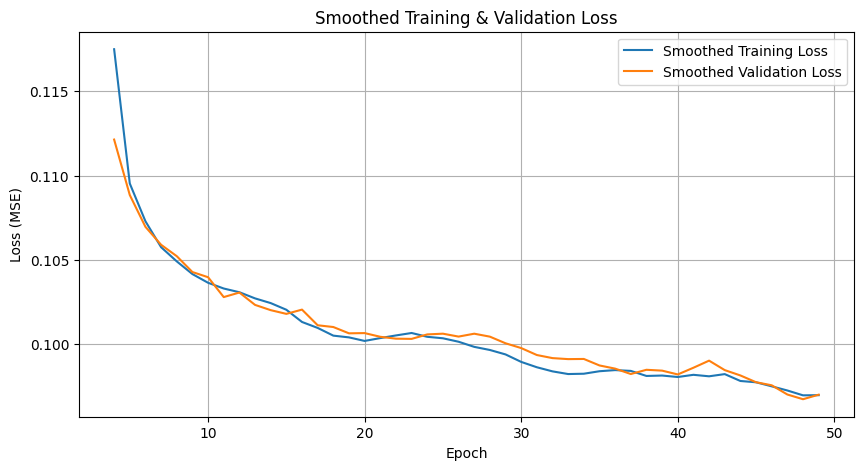

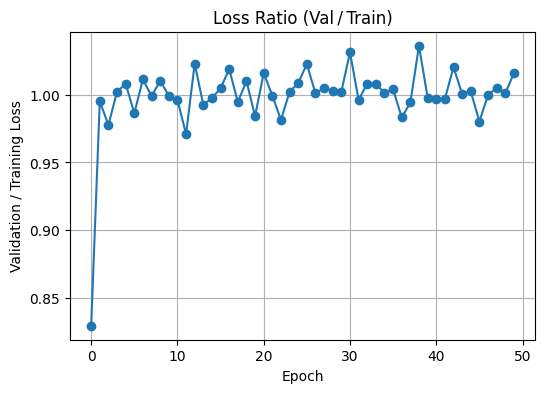

In [ ]:
# Plot training progress
plt.figure(figsize=(12, 5))

# Plot training and validation losses for comparison
plt.plot(train_losses, label='Training Loss')
if len(val_losses) > 0:  # Only plot validation if it exists
    plt.plot(val_losses, label='Validation Loss')

# Improve the plot with better labels and styling
plt.title('Diffusion Model Training Progress')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.grid(True)

# Add annotations for key points
if len(train_losses) > 1:
    min_train_idx = train_losses.index(min(train_losses))
    plt.annotate(f'Min: {min(train_losses):.4f}',
                 xy=(min_train_idx, min(train_losses)),
                 xytext=(min_train_idx, min(train_losses)*1.2),
                 arrowprops=dict(facecolor='black', shrink=0.05),
                 fontsize=9)

# Add validation min point if available
if len(val_losses) > 1:
    min_val_idx = val_losses.index(min(val_losses))
    plt.annotate(f'Min: {min(val_losses):.4f}',
                xy=(min_val_idx, min(val_losses)),
                xytext=(min_val_idx, min(val_losses)*0.8),
                arrowprops=dict(facecolor='black', shrink=0.05),
                fontsize=9)

# Set y-axis to start from 0 or slightly lower than min value
plt.ylim(bottom=max(0, min(min(train_losses) if train_losses else float('inf'),
                          min(val_losses) if val_losses else float('inf'))*0.9))

plt.tight_layout()
plt.show()

# Add statistics summary for students to analyze
print("\nTraining Statistics:")
print("-" * 30)
if train_losses:
    print(f"Starting training loss:    {train_losses[0]:.4f}")
    print(f"Final training loss:       {train_losses[-1]:.4f}")
    print(f"Best training loss:        {min(train_losses):.4f}")
    print(f"Training loss improvement: {((train_losses[0] - min(train_losses)) / train_losses[0] * 100):.1f}%")

if val_losses:
    print("\nValidation Statistics:")
    print("-" * 30)
    print(f"Starting validation loss: {val_losses[0]:.4f}")
    print(f"Final validation loss:    {val_losses[-1]:.4f}")
    print(f"Best validation loss:     {min(val_losses):.4f}")

# STUDENT EXERCISE:
# 1. Try modifying this plot to show a smoothed version of the losses
# 2. Create a second plot showing the ratio of validation to training loss
#    (which can indicate overfitting when the ratio increases)

###############################################################################
###############################################################################
###############################################################################
###################### Student Exercises     ##################################
###############################################################################
###############################################################################

import numpy as np

# 1) Smoothed loss curves (5-epoch rolling average)
window = 5
sm_train = np.convolve(train_losses, np.ones(window)/window, mode='valid')
sm_val   = np.convolve(val_losses,   np.ones(window)/window, mode='valid')

plt.figure(figsize=(10,5))
plt.plot(range(window-1, len(train_losses)), sm_train, label='Smoothed Training Loss')
plt.plot(range(window-1, len(val_losses)),   sm_val,   label='Smoothed Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.title('Smoothed Training & Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

# 2) Validation-to-training loss ratio
loss_ratio = np.array(val_losses) / np.array(train_losses)
plt.figure(figsize=(6,4))
plt.plot(loss_ratio, marker='o')
plt.xlabel('Epoch')
plt.ylabel('Validation / Training Loss')
plt.title('Loss Ratio (Val / Train)')
plt.grid(True)
plt.show()

## Step 6: Generating New Images

Now that our model is trained, let's generate some new images! We can:
1. Generate specific numbers
2. Generate multiple versions of each number
3. See how the generation process works step by step

Generating 4 versions of number 0...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 1...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 2...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 3...
  Denoising step 19/99 completed
  Denoising step 39/99 completed


  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 4...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 5...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 6...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 7...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 4 versions of number 8...
  Denoising step 19/99 completed
  Denoising step 39/99 

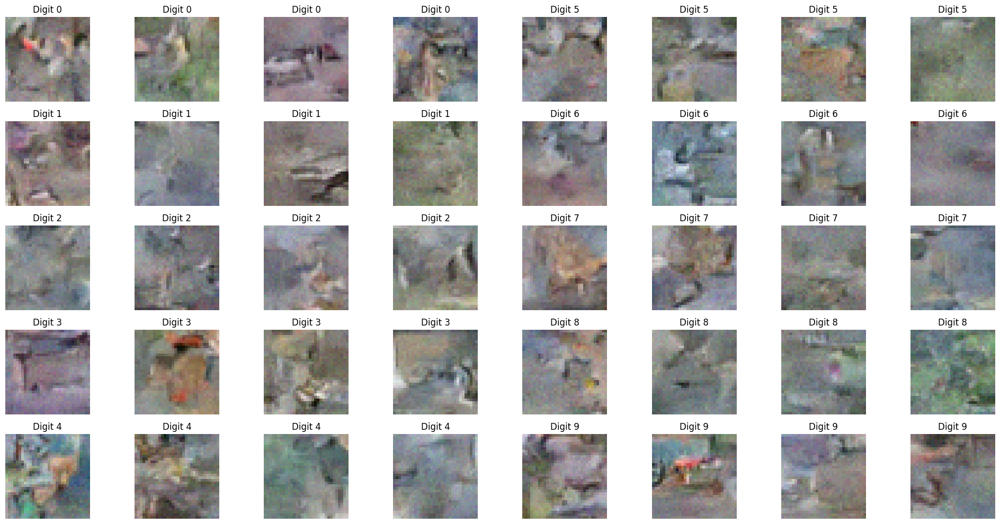


STUDENT ACTIVITY: Generating numbers with different noise seeds
Generating 1 versions of number 3...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 1 versions of number 3...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 1 versions of number 3...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 1 versions of number 3...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 completed
  Denoising step 79/99 completed
  Denoising step 99/99 completed
Generating 1 versions of number 3...
  Denoising step 19/99 completed
  Denoising step 39/99 completed
  Denoising step 59/99 c

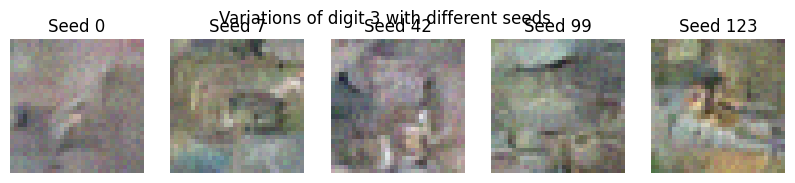

In [ ]:
def generate_number(model, number, n_samples=4):
    """
    Generate multiple versions of a specific number using the diffusion model.

    Args:
        model (nn.Module): The trained diffusion model
        number (int): The digit to generate (0-9)
        n_samples (int): Number of variations to generate

    Returns:
        torch.Tensor: Generated images of shape [n_samples, IMG_CH, IMG_SIZE, IMG_SIZE]
    """
    model.eval()  # Set model to evaluation mode
    with torch.no_grad():  # No need for gradients during generation
        # Start with random noise
        samples = torch.randn(n_samples, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Set up the number we want to generate
        c = torch.full((n_samples,), number).to(device)
        c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
        # Correctly sized conditioning mask
        c_mask = torch.ones_like(c.unsqueeze(-1)).to(device)

        # Display progress information
        print(f"Generating {n_samples} versions of number {number}...")

        # Remove noise step by step
        for t in range(n_steps-1, -1, -1):
            t_batch = torch.full((n_samples,), t).to(device)
            samples = remove_noise(samples, t_batch, model, c_one_hot, c_mask)

            # Optional: Display occasional progress updates
            if t % (n_steps // 5) == 0:
                print(f"  Denoising step {n_steps-1-t}/{n_steps-1} completed")

        return samples

# Generate 4 versions of each number
plt.figure(figsize=(20, 10))
for i in range(10):
    # Generate samples for current digit
    samples = generate_number(model, i, n_samples=4)

    # Display each sample
    for j in range(4):
        # Use 2 rows, 10 digits per row, 4 samples per digit
        # i//5 determines the row (0 or 1)
        # i%5 determines the position in the row (0-4)
        # j is the sample index within each digit (0-3)
        plt.subplot(5, 8, (i%5)*8 + (i//5)*4 + j + 1)

        # Display the image correctly based on channel configuration
        if IMG_CH == 1:  # Grayscale
            plt.imshow(samples[j][0].cpu(), cmap='gray')
        else:  # Color image
            img = samples[j].permute(1, 2, 0).cpu()
            # Rescale from [-1, 1] to [0, 1] if needed
            if img.min() < 0:
                img = (img + 1) / 2
            plt.imshow(img)

        plt.title(f'Digit {i}')
        plt.axis('off')

plt.tight_layout()
plt.show()

# STUDENT ACTIVITY: Try generating the same digit with different noise seeds
# This shows the variety of styles the model can produce
print("\nSTUDENT ACTIVITY: Generating numbers with different noise seeds")

# Helper function to generate with seed
def generate_with_seed(number, seed_value=42, n_samples=10):
    torch.manual_seed(seed_value)
    return generate_number(model, number, n_samples)

# Pick a image and show many variations
# Hint select a image e.g. dog  # Change this to any other in the dataset of subset you chose
# Hint 2 use variations = generate_with_seed
# Hint 3 use plt.figure and plt.imshow to display the variations

# Enter your code here:
# STUDENT ACTIVITY: show the effect of different random seeds
digit = 3
seed_list = [0, 7, 42, 99, 123]
plt.figure(figsize=(len(seed_list)*2, 2))
for i, seed in enumerate(seed_list):
    sample = generate_with_seed(digit, seed_value=seed, n_samples=1)[0]
    plt.subplot(1, len(seed_list), i+1)
    if IMG_CH == 1:
        plt.imshow(sample[0].cpu(), cmap='gray')
    else:
        vis = sample.permute(1,2,0).cpu()
        if vis.min() < 0: vis = (vis+1)/2
        plt.imshow(vis)
    plt.title(f'Seed {seed}')
    plt.axis('off')
plt.suptitle(f'Variations of digit {digit} with different seeds')
plt.show()

## Step 7: Watching the Generation Process

Let's see how our model turns random noise into clear images, step by step. This helps us understand how the diffusion process works!


Generating number 0:


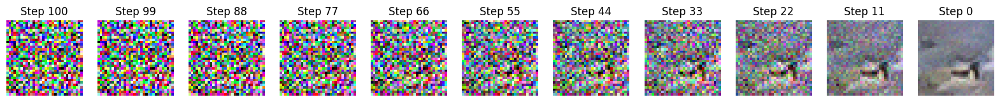


Generating number 3:


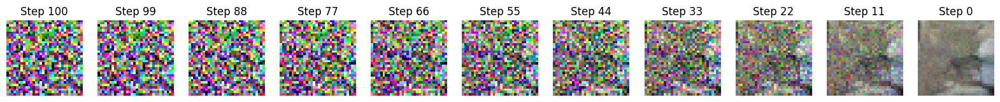


Generating number 7:


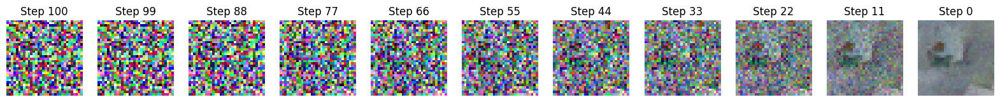

In [ ]:
def visualize_generation_steps(model, number, n_preview_steps=10):
    """
    Show how an image evolves from noise to a clear number
    """
    model.eval()
    with torch.no_grad():
        # Start with random noise
        x = torch.randn(1, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Set up which number to generate
        c = torch.tensor([number]).to(device)
        c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
        # Make sure mask is [batch,1], not [batch, classes]
        c_mask = torch.ones_like(c.unsqueeze(-1)).to(device)

        # Calculate which steps to show
        steps_to_show = torch.linspace(n_steps-1, 0, n_preview_steps).long()

        # Store images for visualization
        images = []
        images.append(x[0].cpu())

        # Remove noise step by step
        for t in range(n_steps-1, -1, -1):
            t_batch = torch.full((1,), t).to(device)
            x = remove_noise(x, t_batch, model, c_one_hot, c_mask)

            if t in steps_to_show:
                images.append(x[0].cpu())

        # Show the progression
        plt.figure(figsize=(20, 3))
        for i, img in enumerate(images):
            plt.subplot(1, len(images), i+1)
            if IMG_CH == 1:
                plt.imshow(img[0], cmap='gray')
            else:
                img = img.permute(1, 2, 0)
                if img.min() < 0:
                    img = (img + 1) / 2
                plt.imshow(img)
            step = n_steps if i == 0 else steps_to_show[i-1]
            plt.title(f'Step {step}')
            plt.axis('off')
        plt.show()

# Show generation process for a few numbers
for number in [0, 3, 7]:
    print(f"\nGenerating number {number}:")
    visualize_generation_steps(model, number)

## STEP 7.5: GENERATING BETTER IMAGES using
### 1. Downsampling Channels with larger UNet
### 2. Data Augmentation
### 3. Cosine Noise Scheduling + increased diffusion steps
### 4. Longer Training
### 5. Possible Eclip  

#### 7.5a - Larger U-Net

In [ ]:
# Create our model and move it to GPU if available
model = UNet(
    T=n_steps,                    # Number of diffusion time steps
    img_ch=IMG_CH,                # Number of channels in our images (1 for grayscale, 3 for RGB)
    img_size=IMG_SIZE,            # Size of input images (28 for MNIST, 32 for CIFAR-10)
    down_chs=(64, 128, 256, 512), # bigger channel dims
    t_embed_dim=8,                # Dimension for time step embeddings
    c_embed_dim=N_CLASSES         # Number of classes for conditioning
).to(device)

# Print model summary
print(f"\n{'='*50}")
print(f"MODEL ARCHITECTURE SUMMARY")
print(f"{'='*50}")
print(f"Input resolution: {IMG_SIZE}x{IMG_SIZE}")
print(f"Input channels: {IMG_CH}")
print(f"Time steps: {n_steps}")
print(f"Condition classes: {N_CLASSES}")
print(f"GPU acceleration: {'Yes' if device.type == 'cuda' else 'No'}")

# Validate model parameters and estimate memory requirements
# Hint: Create functions to count parameters and estimate memory usage

# Enter your code here:

# 1) Validate model size & memory
validate_model_parameters(model)

# Your code to verify data ranges and integrity
# Hint: Create functions to check data ranges in training and validation data

# Enter your code here:

# 2) Verify data ranges on your loaders
verify_data_range(train_load, name="Training set")
verify_data_range(val_load,   name="Validation set")

# Set up the optimizer with parameters tuned for diffusion models
# Note: Lower learning rates tend to work better for diffusion models
initial_lr = 0.001  # Starting learning rate
weight_decay = 1e-5  # L2 regularization to prevent overfitting

optimizer = Adam(
    model.parameters(),
    lr=initial_lr,
    weight_decay=weight_decay
)

# Learning rate scheduler to reduce LR when validation loss plateaus
# This helps fine-tune the model toward the end of training
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',              # Reduce LR when monitored value stops decreasing
    factor=0.5,              # Multiply LR by this factor
    patience=5,              # Number of epochs with no improvement after which LR will be reduced
    verbose=True,            # Print message when LR is reduced
    min_lr=1e-6              # Lower bound on the learning rate
)

# STUDENT EXPERIMENT:
# Try different channel configurations and see how they affect:
# 1. Model size (parameter count)
# 2. Training time
# 3. Generated image quality
#
# Suggestions:
# - Smaller: down_chs=(16, 32, 64)
# - Larger: down_chs=(64, 128, 256, 512)

Created DownBlock: in_chs=64, out_chs=128, spatial_reduction=2x
Created DownBlock: in_chs=128, out_chs=256, spatial_reduction=2x
Created DownBlock: in_chs=256, out_chs=512, spatial_reduction=2x
Created UpBlock: in_chs=512, out_chs=256, spatial_increase=2x
Created UpBlock: in_chs=256, out_chs=128, spatial_increase=2x
Created UpBlock: in_chs=128, out_chs=64, spatial_increase=2x
Created UNet with 4 scale levels
Channel dimensions: (64, 128, 256, 512)

MODEL ARCHITECTURE SUMMARY
Input resolution: 32x32
Input channels: 3
Time steps: 100
Condition classes: 10
GPU acceleration: Yes
Total parameters: 26,086,623
Trainable parameters: 26,086,623
Estimated GPU memory usage: 398.1 MB

Training set range check:
Shape: torch.Size([32, 3, 32, 32])
Data type: torch.float32
Min value: -1.00
Max value: 1.00
Contains NaN: False
Contains Inf: False

Validation set range check:
Shape: torch.Size([32, 3, 32, 32])
Data type: torch.float32
Min value: -1.00
Max value: 1.00
Contains NaN: False
Contains Inf: Fal

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


#### 7.5b - more data augmentation for randomization to increase learning capability

In [ ]:
from torchvision import transforms

transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),                # random flip
    transforms.RandomCrop(IMG_SIZE, padding=4),       # random 32×32 crop with padding
    transforms.ToTensor(),
    transforms.Normalize(
        mean=(0.5, 0.5, 0.5),
        std=(0.5, 0.5, 0.5)
    ),
])

# Reload datasets and loaders
train_ds = torchvision.datasets.CIFAR10(
    root='./data', train=True, download=True, transform=transform
)
val_ds   = torchvision.datasets.CIFAR10(
    root='./data', train=False, download=True,
    transform=transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize((0.5,)*3, (0.5,)*3)
    ])
)

train_load = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=4)
val_load   = DataLoader(val_ds,   batch_size=BATCH_SIZE, shuffle=False, num_workers=4)


#### 7.5c - Cosine Noise Scheduling

In [ ]:
import math

def cosine_beta_schedule(timesteps, s=0.008):
    """Nichol & Dhariwal cosine schedule."""
    steps = timesteps + 1
    x = torch.linspace(0, timesteps, steps, device=device)
    alphas_cum = torch.cos(((x / timesteps) + s) / (1 + s) * math.pi * 0.5) ** 2
    alphas_cum = alphas_cum / alphas_cum[0]
    betas = 1 - (alphas_cum[1:] / alphas_cum[:-1])
    return betas.clamp(0, 0.999)

# more timesteps = finer denoising and thereby increased number of diffusion steps
n_steps = 200

# Recompute the schedules
beta  = cosine_beta_schedule(n_steps).to(device)
alpha = 1 - beta
alpha_bar = torch.cumprod(alpha, dim=0)
sqrt_alpha_bar = torch.sqrt(alpha_bar)
sqrt_one_minus_alpha_bar = torch.sqrt(1 - alpha_bar)


#### 7.5d - Longer training :)

In [ ]:
EPOCHS = 80   # train a bit longer


### Alternative test to ensure my compute power is not run thru

In [ ]:
class SinusoidalPositionEmbedBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2

        # explicitly float32
        inv_freq = torch.log(torch.tensor(10000.0, device=device, dtype=torch.float32)) \
                   / (half_dim - 1)
        freqs    = torch.exp(torch.arange(half_dim, device=device, dtype=torch.float32)
                             * -inv_freq)

        # make sure time is float32 as well
        t = time.float()[:, None]

        # build the embeddings in FP32
        emb = t * freqs[None, :]            # [B, half_dim]
        emb = torch.cat((emb.sin(), emb.cos()), dim=-1)  # [B, dim]

        return emb


In [ ]:
import torch
from torch.cuda.amp import autocast, GradScaler

# 1) Pilot hyperparams
EPOCHS_PILOT = 50
n_steps_pilot = 100  # instead of 200
BATCH_SIZE = 16      # smaller so it fits comfortably
accum_steps = 4      # accumulates 4 micro-batches → effective BS=64

# 2) Recompute your cosine schedule for pilot in full precision
with autocast(enabled=False):

    beta_pilot = cosine_beta_schedule(n_steps_pilot).to(device)
    alpha_pilot     = 1 - beta_pilot
    alpha_bar_pilot = torch.cumprod(alpha_pilot, dim=0).to(device)

    sqrt_alpha_bar_pilot      = alpha_bar_pilot.sqrt()
    sqrt_one_minus_alpha_bar  = (1.0 - alpha_bar_pilot).sqrt()

# 3) Optimizer, scaler for AMP
optimizer = Adam(model.parameters(), lr=initial_lr, weight_decay=weight_decay)
scaler    = torch.cuda.amp.GradScaler()

best_loss = float('inf')
step_counter = 0

for epoch in range(EPOCHS_PILOT):
    model.train()
    for images, labels in train_load:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()

        # mixed-precision forward
        with autocast():
            loss = train_step(images, labels)  # MSE on noise prediction
            loss = loss / accum_steps          # scale for accumulation

        # scaled backward + accumulate
        scaler.scale(loss).backward()

        # step optimizer every accum_steps
        if (step_counter + 1) % accum_steps == 0:
            scaler.step(optimizer)
            scaler.update()
            optimizer.zero_grad()

        # checkpoint every 200 micro-batches
        if step_counter % 200 == 0 and step_counter > 0:
            safe_save_model(model, f'checkpoint_step{step_counter}.pt',
                            optimizer, epoch, best_loss)

        step_counter += 1

    # end of epoch: do your usual validation, scheduling, logging…
    # (exactly like your main loop, but using n_steps_pilot & EPOCHS_PILOT)


<ipython-input-60-d4047cbcd4c9>:11: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=False):


RuntimeError: CUDA error: device-side assert triggered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


In [ ]:
import torch, math

# 0) Clear any pending GPU errors
torch.cuda.synchronize()
torch.cuda.empty_cache()

# 1) Define the CPU‐only cosine schedule
def cosine_beta_schedule_cpu(timesteps, s=0.008):
    steps = timesteps + 1
    # make sure everything is float32 on CPU
    x = torch.linspace(0, timesteps, steps, dtype=torch.float32, device='cpu')
    alphas_cum = torch.cos(((x / timesteps + s) / (1 + s) * math.pi * 0.5))**2
    alphas_cum = alphas_cum / alphas_cum[0]
    betas = 1.0 - alphas_cum[1:] / alphas_cum[:-1]
    return betas.clamp(1e-4, 0.9999)

# 2) Compute on CPU
beta_pilot_cpu       = cosine_beta_schedule_cpu(n_steps_pilot, s)
alpha_pilot_cpu      = 1.0 - beta_pilot_cpu
alpha_bar_pilot_cpu  = torch.cumprod(alpha_pilot_cpu, dim=0)

# 3) Now move to GPU in one go
beta_pilot        = beta_pilot_cpu.to(device)
alpha_pilot       = alpha_pilot_cpu.to(device)
alpha_bar_pilot   = alpha_bar_pilot_cpu.to(device)

# 4) Build the square-root buffers exactly as before
sqrt_alpha_bar        = alpha_bar_pilot.sqrt()
sqrt_one_minus_ab     = (1 - alpha_bar_pilot).sqrt()


RuntimeError: CUDA error: device-side assert triggered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


### Retraining


STARTING TRAINING

Epoch 1/80
--------------------
  Step 0/1563, Loss: 1.1357
  Step 100/1563, Loss: 0.1129
  Step 200/1563, Loss: 0.0930
  Step 300/1563, Loss: 0.0854
  Step 400/1563, Loss: 0.0542
  Step 500/1563, Loss: 0.0591
  Generating samples...


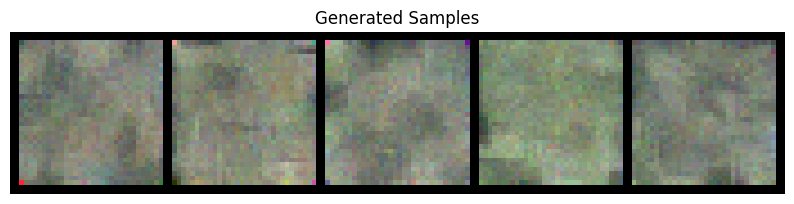

  Step 600/1563, Loss: 0.0797
  Step 700/1563, Loss: 0.0732
  Step 800/1563, Loss: 0.0642
  Step 900/1563, Loss: 0.1063
  Step 1000/1563, Loss: 0.0870
  Generating samples...


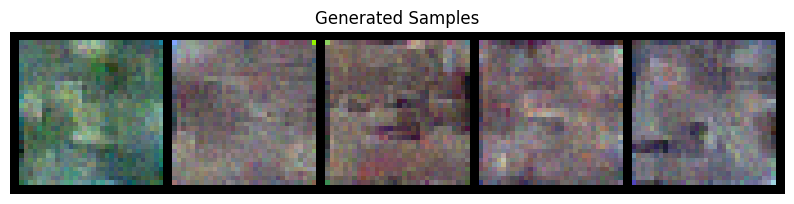

  Step 1100/1563, Loss: 0.0998
  Step 1200/1563, Loss: 0.0682
  Step 1300/1563, Loss: 0.1348
  Step 1400/1563, Loss: 0.0621
  Step 1500/1563, Loss: 0.0687
  Generating samples...


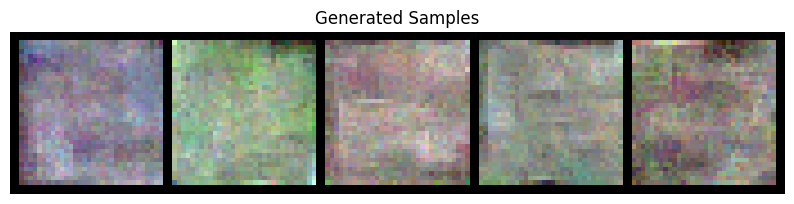


Training - Epoch 1 average loss: 0.0896
Running validation...
Validation - Epoch 1 average loss: 0.0743
Learning rate: 0.001000

Generating samples for visual progress check...


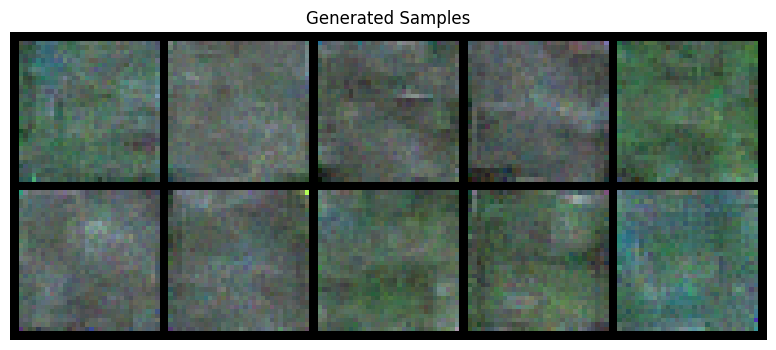

Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0743)


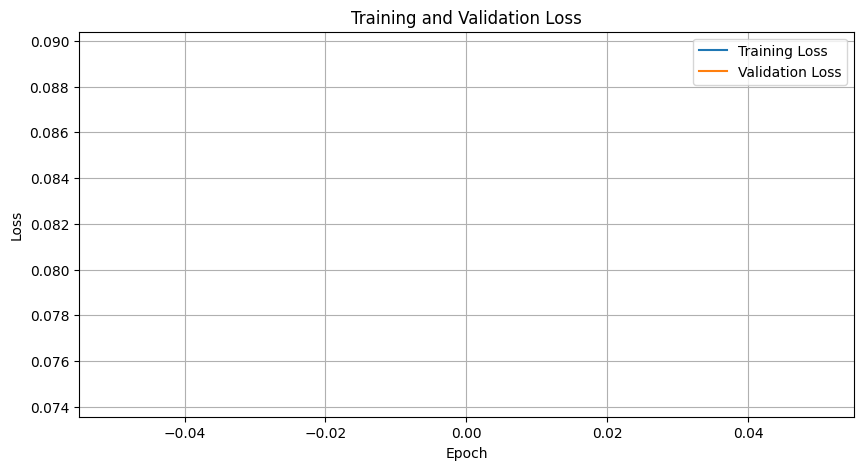


Epoch 2/80
--------------------
  Step 0/1563, Loss: 0.0925
  Step 100/1563, Loss: 0.0566
  Step 200/1563, Loss: 0.0570
  Step 300/1563, Loss: 0.0644
  Step 400/1563, Loss: 0.0585
  Step 500/1563, Loss: 0.0669
  Generating samples...


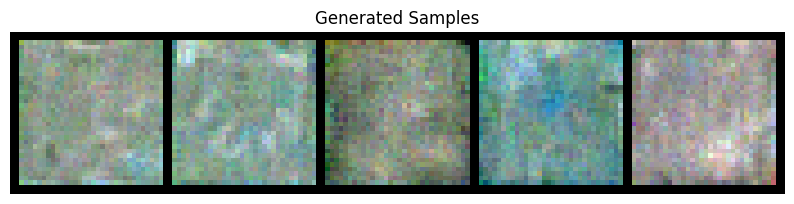

  Step 600/1563, Loss: 0.0515
  Step 700/1563, Loss: 0.0677
  Step 800/1563, Loss: 0.0590
  Step 900/1563, Loss: 0.0588
  Step 1000/1563, Loss: 0.0796
  Generating samples...


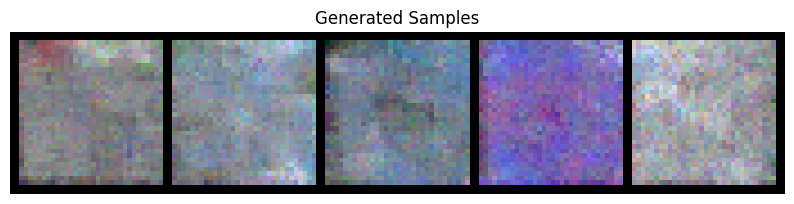

  Step 1100/1563, Loss: 0.0324
  Step 1200/1563, Loss: 0.0843
  Step 1300/1563, Loss: 0.0653
  Step 1400/1563, Loss: 0.0611
  Step 1500/1563, Loss: 0.0547
  Generating samples...


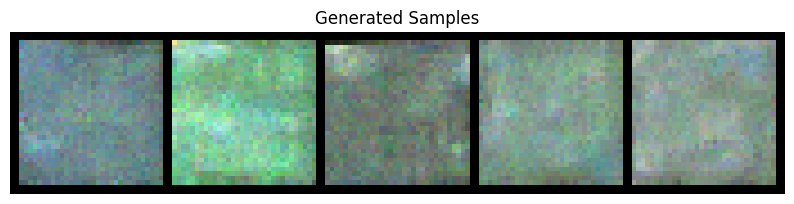


Training - Epoch 2 average loss: 0.0676
Running validation...
Validation - Epoch 2 average loss: 0.0689
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0689)

Epoch 3/80
--------------------
  Step 0/1563, Loss: 0.0563
  Step 100/1563, Loss: 0.0769
  Step 200/1563, Loss: 0.0705
  Step 300/1563, Loss: 0.0501
  Step 400/1563, Loss: 0.0527
  Step 500/1563, Loss: 0.0526
  Generating samples...


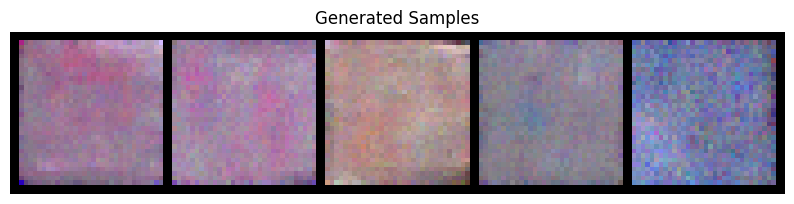

  Step 600/1563, Loss: 0.0917
  Step 700/1563, Loss: 0.0683
  Step 800/1563, Loss: 0.0905
  Step 900/1563, Loss: 0.0629
  Step 1000/1563, Loss: 0.0536
  Generating samples...


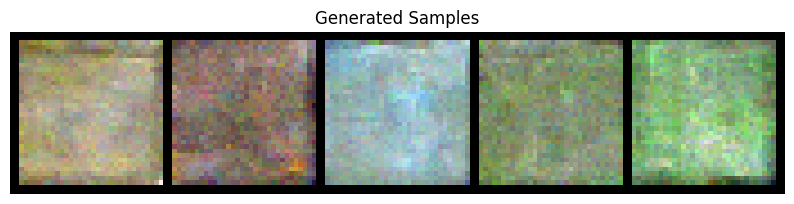

  Step 1100/1563, Loss: 0.0544
  Step 1200/1563, Loss: 0.0586
  Step 1300/1563, Loss: 0.0838
  Step 1400/1563, Loss: 0.0857
  Step 1500/1563, Loss: 0.0650
  Generating samples...


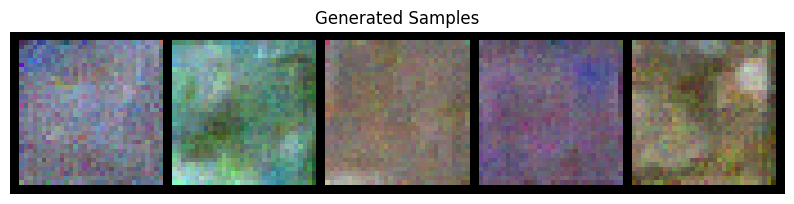


Training - Epoch 3 average loss: 0.0635
Running validation...
Validation - Epoch 3 average loss: 0.0678
Learning rate: 0.001000

Generating samples for visual progress check...


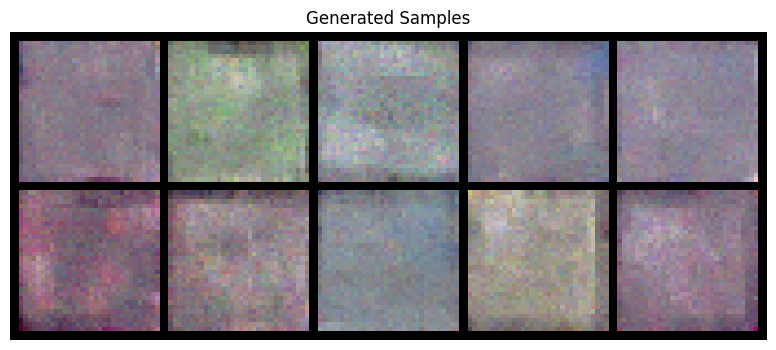

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0678)

Epoch 4/80
--------------------
  Step 0/1563, Loss: 0.0527
  Step 100/1563, Loss: 0.0540
  Step 200/1563, Loss: 0.0588
  Step 300/1563, Loss: 0.0715
  Step 400/1563, Loss: 0.0431
  Step 500/1563, Loss: 0.0550
  Generating samples...


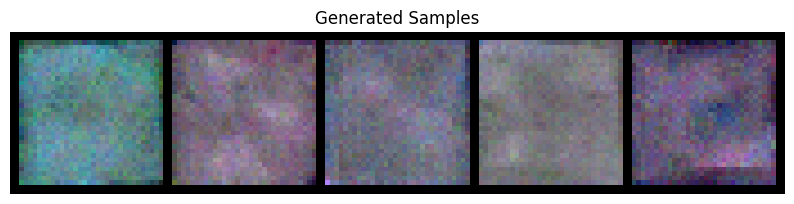

  Step 600/1563, Loss: 0.0741
  Step 700/1563, Loss: 0.0633
  Step 800/1563, Loss: 0.0528
  Step 900/1563, Loss: 0.0601
  Step 1000/1563, Loss: 0.0787
  Generating samples...


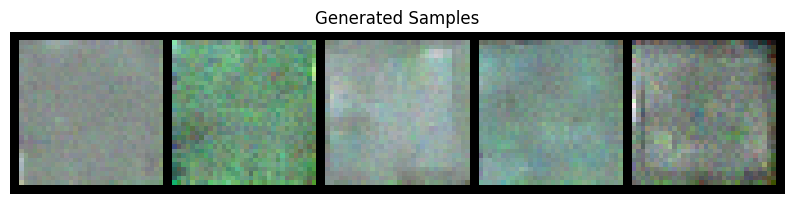

  Step 1100/1563, Loss: 0.0582
  Step 1200/1563, Loss: 0.0514
  Step 1300/1563, Loss: 0.0521
  Step 1400/1563, Loss: 0.0450
  Step 1500/1563, Loss: 0.0578
  Generating samples...


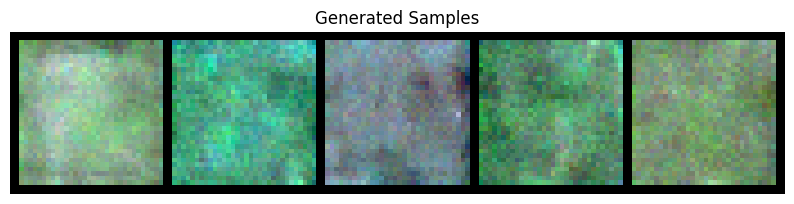


Training - Epoch 4 average loss: 0.0620
Running validation...
Validation - Epoch 4 average loss: 0.0665
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0665)

Epoch 5/80
--------------------
  Step 0/1563, Loss: 0.0265
  Step 100/1563, Loss: 0.0521
  Step 200/1563, Loss: 0.0579
  Step 300/1563, Loss: 0.0639
  Step 400/1563, Loss: 0.0951
  Step 500/1563, Loss: 0.0669
  Generating samples...


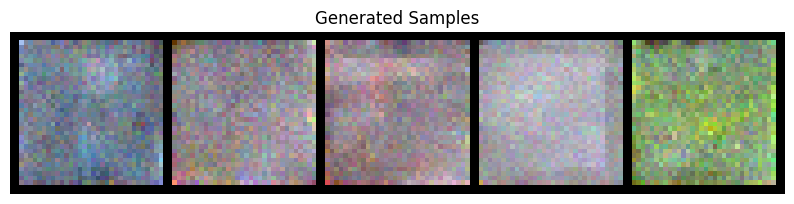

  Step 600/1563, Loss: 0.0525
  Step 700/1563, Loss: 0.0457
  Step 800/1563, Loss: 0.0446
  Step 900/1563, Loss: 0.0384
  Step 1000/1563, Loss: 0.0503
  Generating samples...


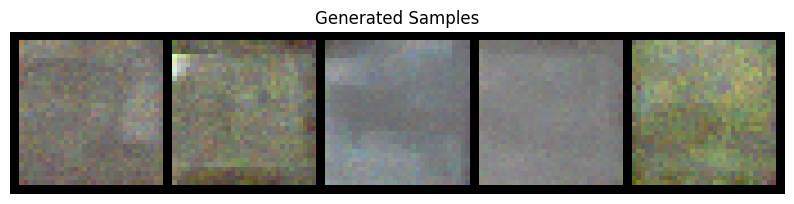

  Step 1100/1563, Loss: 0.0595
  Step 1200/1563, Loss: 0.0577
  Step 1300/1563, Loss: 0.0345
  Step 1400/1563, Loss: 0.0371
  Step 1500/1563, Loss: 0.0404
  Generating samples...


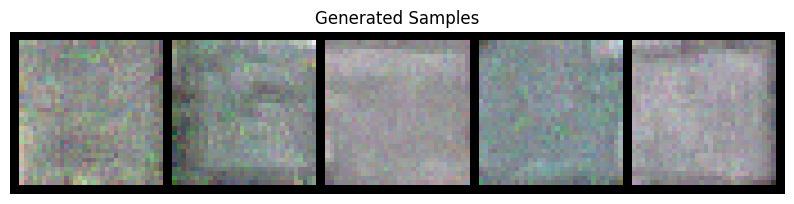


Training - Epoch 5 average loss: 0.0616
Running validation...
Validation - Epoch 5 average loss: 0.0650
Learning rate: 0.001000

Generating samples for visual progress check...


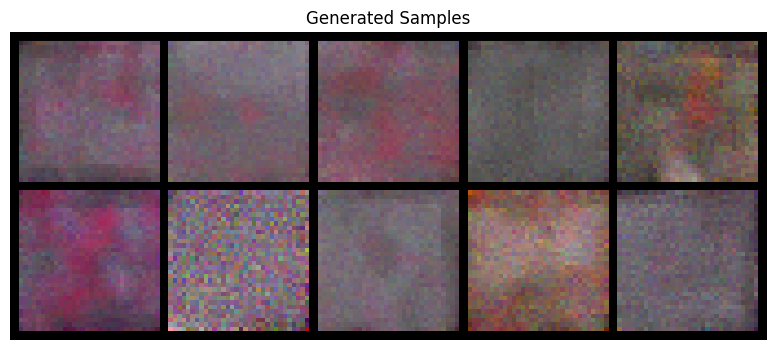

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0650)

Epoch 6/80
--------------------
  Step 0/1563, Loss: 0.0451
  Step 100/1563, Loss: 0.0488
  Step 200/1563, Loss: 0.0788
  Step 300/1563, Loss: 0.0689
  Step 400/1563, Loss: 0.0586
  Step 500/1563, Loss: 0.0733
  Generating samples...


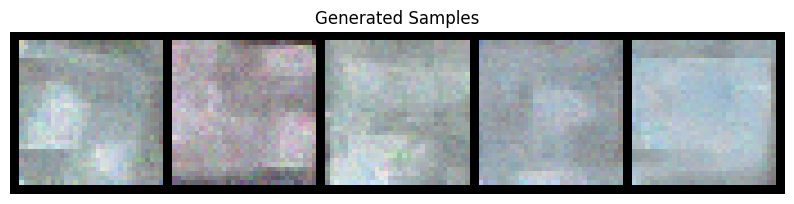

  Step 600/1563, Loss: 0.0895
  Step 700/1563, Loss: 0.0535
  Step 800/1563, Loss: 0.0574
  Step 900/1563, Loss: 0.0828
  Step 1000/1563, Loss: 0.0417
  Generating samples...


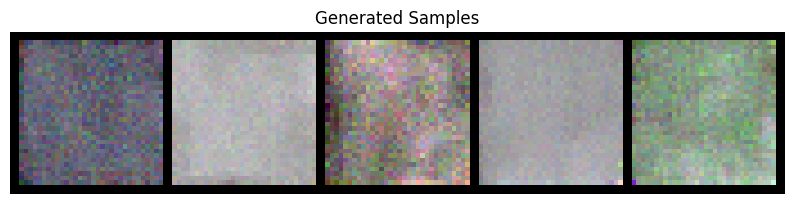

  Step 1100/1563, Loss: 0.0445
  Step 1200/1563, Loss: 0.0602
  Step 1300/1563, Loss: 0.0872
  Step 1400/1563, Loss: 0.0342
  Step 1500/1563, Loss: 0.0502
  Generating samples...


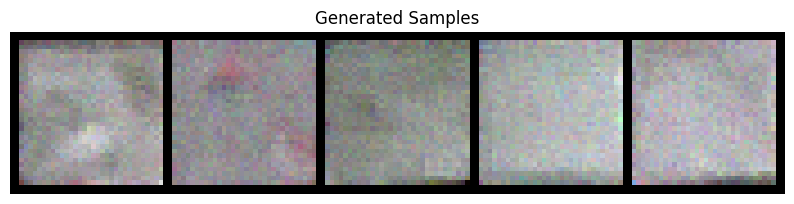


Training - Epoch 6 average loss: 0.0612
Running validation...
Validation - Epoch 6 average loss: 0.0647
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0647)


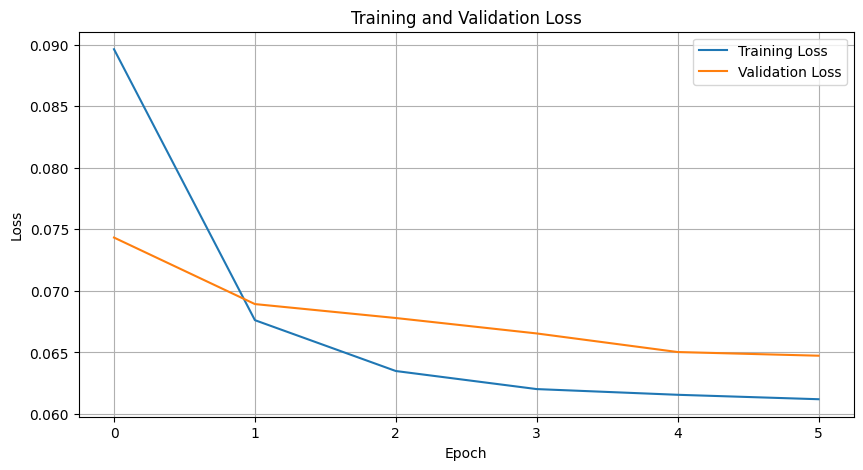


Epoch 7/80
--------------------
  Step 0/1563, Loss: 0.1063
  Step 100/1563, Loss: 0.0446
  Step 200/1563, Loss: 0.0688
  Step 300/1563, Loss: 0.0995
  Step 400/1563, Loss: 0.0890
  Step 500/1563, Loss: 0.0562
  Generating samples...


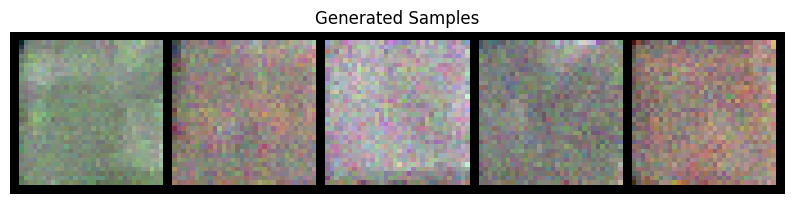

  Step 600/1563, Loss: 0.0567
  Step 700/1563, Loss: 0.0720
  Step 800/1563, Loss: 0.0590
  Step 900/1563, Loss: 0.0566
  Step 1000/1563, Loss: 0.0593
  Generating samples...


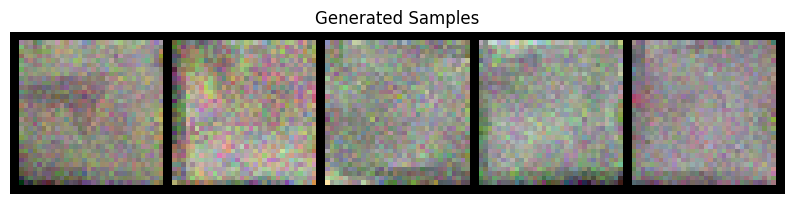

  Step 1100/1563, Loss: 0.0602
  Step 1200/1563, Loss: 0.0802
  Step 1300/1563, Loss: 0.0396
  Step 1400/1563, Loss: 0.0422
  Step 1500/1563, Loss: 0.0505
  Generating samples...


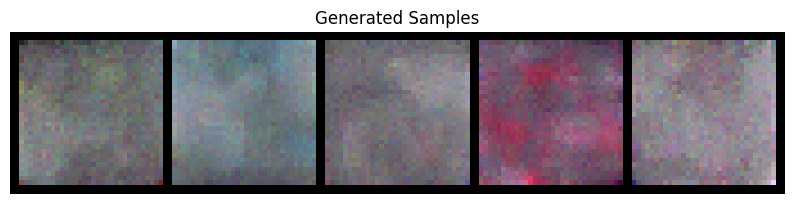


Training - Epoch 7 average loss: 0.0605
Running validation...
Validation - Epoch 7 average loss: 0.0637
Learning rate: 0.001000

Generating samples for visual progress check...


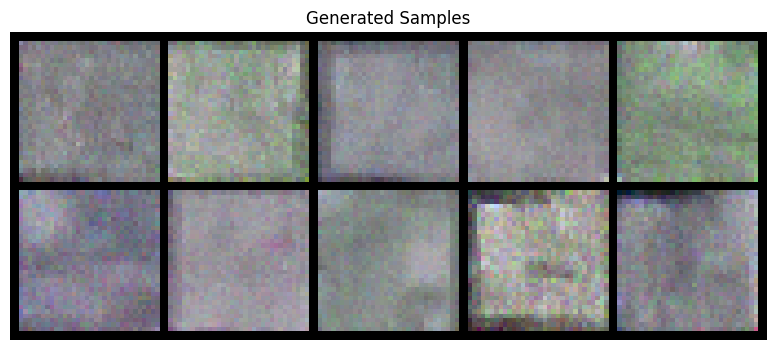

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0637)

Epoch 8/80
--------------------
  Step 0/1563, Loss: 0.0656
  Step 100/1563, Loss: 0.0578
  Step 200/1563, Loss: 0.0483
  Step 300/1563, Loss: 0.0440
  Step 400/1563, Loss: 0.0557
  Step 500/1563, Loss: 0.0898
  Generating samples...


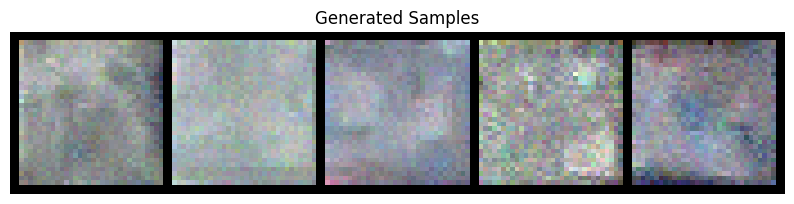

  Step 600/1563, Loss: 0.0536
  Step 700/1563, Loss: 0.0464
  Step 800/1563, Loss: 0.0539
  Step 900/1563, Loss: 0.0490
  Step 1000/1563, Loss: 0.0437
  Generating samples...


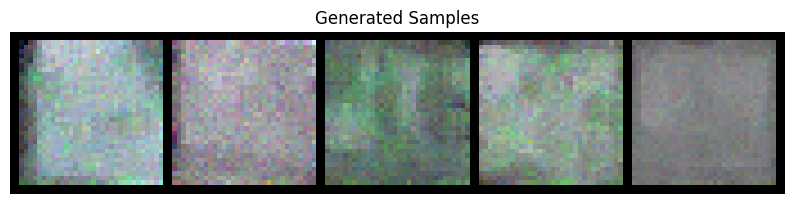

  Step 1100/1563, Loss: 0.0553
  Step 1200/1563, Loss: 0.0413
  Step 1300/1563, Loss: 0.0644
  Step 1400/1563, Loss: 0.0559
  Step 1500/1563, Loss: 0.0460
  Generating samples...


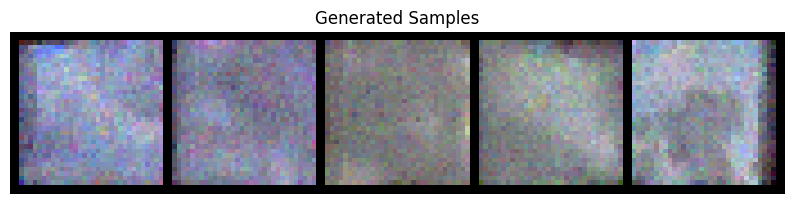


Training - Epoch 8 average loss: 0.0598
Running validation...
Validation - Epoch 8 average loss: 0.0630
Learning rate: 0.001000
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0630)

Epoch 9/80
--------------------
  Step 0/1563, Loss: 0.0653
  Step 100/1563, Loss: 0.0421
  Step 200/1563, Loss: 0.0654
  Step 300/1563, Loss: 0.0762
  Step 400/1563, Loss: 0.0817
  Step 500/1563, Loss: 0.0438
  Generating samples...


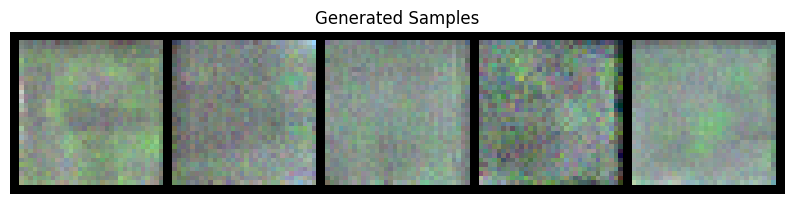

  Step 600/1563, Loss: 0.0400
  Step 700/1563, Loss: 0.0702
  Step 800/1563, Loss: 0.0655
  Step 900/1563, Loss: 0.0647
  Step 1000/1563, Loss: 0.0767
  Generating samples...


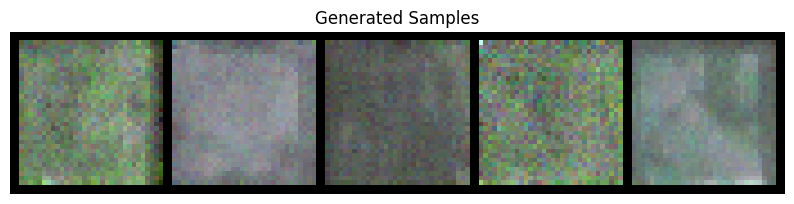

  Step 1100/1563, Loss: 0.0801
  Step 1200/1563, Loss: 0.0440
  Step 1300/1563, Loss: 0.0451
  Step 1400/1563, Loss: 0.0366
  Step 1500/1563, Loss: 0.0484
  Generating samples...


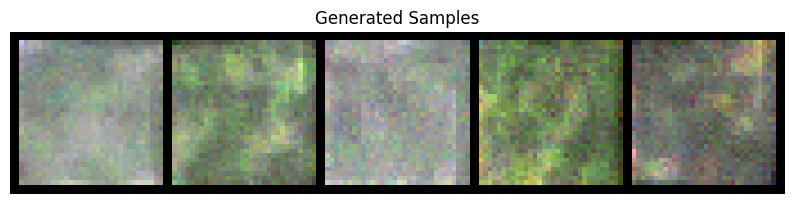


Training - Epoch 9 average loss: 0.0598
Running validation...
Validation - Epoch 9 average loss: 0.0648
Learning rate: 0.001000

Generating samples for visual progress check...


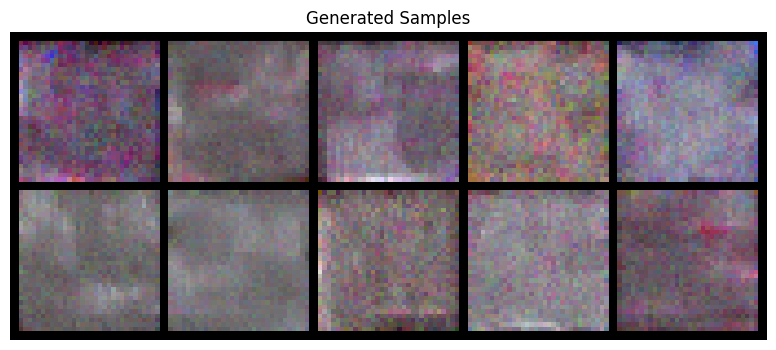

No improvement for 1/10 epochs

Epoch 10/80
--------------------
  Step 0/1563, Loss: 0.0644
  Step 100/1563, Loss: 0.0660
  Step 200/1563, Loss: 0.1003
  Step 300/1563, Loss: 0.0652
  Step 400/1563, Loss: 0.0649
  Step 500/1563, Loss: 0.0471
  Generating samples...


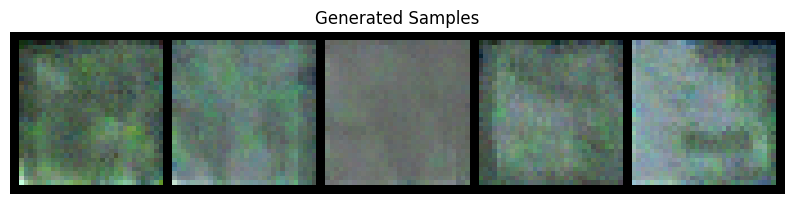

  Step 600/1563, Loss: 0.0496
  Step 700/1563, Loss: 0.0677
  Step 800/1563, Loss: 0.0674
  Step 900/1563, Loss: 0.0636
  Step 1000/1563, Loss: 0.0641
  Generating samples...


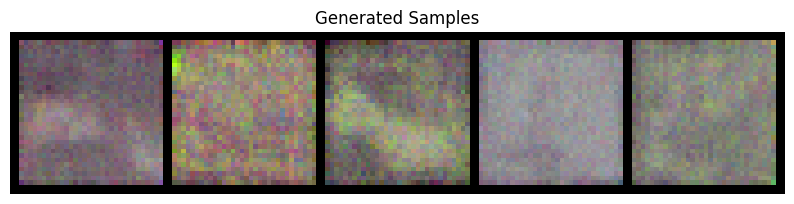

  Step 1100/1563, Loss: 0.0918
  Step 1200/1563, Loss: 0.0558
  Step 1300/1563, Loss: 0.0783
  Step 1400/1563, Loss: 0.0575
  Step 1500/1563, Loss: 0.0597
  Generating samples...


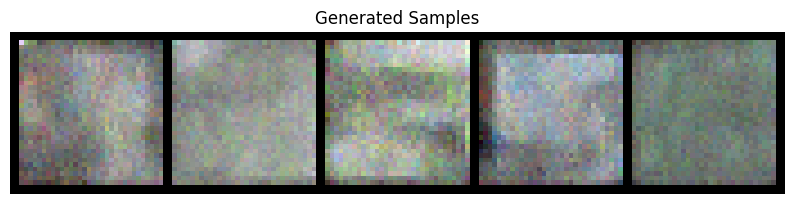


Training - Epoch 10 average loss: 0.0594
Running validation...
Validation - Epoch 10 average loss: 0.0643
Learning rate: 0.001000
No improvement for 2/10 epochs

Epoch 11/80
--------------------
  Step 0/1563, Loss: 0.0600
  Step 100/1563, Loss: 0.0608
  Step 200/1563, Loss: 0.0733
  Step 300/1563, Loss: 0.0898
  Step 400/1563, Loss: 0.0735
  Step 500/1563, Loss: 0.0418
  Generating samples...


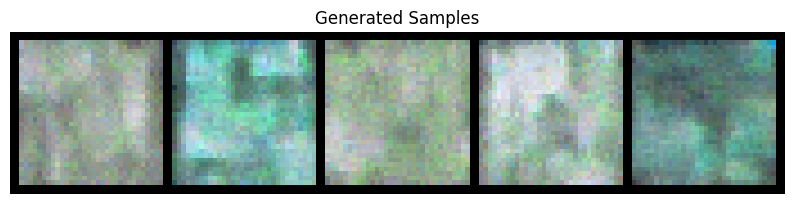

  Step 600/1563, Loss: 0.0628
  Step 700/1563, Loss: 0.0877
  Step 800/1563, Loss: 0.0466
  Step 900/1563, Loss: 0.0692
  Step 1000/1563, Loss: 0.0492
  Generating samples...


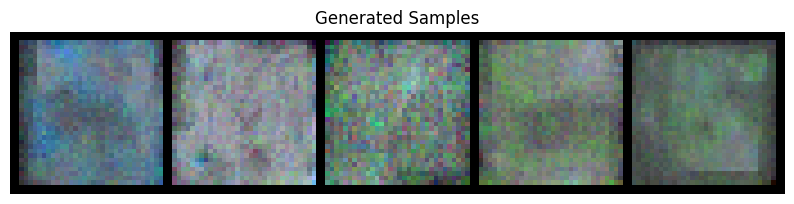

  Step 1100/1563, Loss: 0.0561
  Step 1200/1563, Loss: 0.0611
  Step 1300/1563, Loss: 0.0923
  Step 1400/1563, Loss: 0.0553
  Step 1500/1563, Loss: 0.0497
  Generating samples...


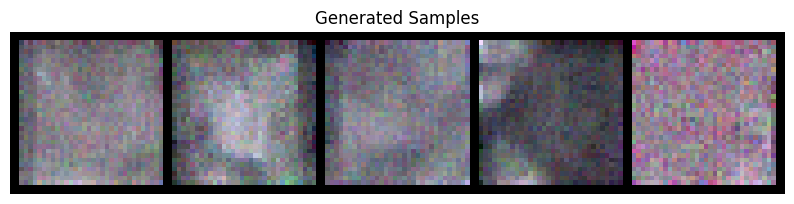


Training - Epoch 11 average loss: 0.0596
Running validation...
Validation - Epoch 11 average loss: 0.0646
Learning rate: 0.001000

Generating samples for visual progress check...


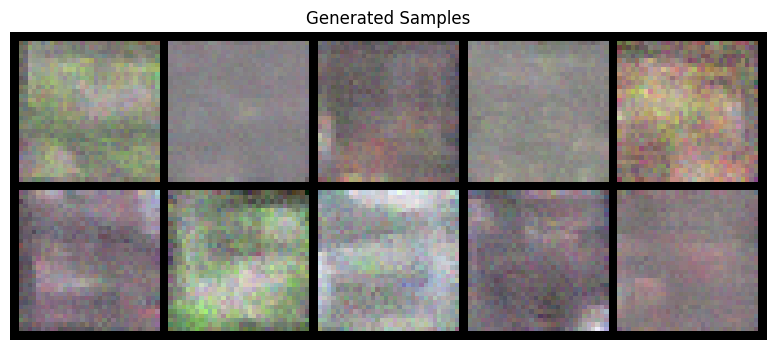

No improvement for 3/10 epochs


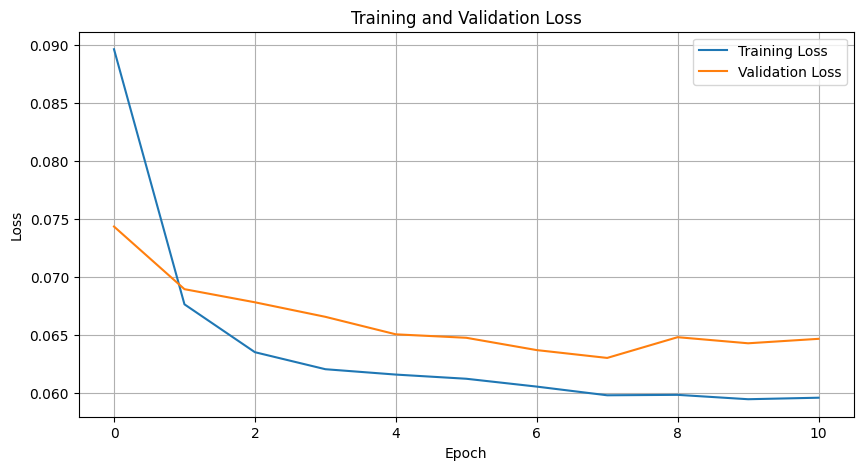


Epoch 12/80
--------------------
  Step 0/1563, Loss: 0.0702
  Step 100/1563, Loss: 0.0450
  Step 200/1563, Loss: 0.0613
  Step 300/1563, Loss: 0.0587
  Step 400/1563, Loss: 0.0518
  Step 500/1563, Loss: 0.0695
  Generating samples...


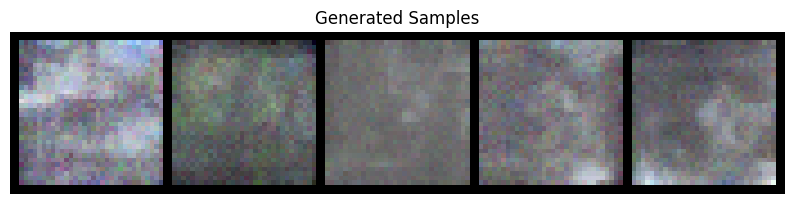

  Step 600/1563, Loss: 0.0541
  Step 700/1563, Loss: 0.0499
  Step 800/1563, Loss: 0.0681
  Step 900/1563, Loss: 0.0533
  Step 1000/1563, Loss: 0.0524
  Generating samples...


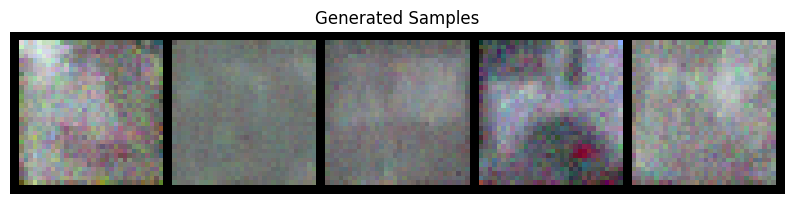

  Step 1100/1563, Loss: 0.0778
  Step 1200/1563, Loss: 0.0653
  Step 1300/1563, Loss: 0.0574
  Step 1400/1563, Loss: 0.0741
  Step 1500/1563, Loss: 0.0811
  Generating samples...


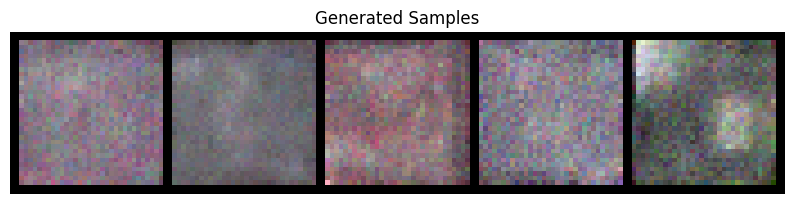


Training - Epoch 12 average loss: 0.0591
Running validation...
Validation - Epoch 12 average loss: 0.0648
Learning rate: 0.001000
No improvement for 4/10 epochs

Epoch 13/80
--------------------
  Step 0/1563, Loss: 0.0770
  Step 100/1563, Loss: 0.0601
  Step 200/1563, Loss: 0.0857
  Step 300/1563, Loss: 0.0417
  Step 400/1563, Loss: 0.0575
  Step 500/1563, Loss: 0.0586
  Generating samples...


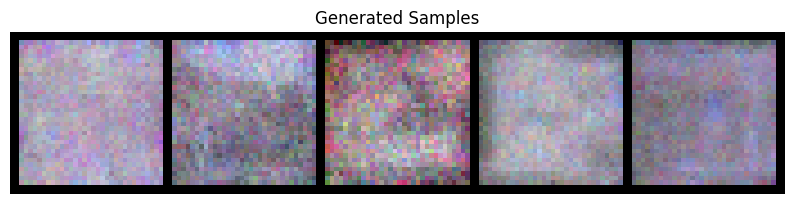

  Step 600/1563, Loss: 0.0456
  Step 700/1563, Loss: 0.0803
  Step 800/1563, Loss: 0.0446
  Step 900/1563, Loss: 0.0671
  Step 1000/1563, Loss: 0.0322
  Generating samples...


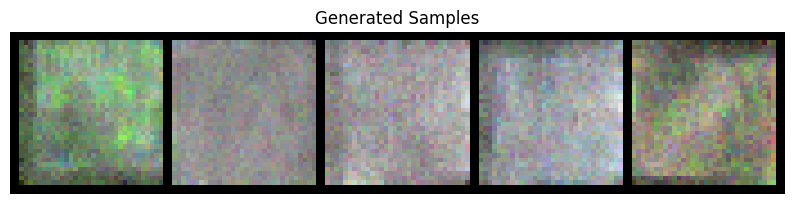

  Step 1100/1563, Loss: 0.0556
  Step 1200/1563, Loss: 0.0643
  Step 1300/1563, Loss: 0.0511
  Step 1400/1563, Loss: 0.0620
  Step 1500/1563, Loss: 0.0436
  Generating samples...


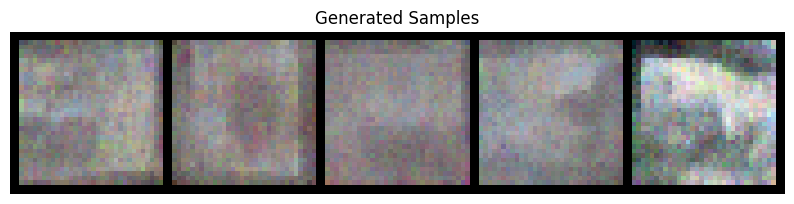


Training - Epoch 13 average loss: 0.0594
Running validation...
Validation - Epoch 13 average loss: 0.0653
Learning rate: 0.001000

Generating samples for visual progress check...


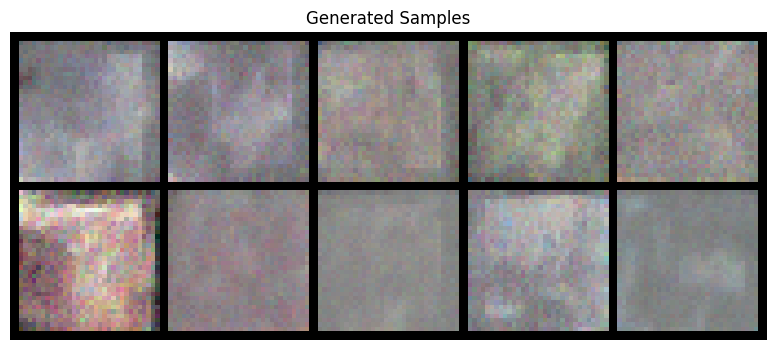

No improvement for 5/10 epochs

Epoch 14/80
--------------------
  Step 0/1563, Loss: 0.0550
  Step 100/1563, Loss: 0.0684
  Step 200/1563, Loss: 0.0465
  Step 300/1563, Loss: 0.0817
  Step 400/1563, Loss: 0.0515
  Step 500/1563, Loss: 0.0529
  Generating samples...


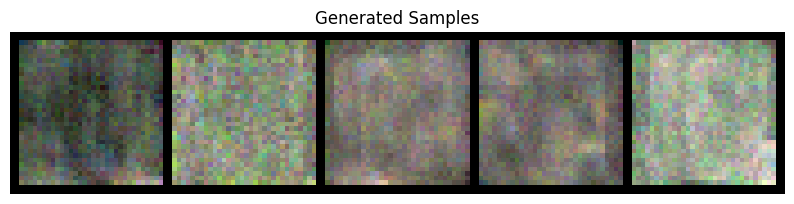

  Step 600/1563, Loss: 0.0522
  Step 700/1563, Loss: 0.0735
  Step 800/1563, Loss: 0.0611
  Step 900/1563, Loss: 0.0372
  Step 1000/1563, Loss: 0.0358
  Generating samples...


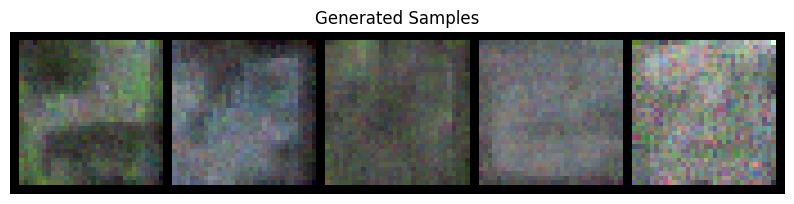

  Step 1100/1563, Loss: 0.0643
  Step 1200/1563, Loss: 0.0648
  Step 1300/1563, Loss: 0.0527
  Step 1400/1563, Loss: 0.0372
  Step 1500/1563, Loss: 0.0579
  Generating samples...


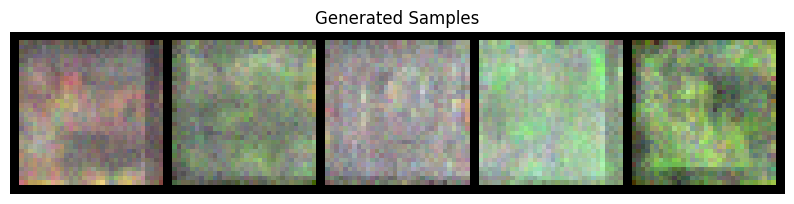


Training - Epoch 14 average loss: 0.0588
Running validation...
Validation - Epoch 14 average loss: 0.0647
Learning rate: 0.000500
No improvement for 6/10 epochs

Epoch 15/80
--------------------
  Step 0/1563, Loss: 0.0576
  Step 100/1563, Loss: 0.0503
  Step 200/1563, Loss: 0.0543
  Step 300/1563, Loss: 0.0423
  Step 400/1563, Loss: 0.0441
  Step 500/1563, Loss: 0.0516
  Generating samples...


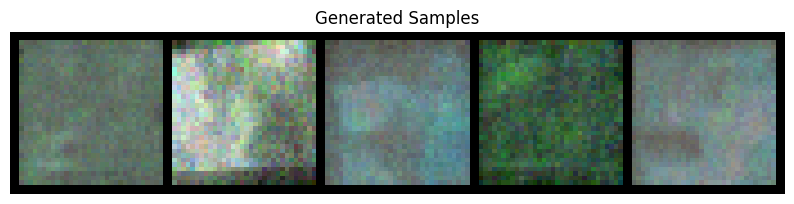

  Step 600/1563, Loss: 0.0606
  Step 700/1563, Loss: 0.0963
  Step 800/1563, Loss: 0.0376
  Step 900/1563, Loss: 0.0978
  Step 1000/1563, Loss: 0.0897
  Generating samples...


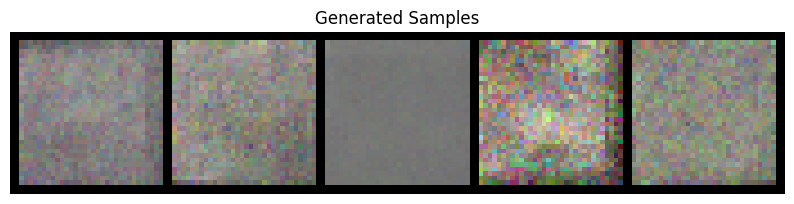

  Step 1100/1563, Loss: 0.0725
  Step 1200/1563, Loss: 0.0409
  Step 1300/1563, Loss: 0.0499
  Step 1400/1563, Loss: 0.0628
  Step 1500/1563, Loss: 0.0617
  Generating samples...


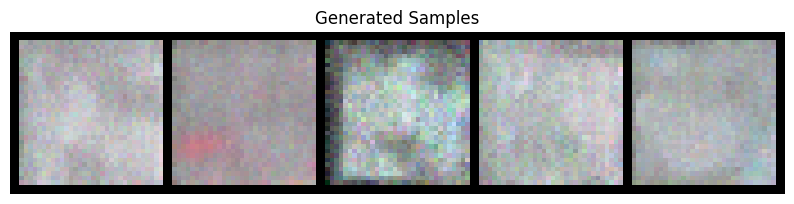


Training - Epoch 15 average loss: 0.0574
Running validation...
Validation - Epoch 15 average loss: 0.0641
Learning rate: 0.000500

Generating samples for visual progress check...


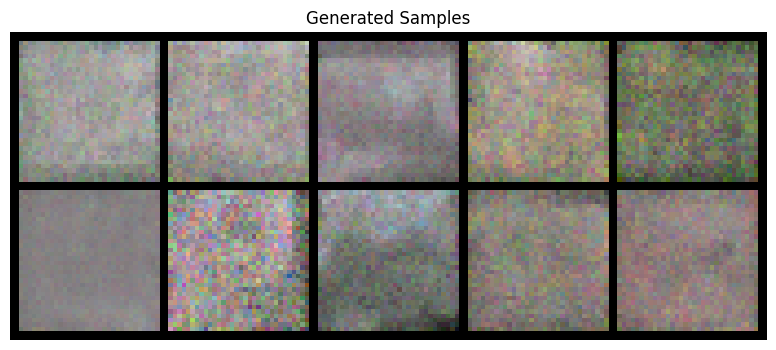

No improvement for 7/10 epochs

Epoch 16/80
--------------------
  Step 0/1563, Loss: 0.0419
  Step 100/1563, Loss: 0.0758
  Step 200/1563, Loss: 0.0515
  Step 300/1563, Loss: 0.0672
  Step 400/1563, Loss: 0.0501
  Step 500/1563, Loss: 0.0664
  Generating samples...


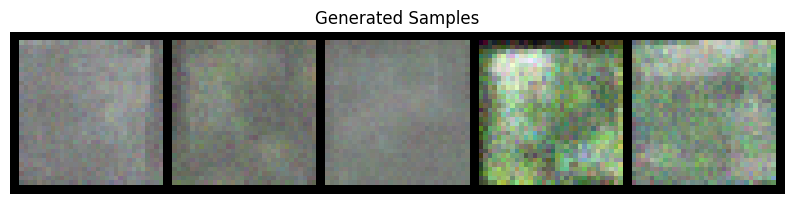

  Step 600/1563, Loss: 0.0708
  Step 700/1563, Loss: 0.0414
  Step 800/1563, Loss: 0.0471
  Step 900/1563, Loss: 0.1176
  Step 1000/1563, Loss: 0.0676
  Generating samples...


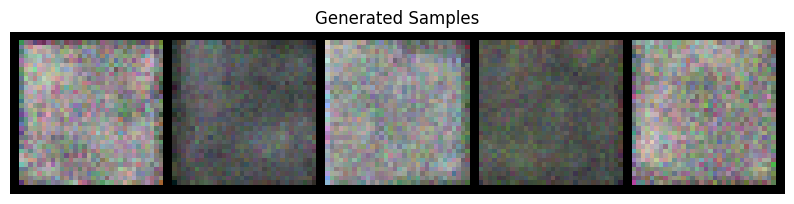

  Step 1100/1563, Loss: 0.0594
  Step 1200/1563, Loss: 0.0502
  Step 1300/1563, Loss: 0.0636
  Step 1400/1563, Loss: 0.0474
  Step 1500/1563, Loss: 0.0478
  Generating samples...


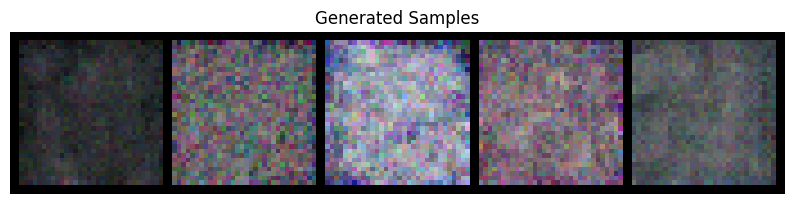


Training - Epoch 16 average loss: 0.0574
Running validation...
Validation - Epoch 16 average loss: 0.0621
Learning rate: 0.000500
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0621)


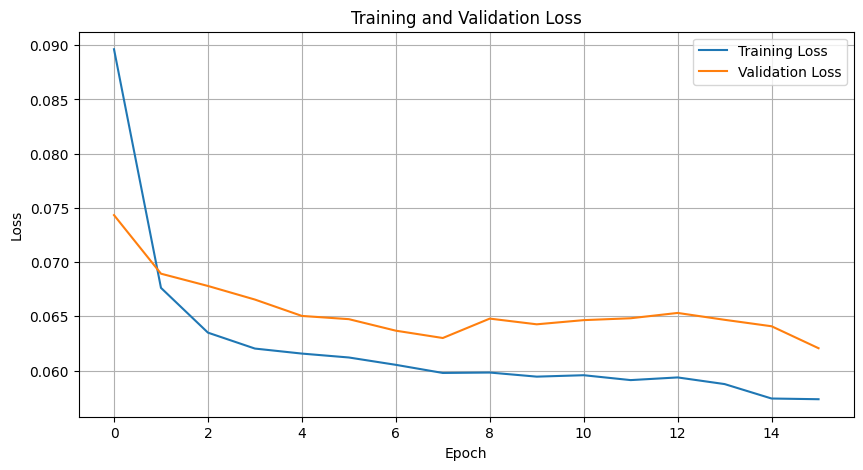


Epoch 17/80
--------------------
  Step 0/1563, Loss: 0.0512
  Step 100/1563, Loss: 0.0760
  Step 200/1563, Loss: 0.0510
  Step 300/1563, Loss: 0.0433
  Step 400/1563, Loss: 0.0551
  Step 500/1563, Loss: 0.0323
  Generating samples...


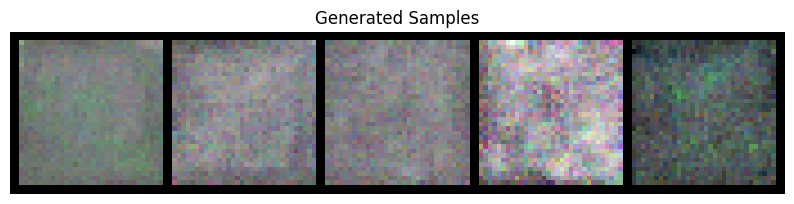

  Step 600/1563, Loss: 0.0850
  Step 700/1563, Loss: 0.0594
  Step 800/1563, Loss: 0.0676
  Step 900/1563, Loss: 0.0652
  Step 1000/1563, Loss: 0.0799
  Generating samples...


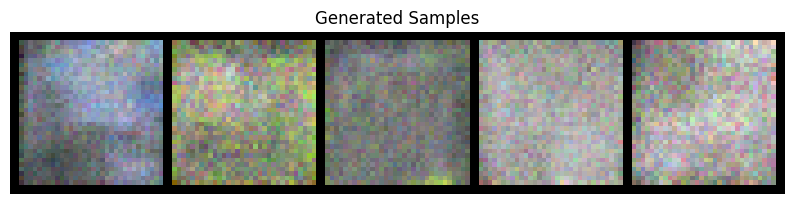

  Step 1100/1563, Loss: 0.0557
  Step 1200/1563, Loss: 0.0582
  Step 1300/1563, Loss: 0.0719
  Step 1400/1563, Loss: 0.0973
  Step 1500/1563, Loss: 0.0417
  Generating samples...


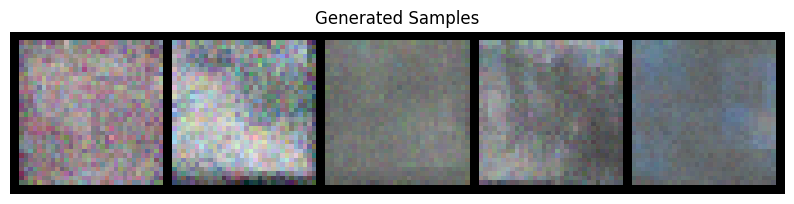


Training - Epoch 17 average loss: 0.0572
Running validation...
Validation - Epoch 17 average loss: 0.0628
Learning rate: 0.000500

Generating samples for visual progress check...


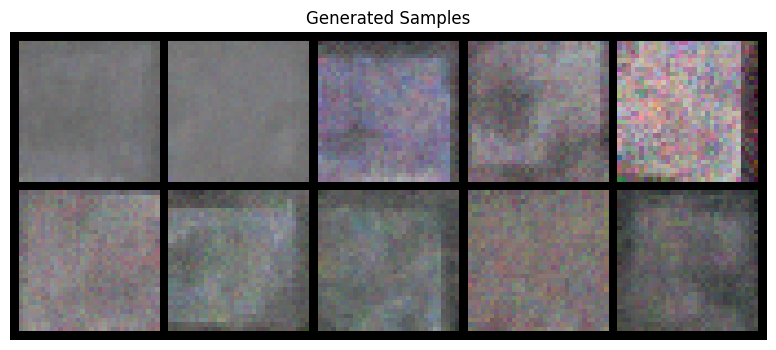

No improvement for 1/10 epochs

Epoch 18/80
--------------------
  Step 0/1563, Loss: 0.0607
  Step 100/1563, Loss: 0.0504
  Step 200/1563, Loss: 0.0550
  Step 300/1563, Loss: 0.0441
  Step 400/1563, Loss: 0.0821
  Step 500/1563, Loss: 0.0616
  Generating samples...


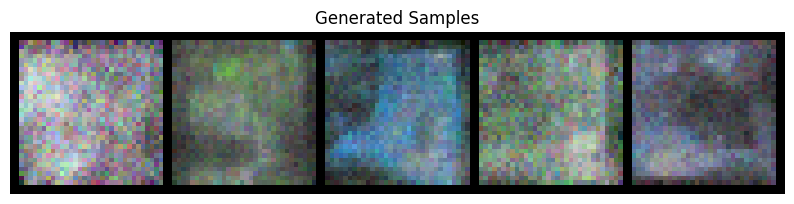

  Step 600/1563, Loss: 0.0439
  Step 700/1563, Loss: 0.0479
  Step 800/1563, Loss: 0.0666
  Step 900/1563, Loss: 0.0501
  Step 1000/1563, Loss: 0.0531
  Generating samples...


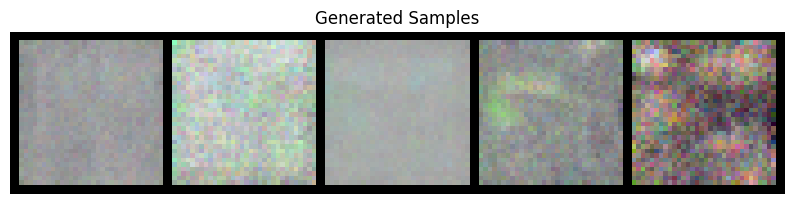

  Step 1100/1563, Loss: 0.0588
  Step 1200/1563, Loss: 0.0603
  Step 1300/1563, Loss: 0.0497
  Step 1400/1563, Loss: 0.0522
  Step 1500/1563, Loss: 0.0789
  Generating samples...


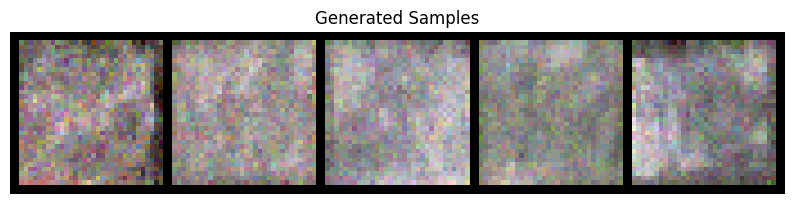


Training - Epoch 18 average loss: 0.0579
Running validation...
Validation - Epoch 18 average loss: 0.0630
Learning rate: 0.000500
No improvement for 2/10 epochs

Epoch 19/80
--------------------
  Step 0/1563, Loss: 0.0756
  Step 100/1563, Loss: 0.0439
  Step 200/1563, Loss: 0.0390
  Step 300/1563, Loss: 0.0597
  Step 400/1563, Loss: 0.0569
  Step 500/1563, Loss: 0.0498
  Generating samples...


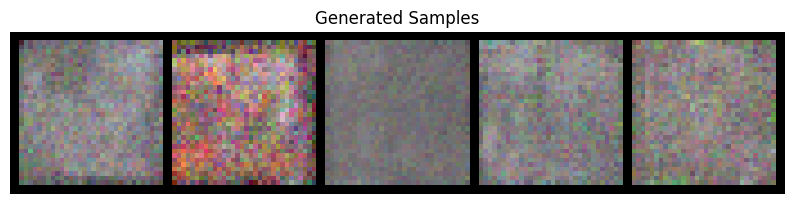

  Step 600/1563, Loss: 0.0620
  Step 700/1563, Loss: 0.0292
  Step 800/1563, Loss: 0.0746
  Step 900/1563, Loss: 0.0669
  Step 1000/1563, Loss: 0.0757
  Generating samples...


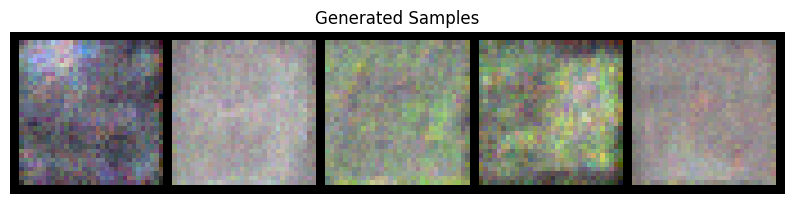

  Step 1100/1563, Loss: 0.0361
  Step 1200/1563, Loss: 0.0407
  Step 1300/1563, Loss: 0.0511
  Step 1400/1563, Loss: 0.0596
  Step 1500/1563, Loss: 0.0506
  Generating samples...


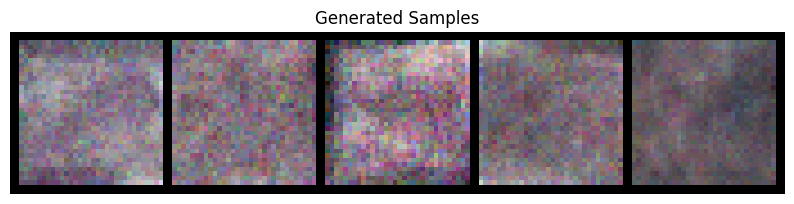


Training - Epoch 19 average loss: 0.0578
Running validation...
Validation - Epoch 19 average loss: 0.0615
Learning rate: 0.000500

Generating samples for visual progress check...


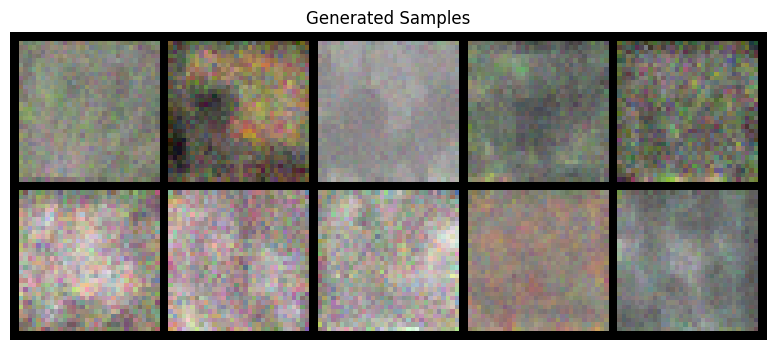

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0615)

Epoch 20/80
--------------------
  Step 0/1563, Loss: 0.0496
  Step 100/1563, Loss: 0.0705
  Step 200/1563, Loss: 0.0367
  Step 300/1563, Loss: 0.0460
  Step 400/1563, Loss: 0.0617
  Step 500/1563, Loss: 0.0601
  Generating samples...


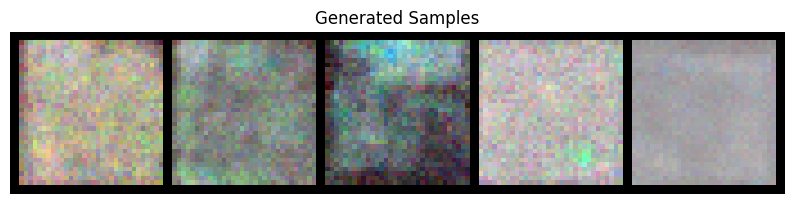

  Step 600/1563, Loss: 0.0795
  Step 700/1563, Loss: 0.0464
  Step 800/1563, Loss: 0.0699
  Step 900/1563, Loss: 0.0466
  Step 1000/1563, Loss: 0.0479
  Generating samples...


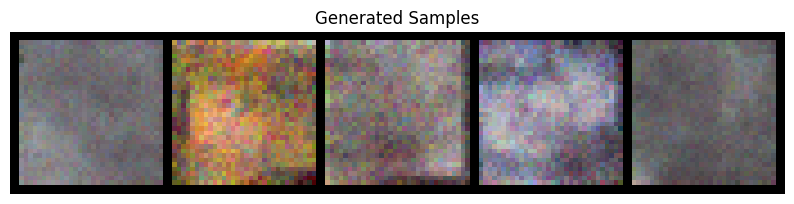

  Step 1100/1563, Loss: 0.0551
  Step 1200/1563, Loss: 0.0483
  Step 1300/1563, Loss: 0.0492
  Step 1400/1563, Loss: 0.0914
  Step 1500/1563, Loss: 0.0399
  Generating samples...


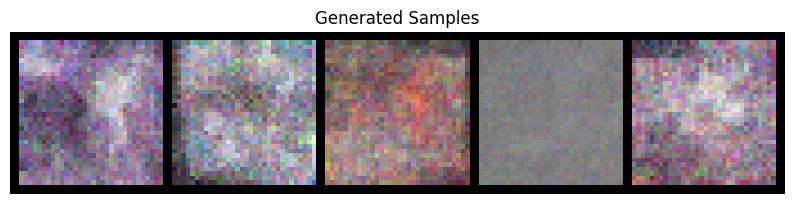


Training - Epoch 20 average loss: 0.0572
Running validation...
Validation - Epoch 20 average loss: 0.0635
Learning rate: 0.000500
No improvement for 1/10 epochs

Epoch 21/80
--------------------
  Step 0/1563, Loss: 0.0646
  Step 100/1563, Loss: 0.0509
  Step 200/1563, Loss: 0.0422
  Step 300/1563, Loss: 0.0510
  Step 400/1563, Loss: 0.0580
  Step 500/1563, Loss: 0.0702
  Generating samples...


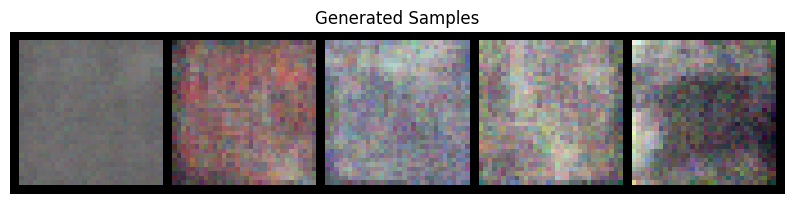

  Step 600/1563, Loss: 0.0518
  Step 700/1563, Loss: 0.0652
  Step 800/1563, Loss: 0.0371
  Step 900/1563, Loss: 0.0598
  Step 1000/1563, Loss: 0.0541
  Generating samples...


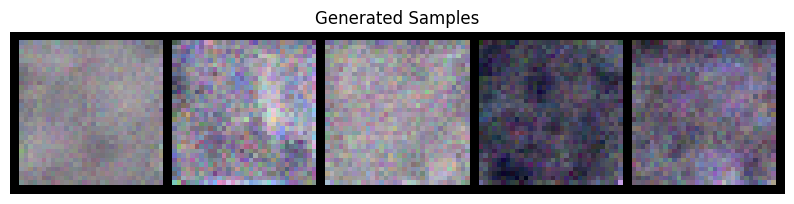

  Step 1100/1563, Loss: 0.0594
  Step 1200/1563, Loss: 0.0702
  Step 1300/1563, Loss: 0.0442
  Step 1400/1563, Loss: 0.0662
  Step 1500/1563, Loss: 0.0672
  Generating samples...


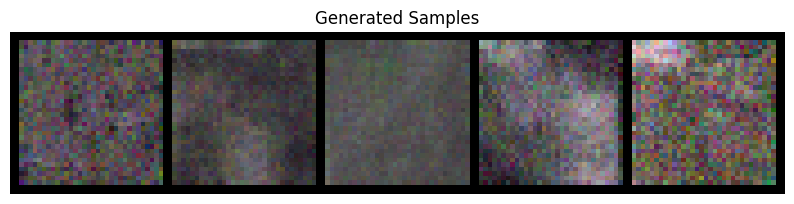


Training - Epoch 21 average loss: 0.0576
Running validation...
Validation - Epoch 21 average loss: 0.0623
Learning rate: 0.000500

Generating samples for visual progress check...


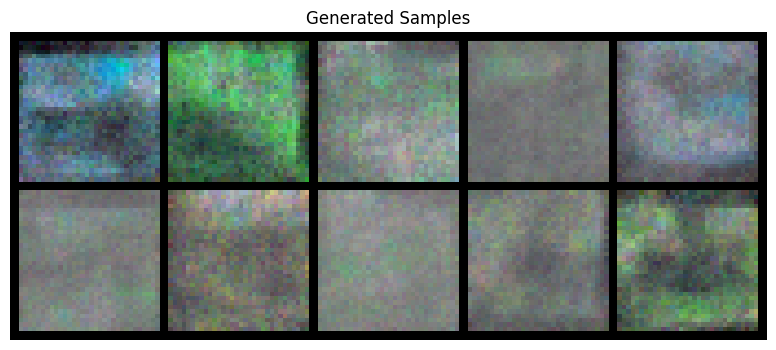

No improvement for 2/10 epochs


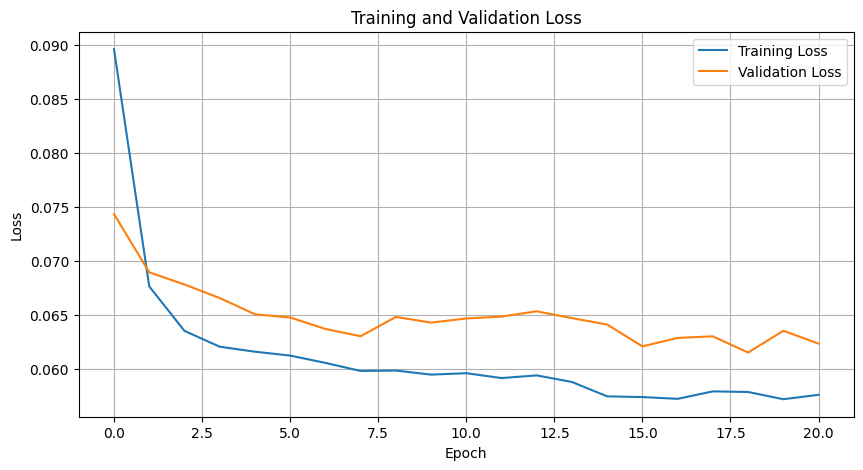


Epoch 22/80
--------------------
  Step 0/1563, Loss: 0.0428
  Step 100/1563, Loss: 0.0649
  Step 200/1563, Loss: 0.0542
  Step 300/1563, Loss: 0.0490
  Step 400/1563, Loss: 0.0746
  Step 500/1563, Loss: 0.0578
  Generating samples...


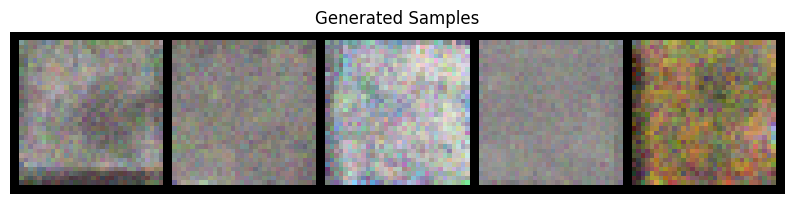

  Step 600/1563, Loss: 0.0542
  Step 700/1563, Loss: 0.0559
  Step 800/1563, Loss: 0.0545
  Step 900/1563, Loss: 0.0554
  Step 1000/1563, Loss: 0.0578
  Generating samples...


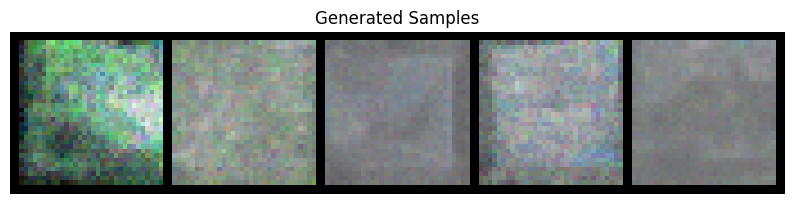

  Step 1100/1563, Loss: 0.0253
  Step 1200/1563, Loss: 0.0591
  Step 1300/1563, Loss: 0.0636
  Step 1400/1563, Loss: 0.0713
  Step 1500/1563, Loss: 0.0653
  Generating samples...


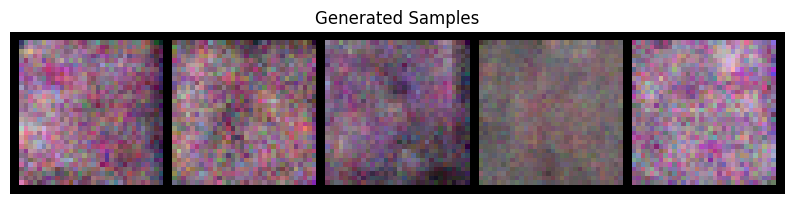


Training - Epoch 22 average loss: 0.0570
Running validation...
Validation - Epoch 22 average loss: 0.0648
Learning rate: 0.000500
No improvement for 3/10 epochs

Epoch 23/80
--------------------
  Step 0/1563, Loss: 0.0501
  Step 100/1563, Loss: 0.0569
  Step 200/1563, Loss: 0.0672
  Step 300/1563, Loss: 0.0434
  Step 400/1563, Loss: 0.0612
  Step 500/1563, Loss: 0.0579
  Generating samples...


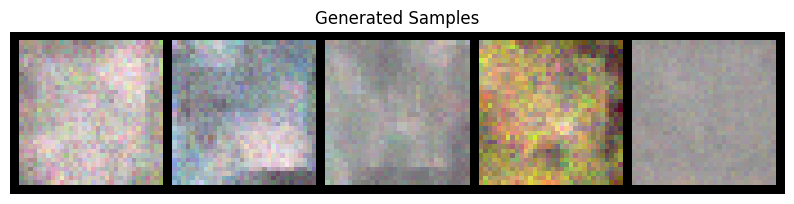

  Step 600/1563, Loss: 0.0494
  Step 700/1563, Loss: 0.0455
  Step 800/1563, Loss: 0.0458
  Step 900/1563, Loss: 0.0779
  Step 1000/1563, Loss: 0.0493
  Generating samples...


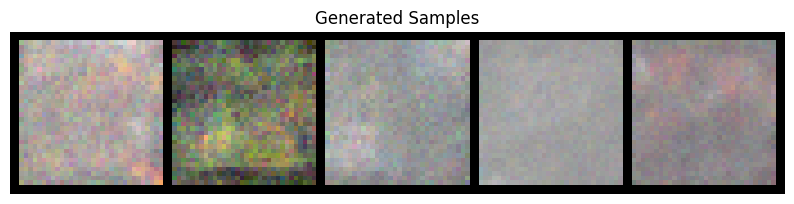

  Step 1100/1563, Loss: 0.0452
  Step 1200/1563, Loss: 0.0743
  Step 1300/1563, Loss: 0.0428
  Step 1400/1563, Loss: 0.0770
  Step 1500/1563, Loss: 0.0510
  Generating samples...


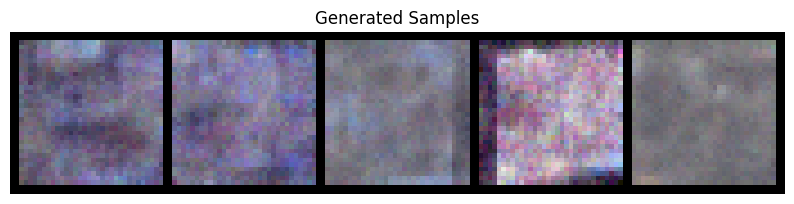


Training - Epoch 23 average loss: 0.0575
Running validation...
Validation - Epoch 23 average loss: 0.0621
Learning rate: 0.000500

Generating samples for visual progress check...


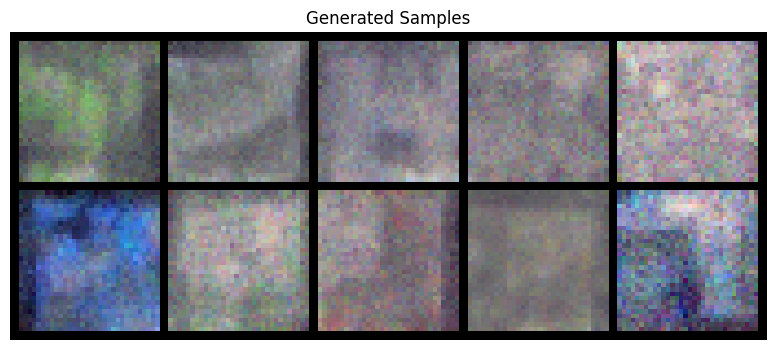

No improvement for 4/10 epochs

Epoch 24/80
--------------------
  Step 0/1563, Loss: 0.0799
  Step 100/1563, Loss: 0.0470
  Step 200/1563, Loss: 0.0439
  Step 300/1563, Loss: 0.0525
  Step 400/1563, Loss: 0.0658
  Step 500/1563, Loss: 0.0447
  Generating samples...


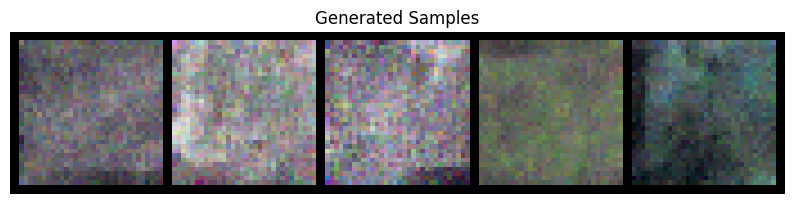

  Step 600/1563, Loss: 0.0633
  Step 700/1563, Loss: 0.0815
  Step 800/1563, Loss: 0.0687
  Step 900/1563, Loss: 0.0575
  Step 1000/1563, Loss: 0.0602
  Generating samples...


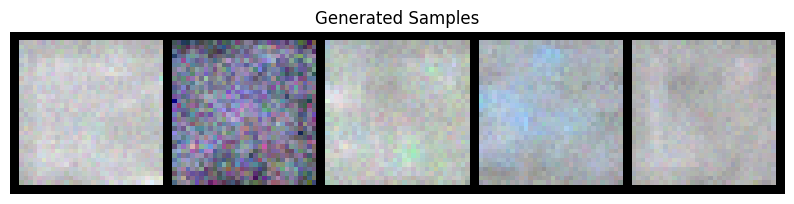

  Step 1100/1563, Loss: 0.0443
  Step 1200/1563, Loss: 0.0327
  Step 1300/1563, Loss: 0.0524
  Step 1400/1563, Loss: 0.0801
  Step 1500/1563, Loss: 0.0710
  Generating samples...


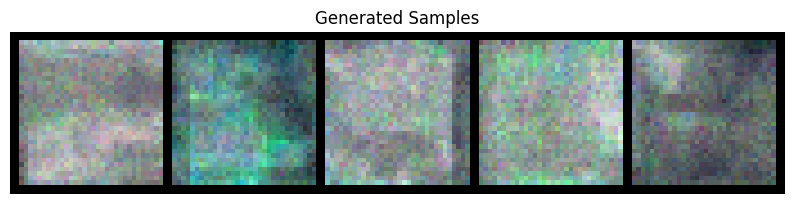


Training - Epoch 24 average loss: 0.0572
Running validation...
Validation - Epoch 24 average loss: 0.0626
Learning rate: 0.000500
No improvement for 5/10 epochs

Epoch 25/80
--------------------
  Step 0/1563, Loss: 0.0464
  Step 100/1563, Loss: 0.0421
  Step 200/1563, Loss: 0.0643
  Step 300/1563, Loss: 0.0507
  Step 400/1563, Loss: 0.0619
  Step 500/1563, Loss: 0.0427
  Generating samples...


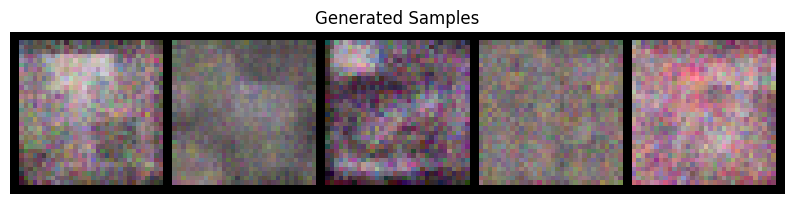

  Step 600/1563, Loss: 0.0635
  Step 700/1563, Loss: 0.0602
  Step 800/1563, Loss: 0.0600
  Step 900/1563, Loss: 0.0485
  Step 1000/1563, Loss: 0.0679
  Generating samples...


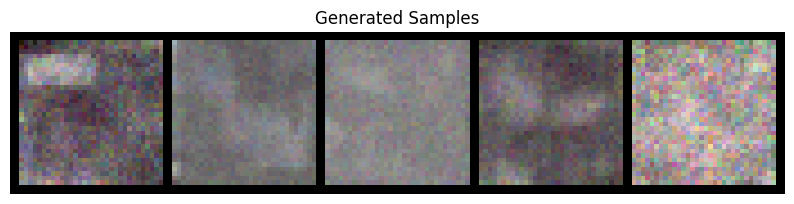

  Step 1100/1563, Loss: 0.0392
  Step 1200/1563, Loss: 0.0807
  Step 1300/1563, Loss: 0.0544
  Step 1400/1563, Loss: 0.0361
  Step 1500/1563, Loss: 0.0537
  Generating samples...


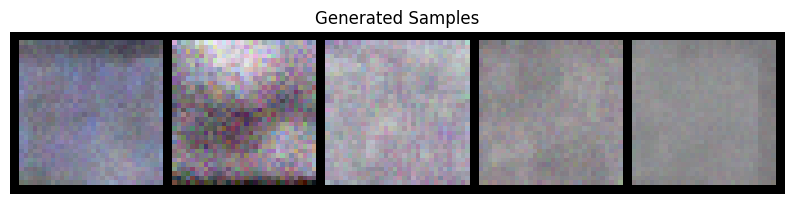


Training - Epoch 25 average loss: 0.0578
Running validation...
Validation - Epoch 25 average loss: 0.0627
Learning rate: 0.000250

Generating samples for visual progress check...


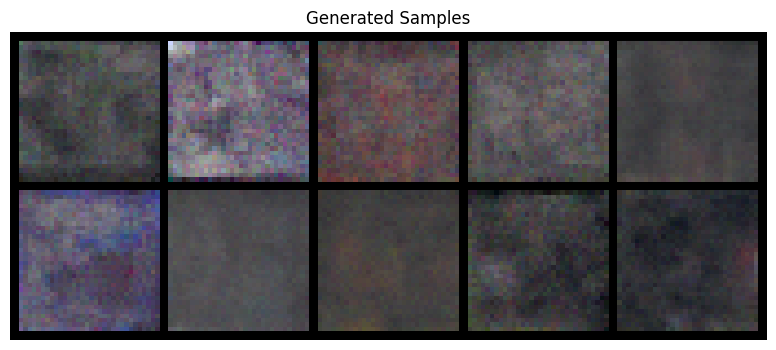

No improvement for 6/10 epochs

Epoch 26/80
--------------------
  Step 0/1563, Loss: 0.0418
  Step 100/1563, Loss: 0.0509
  Step 200/1563, Loss: 0.0476
  Step 300/1563, Loss: 0.0573
  Step 400/1563, Loss: 0.0736
  Step 500/1563, Loss: 0.0426
  Generating samples...


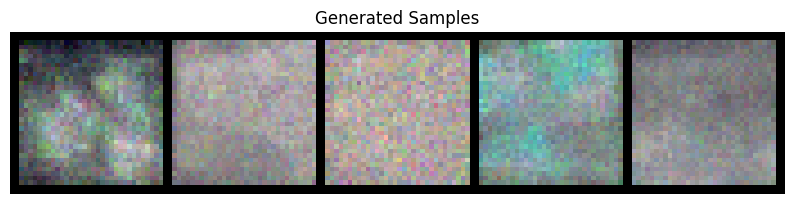

  Step 600/1563, Loss: 0.0607
  Step 700/1563, Loss: 0.0651
  Step 800/1563, Loss: 0.0437
  Step 900/1563, Loss: 0.0452
  Step 1000/1563, Loss: 0.0715
  Generating samples...


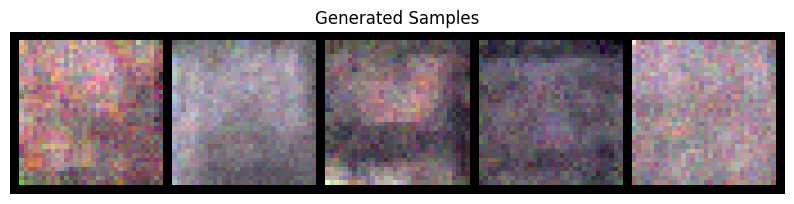

  Step 1100/1563, Loss: 0.0707
  Step 1200/1563, Loss: 0.0377
  Step 1300/1563, Loss: 0.0683
  Step 1400/1563, Loss: 0.0493
  Step 1500/1563, Loss: 0.0610
  Generating samples...


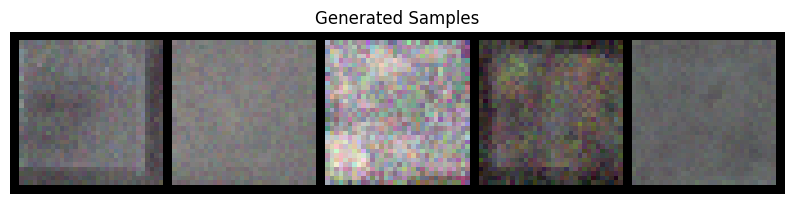


Training - Epoch 26 average loss: 0.0562
Running validation...
Validation - Epoch 26 average loss: 0.0609
Learning rate: 0.000250
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0609)


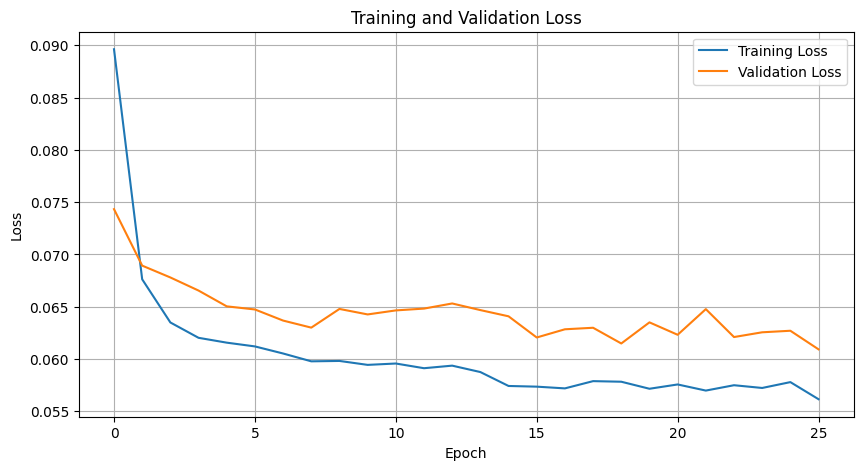


Epoch 27/80
--------------------
  Step 0/1563, Loss: 0.0645
  Step 100/1563, Loss: 0.0562
  Step 200/1563, Loss: 0.0709
  Step 300/1563, Loss: 0.0506
  Step 400/1563, Loss: 0.0413
  Step 500/1563, Loss: 0.0418
  Generating samples...


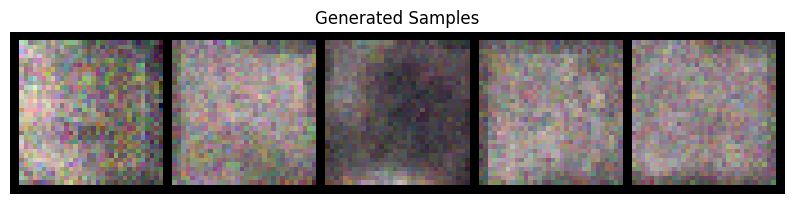

  Step 600/1563, Loss: 0.0397
  Step 700/1563, Loss: 0.0812
  Step 800/1563, Loss: 0.0544
  Step 900/1563, Loss: 0.0596
  Step 1000/1563, Loss: 0.0419
  Generating samples...


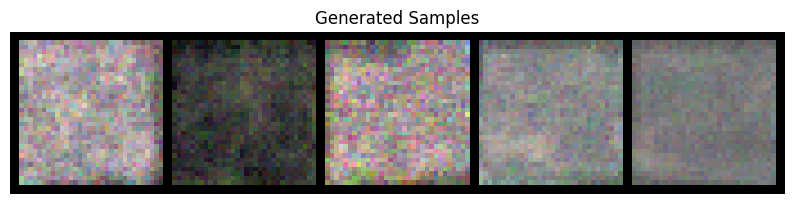

  Step 1100/1563, Loss: 0.0480
  Step 1200/1563, Loss: 0.0572
  Step 1300/1563, Loss: 0.0484
  Step 1400/1563, Loss: 0.0550
  Step 1500/1563, Loss: 0.0425
  Generating samples...


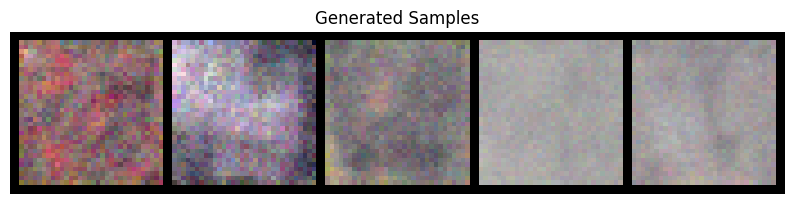


Training - Epoch 27 average loss: 0.0564
Running validation...
Validation - Epoch 27 average loss: 0.0618
Learning rate: 0.000250

Generating samples for visual progress check...


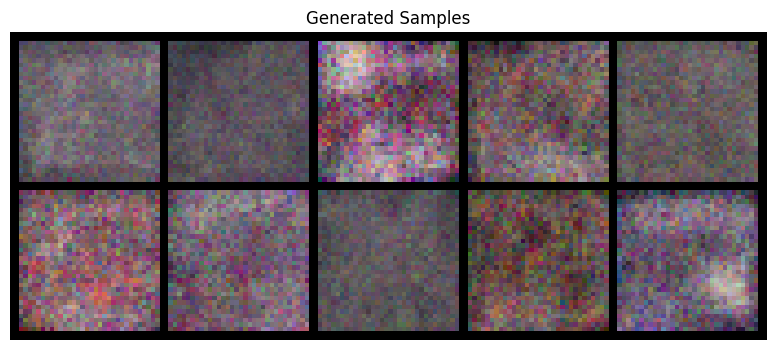

No improvement for 1/10 epochs

Epoch 28/80
--------------------
  Step 0/1563, Loss: 0.0424
  Step 100/1563, Loss: 0.0628
  Step 200/1563, Loss: 0.0679
  Step 300/1563, Loss: 0.0466
  Step 400/1563, Loss: 0.0528
  Step 500/1563, Loss: 0.0526
  Generating samples...


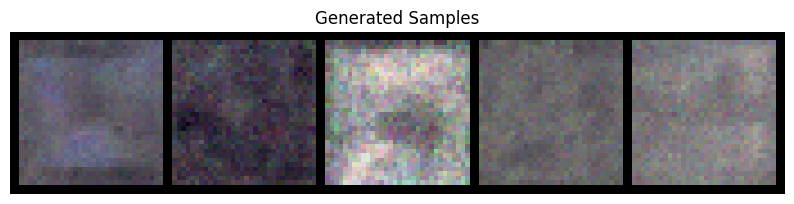

  Step 600/1563, Loss: 0.0538
  Step 700/1563, Loss: 0.0537
  Step 800/1563, Loss: 0.0631
  Step 900/1563, Loss: 0.0408
  Step 1000/1563, Loss: 0.0418
  Generating samples...


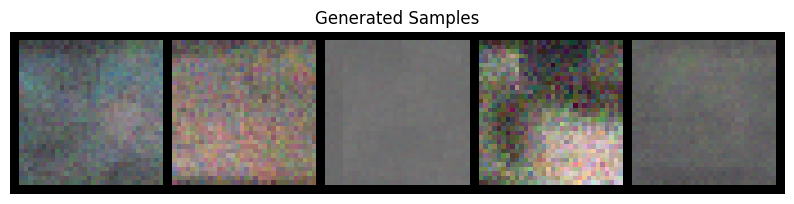

  Step 1100/1563, Loss: 0.0694
  Step 1200/1563, Loss: 0.0453
  Step 1300/1563, Loss: 0.0459
  Step 1400/1563, Loss: 0.0496
  Step 1500/1563, Loss: 0.0752
  Generating samples...


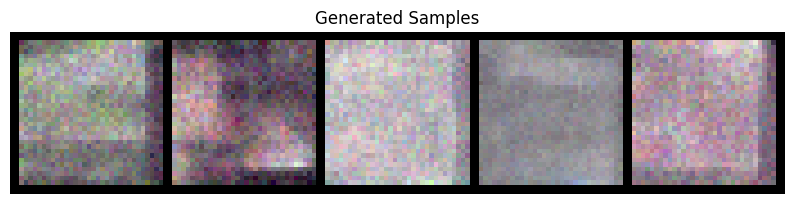


Training - Epoch 28 average loss: 0.0562
Running validation...
Validation - Epoch 28 average loss: 0.0636
Learning rate: 0.000250
No improvement for 2/10 epochs

Epoch 29/80
--------------------
  Step 0/1563, Loss: 0.0509
  Step 100/1563, Loss: 0.0513
  Step 200/1563, Loss: 0.0725
  Step 300/1563, Loss: 0.0558
  Step 400/1563, Loss: 0.0535
  Step 500/1563, Loss: 0.0668
  Generating samples...


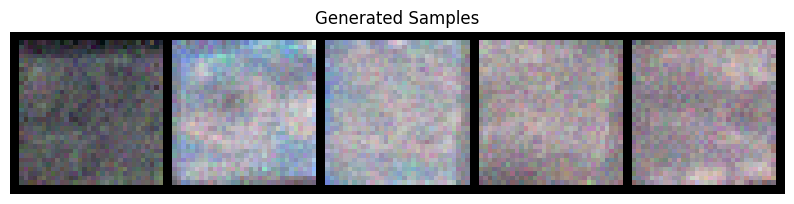

  Step 600/1563, Loss: 0.0661
  Step 700/1563, Loss: 0.0541
  Step 800/1563, Loss: 0.0471
  Step 900/1563, Loss: 0.0359
  Step 1000/1563, Loss: 0.0403
  Generating samples...


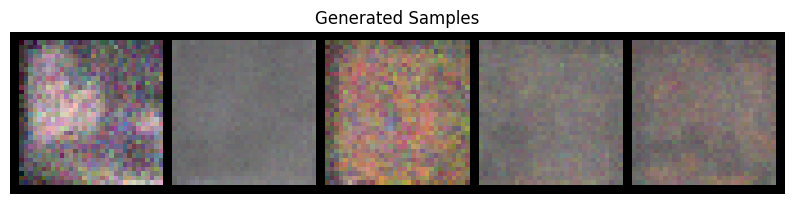

  Step 1100/1563, Loss: 0.0378
  Step 1200/1563, Loss: 0.0839
  Step 1300/1563, Loss: 0.0503
  Step 1400/1563, Loss: 0.0598
  Step 1500/1563, Loss: 0.0728
  Generating samples...


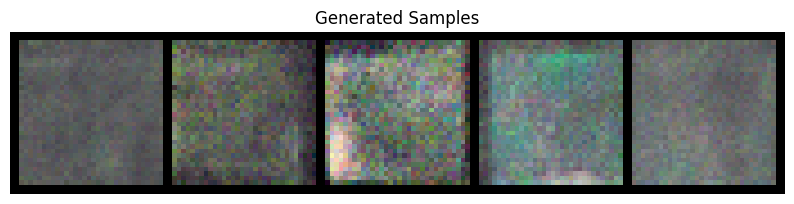


Training - Epoch 29 average loss: 0.0561
Running validation...
Validation - Epoch 29 average loss: 0.0635
Learning rate: 0.000250

Generating samples for visual progress check...


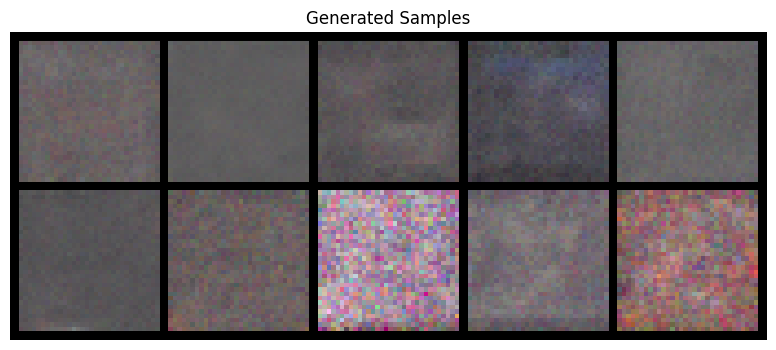

No improvement for 3/10 epochs

Epoch 30/80
--------------------
  Step 0/1563, Loss: 0.0720
  Step 100/1563, Loss: 0.0552
  Step 200/1563, Loss: 0.0350
  Step 300/1563, Loss: 0.0428
  Step 400/1563, Loss: 0.0569
  Step 500/1563, Loss: 0.0580
  Generating samples...


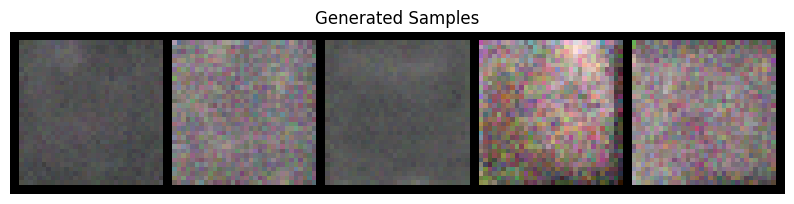

  Step 600/1563, Loss: 0.0633
  Step 700/1563, Loss: 0.0244
  Step 800/1563, Loss: 0.0482
  Step 900/1563, Loss: 0.0504
  Step 1000/1563, Loss: 0.0454
  Generating samples...


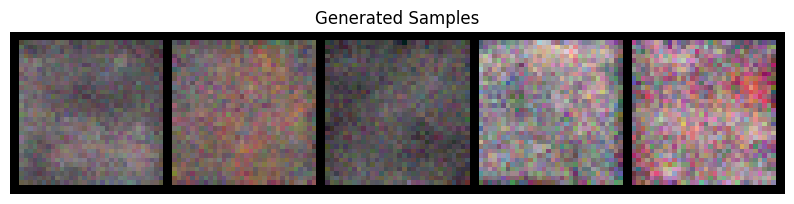

  Step 1100/1563, Loss: 0.0493
  Step 1200/1563, Loss: 0.0579
  Step 1300/1563, Loss: 0.0758
  Step 1400/1563, Loss: 0.0463
  Step 1500/1563, Loss: 0.0397
  Generating samples...


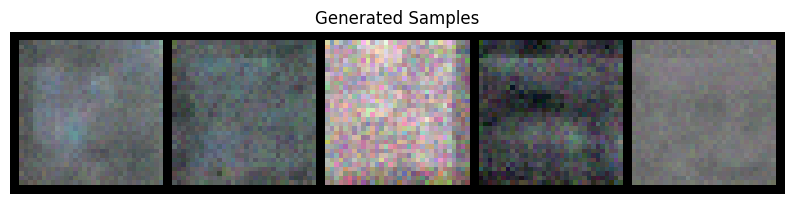


Training - Epoch 30 average loss: 0.0566
Running validation...
Validation - Epoch 30 average loss: 0.0627
Learning rate: 0.000250
No improvement for 4/10 epochs

Epoch 31/80
--------------------
  Step 0/1563, Loss: 0.0588
  Step 100/1563, Loss: 0.0341
  Step 200/1563, Loss: 0.0549
  Step 300/1563, Loss: 0.0686
  Step 400/1563, Loss: 0.0862
  Step 500/1563, Loss: 0.0589
  Generating samples...


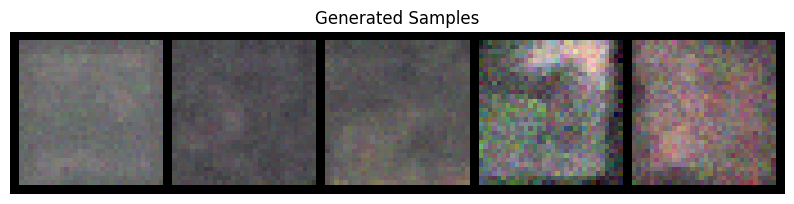

  Step 600/1563, Loss: 0.0437
  Step 700/1563, Loss: 0.0444
  Step 800/1563, Loss: 0.0946
  Step 900/1563, Loss: 0.0447
  Step 1000/1563, Loss: 0.0537
  Generating samples...


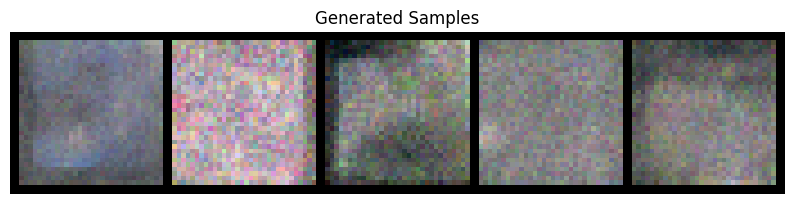

  Step 1100/1563, Loss: 0.0525
  Step 1200/1563, Loss: 0.0542
  Step 1300/1563, Loss: 0.0667
  Step 1400/1563, Loss: 0.0544
  Step 1500/1563, Loss: 0.0517
  Generating samples...


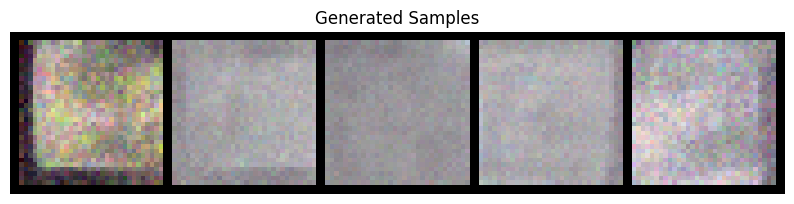


Training - Epoch 31 average loss: 0.0563
Running validation...
Validation - Epoch 31 average loss: 0.0609
Learning rate: 0.000250

Generating samples for visual progress check...


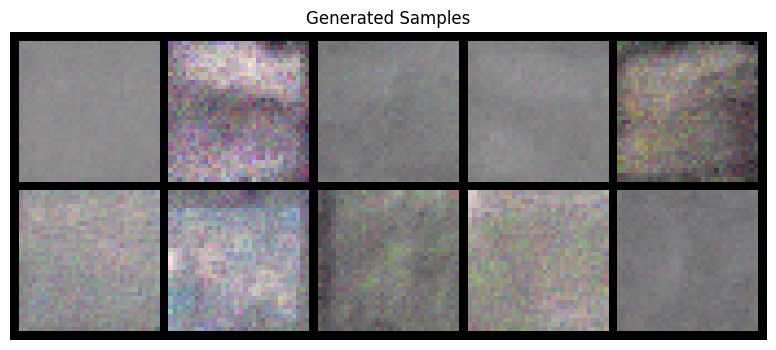

No improvement for 5/10 epochs


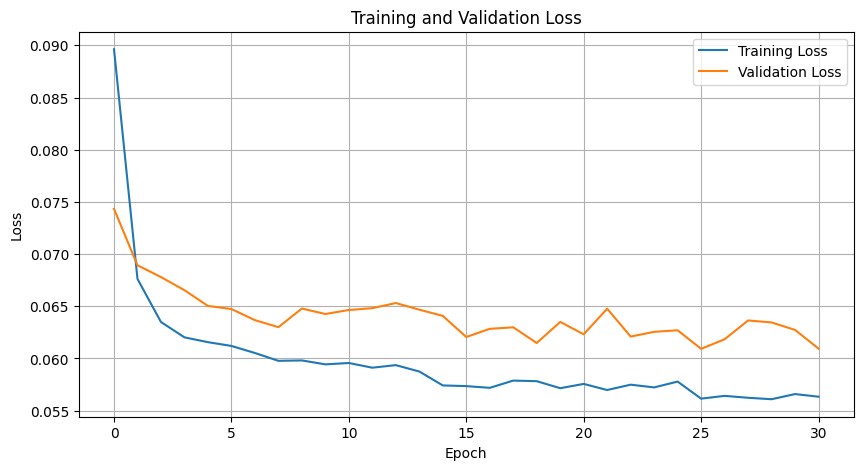


Epoch 32/80
--------------------
  Step 0/1563, Loss: 0.0441
  Step 100/1563, Loss: 0.0559
  Step 200/1563, Loss: 0.0443
  Step 300/1563, Loss: 0.0812
  Step 400/1563, Loss: 0.0602
  Step 500/1563, Loss: 0.0547
  Generating samples...


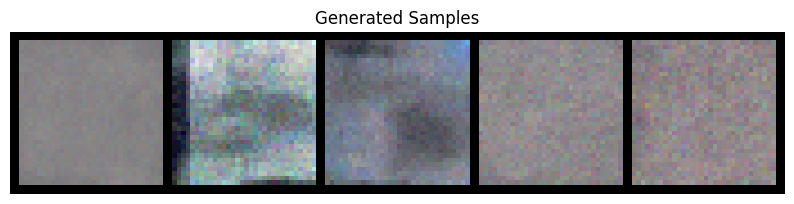

  Step 600/1563, Loss: 0.0417
  Step 700/1563, Loss: 0.0526
  Step 800/1563, Loss: 0.0431
  Step 900/1563, Loss: 0.0816
  Step 1000/1563, Loss: 0.0414
  Generating samples...


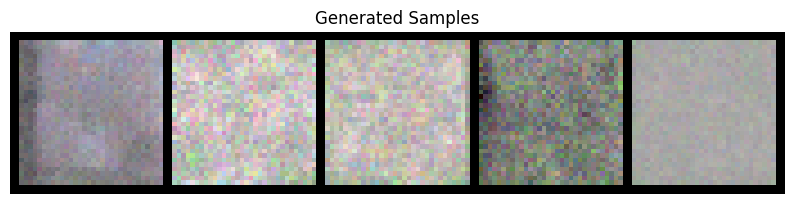

  Step 1100/1563, Loss: 0.0486
  Step 1200/1563, Loss: 0.0531
  Step 1300/1563, Loss: 0.0554
  Step 1400/1563, Loss: 0.0503
  Step 1500/1563, Loss: 0.0454
  Generating samples...


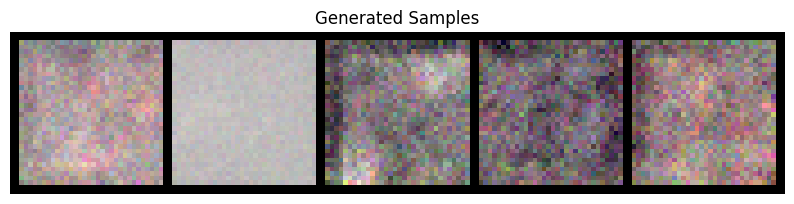


Training - Epoch 32 average loss: 0.0564
Running validation...
Validation - Epoch 32 average loss: 0.0618
Learning rate: 0.000125
No improvement for 6/10 epochs

Epoch 33/80
--------------------
  Step 0/1563, Loss: 0.0743
  Step 100/1563, Loss: 0.0480
  Step 200/1563, Loss: 0.0347
  Step 300/1563, Loss: 0.0667
  Step 400/1563, Loss: 0.0569
  Step 500/1563, Loss: 0.0436
  Generating samples...


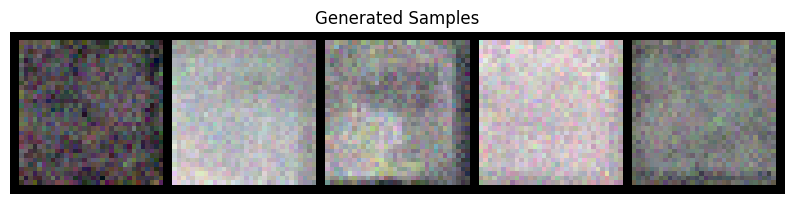

  Step 600/1563, Loss: 0.0408
  Step 700/1563, Loss: 0.0393
  Step 800/1563, Loss: 0.0339
  Step 900/1563, Loss: 0.0560
  Step 1000/1563, Loss: 0.0588
  Generating samples...


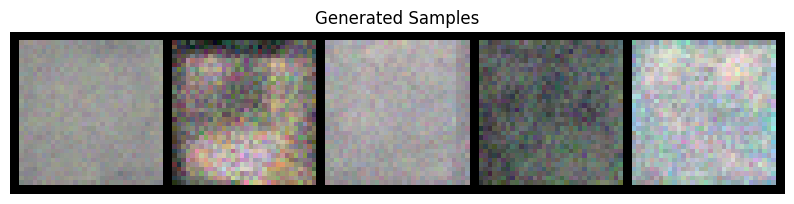

  Step 1100/1563, Loss: 0.0579
  Step 1200/1563, Loss: 0.0372
  Step 1300/1563, Loss: 0.0509
  Step 1400/1563, Loss: 0.0417
  Step 1500/1563, Loss: 0.0542
  Generating samples...


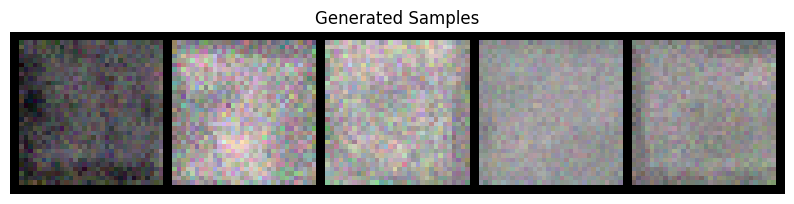


Training - Epoch 33 average loss: 0.0553
Running validation...
Validation - Epoch 33 average loss: 0.0623
Learning rate: 0.000125

Generating samples for visual progress check...


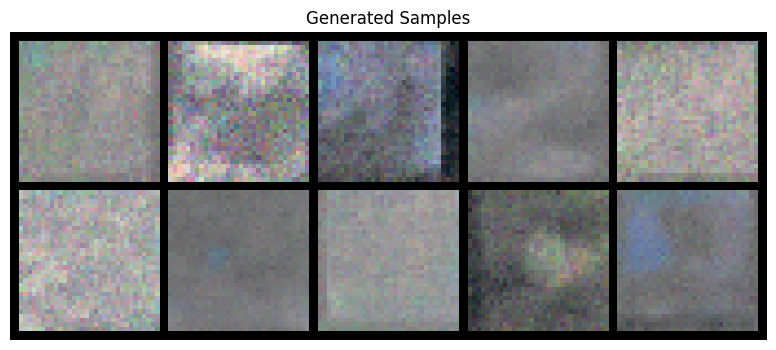

No improvement for 7/10 epochs

Epoch 34/80
--------------------
  Step 0/1563, Loss: 0.0514
  Step 100/1563, Loss: 0.0496
  Step 200/1563, Loss: 0.0673
  Step 300/1563, Loss: 0.0391
  Step 400/1563, Loss: 0.0421
  Step 500/1563, Loss: 0.0669
  Generating samples...


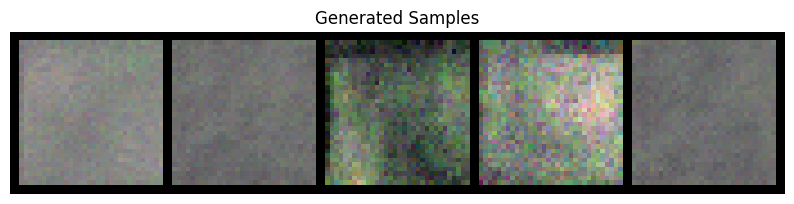

  Step 600/1563, Loss: 0.0670
  Step 700/1563, Loss: 0.0533
  Step 800/1563, Loss: 0.0640
  Step 900/1563, Loss: 0.0802
  Step 1000/1563, Loss: 0.0533
  Generating samples...


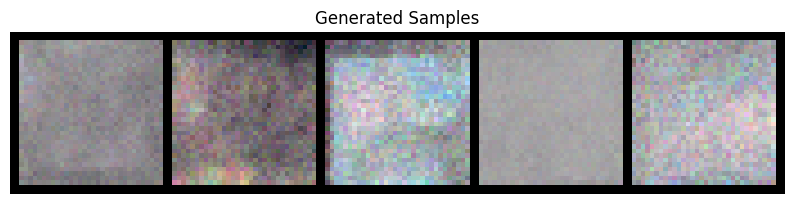

  Step 1100/1563, Loss: 0.0412
  Step 1200/1563, Loss: 0.0662
  Step 1300/1563, Loss: 0.0332
  Step 1400/1563, Loss: 0.0365
  Step 1500/1563, Loss: 0.0529
  Generating samples...


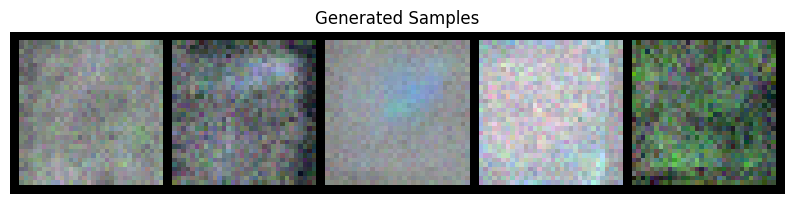


Training - Epoch 34 average loss: 0.0557
Running validation...
Validation - Epoch 34 average loss: 0.0614
Learning rate: 0.000125
No improvement for 8/10 epochs

Epoch 35/80
--------------------
  Step 0/1563, Loss: 0.1033
  Step 100/1563, Loss: 0.0576
  Step 200/1563, Loss: 0.0464
  Step 300/1563, Loss: 0.0427
  Step 400/1563, Loss: 0.0451
  Step 500/1563, Loss: 0.0544
  Generating samples...


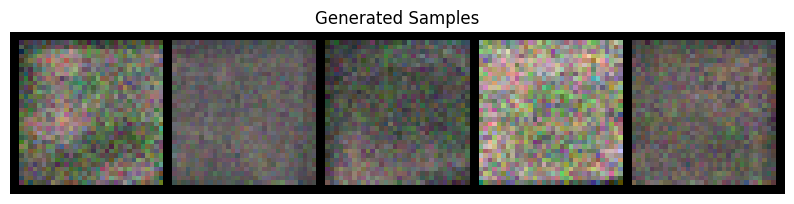

  Step 600/1563, Loss: 0.0730
  Step 700/1563, Loss: 0.0542
  Step 800/1563, Loss: 0.0378
  Step 900/1563, Loss: 0.0513
  Step 1000/1563, Loss: 0.0579
  Generating samples...


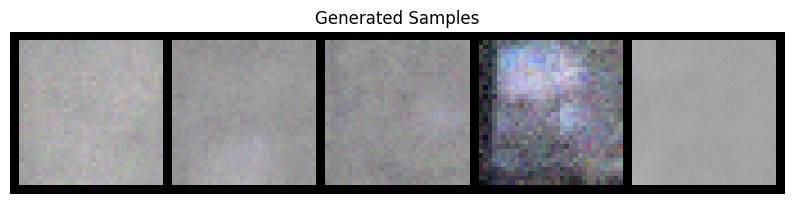

  Step 1100/1563, Loss: 0.0524
  Step 1200/1563, Loss: 0.0678
  Step 1300/1563, Loss: 0.0713
  Step 1400/1563, Loss: 0.0499
  Step 1500/1563, Loss: 0.0414
  Generating samples...


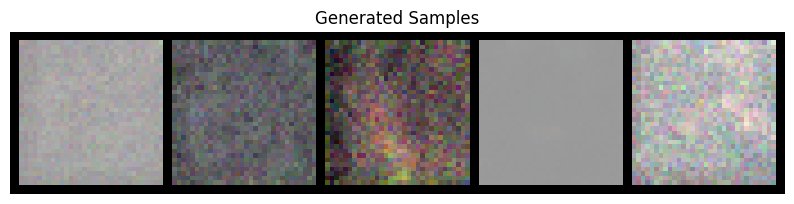


Training - Epoch 35 average loss: 0.0554
Running validation...
Validation - Epoch 35 average loss: 0.0609
Learning rate: 0.000125

Generating samples for visual progress check...


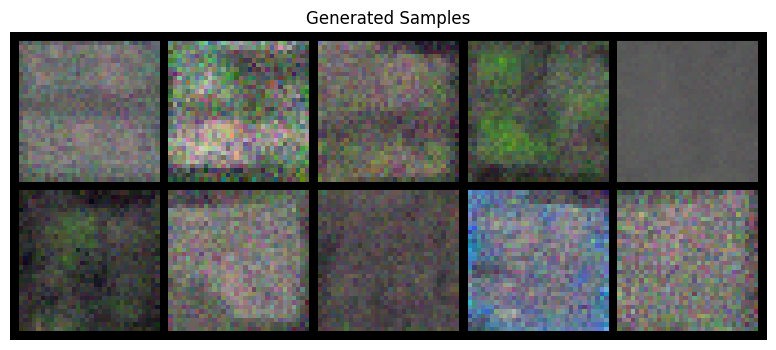

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0609)

Epoch 36/80
--------------------
  Step 0/1563, Loss: 0.0475
  Step 100/1563, Loss: 0.0696
  Step 200/1563, Loss: 0.0575
  Step 300/1563, Loss: 0.0565
  Step 400/1563, Loss: 0.0421
  Step 500/1563, Loss: 0.0547
  Generating samples...


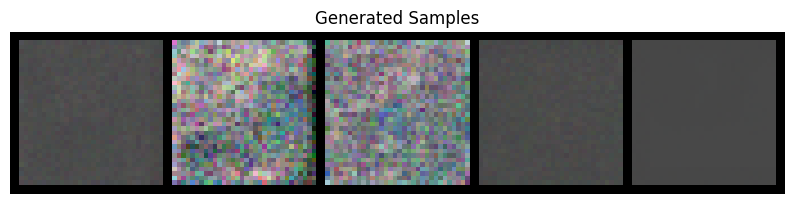

  Step 600/1563, Loss: 0.0874
  Step 700/1563, Loss: 0.0376
  Step 800/1563, Loss: 0.0416
  Step 900/1563, Loss: 0.0500
  Step 1000/1563, Loss: 0.0775
  Generating samples...


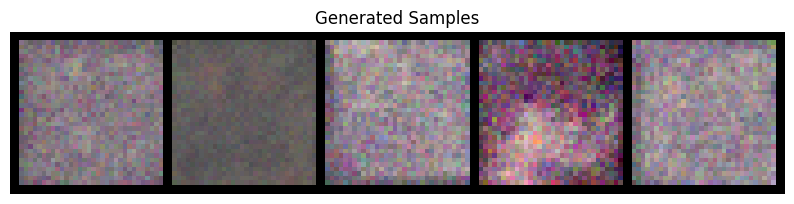

  Step 1100/1563, Loss: 0.0392
  Step 1200/1563, Loss: 0.0827
  Step 1300/1563, Loss: 0.0700
  Step 1400/1563, Loss: 0.0543
  Step 1500/1563, Loss: 0.0644
  Generating samples...


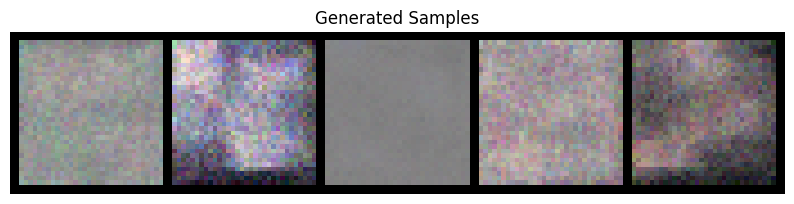


Training - Epoch 36 average loss: 0.0560
Running validation...
Validation - Epoch 36 average loss: 0.0608
Learning rate: 0.000125
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0608)


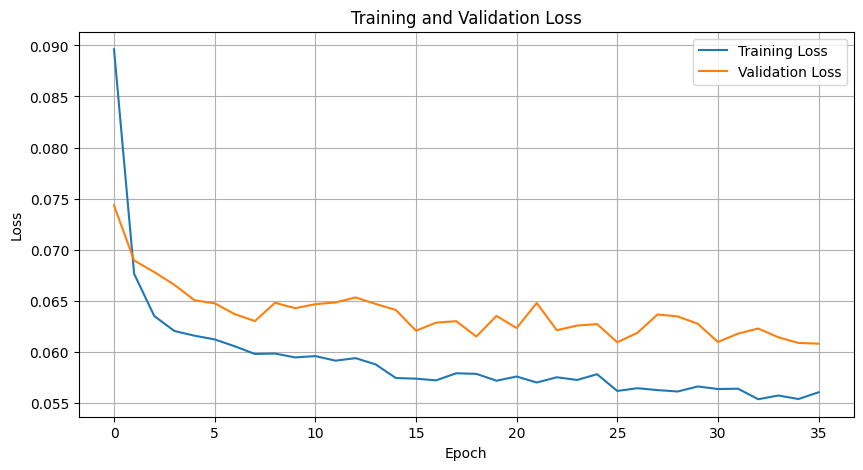


Epoch 37/80
--------------------
  Step 0/1563, Loss: 0.0783
  Step 100/1563, Loss: 0.0412
  Step 200/1563, Loss: 0.0819
  Step 300/1563, Loss: 0.0933
  Step 400/1563, Loss: 0.0533
  Step 500/1563, Loss: 0.0612
  Generating samples...


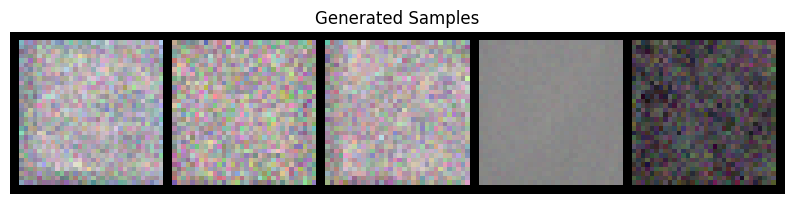

  Step 600/1563, Loss: 0.0531
  Step 700/1563, Loss: 0.0559
  Step 800/1563, Loss: 0.0678
  Step 900/1563, Loss: 0.0666
  Step 1000/1563, Loss: 0.0587
  Generating samples...


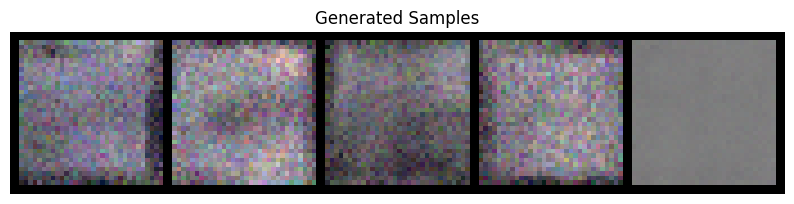

  Step 1100/1563, Loss: 0.0830
  Step 1200/1563, Loss: 0.0373
  Step 1300/1563, Loss: 0.0760
  Step 1400/1563, Loss: 0.0561
  Step 1500/1563, Loss: 0.0454
  Generating samples...


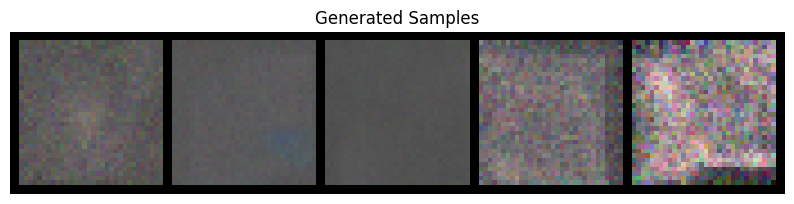


Training - Epoch 37 average loss: 0.0557
Running validation...
Validation - Epoch 37 average loss: 0.0609
Learning rate: 0.000125

Generating samples for visual progress check...


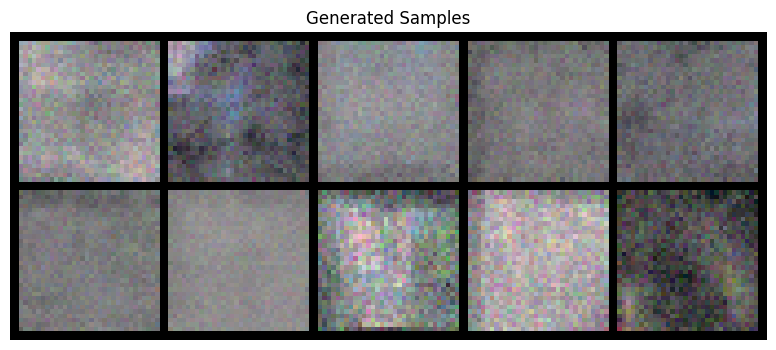

No improvement for 1/10 epochs

Epoch 38/80
--------------------
  Step 0/1563, Loss: 0.0359
  Step 100/1563, Loss: 0.0573
  Step 200/1563, Loss: 0.0695
  Step 300/1563, Loss: 0.0729
  Step 400/1563, Loss: 0.0502
  Step 500/1563, Loss: 0.0648
  Generating samples...


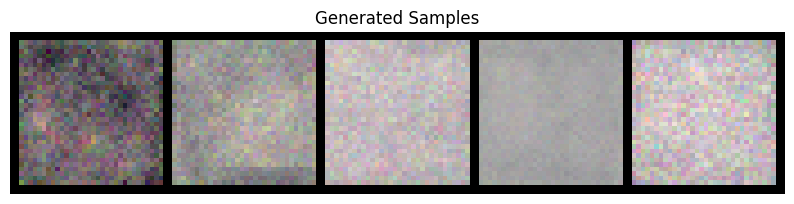

  Step 600/1563, Loss: 0.0677
  Step 700/1563, Loss: 0.0566
  Step 800/1563, Loss: 0.0503
  Step 900/1563, Loss: 0.0548
  Step 1000/1563, Loss: 0.0514
  Generating samples...


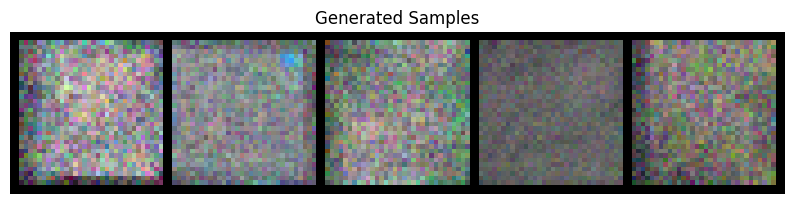

  Step 1100/1563, Loss: 0.0428
  Step 1200/1563, Loss: 0.0559
  Step 1300/1563, Loss: 0.0545
  Step 1400/1563, Loss: 0.0560
  Step 1500/1563, Loss: 0.0510
  Generating samples...


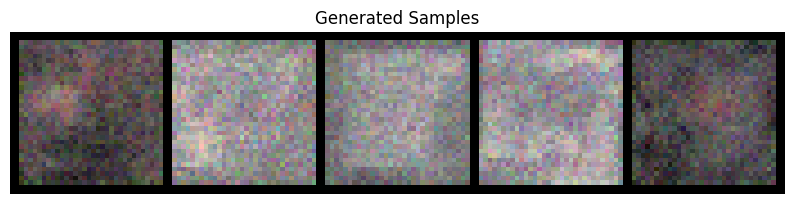


Training - Epoch 38 average loss: 0.0557
Running validation...
Validation - Epoch 38 average loss: 0.0604
Learning rate: 0.000125
Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0604)

Epoch 39/80
--------------------
  Step 0/1563, Loss: 0.0837
  Step 100/1563, Loss: 0.0740
  Step 200/1563, Loss: 0.0672
  Step 300/1563, Loss: 0.0793
  Step 400/1563, Loss: 0.0594
  Step 500/1563, Loss: 0.0542
  Generating samples...


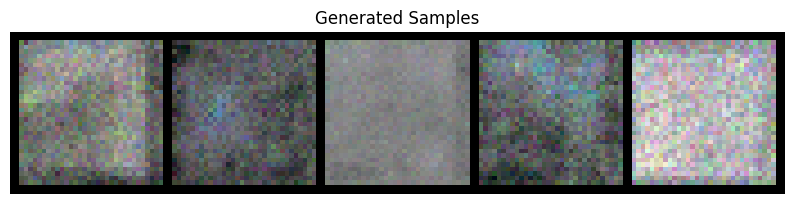

  Step 600/1563, Loss: 0.0553
  Step 700/1563, Loss: 0.0321
  Step 800/1563, Loss: 0.0569
  Step 900/1563, Loss: 0.0576
  Step 1000/1563, Loss: 0.0498
  Generating samples...


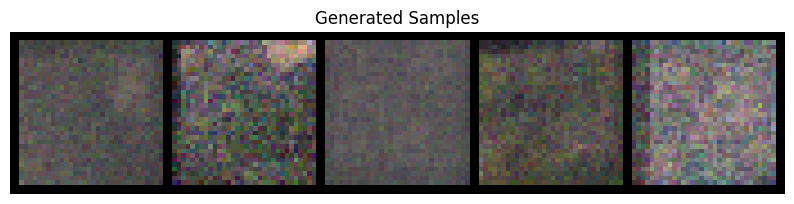

  Step 1100/1563, Loss: 0.0509
  Step 1200/1563, Loss: 0.0550
  Step 1300/1563, Loss: 0.0562
  Step 1400/1563, Loss: 0.0604
  Step 1500/1563, Loss: 0.0468
  Generating samples...


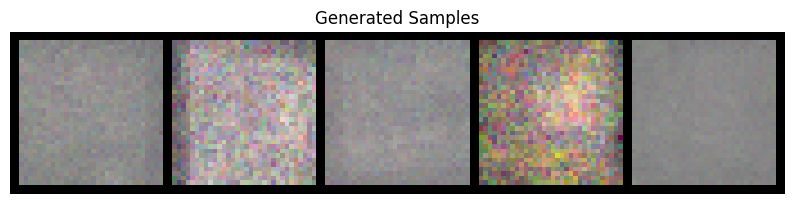


Training - Epoch 39 average loss: 0.0557
Running validation...
Validation - Epoch 39 average loss: 0.0595
Learning rate: 0.000125

Generating samples for visual progress check...


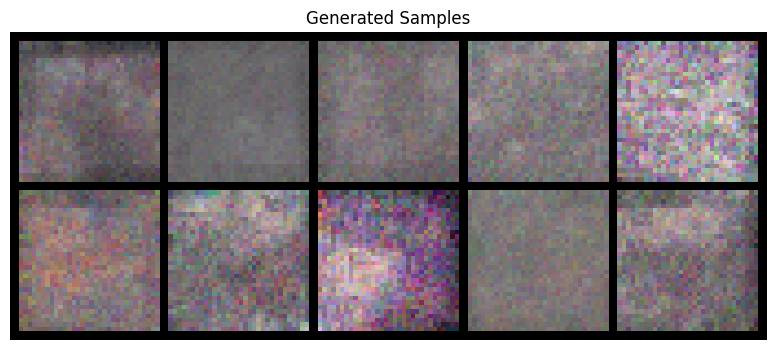

Created backup at best_diffusion_model.pt.backup
Model successfully saved to best_diffusion_model.pt
✓ New best model saved! (Val Loss: 0.0595)

Epoch 40/80
--------------------
  Step 0/1563, Loss: 0.0600
  Step 100/1563, Loss: 0.0376
  Step 200/1563, Loss: 0.0388
  Step 300/1563, Loss: 0.0751
  Step 400/1563, Loss: 0.0519
  Step 500/1563, Loss: 0.0517
  Generating samples...


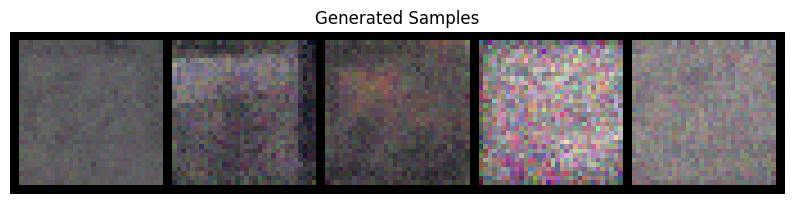

  Step 600/1563, Loss: 0.0449
  Step 700/1563, Loss: 0.0449
  Step 800/1563, Loss: 0.0454
  Step 900/1563, Loss: 0.0497
  Step 1000/1563, Loss: 0.0637
  Generating samples...


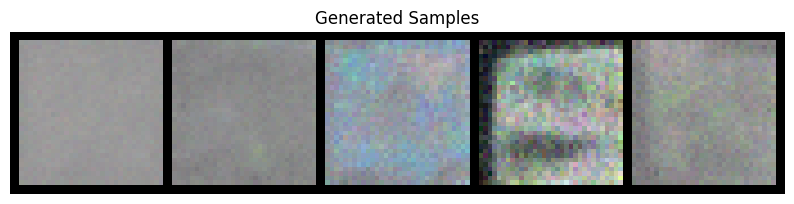

  Step 1100/1563, Loss: 0.0754
  Step 1200/1563, Loss: 0.0602
  Step 1300/1563, Loss: 0.0521
  Step 1400/1563, Loss: 0.0400
  Step 1500/1563, Loss: 0.0473
  Generating samples...


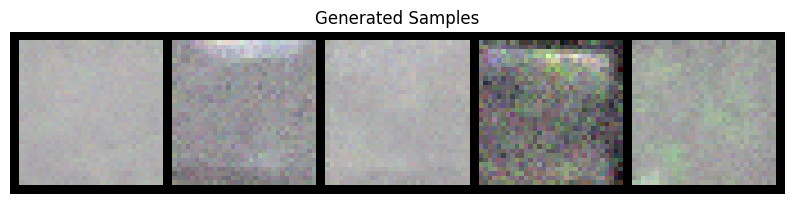


Training - Epoch 40 average loss: 0.0555
Running validation...
Validation - Epoch 40 average loss: 0.0631
Learning rate: 0.000125
No improvement for 1/10 epochs

Epoch 41/80
--------------------
  Step 0/1563, Loss: 0.0272
  Step 100/1563, Loss: 0.0389
  Step 200/1563, Loss: 0.0334
  Step 300/1563, Loss: 0.0720
  Step 400/1563, Loss: 0.0367
  Step 500/1563, Loss: 0.0499
  Generating samples...


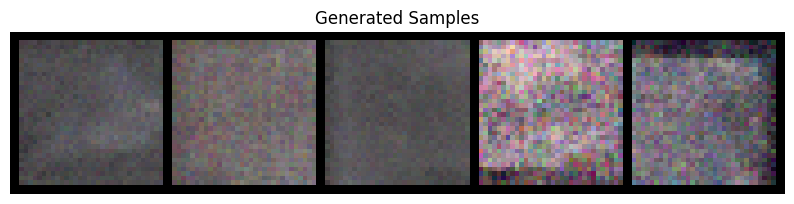

  Step 600/1563, Loss: 0.0451
  Step 700/1563, Loss: 0.0400
  Step 800/1563, Loss: 0.0502
  Step 900/1563, Loss: 0.0482
  Step 1000/1563, Loss: 0.0493
  Generating samples...


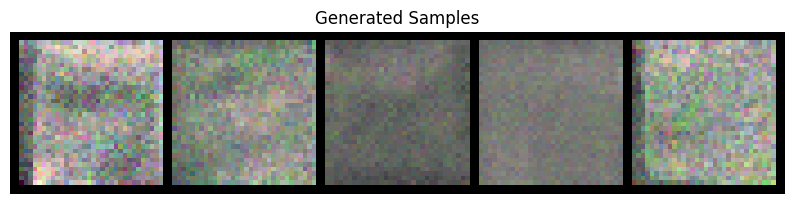

  Step 1100/1563, Loss: 0.0757
  Step 1200/1563, Loss: 0.0508
  Step 1300/1563, Loss: 0.0586
  Step 1400/1563, Loss: 0.0440
  Step 1500/1563, Loss: 0.0542
  Generating samples...


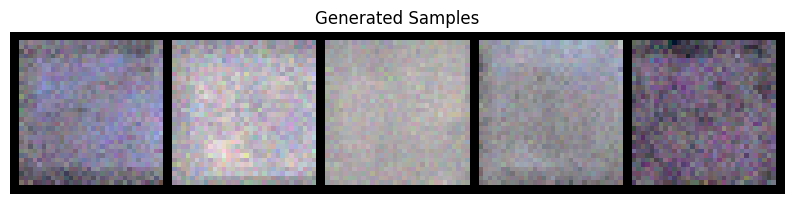


Training - Epoch 41 average loss: 0.0551
Running validation...
Validation - Epoch 41 average loss: 0.0608
Learning rate: 0.000125

Generating samples for visual progress check...


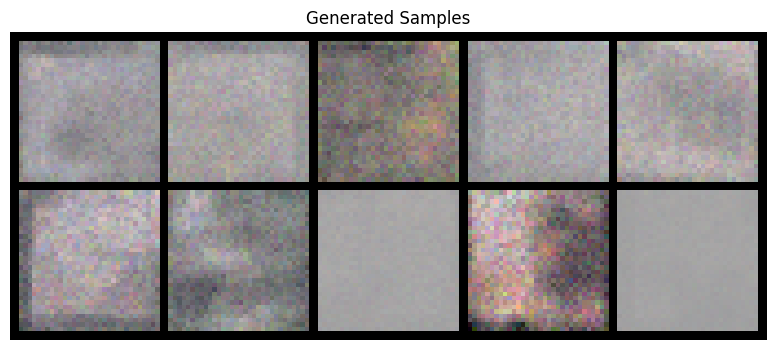

No improvement for 2/10 epochs


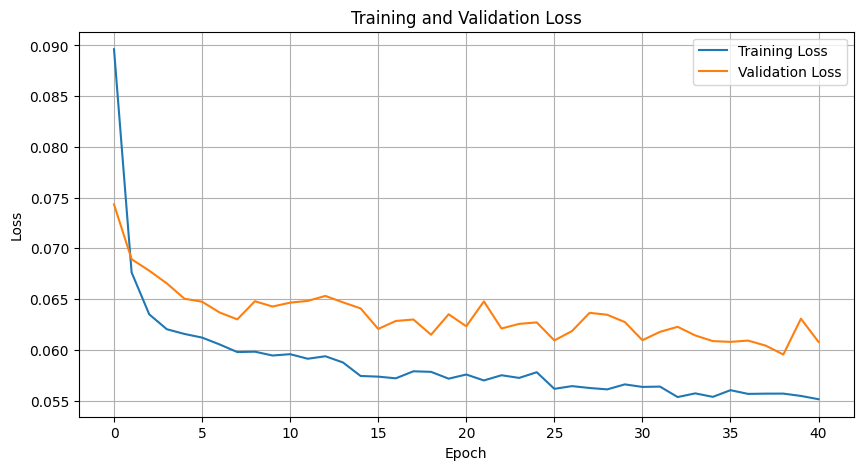


Epoch 42/80
--------------------
  Step 0/1563, Loss: 0.0274
  Step 100/1563, Loss: 0.0479
  Step 200/1563, Loss: 0.0537
  Step 300/1563, Loss: 0.0664
  Step 400/1563, Loss: 0.0559
  Step 500/1563, Loss: 0.0543
  Generating samples...


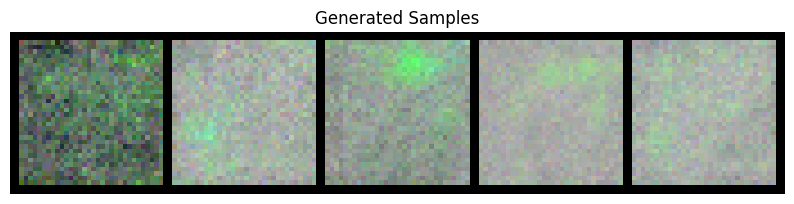

  Step 600/1563, Loss: 0.0708
  Step 700/1563, Loss: 0.0595
  Step 800/1563, Loss: 0.1054
  Step 900/1563, Loss: 0.0560
  Step 1000/1563, Loss: 0.0638
  Generating samples...


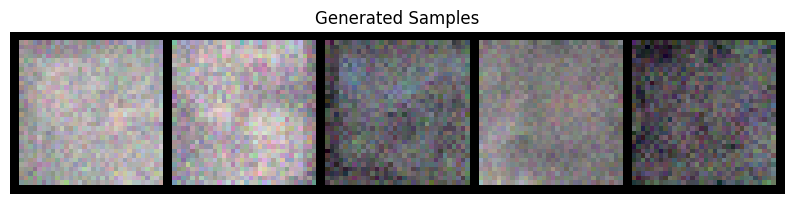

  Step 1100/1563, Loss: 0.0794
  Step 1200/1563, Loss: 0.0547
  Step 1300/1563, Loss: 0.0433
  Step 1400/1563, Loss: 0.0682
  Step 1500/1563, Loss: 0.0370
  Generating samples...


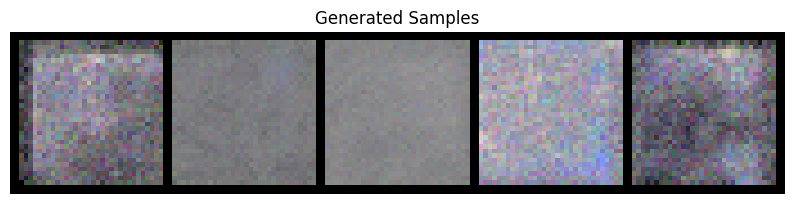


Training - Epoch 42 average loss: 0.0551
Running validation...
Validation - Epoch 42 average loss: 0.0608
Learning rate: 0.000125
No improvement for 3/10 epochs

Epoch 43/80
--------------------
  Step 0/1563, Loss: 0.0574
  Step 100/1563, Loss: 0.0774
  Step 200/1563, Loss: 0.0802
  Step 300/1563, Loss: 0.0629
  Step 400/1563, Loss: 0.0482
  Step 500/1563, Loss: 0.0372
  Generating samples...


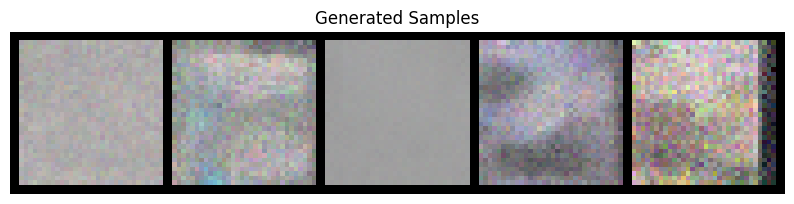

  Step 600/1563, Loss: 0.0381
  Step 700/1563, Loss: 0.0696
  Step 800/1563, Loss: 0.0576
  Step 900/1563, Loss: 0.0342
  Step 1000/1563, Loss: 0.0502
  Generating samples...


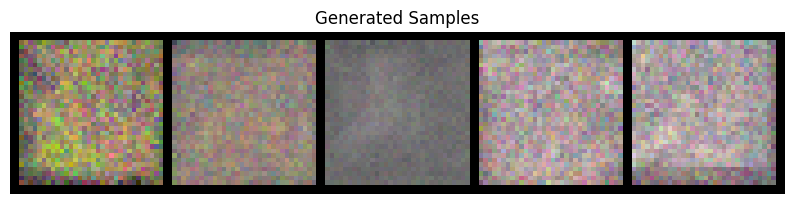

  Step 1100/1563, Loss: 0.0446
  Step 1200/1563, Loss: 0.0499
  Step 1300/1563, Loss: 0.0622
  Step 1400/1563, Loss: 0.0553
  Step 1500/1563, Loss: 0.0554
  Generating samples...


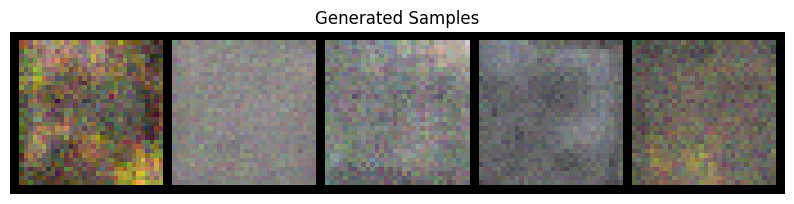


Training - Epoch 43 average loss: 0.0555
Running validation...
Validation - Epoch 43 average loss: 0.0617
Learning rate: 0.000125

Generating samples for visual progress check...


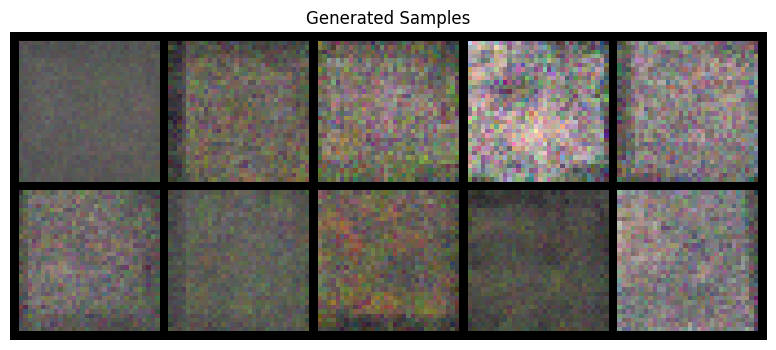

No improvement for 4/10 epochs

Epoch 44/80
--------------------
  Step 0/1563, Loss: 0.0830
  Step 100/1563, Loss: 0.0518
  Step 200/1563, Loss: 0.0677
  Step 300/1563, Loss: 0.0729
  Step 400/1563, Loss: 0.0781
  Step 500/1563, Loss: 0.0392
  Generating samples...


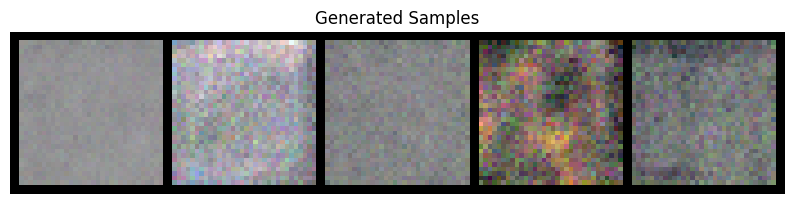

  Step 600/1563, Loss: 0.0557
  Step 700/1563, Loss: 0.0502
  Step 800/1563, Loss: 0.0735
  Step 900/1563, Loss: 0.0792
  Step 1000/1563, Loss: 0.0610
  Generating samples...


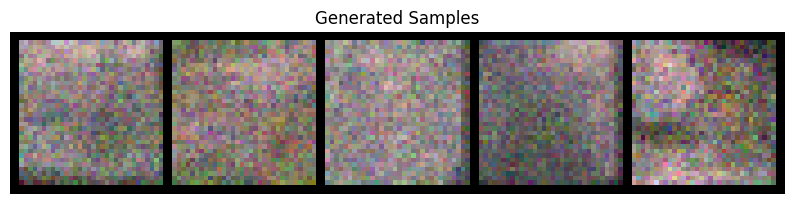

  Step 1100/1563, Loss: 0.0459
  Step 1200/1563, Loss: 0.0530
  Step 1300/1563, Loss: 0.0542
  Step 1400/1563, Loss: 0.0510
  Step 1500/1563, Loss: 0.0509
  Generating samples...


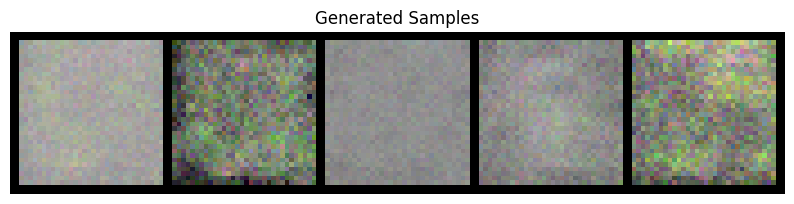


Training - Epoch 44 average loss: 0.0556
Running validation...
Validation - Epoch 44 average loss: 0.0616
Learning rate: 0.000125
No improvement for 5/10 epochs

Epoch 45/80
--------------------
  Step 0/1563, Loss: 0.0589
  Step 100/1563, Loss: 0.0457
  Step 200/1563, Loss: 0.0297
  Step 300/1563, Loss: 0.0588
  Step 400/1563, Loss: 0.0490
  Step 500/1563, Loss: 0.0480
  Generating samples...


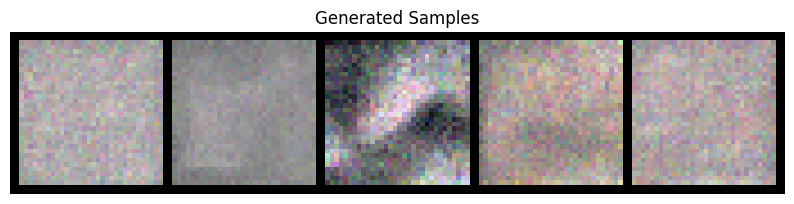

  Step 600/1563, Loss: 0.0478
  Step 700/1563, Loss: 0.0691
  Step 800/1563, Loss: 0.0562
  Step 900/1563, Loss: 0.0423
  Step 1000/1563, Loss: 0.0719
  Generating samples...


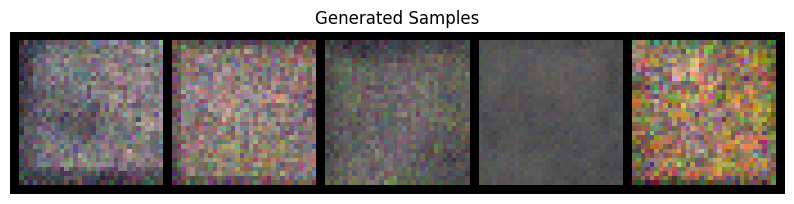

  Step 1100/1563, Loss: 0.0415
  Step 1200/1563, Loss: 0.0573
  Step 1300/1563, Loss: 0.0594
  Step 1400/1563, Loss: 0.0408
  Step 1500/1563, Loss: 0.0393
  Generating samples...


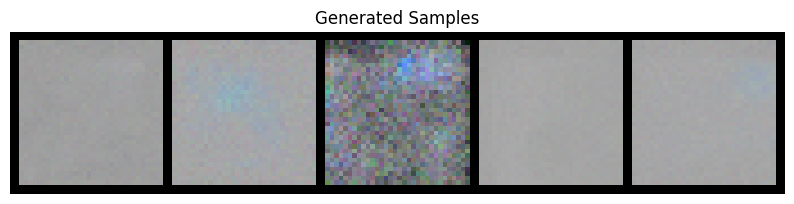


Training - Epoch 45 average loss: 0.0549
Running validation...
Validation - Epoch 45 average loss: 0.0603
Learning rate: 0.000063

Generating samples for visual progress check...


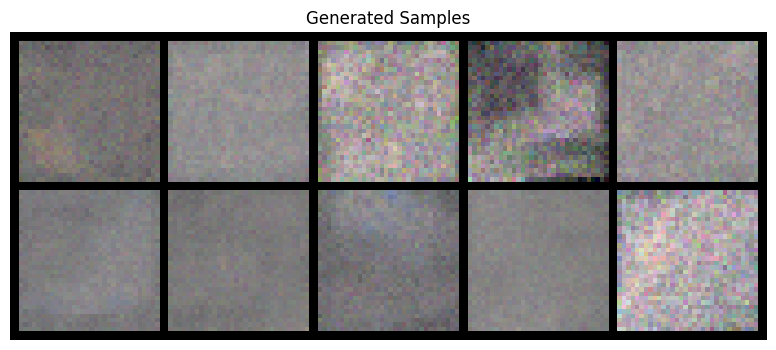

No improvement for 6/10 epochs

Epoch 46/80
--------------------
  Step 0/1563, Loss: 0.0604
  Step 100/1563, Loss: 0.0502
  Step 200/1563, Loss: 0.0678
  Step 300/1563, Loss: 0.0465
  Step 400/1563, Loss: 0.0504
  Step 500/1563, Loss: 0.0494
  Generating samples...


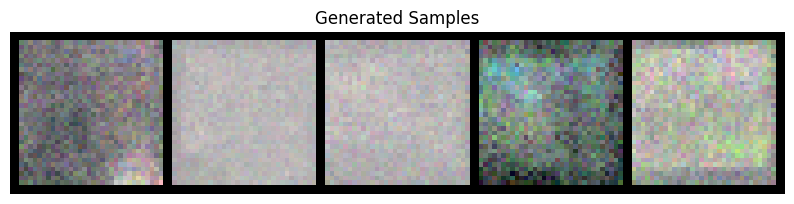

  Step 600/1563, Loss: 0.0317
  Step 700/1563, Loss: 0.0366
  Step 800/1563, Loss: 0.0417
  Step 900/1563, Loss: 0.0800
  Step 1000/1563, Loss: 0.0458
  Generating samples...


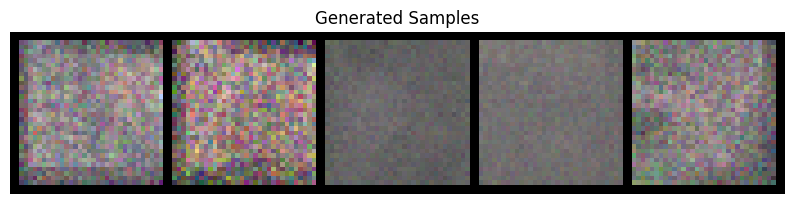

  Step 1100/1563, Loss: 0.0726
  Step 1200/1563, Loss: 0.0478
  Step 1300/1563, Loss: 0.0501
  Step 1400/1563, Loss: 0.0507
  Step 1500/1563, Loss: 0.0826
  Generating samples...


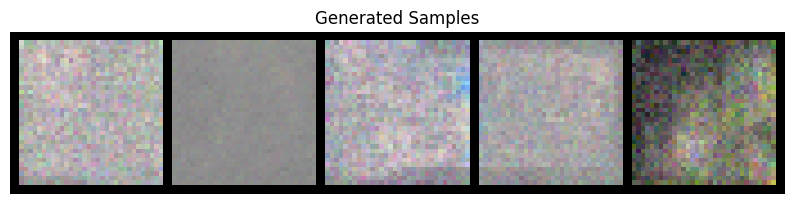


Training - Epoch 46 average loss: 0.0549
Running validation...
Validation - Epoch 46 average loss: 0.0610
Learning rate: 0.000063
No improvement for 7/10 epochs


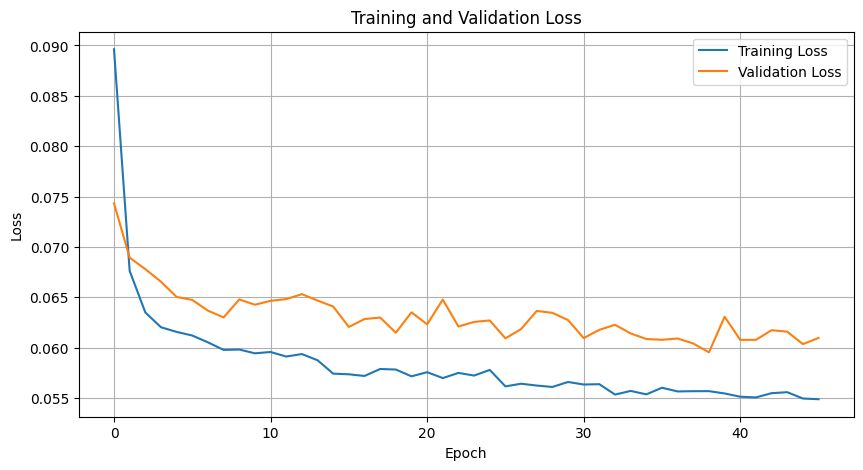


Epoch 47/80
--------------------
  Step 0/1563, Loss: 0.0357
  Step 100/1563, Loss: 0.0619
  Step 200/1563, Loss: 0.0345
  Step 300/1563, Loss: 0.0576
  Step 400/1563, Loss: 0.0642
  Step 500/1563, Loss: 0.0537
  Generating samples...


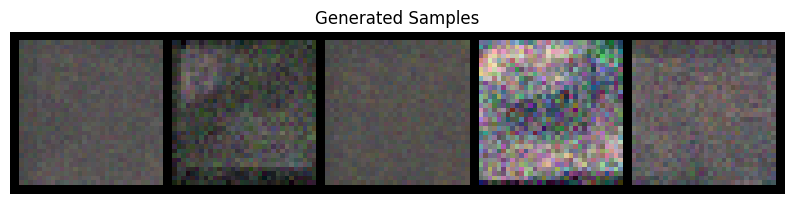

  Step 600/1563, Loss: 0.0597
  Step 700/1563, Loss: 0.0307
  Step 800/1563, Loss: 0.0659
  Step 900/1563, Loss: 0.0575
  Step 1000/1563, Loss: 0.0593
  Generating samples...


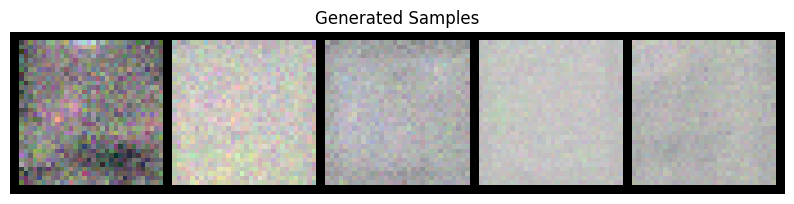

  Step 1100/1563, Loss: 0.0603
  Step 1200/1563, Loss: 0.0495
  Step 1300/1563, Loss: 0.0544
  Step 1400/1563, Loss: 0.0492
  Step 1500/1563, Loss: 0.0529
  Generating samples...


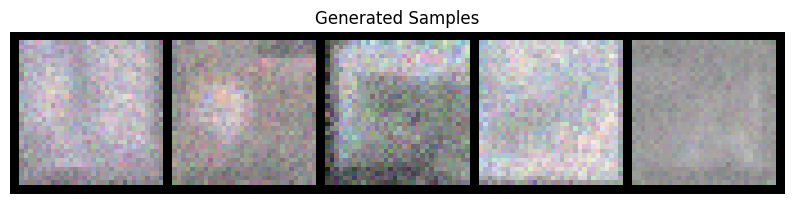


Training - Epoch 47 average loss: 0.0548
Running validation...
Validation - Epoch 47 average loss: 0.0607
Learning rate: 0.000063

Generating samples for visual progress check...


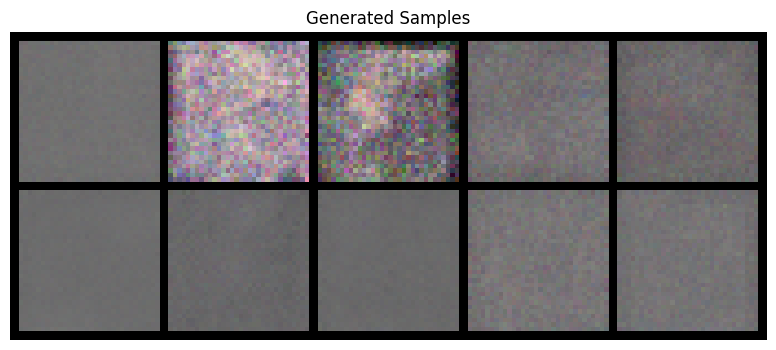

No improvement for 8/10 epochs

Epoch 48/80
--------------------
  Step 0/1563, Loss: 0.0552
  Step 100/1563, Loss: 0.0443
  Step 200/1563, Loss: 0.0724
  Step 300/1563, Loss: 0.0945
  Step 400/1563, Loss: 0.0616
  Step 500/1563, Loss: 0.0494
  Generating samples...


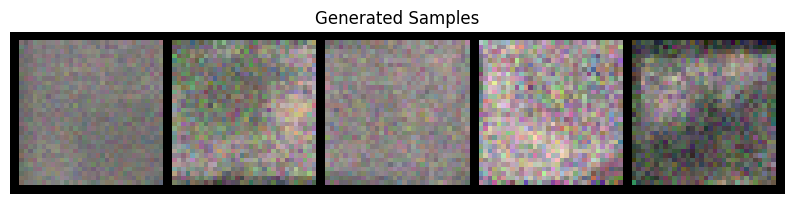

  Step 600/1563, Loss: 0.0619
  Step 700/1563, Loss: 0.0453
  Step 800/1563, Loss: 0.0842
  Step 900/1563, Loss: 0.0610
  Step 1000/1563, Loss: 0.0715
  Generating samples...


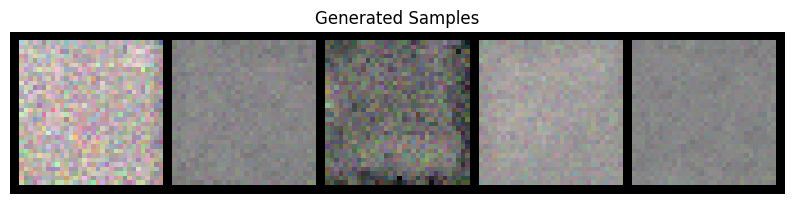

  Step 1100/1563, Loss: 0.0458
  Step 1200/1563, Loss: 0.0468
  Step 1300/1563, Loss: 0.0456
  Step 1400/1563, Loss: 0.0751
  Step 1500/1563, Loss: 0.0572
  Generating samples...


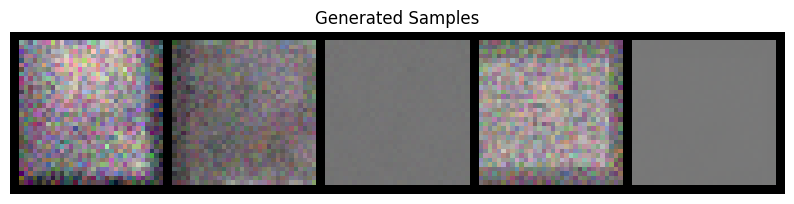


Training - Epoch 48 average loss: 0.0552
Running validation...
Validation - Epoch 48 average loss: 0.0607
Learning rate: 0.000063
No improvement for 9/10 epochs

Epoch 49/80
--------------------
  Step 0/1563, Loss: 0.0470
  Step 100/1563, Loss: 0.0513
  Step 200/1563, Loss: 0.0584
  Step 300/1563, Loss: 0.0522
  Step 400/1563, Loss: 0.0462
  Step 500/1563, Loss: 0.0452
  Generating samples...


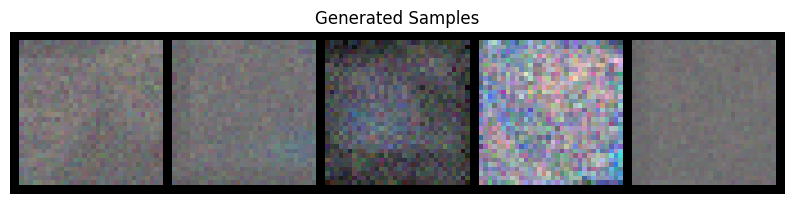

  Step 600/1563, Loss: 0.0541
  Step 700/1563, Loss: 0.0688
  Step 800/1563, Loss: 0.0492
  Step 900/1563, Loss: 0.0583
  Step 1000/1563, Loss: 0.0640
  Generating samples...


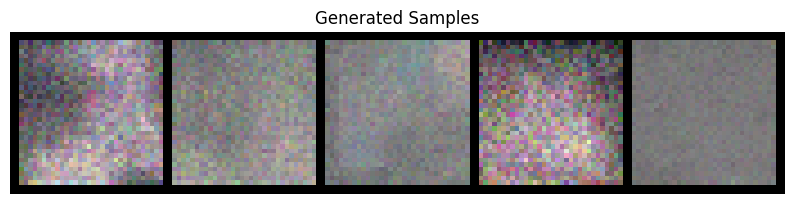

  Step 1100/1563, Loss: 0.0370
  Step 1200/1563, Loss: 0.0618
  Step 1300/1563, Loss: 0.0617
  Step 1400/1563, Loss: 0.0840
  Step 1500/1563, Loss: 0.0616
  Generating samples...


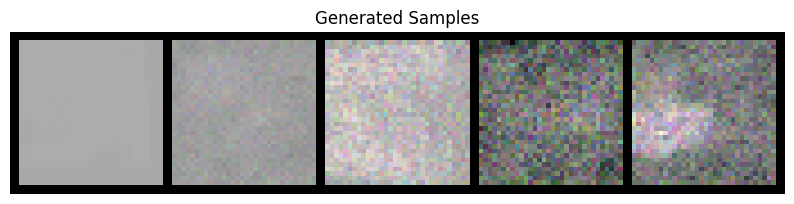


Training - Epoch 49 average loss: 0.0550
Running validation...
Validation - Epoch 49 average loss: 0.0616
Learning rate: 0.000063

Generating samples for visual progress check...


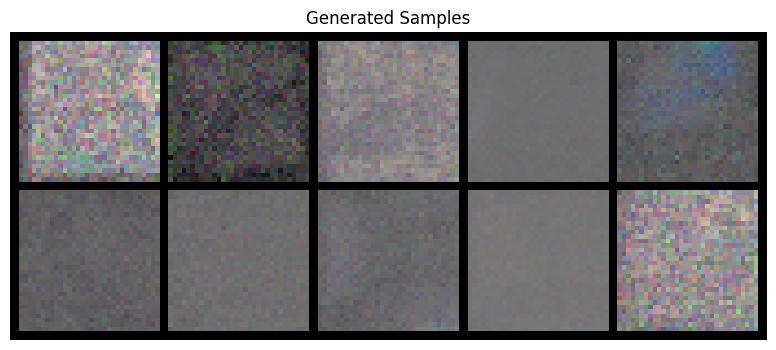

No improvement for 10/10 epochs

Early stopping triggered! No improvement in validation loss.

TRAINING COMPLETE
Best validation loss: 0.0595
Generating final samples...


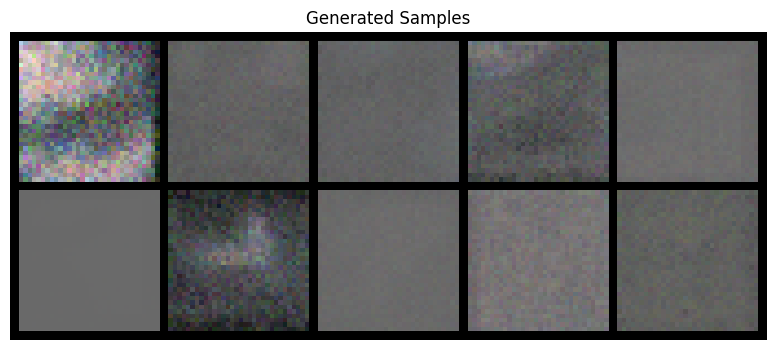

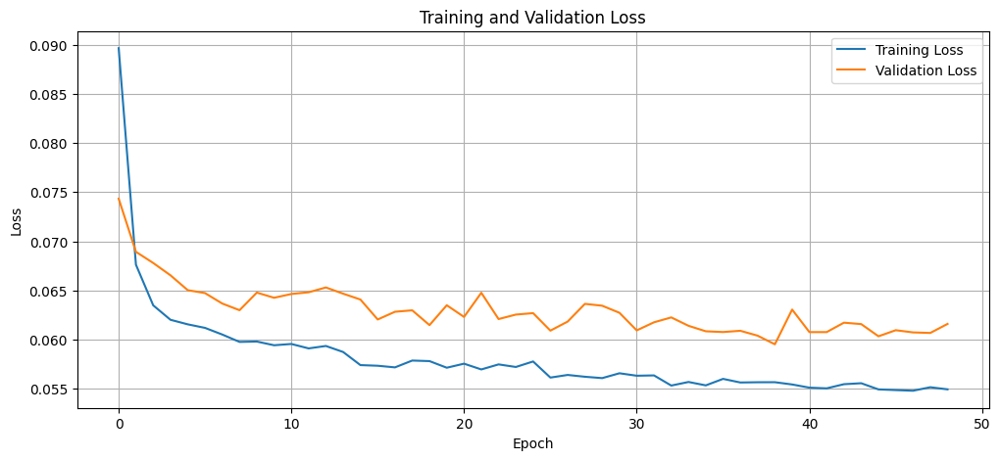

In [ ]:
# Implementation of the main training loop
# Training configuration
early_stopping_patience = 10  # Number of epochs without improvement before stopping
gradient_clip_value = 1.0     # Maximum gradient norm for stability
display_frequency = 100       # How often to show progress (in steps)
generate_frequency = 500      # How often to generate samples (in steps)

# Progress tracking variables
best_loss = float('inf')
train_losses = []
val_losses = []
no_improve_epochs = 0

# Training loop
print("\n" + "="*50)
print("STARTING TRAINING")
print("="*50)
model.train()

# Wrap the training loop in a try-except block for better error handling:
# Your code for the training loop
# Hint: Use a try-except block for better error handling
# Process each epoch and each batch, with validation after each epoch

# Enter your code here:

# Code
try:
    for epoch in range(EPOCHS):
        print(f"\nEpoch {epoch+1}/{EPOCHS}")
        print("-" * 20)

        # Training phase
        model.train()
        epoch_losses = []

        # Process each batch
        for step, (images, labels) in enumerate(train_load):
            images = images.to(device)
            labels = labels.to(device)

            # Training step
            optimizer.zero_grad()
            loss = train_step(images, labels)
            loss.backward()

            # Add gradient clipping for stability
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip_value)

            optimizer.step()
            epoch_losses.append(loss.item())

            # Show progress at regular intervals
            if step % display_frequency == 0:
                print(f"  Step {step}/{len(train_load)}, Loss: {loss.item():.4f}")

                # Generate samples less frequently to save time
                if step % generate_frequency == 0 and step > 0:
                    print("  Generating samples...")
                    generate_samples(model, n_samples=5)

        # End of epoch - calculate average training loss
        avg_train_loss = sum(epoch_losses) / len(epoch_losses)
        train_losses.append(avg_train_loss)
        print(f"\nTraining - Epoch {epoch+1} average loss: {avg_train_loss:.4f}")

        # Validation phase
        model.eval()
        val_epoch_losses = []
        print("Running validation...")

        with torch.no_grad():  # Disable gradients for validation
            for val_images, val_labels in val_load:
                val_images = val_images.to(device)
                val_labels = val_labels.to(device)

                # Calculate validation loss
                val_loss = train_step(val_images, val_labels)
                val_epoch_losses.append(val_loss.item())

        # Calculate average validation loss
        avg_val_loss = sum(val_epoch_losses) / len(val_epoch_losses)
        val_losses.append(avg_val_loss)
        print(f"Validation - Epoch {epoch+1} average loss: {avg_val_loss:.4f}")

        # Learning rate scheduling based on validation loss
        scheduler.step(avg_val_loss)
        current_lr = optimizer.param_groups[0]['lr']
        print(f"Learning rate: {current_lr:.6f}")

        # Generate samples at the end of each epoch
        if epoch % 2 == 0 or epoch == EPOCHS - 1:
            print("\nGenerating samples for visual progress check...")
            generate_samples(model, n_samples=10)

        # Save best model based on validation loss
        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            safe_save_model(model, 'best_diffusion_model.pt', optimizer, epoch, best_loss)
            print(f"✓ New best model saved! (Val Loss: {best_loss:.4f})")
            no_improve_epochs = 0
        else:
            no_improve_epochs += 1
            print(f"No improvement for {no_improve_epochs}/{early_stopping_patience} epochs")

        # Early stopping
        if no_improve_epochs >= early_stopping_patience:
            print("\nEarly stopping triggered! No improvement in validation loss.")
            break

        # Plot loss curves every few epochs
        if epoch % 5 == 0 or epoch == EPOCHS - 1:
            plt.figure(figsize=(10, 5))
            plt.plot(train_losses, label='Training Loss')
            plt.plot(val_losses,   label='Validation Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Training and Validation Loss')
            plt.legend()
            plt.grid(True)
            plt.show()

except KeyboardInterrupt:
    print("\nTraining interrupted by user.")

# ––– Final wrap-up ––––––––––––––––––––––––––––––––––––––––––––––––––––––––––
print("\n" + "="*50)
print("TRAINING COMPLETE")
print("="*50)
print(f"Best validation loss: {best_loss:.4f}")

# Generate final samples
print("Generating final samples...")
generate_samples(model, n_samples=10)

# Display final loss curves
plt.figure(figsize=(12, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses,   label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

# Clean up memory
torch.cuda.empty_cache()


### REDO STEPS 6 and 7 with new model

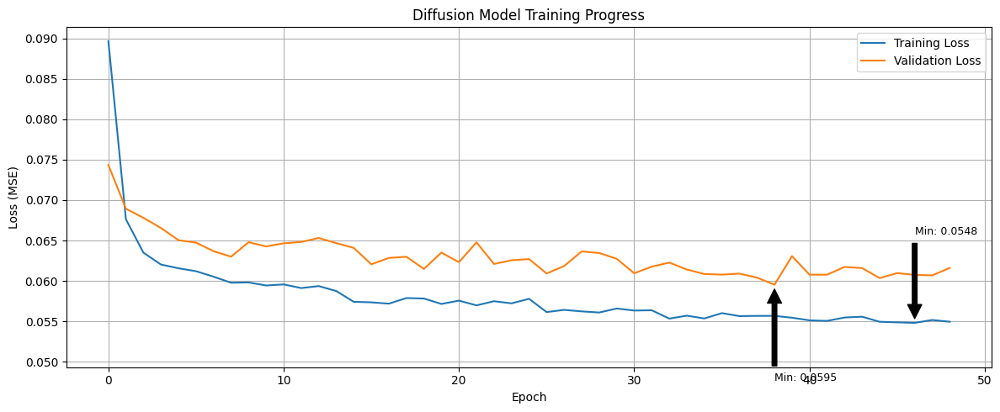


Training Statistics:
------------------------------
Starting training loss:    0.0896
Final training loss:       0.0550
Best training loss:        0.0548
Training loss improvement: 38.8%

Validation Statistics:
------------------------------
Starting validation loss: 0.0743
Final validation loss:    0.0616
Best validation loss:     0.0595


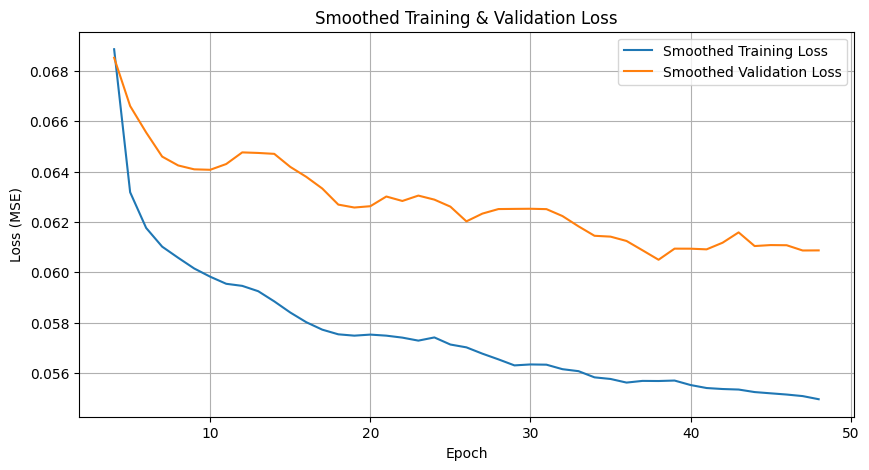

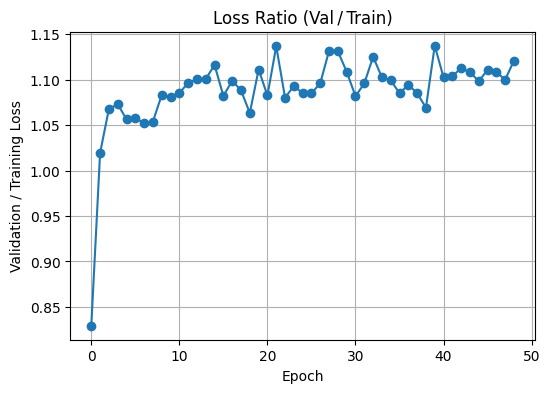

In [ ]:
# Plot training progress
plt.figure(figsize=(12, 5))

# Plot training and validation losses for comparison
plt.plot(train_losses, label='Training Loss')
if len(val_losses) > 0:  # Only plot validation if it exists
    plt.plot(val_losses, label='Validation Loss')

# Improve the plot with better labels and styling
plt.title('Diffusion Model Training Progress')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()
plt.grid(True)

# Add annotations for key points
if len(train_losses) > 1:
    min_train_idx = train_losses.index(min(train_losses))
    plt.annotate(f'Min: {min(train_losses):.4f}',
                 xy=(min_train_idx, min(train_losses)),
                 xytext=(min_train_idx, min(train_losses)*1.2),
                 arrowprops=dict(facecolor='black', shrink=0.05),
                 fontsize=9)

# Add validation min point if available
if len(val_losses) > 1:
    min_val_idx = val_losses.index(min(val_losses))
    plt.annotate(f'Min: {min(val_losses):.4f}',
                xy=(min_val_idx, min(val_losses)),
                xytext=(min_val_idx, min(val_losses)*0.8),
                arrowprops=dict(facecolor='black', shrink=0.05),
                fontsize=9)

# Set y-axis to start from 0 or slightly lower than min value
plt.ylim(bottom=max(0, min(min(train_losses) if train_losses else float('inf'),
                          min(val_losses) if val_losses else float('inf'))*0.9))

plt.tight_layout()
plt.show()

# Add statistics summary for students to analyze
print("\nTraining Statistics:")
print("-" * 30)
if train_losses:
    print(f"Starting training loss:    {train_losses[0]:.4f}")
    print(f"Final training loss:       {train_losses[-1]:.4f}")
    print(f"Best training loss:        {min(train_losses):.4f}")
    print(f"Training loss improvement: {((train_losses[0] - min(train_losses)) / train_losses[0] * 100):.1f}%")

if val_losses:
    print("\nValidation Statistics:")
    print("-" * 30)
    print(f"Starting validation loss: {val_losses[0]:.4f}")
    print(f"Final validation loss:    {val_losses[-1]:.4f}")
    print(f"Best validation loss:     {min(val_losses):.4f}")

# STUDENT EXERCISE:
# 1. Try modifying this plot to show a smoothed version of the losses
# 2. Create a second plot showing the ratio of validation to training loss
#    (which can indicate overfitting when the ratio increases)

###############################################################################
###############################################################################
###############################################################################
###################### Student Exercises     ##################################
###############################################################################
###############################################################################

import numpy as np

# 1) Smoothed loss curves (5-epoch rolling average)
window = 5
sm_train = np.convolve(train_losses, np.ones(window)/window, mode='valid')
sm_val   = np.convolve(val_losses,   np.ones(window)/window, mode='valid')

plt.figure(figsize=(10,5))
plt.plot(range(window-1, len(train_losses)), sm_train, label='Smoothed Training Loss')
plt.plot(range(window-1, len(val_losses)),   sm_val,   label='Smoothed Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.title('Smoothed Training & Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

# 2) Validation-to-training loss ratio
loss_ratio = np.array(val_losses) / np.array(train_losses)
plt.figure(figsize=(6,4))
plt.plot(loss_ratio, marker='o')
plt.xlabel('Epoch')
plt.ylabel('Validation / Training Loss')
plt.title('Loss Ratio (Val / Train)')
plt.grid(True)
plt.show()

## Step 6: Generating New Images

Now that our model is trained, let's generate some new images! We can:
1. Generate specific numbers
2. Generate multiple versions of each number
3. See how the generation process works step by step

Generating 4 versions of number 0...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 1...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 2...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 3...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 4...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 5...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 6...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 7...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 8...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 4 versions of number 9...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed


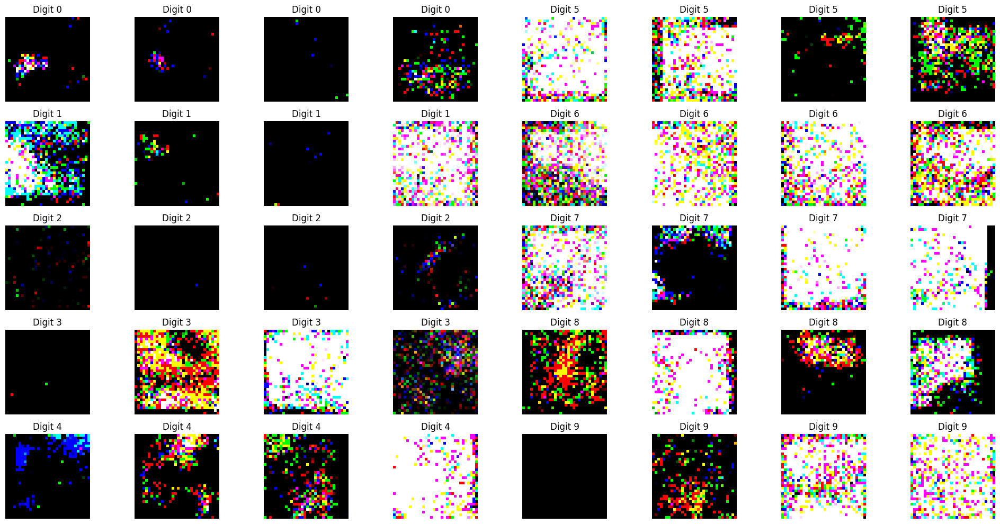


STUDENT ACTIVITY: Generating numbers with different noise seeds
Generating 1 versions of number 3...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 1 versions of number 3...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 1 versions of number 3...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 1 versions of number 3...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed
Generating 1 versions of number 3...
  Denoising step 39/199 completed
  Denoising step 79/199 completed
  Denoising step 119/199 completed
  Denoising step 159/199 completed


  Denoising step 199/199 completed


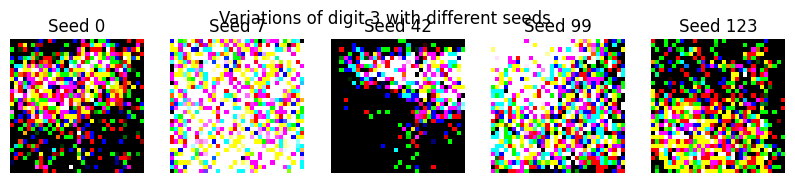

In [ ]:
def generate_number(model, number, n_samples=4):
    """
    Generate multiple versions of a specific number using the diffusion model.

    Args:
        model (nn.Module): The trained diffusion model
        number (int): The digit to generate (0-9)
        n_samples (int): Number of variations to generate

    Returns:
        torch.Tensor: Generated images of shape [n_samples, IMG_CH, IMG_SIZE, IMG_SIZE]
    """
    model.eval()  # Set model to evaluation mode
    with torch.no_grad():  # No need for gradients during generation
        # Start with random noise
        samples = torch.randn(n_samples, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Set up the number we want to generate
        c = torch.full((n_samples,), number).to(device)
        c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
        # Correctly sized conditioning mask
        c_mask = torch.ones_like(c.unsqueeze(-1)).to(device)

        # Display progress information
        print(f"Generating {n_samples} versions of number {number}...")

        # Remove noise step by step
        for t in range(n_steps-1, -1, -1):
            t_batch = torch.full((n_samples,), t).to(device)
            samples = remove_noise(samples, t_batch, model, c_one_hot, c_mask)

            # Optional: Display occasional progress updates
            if t % (n_steps // 5) == 0:
                print(f"  Denoising step {n_steps-1-t}/{n_steps-1} completed")

        return samples

# Generate 4 versions of each number
plt.figure(figsize=(20, 10))
for i in range(10):
    # Generate samples for current digit
    samples = generate_number(model, i, n_samples=4)

    # Display each sample
    for j in range(4):
        # Use 2 rows, 10 digits per row, 4 samples per digit
        # i//5 determines the row (0 or 1)
        # i%5 determines the position in the row (0-4)
        # j is the sample index within each digit (0-3)
        plt.subplot(5, 8, (i%5)*8 + (i//5)*4 + j + 1)

        # Display the image correctly based on channel configuration
        if IMG_CH == 1:  # Grayscale
            plt.imshow(samples[j][0].cpu(), cmap='gray')
        else:  # Color image
            img = samples[j].permute(1, 2, 0).cpu()
            # Rescale from [-1, 1] to [0, 1] if needed
            if img.min() < 0:
                img = (img + 1) / 2
            plt.imshow(img)

        plt.title(f'Digit {i}')
        plt.axis('off')

plt.tight_layout()
plt.show()

# STUDENT ACTIVITY: Try generating the same digit with different noise seeds
# This shows the variety of styles the model can produce
print("\nSTUDENT ACTIVITY: Generating numbers with different noise seeds")

# Helper function to generate with seed
def generate_with_seed(number, seed_value=42, n_samples=10):
    torch.manual_seed(seed_value)
    return generate_number(model, number, n_samples)

# Pick a image and show many variations
# Hint select a image e.g. dog  # Change this to any other in the dataset of subset you chose
# Hint 2 use variations = generate_with_seed
# Hint 3 use plt.figure and plt.imshow to display the variations

# Enter your code here:
# STUDENT ACTIVITY: show the effect of different random seeds
digit = 3
seed_list = [0, 7, 42, 99, 123]
plt.figure(figsize=(len(seed_list)*2, 2))
for i, seed in enumerate(seed_list):
    sample = generate_with_seed(digit, seed_value=seed, n_samples=1)[0]
    plt.subplot(1, len(seed_list), i+1)
    if IMG_CH == 1:
        plt.imshow(sample[0].cpu(), cmap='gray')
    else:
        vis = sample.permute(1,2,0).cpu()
        if vis.min() < 0: vis = (vis+1)/2
        plt.imshow(vis)
    plt.title(f'Seed {seed}')
    plt.axis('off')
plt.suptitle(f'Variations of digit {digit} with different seeds')
plt.show()

## Step 7: Watching the Generation Process

Let's see how our model turns random noise into clear images, step by step. This helps us understand how the diffusion process works!


Generating number 0:


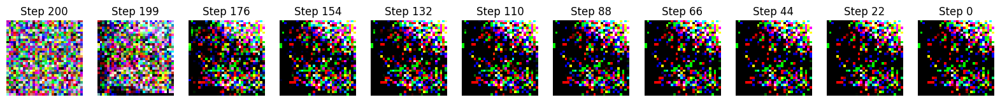


Generating number 3:


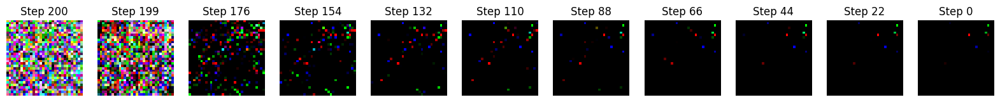


Generating number 7:


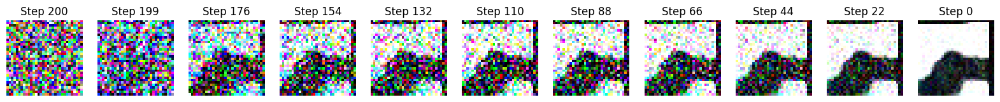

In [ ]:
def visualize_generation_steps(model, number, n_preview_steps=10):
    """
    Show how an image evolves from noise to a clear number
    """
    model.eval()
    with torch.no_grad():
        # Start with random noise
        x = torch.randn(1, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Set up which number to generate
        c = torch.tensor([number]).to(device)
        c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
        # Make sure mask is [batch,1], not [batch, classes]
        c_mask = torch.ones_like(c.unsqueeze(-1)).to(device)

        # Calculate which steps to show
        steps_to_show = torch.linspace(n_steps-1, 0, n_preview_steps).long()

        # Store images for visualization
        images = []
        images.append(x[0].cpu())

        # Remove noise step by step
        for t in range(n_steps-1, -1, -1):
            t_batch = torch.full((1,), t).to(device)
            x = remove_noise(x, t_batch, model, c_one_hot, c_mask)

            if t in steps_to_show:
                images.append(x[0].cpu())

        # Show the progression
        plt.figure(figsize=(20, 3))
        for i, img in enumerate(images):
            plt.subplot(1, len(images), i+1)
            if IMG_CH == 1:
                plt.imshow(img[0], cmap='gray')
            else:
                img = img.permute(1, 2, 0)
                if img.min() < 0:
                    img = (img + 1) / 2
                plt.imshow(img)
            step = n_steps if i == 0 else steps_to_show[i-1]
            plt.title(f'Step {step}')
            plt.axis('off')
        plt.show()

# Show generation process for a few numbers
for number in [0, 3, 7]:
    print(f"\nGenerating number {number}:")
    visualize_generation_steps(model, number)

## IMPROVED WORKFLOW: FINAL ATTEMPT TO MAKE IMAGES CLEAR

### Redefine Hyperparameters and Noise Schedule (Overwrites Step 4)



In [ ]:
# --- Redefine Hyperparameters for Improved Model ---
print("Redefining hyperparameters for improved model...")
N_STEPS = 1000 # Increased diffusion steps (overwrites user's n_steps=100)
# IMG_CH, IMG_SIZE, N_CLASSES, BATCH_SIZE, EPOCHS already defined by user for CIFAR-10
# Using user's BATCH_SIZE=32, EPOCHS=50

# Define U-Net architecture parameters (will be used in Step 6)
DOWN_CHS = (64, 128, 256, 512) # Deeper architecture channels
T_EMBED_DIM = 512 # Time embedding dimension
C_EMBED_DIM = N_CLASSES # Class embedding dimension (use N_CLASSES)

# --- Define Cosine Beta Schedule Function ---
import math # Make sure math is imported

def cosine_beta_schedule(T, s=0.008):
    """Cosine schedule as proposed in https://arxiv.org/abs/2102.09672"""
    steps = T + 1
    x = torch.linspace(0, T, steps, dtype=torch.float64)
    alphas_cumprod = torch.cos(((x / T + s) / (1 + s)) * math.pi * 0.5) ** 2
    alphas_cumprod = alphas_cumprod / alphas_cumprod[0]
    betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])
    return torch.clip(betas, 0, 0.999)

# --- Recalculate Schedule Variables using Cosine Schedule ---
# These overwrite the previous linear schedule variables (beta, alpha, alpha_bar, etc.)
print(f"Calculating cosine schedule for N_STEPS={N_STEPS}...")
beta = cosine_beta_schedule(N_STEPS).to(device).float() # Ensure float32
alpha = 1. - beta
alpha_bar = torch.cumprod(alpha, dim=0)
sqrt_alpha_bar = torch.sqrt(alpha_bar)
sqrt_one_minus_alpha_bar = torch.sqrt(1. - alpha_bar)

print("Diffusion schedule variables recalculated using cosine schedule.")
# Verify shapes
print(f"beta shape: {beta.shape}")
print(f"alpha_bar shape: {alpha_bar.shape}")

Redefining hyperparameters for improved model...
Calculating cosine schedule for N_STEPS=1000...
Diffusion schedule variables recalculated using cosine schedule.
beta shape: torch.Size([1000])
alpha_bar shape: torch.Size([1000])


### Step 2: Define Un-normalization Function



In [ ]:
# --- Define Image Un-normalization Function ---
def to_image(x):
    """
    Transforms a tensor from [-1, 1] range to [0, 1] for plotting/saving.
    Assumes input x is shape [B, C, H, W]. Clamps input first.
    """
    x = x.clamp(-1, 1) # Ensure input is within valid range
    img = (x + 1) * 0.5
    return img.clamp(0, 1) # Ensure output is valid range [0, 1]

print("Helper function 'to_image' defined for un-normalization.")

Helper function 'to_image' defined for un-normalization.


### Step 3: Redefine generate_samples with CFG and Correct Masking/Plotting (Overwrite part of Step 5)



In [ ]:
# --- Redefine Generation Function with Classifier-Free Guidance (CFG) ---
# This overwrites the user's existing generate_samples function

@torch.no_grad() # Ensure no gradients are computed during generation
def generate_samples(model, n_samples=10, cfg_scale=3.0):
    """
    Generates sample images using the model with CFG for visualization.
    Generates digits 0 through n_samples-1.
    Uses global N_STEPS and schedule variables.
    """
    print(f"Generating samples with CFG (scale={cfg_scale})...")
    model.eval() # Set model to evaluation mode

    samples_list = []
    num_to_generate = min(n_samples, N_CLASSES) # Generate for available classes

    for digit in range(num_to_generate):
        # Start with random noise for this digit
        x = torch.randn(1, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Prepare conditioning vector (class label)
        c = torch.tensor([digit], dtype=torch.long).to(device)
        c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float() # Ensure float and correct num_classes

        # --- Correct Conditioning Masks for CFG ---
        c_mask_cond = torch.ones(1, dtype=torch.bool, device=device)   # Mask for conditional step (True)
        c_mask_uncond = torch.zeros(1, dtype=torch.bool, device=device) # Mask for unconditional step (False)

        # Reverse diffusion process step-by-step
        for t_val in range(N_STEPS - 1, -1, -1):
            t_batch = torch.full((1,), t_val, device=device, dtype=torch.long) # Ensure correct dtype

            # --- CFG Prediction ---
            # Predict noise unconditionally
            eps_uncond = model(x, t_batch, c_one_hot, c_mask_uncond)
            # Predict noise conditionally
            eps_cond = model(x, t_batch, c_one_hot, c_mask_cond)

            # Combine predictions using CFG scale
            # eps = eps_uncond + cfg_scale * (eps_cond - eps_uncond)
            # Alternative formulation (often equivalent, sometimes more stable):
            eps = (1 + cfg_scale) * eps_cond - cfg_scale * eps_uncond


            # --- Denoising Step (using your existing remove_noise logic) ---
            # We need the core calculation from your `remove_noise` function using the predicted eps
            # Fetch schedule variables for timestep t_val
            alpha_t = alpha[t_val] # Shape []
            alpha_bar_t = alpha_bar[t_val] # Shape []
            beta_t = beta[t_val] # Shape []
            sqrt_one_minus_alpha_bar_t = sqrt_one_minus_alpha_bar[t_val] # Shape []

            # Calculate mean using the combined eps prediction
            mean = (1 / torch.sqrt(alpha_t)) * (x - (beta_t / sqrt_one_minus_alpha_bar_t) * eps)

            # Add noise if not the last step
            if t_val > 0:
                noise = torch.randn_like(x)
                # Calculate variance (using beta_t directly for DDPM)
                variance = torch.sqrt(beta_t)
                x = mean + variance * noise
            else:
                x = mean # No noise added at the final step

        samples_list.append(x) # Store the final denoised sample for this digit

    # Combine samples, un-normalize, and display
    samples = torch.cat(samples_list, dim=0)
    samples = to_image(samples) # Un-normalize from [-1, 1] to [0, 1]

    grid = make_grid(samples, nrow=min(n_samples, 5)) # normalize=True removed as to_image handles range

    plt.figure(figsize=(10, 4))
    # Display based on channel configuration
    if IMG_CH == 1:
        plt.imshow(grid[0].cpu(), cmap='gray')
    else:
        # Permute from [C, H, W] to [H, W, C] for matplotlib
        plt.imshow(grid.permute(1, 2, 0).cpu())
    plt.axis('off')
    plt.title(f'Generated Samples (CFG Scale: {cfg_scale})')
    plt.show()

    model.train() # Set model back to training mode if needed later
    print("Generation function 'generate_samples' redefined with CFG.")

###Step 4: Redefine train_step with CFG Training Strategy (Overwrite part of Step 5)



In [ ]:
# --- Redefine Training Step Function with CFG Strategy ---
# This overwrites the user's existing train_step function

def train_step(x, c):
    """
    Performs a single training step for the diffusion model with CFG strategy.
    Randomly drops conditioning info for some samples during training.
    """
    model.train() # Ensure model is in training mode
    optimizer.zero_grad() # Reset gradients

    # Prepare class conditioning (one-hot)
    c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float().to(device)

    # --- Classifier-Free Guidance Training ---
    # Randomly drop conditioning for some samples (e.g., 10% probability)
    prob_uncond = 0.1
    # Create a boolean mask: True = condition, False = don't condition
    c_mask_cfg = (torch.rand(c.shape[0], device=device) > prob_uncond)

    # Pick random timesteps
    t = torch.randint(0, N_STEPS, (x.shape[0],), device=device, dtype=torch.long)

    # Add noise (using the new global cosine schedule variables)
    x_t, noise = add_noise(x, t) # add_noise uses global schedule variables

    # Predict noise using the model, passing the CFG mask
    # The model's forward pass uses c_mask to decide whether to add class embedding
    predicted_noise = model(x_t, t, c_one_hot, c_mask_cfg) # Pass the CFG mask here

    # Calculate loss
    loss = F.mse_loss(predicted_noise, noise)

    # Backpropagation
    loss.backward()
    optimizer.step()

    return loss.item() # Return loss value for logging

print("Training function 'train_step' redefined with CFG strategy.")

Training function 'train_step' redefined with CFG strategy.


### Step 5: U-Net Model Instantiation (Revised)

In [ ]:
# Assume UNet class definition is available from your notebook
# class UNet(nn.Module): ... (Your definition here)

# Instantiate the U-Net model with updated parameters
model = UNet(
    T=N_STEPS,          # Total diffusion steps
    img_ch=IMG_CH,      # Input image channels
    img_size=IMG_SIZE,    # Input image size
    down_chs=DOWN_CHS,  # Channel dimensions for down-sampling path
    t_embed_dim=T_EMBED_DIM, # Dimension for time embedding
    c_embed_dim=C_EMBED_DIM  # Dimension for class embedding
).to(device)

# Print model summary or number of parameters (optional)
print(f"Model instantiated with {sum(p.numel() for p in model.parameters()):,} parameters.")

# Load pre-trained weights if available (replace 'model.pth' with your checkpoint file)
try:
    model.load_state_dict(torch.load('model_cifar_improved.pth', map_location=device))
    print("Loaded pre-trained model weights.")
except FileNotFoundError:
    print("No pre-trained weights found. Model initialized from scratch.")
except Exception as e:
    print(f"Error loading weights: {e}. Model initialized from scratch.")

# Validate parameters
validate_model_parameters(model)

Created DownBlock: in_chs=64, out_chs=128, spatial_reduction=2x
Created DownBlock: in_chs=128, out_chs=256, spatial_reduction=2x
Created DownBlock: in_chs=256, out_chs=512, spatial_reduction=2x
Created UpBlock: in_chs=512, out_chs=256, spatial_increase=2x
Created UpBlock: in_chs=256, out_chs=128, spatial_increase=2x
Created UpBlock: in_chs=128, out_chs=64, spatial_increase=2x
Created UNet with 4 scale levels
Channel dimensions: (64, 128, 256, 512)
Model instantiated with 26,344,671 parameters.
No pre-trained weights found. Model initialized from scratch.
Total parameters: 26,344,671
Trainable parameters: 26,344,671
Estimated GPU memory usage: 402.0 MB


### Step 6: Define Learning Rate, Optimizer, and Scheduler



In [ ]:
# --- Define Training Configuration ---
import torch.optim.lr_scheduler as lr_scheduler # Import scheduler

# Define Learning Rate (Adjust as needed)
LR = 2e-4

# Configuration constants from your template
early_stopping_patience = 10
gradient_clip_value = 1.0
display_frequency = 100 # Log loss every 100 steps
generate_frequency = 500 # Generate samples every 500 steps

# Define Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

# Define Learning Rate Scheduler (Example: ReduceLROnPlateau)
# This reduces LR if validation loss plateaus
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer,
                                           mode='min',      # Reduce LR when val_loss stops decreasing
                                           factor=0.5,      # Reduce LR by half
                                           patience=3,      # Wait 3 epochs with no improvement
                                           verbose=True)    # Print message when LR changes

print(f"Optimizer (Adam, LR={LR}) and LR Scheduler (ReduceLROnPlateau) defined.")

# Check required variables are defined from previous cells
required_vars = ['model', 'EPOCHS', 'train_load', 'val_load', 'device',
                 'N_CLASSES', 'N_STEPS', 'add_noise', 'generate_samples',
                 'safe_save_model']
for v in required_vars:
    if v not in locals():
        raise NameError(f"Variable '{v}' is not defined. Please ensure previous cells were run.")

Optimizer (Adam, LR=0.0002) and LR Scheduler (ReduceLROnPlateau) defined.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


### Final Refinement of Loss Calculation Functions (Modified train_step and new calculate_val_loss)

In [ ]:
# --- Define Loss Calculation Functions ---

# --- Modified Training Step Function (Returns Loss Tensor Only) ---
def train_step(x, c):
    """
    Performs forward pass, calculates loss with CFG strategy for training.
    Returns the loss tensor for backpropagation outside this function.
    """
    # No need for model.train() or optimizer.zero_grad() here

    # Prepare class conditioning (one-hot)
    c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float().to(device)

    # --- Classifier-Free Guidance Training ---
    prob_uncond = 0.1
    c_mask_cfg = (torch.rand(c.shape[0], device=device) > prob_uncond) # Boolean mask

    # Pick random timesteps
    t = torch.randint(0, N_STEPS, (x.shape[0],), device=device, dtype=torch.long)

    # Add noise (uses global cosine schedule variables)
    x_t, noise = add_noise(x, t)

    # Predict noise using the model, passing the CFG mask
    predicted_noise = model(x_t, t, c_one_hot, c_mask_cfg)

    # Calculate loss
    loss = F.mse_loss(predicted_noise, noise)
    # Loss tensor is returned directly
    return loss

# --- New Validation Loss Calculation Function ---
@torch.no_grad() # Ensure no gradients are calculated
def calculate_val_loss(model, x, c):
    """
    Calculates the loss for validation data *without* CFG training strategy
    and without gradient calculations.
    """
    model.eval() # Ensure model is in eval mode

    # Prepare class conditioning (one-hot)
    c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float().to(device)

    # --- Standard Conditional Mask for Validation/Inference ---
    # Always condition during validation loss calculation
    c_mask_cond = torch.ones(c.shape[0], dtype=torch.bool, device=device)

    # Pick random timesteps (important to match training distribution)
    t = torch.randint(0, N_STEPS, (x.shape[0],), device=device, dtype=torch.long)

    # Add noise
    x_t, noise = add_noise(x, t)

    # Predict noise using the model (always conditionally)
    predicted_noise = model(x_t, t, c_one_hot, c_mask_cond)

    # Calculate loss
    loss = F.mse_loss(predicted_noise, noise)

    return loss.item() # Return scalar loss value

print("Loss functions 'train_step' (modified) and 'calculate_val_loss' (new) defined.")

Loss functions 'train_step' (modified) and 'calculate_val_loss' (new) defined.


### Step 7: Training Loop Setup (Revised)


STARTING TRAINING (with CFG, Cosine Schedule)
Epochs: 50, Batch Size: 32, Steps: 1000
Device: cuda

--- Epoch 1/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 1, Step 100/1250, Avg Loss (last 100): 0.2460
  Epoch 1, Step 200/1250, Avg Loss (last 100): 0.1174
  Epoch 1, Step 300/1250, Avg Loss (last 100): 0.1122
  Epoch 1, Step 400/1250, Avg Loss (last 100): 0.0971
  Epoch 1, Step 500/1250, Avg Loss (last 100): 0.0941
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


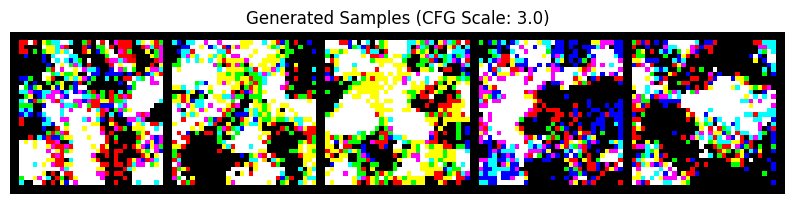

Generation function 'generate_samples' redefined with CFG.
  Epoch 1, Step 600/1250, Avg Loss (last 100): 0.0910
  Epoch 1, Step 700/1250, Avg Loss (last 100): 0.0865
  Epoch 1, Step 800/1250, Avg Loss (last 100): 0.0876
  Epoch 1, Step 900/1250, Avg Loss (last 100): 0.0865
  Epoch 1, Step 1000/1250, Avg Loss (last 100): 0.0798
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


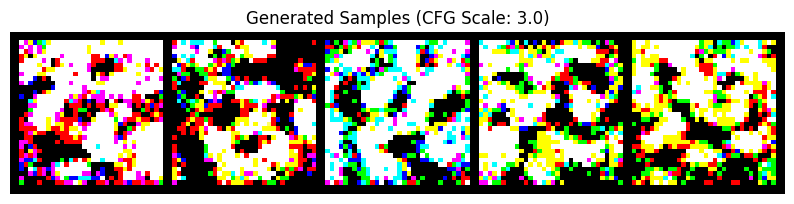

Generation function 'generate_samples' redefined with CFG.
  Epoch 1, Step 1100/1250, Avg Loss (last 100): 0.0849
  Epoch 1, Step 1200/1250, Avg Loss (last 100): 0.0841
Training Finished - Epoch 1 Avg Loss: 0.1045
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 1 Avg Loss: 0.0795
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0795)
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 2/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 2, Step 100/1250, Avg Loss (last 100): 0.0763
  Epoch 2, Step 200/1250, Avg Loss (last 100): 0.0765
  Epoch 2, Step 300/1250, Avg Loss (last 100): 0.0774
  Epoch 2, Step 400/1250, Avg Loss (last 100): 0.0770
  Epoch 2, Step 500/1250, Avg Loss (last 100): 0.0737
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


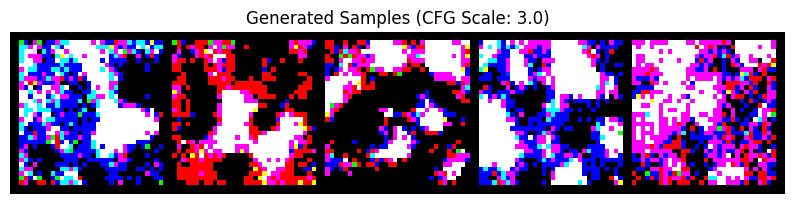

Generation function 'generate_samples' redefined with CFG.
  Epoch 2, Step 600/1250, Avg Loss (last 100): 0.0749
  Epoch 2, Step 700/1250, Avg Loss (last 100): 0.0746
  Epoch 2, Step 800/1250, Avg Loss (last 100): 0.0745
  Epoch 2, Step 900/1250, Avg Loss (last 100): 0.0749
  Epoch 2, Step 1000/1250, Avg Loss (last 100): 0.0704
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


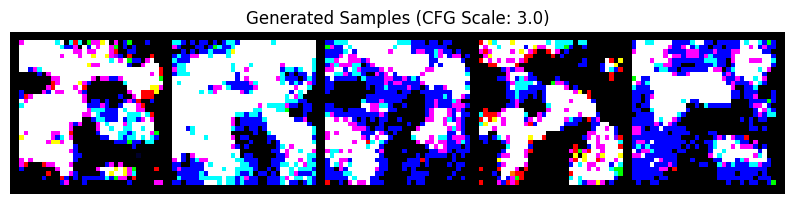

Generation function 'generate_samples' redefined with CFG.
  Epoch 2, Step 1100/1250, Avg Loss (last 100): 0.0722
  Epoch 2, Step 1200/1250, Avg Loss (last 100): 0.0726
Training Finished - Epoch 2 Avg Loss: 0.0744
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 2 Avg Loss: 0.0718
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0718)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 2)...
Generating samples with CFG (scale=3.0)...


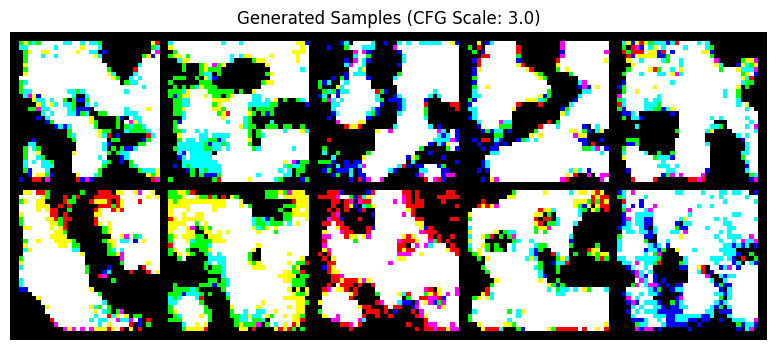

Generation function 'generate_samples' redefined with CFG.

--- Epoch 3/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 3, Step 100/1250, Avg Loss (last 100): 0.0744
  Epoch 3, Step 200/1250, Avg Loss (last 100): 0.0755
  Epoch 3, Step 300/1250, Avg Loss (last 100): 0.0711
  Epoch 3, Step 400/1250, Avg Loss (last 100): 0.0680
  Epoch 3, Step 500/1250, Avg Loss (last 100): 0.0677
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


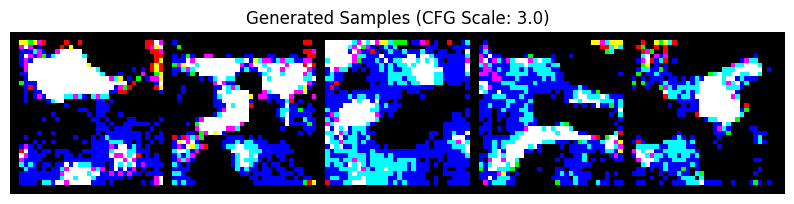

Generation function 'generate_samples' redefined with CFG.
  Epoch 3, Step 600/1250, Avg Loss (last 100): 0.0683
  Epoch 3, Step 700/1250, Avg Loss (last 100): 0.0736
  Epoch 3, Step 800/1250, Avg Loss (last 100): 0.0704
  Epoch 3, Step 900/1250, Avg Loss (last 100): 0.0715
  Epoch 3, Step 1000/1250, Avg Loss (last 100): 0.0704
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


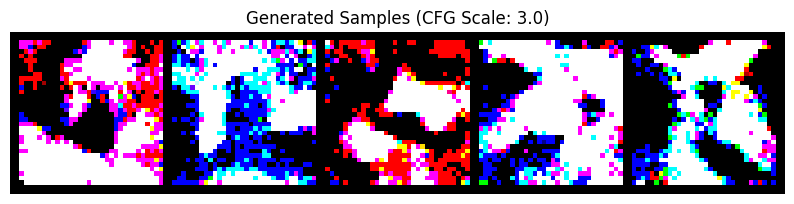

Generation function 'generate_samples' redefined with CFG.
  Epoch 3, Step 1100/1250, Avg Loss (last 100): 0.0696
  Epoch 3, Step 1200/1250, Avg Loss (last 100): 0.0694
Training Finished - Epoch 3 Avg Loss: 0.0707
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 3 Avg Loss: 0.0694
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0694)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 4/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 4, Step 100/1250, Avg Loss (last 100): 0.0669
  Epoch 4, Step 200/1250, Avg Loss (last 100): 0.0698
  Epoch 4, Step 300/1250, Avg Loss (last 100): 0.0687
  Epoch 4, Step 400/1250, Avg Loss (last 100): 0.0675
  Epoch 4, Step 500/1250, Avg Loss (last 100): 0.0669
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


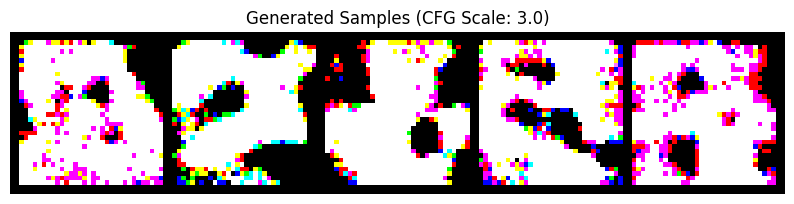

Generation function 'generate_samples' redefined with CFG.
  Epoch 4, Step 600/1250, Avg Loss (last 100): 0.0675
  Epoch 4, Step 700/1250, Avg Loss (last 100): 0.0675
  Epoch 4, Step 800/1250, Avg Loss (last 100): 0.0659
  Epoch 4, Step 900/1250, Avg Loss (last 100): 0.0664
  Epoch 4, Step 1000/1250, Avg Loss (last 100): 0.0657
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


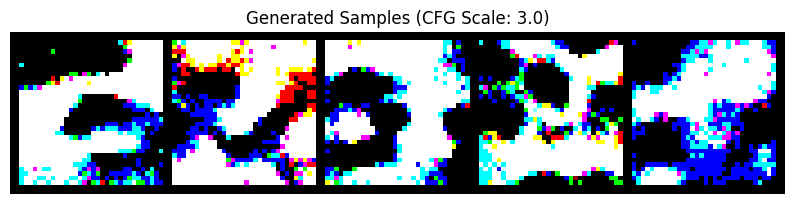

Generation function 'generate_samples' redefined with CFG.
  Epoch 4, Step 1100/1250, Avg Loss (last 100): 0.0645
  Epoch 4, Step 1200/1250, Avg Loss (last 100): 0.0685
Training Finished - Epoch 4 Avg Loss: 0.0673
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 4 Avg Loss: 0.0681
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0681)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 4)...
Generating samples with CFG (scale=3.0)...


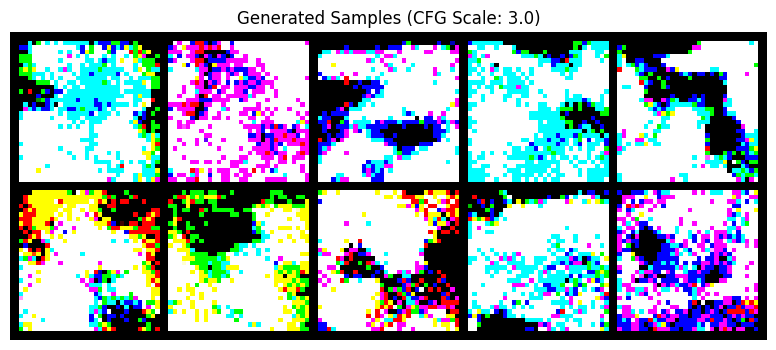

Generation function 'generate_samples' redefined with CFG.

--- Epoch 5/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 5, Step 100/1250, Avg Loss (last 100): 0.0653
  Epoch 5, Step 200/1250, Avg Loss (last 100): 0.0657
  Epoch 5, Step 300/1250, Avg Loss (last 100): 0.0652
  Epoch 5, Step 400/1250, Avg Loss (last 100): 0.0656
  Epoch 5, Step 500/1250, Avg Loss (last 100): 0.0666
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


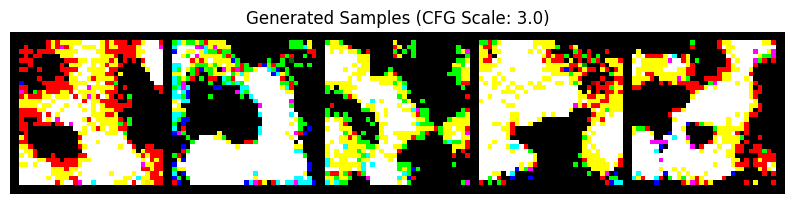

Generation function 'generate_samples' redefined with CFG.
  Epoch 5, Step 600/1250, Avg Loss (last 100): 0.0673
  Epoch 5, Step 700/1250, Avg Loss (last 100): 0.0678
  Epoch 5, Step 800/1250, Avg Loss (last 100): 0.0663
  Epoch 5, Step 900/1250, Avg Loss (last 100): 0.0668
  Epoch 5, Step 1000/1250, Avg Loss (last 100): 0.0644
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


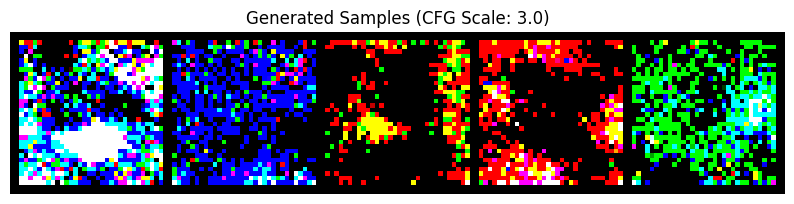

Generation function 'generate_samples' redefined with CFG.
  Epoch 5, Step 1100/1250, Avg Loss (last 100): 0.0655
  Epoch 5, Step 1200/1250, Avg Loss (last 100): 0.0648
Training Finished - Epoch 5 Avg Loss: 0.0662
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 5 Avg Loss: 0.0671
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0671)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth


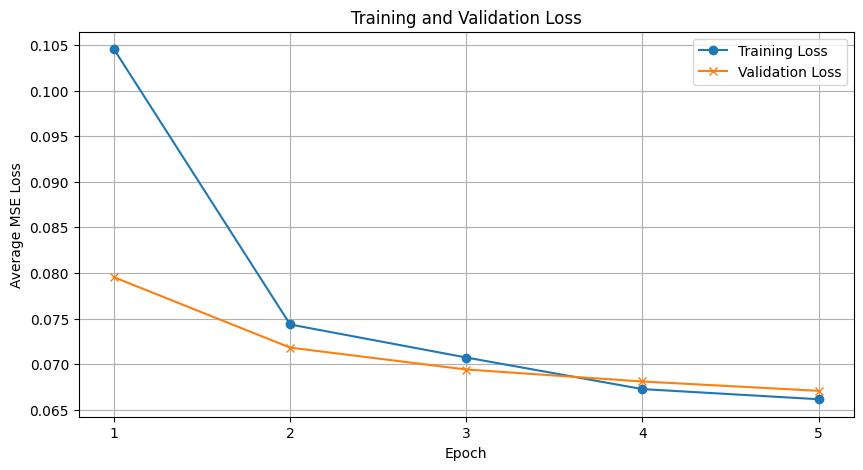


--- Epoch 6/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 6, Step 100/1250, Avg Loss (last 100): 0.0685
  Epoch 6, Step 200/1250, Avg Loss (last 100): 0.0651
  Epoch 6, Step 300/1250, Avg Loss (last 100): 0.0644
  Epoch 6, Step 400/1250, Avg Loss (last 100): 0.0648
  Epoch 6, Step 500/1250, Avg Loss (last 100): 0.0625
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


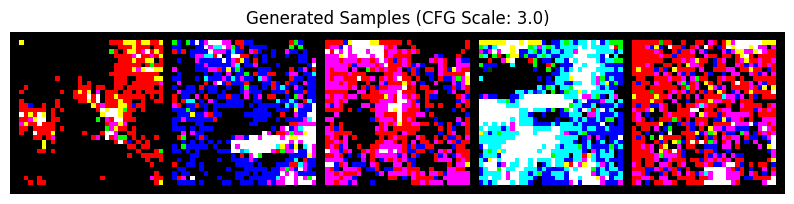

Generation function 'generate_samples' redefined with CFG.
  Epoch 6, Step 600/1250, Avg Loss (last 100): 0.0642
  Epoch 6, Step 700/1250, Avg Loss (last 100): 0.0643
  Epoch 6, Step 800/1250, Avg Loss (last 100): 0.0640
  Epoch 6, Step 900/1250, Avg Loss (last 100): 0.0665
  Epoch 6, Step 1000/1250, Avg Loss (last 100): 0.0646
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


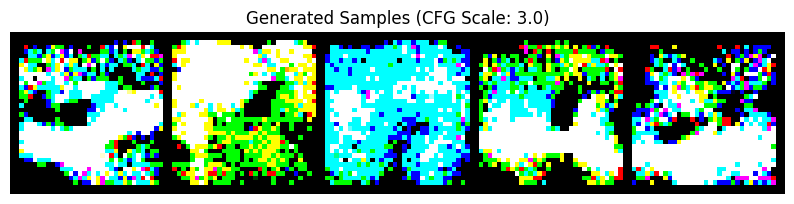

Generation function 'generate_samples' redefined with CFG.
  Epoch 6, Step 1100/1250, Avg Loss (last 100): 0.0665
  Epoch 6, Step 1200/1250, Avg Loss (last 100): 0.0674
Training Finished - Epoch 6 Avg Loss: 0.0655
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 6 Avg Loss: 0.0645
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0645)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 6)...
Generating samples with CFG (scale=3.0)...


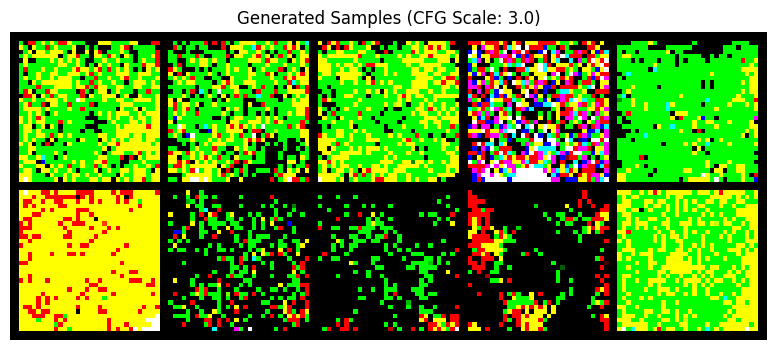

Generation function 'generate_samples' redefined with CFG.

--- Epoch 7/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 7, Step 100/1250, Avg Loss (last 100): 0.0652
  Epoch 7, Step 200/1250, Avg Loss (last 100): 0.0648
  Epoch 7, Step 300/1250, Avg Loss (last 100): 0.0668
  Epoch 7, Step 400/1250, Avg Loss (last 100): 0.0625
  Epoch 7, Step 500/1250, Avg Loss (last 100): 0.0657
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


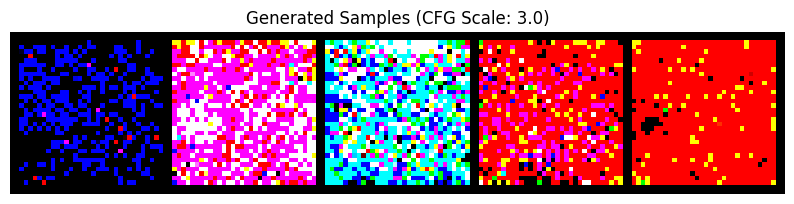

Generation function 'generate_samples' redefined with CFG.
  Epoch 7, Step 600/1250, Avg Loss (last 100): 0.0649
  Epoch 7, Step 700/1250, Avg Loss (last 100): 0.0624
  Epoch 7, Step 800/1250, Avg Loss (last 100): 0.0630
  Epoch 7, Step 900/1250, Avg Loss (last 100): 0.0664
  Epoch 7, Step 1000/1250, Avg Loss (last 100): 0.0609
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


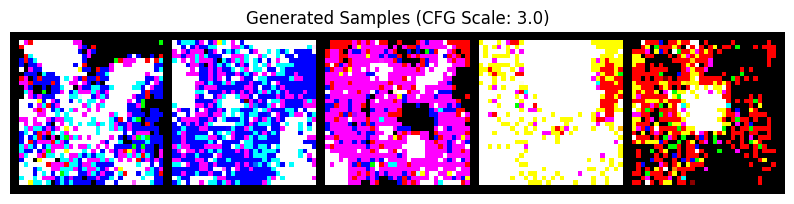

Generation function 'generate_samples' redefined with CFG.
  Epoch 7, Step 1100/1250, Avg Loss (last 100): 0.0629
  Epoch 7, Step 1200/1250, Avg Loss (last 100): 0.0654
Training Finished - Epoch 7 Avg Loss: 0.0643
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 7 Avg Loss: 0.0640
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0640)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 8/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 8, Step 100/1250, Avg Loss (last 100): 0.0665
  Epoch 8, Step 200/1250, Avg Loss (last 100): 0.0628
  Epoch 8, Step 300/1250, Avg Loss (last 100): 0.0652
  Epoch 8, Step 400/1250, Avg Loss (last 100): 0.0675
  Epoch 8, Step 500/1250, Avg Loss (last 100): 0.0626
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


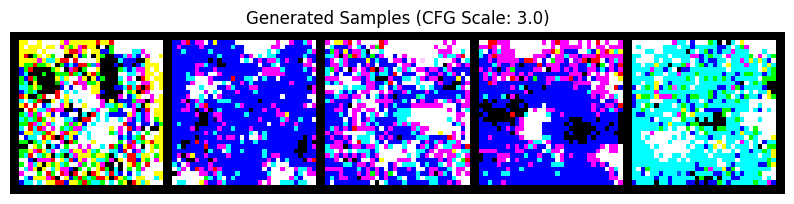

Generation function 'generate_samples' redefined with CFG.
  Epoch 8, Step 600/1250, Avg Loss (last 100): 0.0652
  Epoch 8, Step 700/1250, Avg Loss (last 100): 0.0609
  Epoch 8, Step 800/1250, Avg Loss (last 100): 0.0622
  Epoch 8, Step 900/1250, Avg Loss (last 100): 0.0642
  Epoch 8, Step 1000/1250, Avg Loss (last 100): 0.0629
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


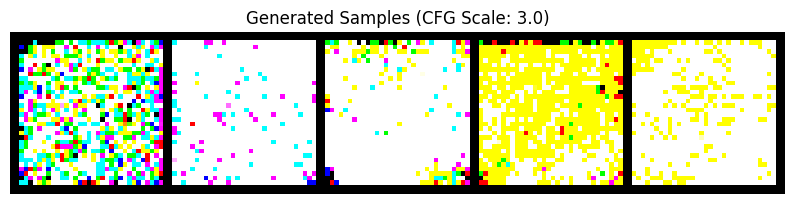

Generation function 'generate_samples' redefined with CFG.
  Epoch 8, Step 1100/1250, Avg Loss (last 100): 0.0634
  Epoch 8, Step 1200/1250, Avg Loss (last 100): 0.0632
Training Finished - Epoch 8 Avg Loss: 0.0639
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 8 Avg Loss: 0.0645
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 8)...
Generating samples with CFG (scale=3.0)...


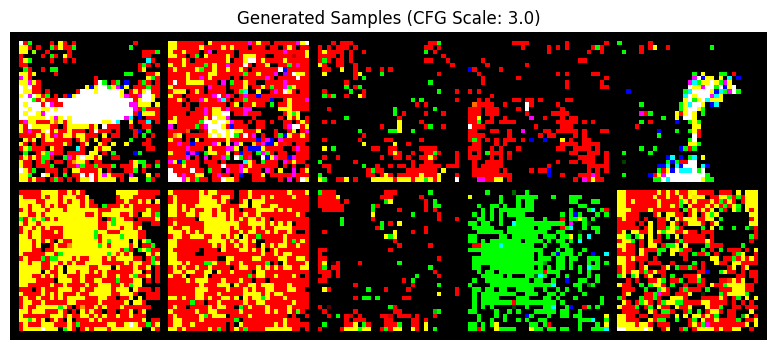

Generation function 'generate_samples' redefined with CFG.

--- Epoch 9/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 9, Step 100/1250, Avg Loss (last 100): 0.0641
  Epoch 9, Step 200/1250, Avg Loss (last 100): 0.0611
  Epoch 9, Step 300/1250, Avg Loss (last 100): 0.0665
  Epoch 9, Step 400/1250, Avg Loss (last 100): 0.0636
  Epoch 9, Step 500/1250, Avg Loss (last 100): 0.0622
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


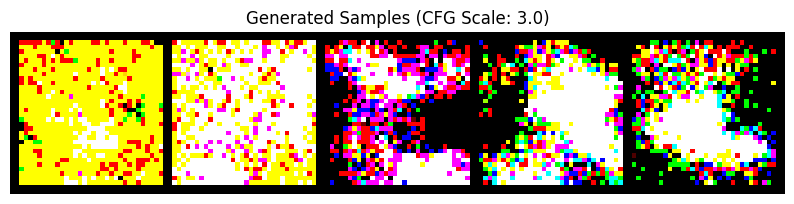

Generation function 'generate_samples' redefined with CFG.
  Epoch 9, Step 600/1250, Avg Loss (last 100): 0.0636
  Epoch 9, Step 700/1250, Avg Loss (last 100): 0.0647
  Epoch 9, Step 800/1250, Avg Loss (last 100): 0.0634
  Epoch 9, Step 900/1250, Avg Loss (last 100): 0.0620
  Epoch 9, Step 1000/1250, Avg Loss (last 100): 0.0628
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


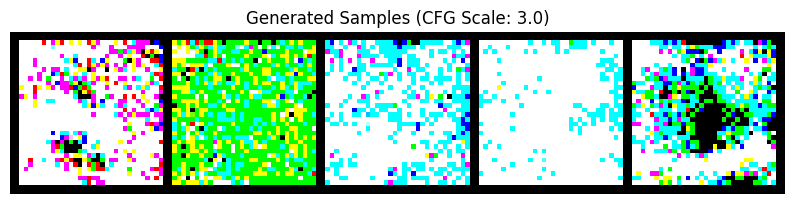

Generation function 'generate_samples' redefined with CFG.
  Epoch 9, Step 1100/1250, Avg Loss (last 100): 0.0649
  Epoch 9, Step 1200/1250, Avg Loss (last 100): 0.0658
Training Finished - Epoch 9 Avg Loss: 0.0637
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 9 Avg Loss: 0.0631
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0631)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 10/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 10, Step 100/1250, Avg Loss (last 100): 0.0621
  Epoch 10, Step 200/1250, Avg Loss (last 100): 0.0596
  Epoch 10, Step 300/1250, Avg Loss (last 100): 0.0644
  Epoch 10, Step 400/1250, Avg Loss (last 100): 0.0624
  Epoch 10, Step 500/1250, Avg Loss (last 100): 0.0615
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


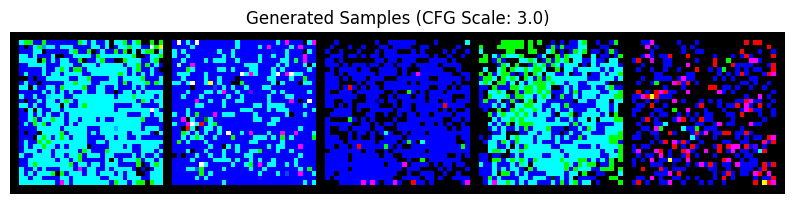

Generation function 'generate_samples' redefined with CFG.
  Epoch 10, Step 600/1250, Avg Loss (last 100): 0.0613
  Epoch 10, Step 700/1250, Avg Loss (last 100): 0.0650
  Epoch 10, Step 800/1250, Avg Loss (last 100): 0.0648
  Epoch 10, Step 900/1250, Avg Loss (last 100): 0.0605
  Epoch 10, Step 1000/1250, Avg Loss (last 100): 0.0609
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


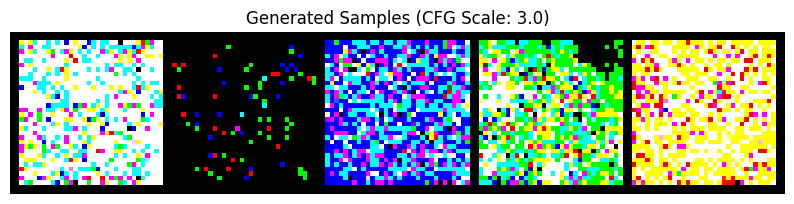

Generation function 'generate_samples' redefined with CFG.
  Epoch 10, Step 1100/1250, Avg Loss (last 100): 0.0661
  Epoch 10, Step 1200/1250, Avg Loss (last 100): 0.0639
Training Finished - Epoch 10 Avg Loss: 0.0628
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 10 Avg Loss: 0.0634
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 10)...
Generating samples with CFG (scale=3.0)...


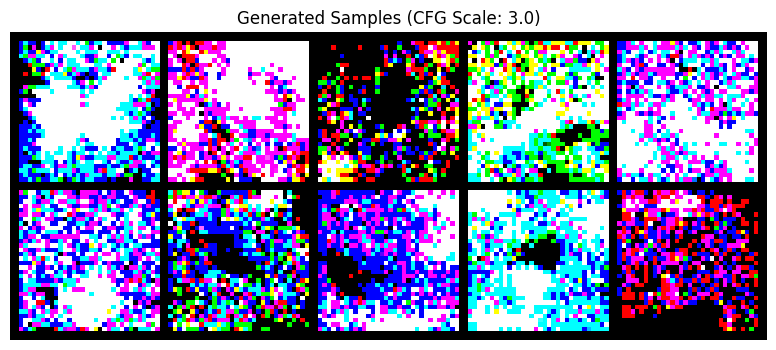

Generation function 'generate_samples' redefined with CFG.


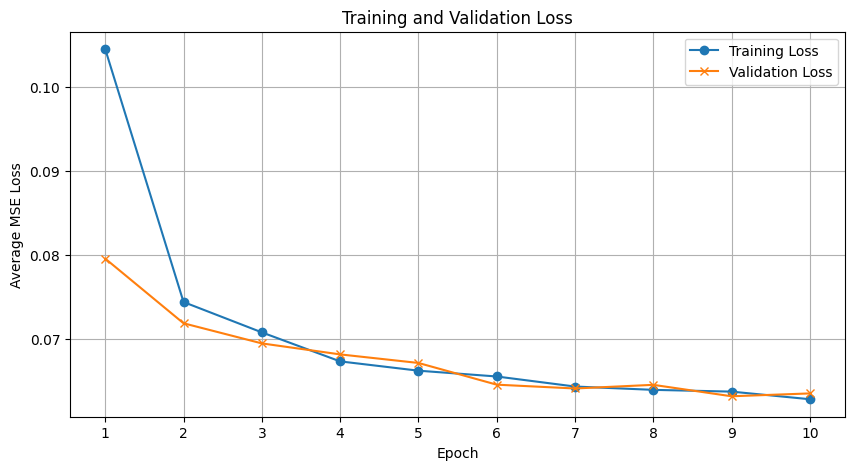


--- Epoch 11/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 11, Step 100/1250, Avg Loss (last 100): 0.0632
  Epoch 11, Step 200/1250, Avg Loss (last 100): 0.0610
  Epoch 11, Step 300/1250, Avg Loss (last 100): 0.0640
  Epoch 11, Step 400/1250, Avg Loss (last 100): 0.0641
  Epoch 11, Step 500/1250, Avg Loss (last 100): 0.0617
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


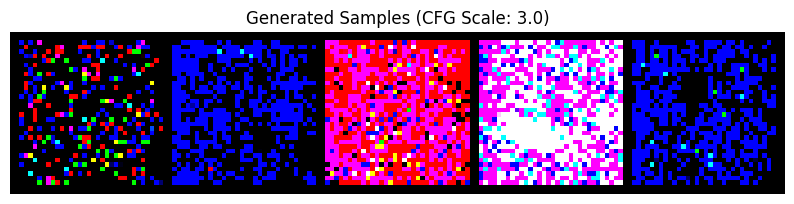

Generation function 'generate_samples' redefined with CFG.
  Epoch 11, Step 600/1250, Avg Loss (last 100): 0.0659
  Epoch 11, Step 700/1250, Avg Loss (last 100): 0.0644
  Epoch 11, Step 800/1250, Avg Loss (last 100): 0.0629
  Epoch 11, Step 900/1250, Avg Loss (last 100): 0.0609
  Epoch 11, Step 1000/1250, Avg Loss (last 100): 0.0638
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


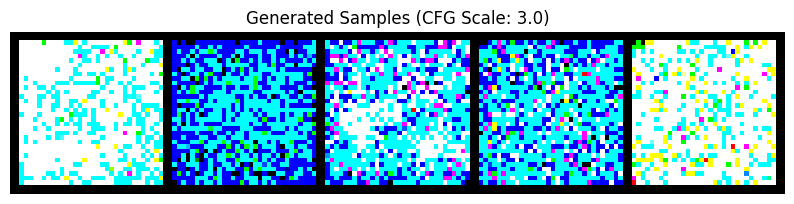

Generation function 'generate_samples' redefined with CFG.
  Epoch 11, Step 1100/1250, Avg Loss (last 100): 0.0635
  Epoch 11, Step 1200/1250, Avg Loss (last 100): 0.0641
Training Finished - Epoch 11 Avg Loss: 0.0634
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 11 Avg Loss: 0.0617
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0617)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 12/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 12, Step 100/1250, Avg Loss (last 100): 0.0635
  Epoch 12, Step 200/1250, Avg Loss (last 100): 0.0635
  Epoch 12, Step 300/1250, Avg Loss (last 100): 0.0604
  Epoch 12, Step 400/1250, Avg Loss (last 100): 0.0630
  Epoch 12, Step 500/1250, Avg Loss (last 100): 0.0640
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


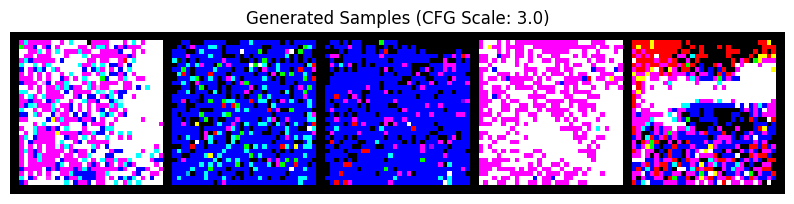

Generation function 'generate_samples' redefined with CFG.
  Epoch 12, Step 600/1250, Avg Loss (last 100): 0.0614
  Epoch 12, Step 700/1250, Avg Loss (last 100): 0.0598
  Epoch 12, Step 800/1250, Avg Loss (last 100): 0.0628
  Epoch 12, Step 900/1250, Avg Loss (last 100): 0.0614
  Epoch 12, Step 1000/1250, Avg Loss (last 100): 0.0628
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


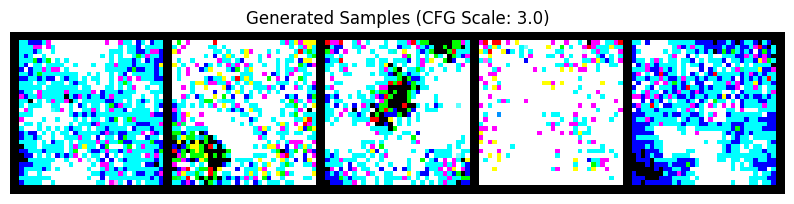

Generation function 'generate_samples' redefined with CFG.
  Epoch 12, Step 1100/1250, Avg Loss (last 100): 0.0648
  Epoch 12, Step 1200/1250, Avg Loss (last 100): 0.0627
Training Finished - Epoch 12 Avg Loss: 0.0624
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 12 Avg Loss: 0.0621
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 12)...
Generating samples with CFG (scale=3.0)...


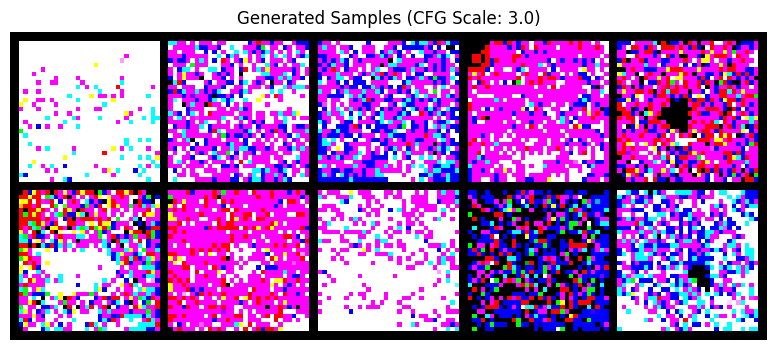

Generation function 'generate_samples' redefined with CFG.

--- Epoch 13/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 13, Step 100/1250, Avg Loss (last 100): 0.0611
  Epoch 13, Step 200/1250, Avg Loss (last 100): 0.0598
  Epoch 13, Step 300/1250, Avg Loss (last 100): 0.0611
  Epoch 13, Step 400/1250, Avg Loss (last 100): 0.0659
  Epoch 13, Step 500/1250, Avg Loss (last 100): 0.0590
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


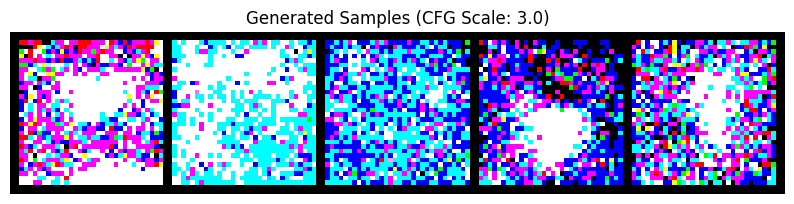

Generation function 'generate_samples' redefined with CFG.
  Epoch 13, Step 600/1250, Avg Loss (last 100): 0.0615
  Epoch 13, Step 700/1250, Avg Loss (last 100): 0.0625
  Epoch 13, Step 800/1250, Avg Loss (last 100): 0.0633
  Epoch 13, Step 900/1250, Avg Loss (last 100): 0.0618
  Epoch 13, Step 1000/1250, Avg Loss (last 100): 0.0631
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


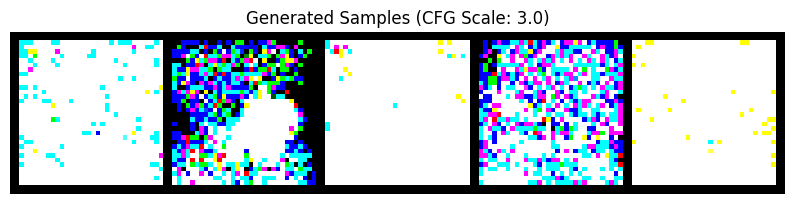

Generation function 'generate_samples' redefined with CFG.
  Epoch 13, Step 1100/1250, Avg Loss (last 100): 0.0592
  Epoch 13, Step 1200/1250, Avg Loss (last 100): 0.0617
Training Finished - Epoch 13 Avg Loss: 0.0618
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 13 Avg Loss: 0.0624
Validation loss did not improve for 2/10 epochs.

--- Epoch 14/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 14, Step 100/1250, Avg Loss (last 100): 0.0627
  Epoch 14, Step 200/1250, Avg Loss (last 100): 0.0615
  Epoch 14, Step 300/1250, Avg Loss (last 100): 0.0621
  Epoch 14, Step 400/1250, Avg Loss (last 100): 0.0624
  Epoch 14, Step 500/1250, Avg Loss (last 100): 0.0638
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


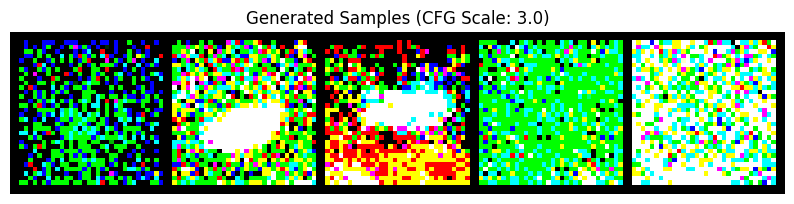

Generation function 'generate_samples' redefined with CFG.
  Epoch 14, Step 600/1250, Avg Loss (last 100): 0.0625
  Epoch 14, Step 700/1250, Avg Loss (last 100): 0.0626
  Epoch 14, Step 800/1250, Avg Loss (last 100): 0.0642
  Epoch 14, Step 900/1250, Avg Loss (last 100): 0.0603
  Epoch 14, Step 1000/1250, Avg Loss (last 100): 0.0649
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


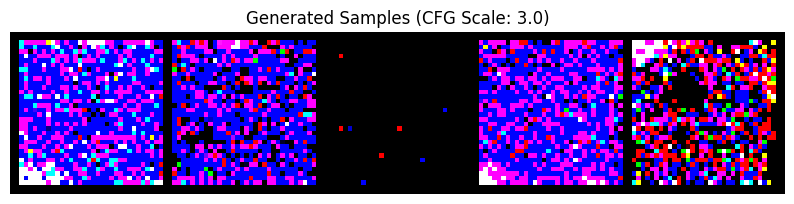

Generation function 'generate_samples' redefined with CFG.
  Epoch 14, Step 1100/1250, Avg Loss (last 100): 0.0603
  Epoch 14, Step 1200/1250, Avg Loss (last 100): 0.0630
Training Finished - Epoch 14 Avg Loss: 0.0627
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 14 Avg Loss: 0.0630
Validation loss did not improve for 3/10 epochs.

Generating samples for visual progress check (Epoch 14)...
Generating samples with CFG (scale=3.0)...


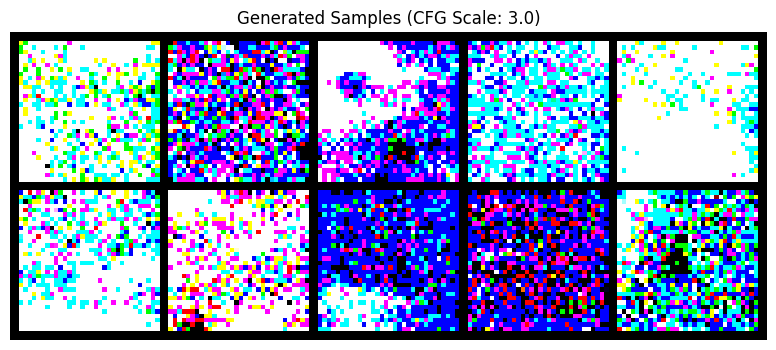

Generation function 'generate_samples' redefined with CFG.

--- Epoch 15/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 15, Step 100/1250, Avg Loss (last 100): 0.0596
  Epoch 15, Step 200/1250, Avg Loss (last 100): 0.0615
  Epoch 15, Step 300/1250, Avg Loss (last 100): 0.0593
  Epoch 15, Step 400/1250, Avg Loss (last 100): 0.0621
  Epoch 15, Step 500/1250, Avg Loss (last 100): 0.0632
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


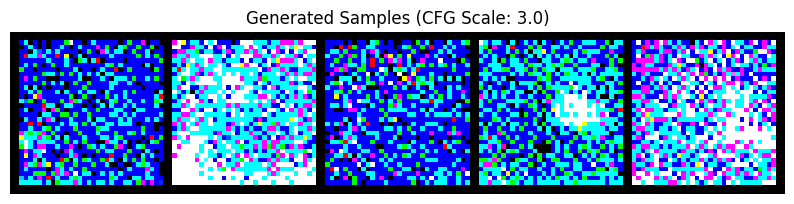

Generation function 'generate_samples' redefined with CFG.
  Epoch 15, Step 600/1250, Avg Loss (last 100): 0.0637
  Epoch 15, Step 700/1250, Avg Loss (last 100): 0.0640
  Epoch 15, Step 800/1250, Avg Loss (last 100): 0.0640
  Epoch 15, Step 900/1250, Avg Loss (last 100): 0.0612
  Epoch 15, Step 1000/1250, Avg Loss (last 100): 0.0609
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


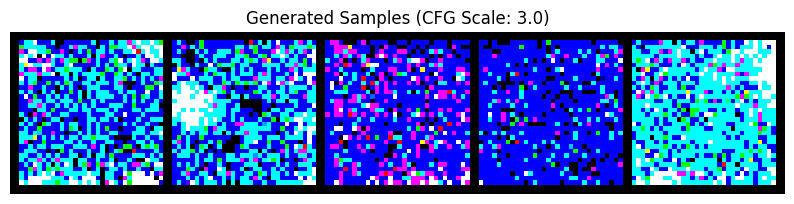

Generation function 'generate_samples' redefined with CFG.
  Epoch 15, Step 1100/1250, Avg Loss (last 100): 0.0667
  Epoch 15, Step 1200/1250, Avg Loss (last 100): 0.0586
Training Finished - Epoch 15 Avg Loss: 0.0621
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 15 Avg Loss: 0.0612
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0612)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth


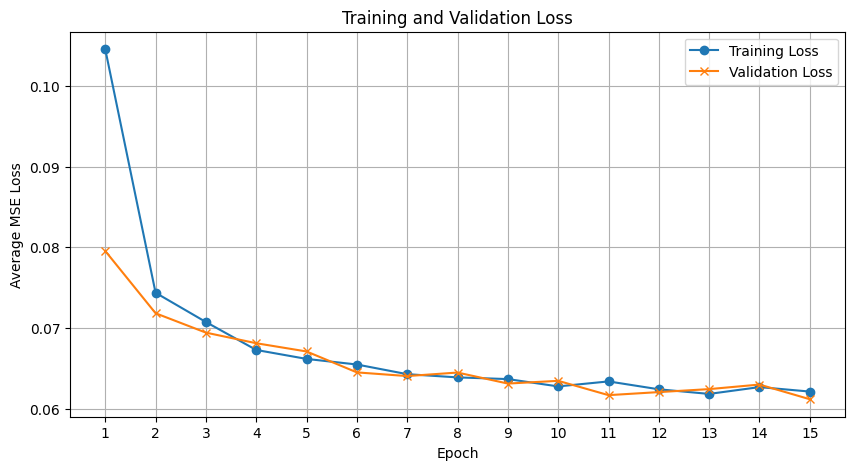


--- Epoch 16/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 16, Step 100/1250, Avg Loss (last 100): 0.0612
  Epoch 16, Step 200/1250, Avg Loss (last 100): 0.0626
  Epoch 16, Step 300/1250, Avg Loss (last 100): 0.0625
  Epoch 16, Step 400/1250, Avg Loss (last 100): 0.0605
  Epoch 16, Step 500/1250, Avg Loss (last 100): 0.0611
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


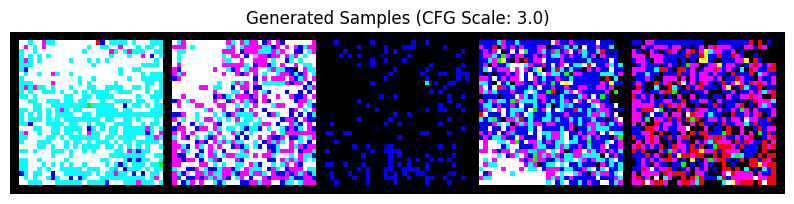

Generation function 'generate_samples' redefined with CFG.
  Epoch 16, Step 600/1250, Avg Loss (last 100): 0.0615
  Epoch 16, Step 700/1250, Avg Loss (last 100): 0.0614
  Epoch 16, Step 800/1250, Avg Loss (last 100): 0.0631
  Epoch 16, Step 900/1250, Avg Loss (last 100): 0.0600
  Epoch 16, Step 1000/1250, Avg Loss (last 100): 0.0641
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


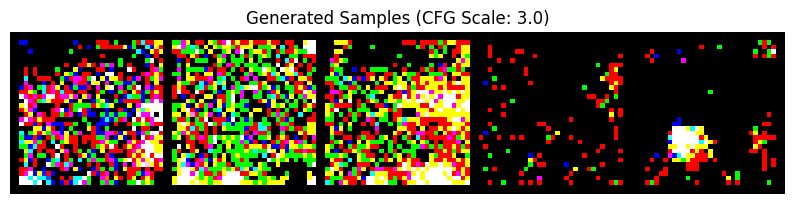

Generation function 'generate_samples' redefined with CFG.
  Epoch 16, Step 1100/1250, Avg Loss (last 100): 0.0610
  Epoch 16, Step 1200/1250, Avg Loss (last 100): 0.0612
Training Finished - Epoch 16 Avg Loss: 0.0616
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 16 Avg Loss: 0.0623
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 16)...
Generating samples with CFG (scale=3.0)...


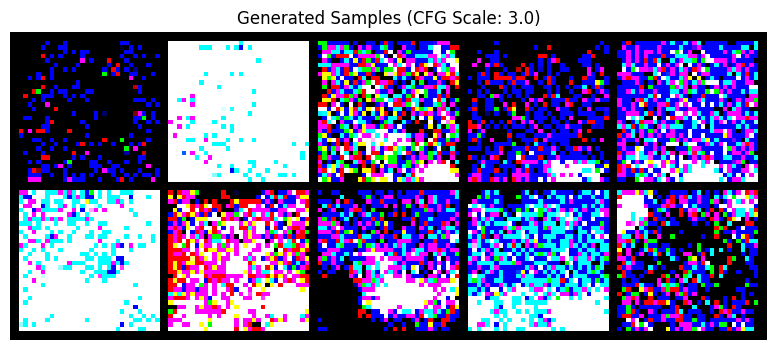

Generation function 'generate_samples' redefined with CFG.

--- Epoch 17/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 17, Step 100/1250, Avg Loss (last 100): 0.0603
  Epoch 17, Step 200/1250, Avg Loss (last 100): 0.0580
  Epoch 17, Step 300/1250, Avg Loss (last 100): 0.0599
  Epoch 17, Step 400/1250, Avg Loss (last 100): 0.0640
  Epoch 17, Step 500/1250, Avg Loss (last 100): 0.0598
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


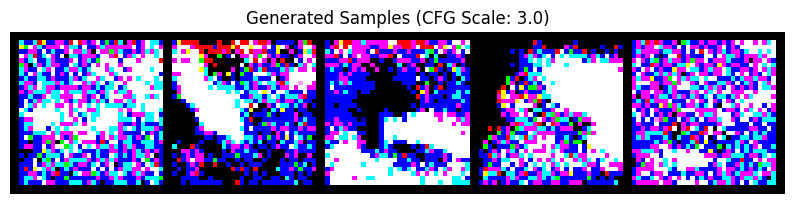

Generation function 'generate_samples' redefined with CFG.
  Epoch 17, Step 600/1250, Avg Loss (last 100): 0.0594
  Epoch 17, Step 700/1250, Avg Loss (last 100): 0.0628
  Epoch 17, Step 800/1250, Avg Loss (last 100): 0.0599
  Epoch 17, Step 900/1250, Avg Loss (last 100): 0.0612
  Epoch 17, Step 1000/1250, Avg Loss (last 100): 0.0594
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


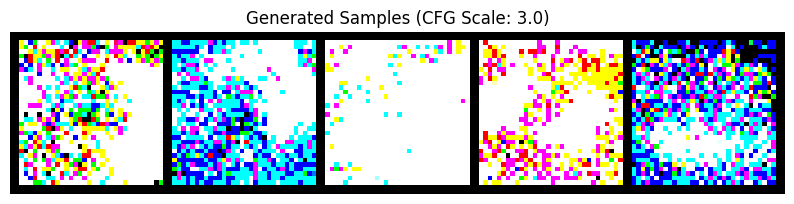

Generation function 'generate_samples' redefined with CFG.
  Epoch 17, Step 1100/1250, Avg Loss (last 100): 0.0600
  Epoch 17, Step 1200/1250, Avg Loss (last 100): 0.0612
Training Finished - Epoch 17 Avg Loss: 0.0605
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 17 Avg Loss: 0.0620
Validation loss did not improve for 2/10 epochs.

--- Epoch 18/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 18, Step 100/1250, Avg Loss (last 100): 0.0631
  Epoch 18, Step 200/1250, Avg Loss (last 100): 0.0609
  Epoch 18, Step 300/1250, Avg Loss (last 100): 0.0625
  Epoch 18, Step 400/1250, Avg Loss (last 100): 0.0615
  Epoch 18, Step 500/1250, Avg Loss (last 100): 0.0610
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


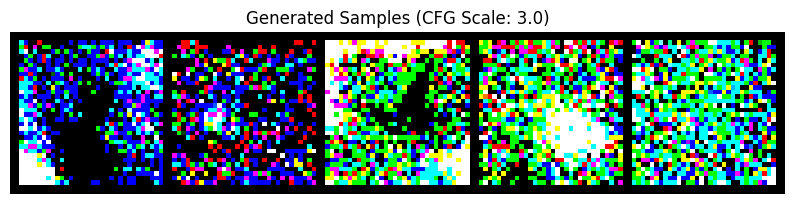

Generation function 'generate_samples' redefined with CFG.
  Epoch 18, Step 600/1250, Avg Loss (last 100): 0.0614
  Epoch 18, Step 700/1250, Avg Loss (last 100): 0.0621
  Epoch 18, Step 800/1250, Avg Loss (last 100): 0.0617
  Epoch 18, Step 900/1250, Avg Loss (last 100): 0.0625
  Epoch 18, Step 1000/1250, Avg Loss (last 100): 0.0610
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


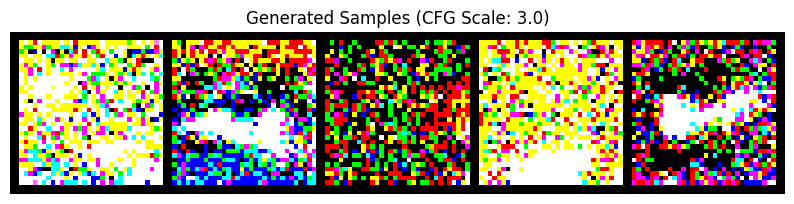

Generation function 'generate_samples' redefined with CFG.
  Epoch 18, Step 1100/1250, Avg Loss (last 100): 0.0589
  Epoch 18, Step 1200/1250, Avg Loss (last 100): 0.0606
Training Finished - Epoch 18 Avg Loss: 0.0614
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 18 Avg Loss: 0.0603
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0603)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 18)...
Generating samples with CFG (scale=3.0)...


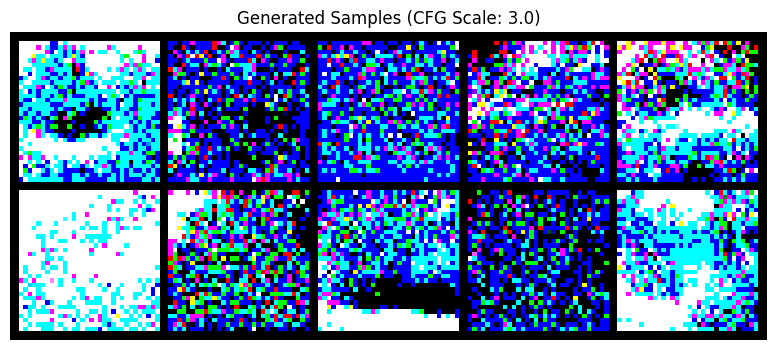

Generation function 'generate_samples' redefined with CFG.

--- Epoch 19/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 19, Step 100/1250, Avg Loss (last 100): 0.0615
  Epoch 19, Step 200/1250, Avg Loss (last 100): 0.0604
  Epoch 19, Step 300/1250, Avg Loss (last 100): 0.0593
  Epoch 19, Step 400/1250, Avg Loss (last 100): 0.0593
  Epoch 19, Step 500/1250, Avg Loss (last 100): 0.0610
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


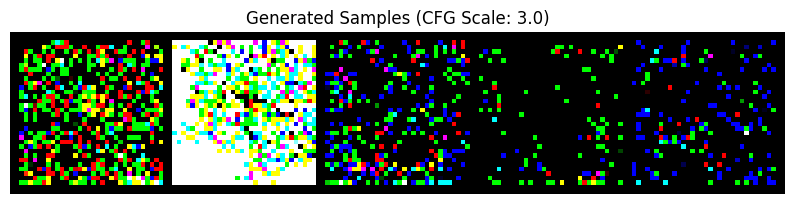

Generation function 'generate_samples' redefined with CFG.
  Epoch 19, Step 600/1250, Avg Loss (last 100): 0.0627
  Epoch 19, Step 700/1250, Avg Loss (last 100): 0.0613
  Epoch 19, Step 800/1250, Avg Loss (last 100): 0.0636
  Epoch 19, Step 900/1250, Avg Loss (last 100): 0.0599
  Epoch 19, Step 1000/1250, Avg Loss (last 100): 0.0643
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


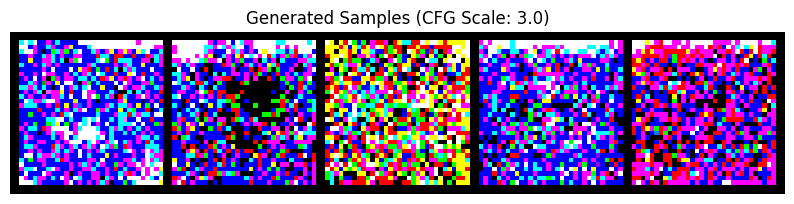

Generation function 'generate_samples' redefined with CFG.
  Epoch 19, Step 1100/1250, Avg Loss (last 100): 0.0617
  Epoch 19, Step 1200/1250, Avg Loss (last 100): 0.0602
Training Finished - Epoch 19 Avg Loss: 0.0613
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 19 Avg Loss: 0.0637
Validation loss did not improve for 1/10 epochs.

--- Epoch 20/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 20, Step 100/1250, Avg Loss (last 100): 0.0625
  Epoch 20, Step 200/1250, Avg Loss (last 100): 0.0608
  Epoch 20, Step 300/1250, Avg Loss (last 100): 0.0641
  Epoch 20, Step 400/1250, Avg Loss (last 100): 0.0618
  Epoch 20, Step 500/1250, Avg Loss (last 100): 0.0619
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


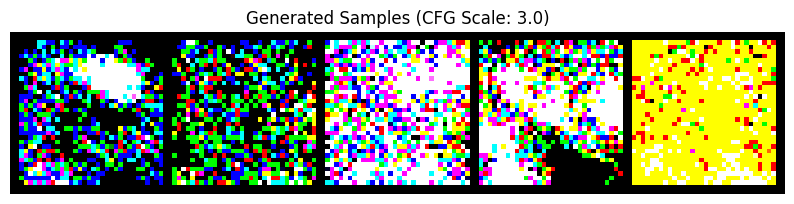

Generation function 'generate_samples' redefined with CFG.
  Epoch 20, Step 600/1250, Avg Loss (last 100): 0.0612
  Epoch 20, Step 700/1250, Avg Loss (last 100): 0.0601
  Epoch 20, Step 800/1250, Avg Loss (last 100): 0.0621
  Epoch 20, Step 900/1250, Avg Loss (last 100): 0.0604
  Epoch 20, Step 1000/1250, Avg Loss (last 100): 0.0619
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


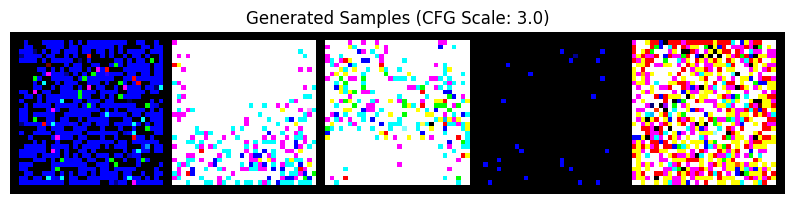

Generation function 'generate_samples' redefined with CFG.
  Epoch 20, Step 1100/1250, Avg Loss (last 100): 0.0614
  Epoch 20, Step 1200/1250, Avg Loss (last 100): 0.0589
Training Finished - Epoch 20 Avg Loss: 0.0613
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 20 Avg Loss: 0.0620
Validation loss did not improve for 2/10 epochs.

Generating samples for visual progress check (Epoch 20)...
Generating samples with CFG (scale=3.0)...


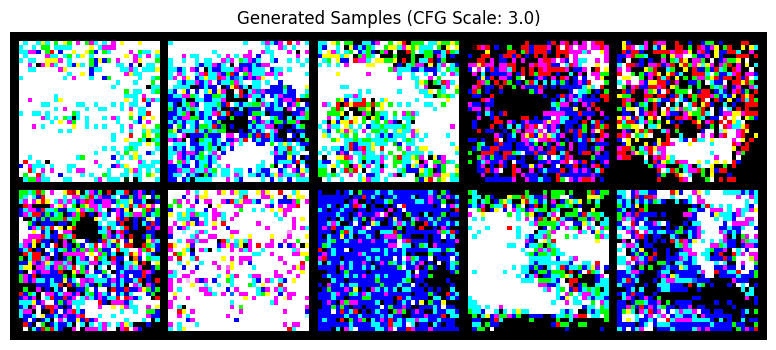

Generation function 'generate_samples' redefined with CFG.


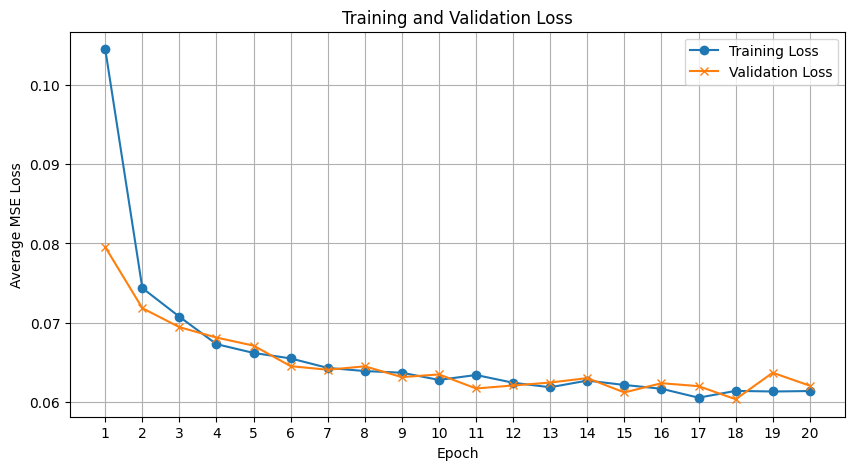


--- Epoch 21/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 21, Step 100/1250, Avg Loss (last 100): 0.0625
  Epoch 21, Step 200/1250, Avg Loss (last 100): 0.0586
  Epoch 21, Step 300/1250, Avg Loss (last 100): 0.0612
  Epoch 21, Step 400/1250, Avg Loss (last 100): 0.0603
  Epoch 21, Step 500/1250, Avg Loss (last 100): 0.0631
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


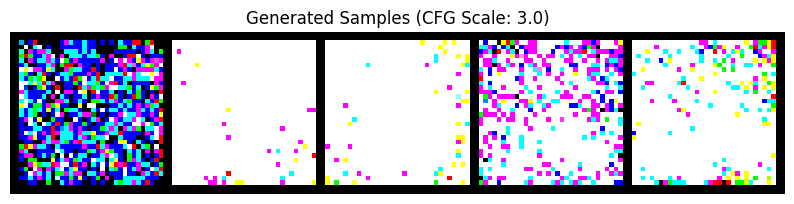

Generation function 'generate_samples' redefined with CFG.
  Epoch 21, Step 600/1250, Avg Loss (last 100): 0.0596
  Epoch 21, Step 700/1250, Avg Loss (last 100): 0.0579
  Epoch 21, Step 800/1250, Avg Loss (last 100): 0.0609
  Epoch 21, Step 900/1250, Avg Loss (last 100): 0.0579
  Epoch 21, Step 1000/1250, Avg Loss (last 100): 0.0632
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


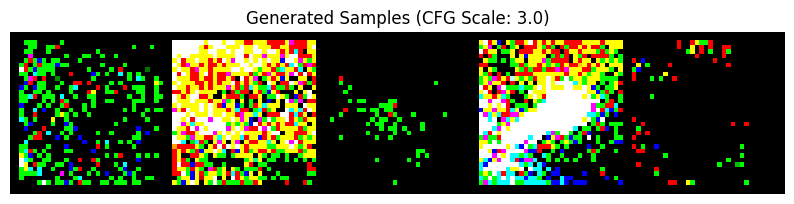

Generation function 'generate_samples' redefined with CFG.
  Epoch 21, Step 1100/1250, Avg Loss (last 100): 0.0619
  Epoch 21, Step 1200/1250, Avg Loss (last 100): 0.0623
Training Finished - Epoch 21 Avg Loss: 0.0606
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 21 Avg Loss: 0.0599
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0599)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 22/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 22, Step 100/1250, Avg Loss (last 100): 0.0608
  Epoch 22, Step 200/1250, Avg Loss (last 100): 0.0578
  Epoch 22, Step 300/1250, Avg Loss (last 100): 0.0577
  Epoch 22, Step 400/1250, Avg Loss (last 100): 0.0583
  Epoch 22, Step 500/1250, Avg Loss (last 100): 0.0610
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


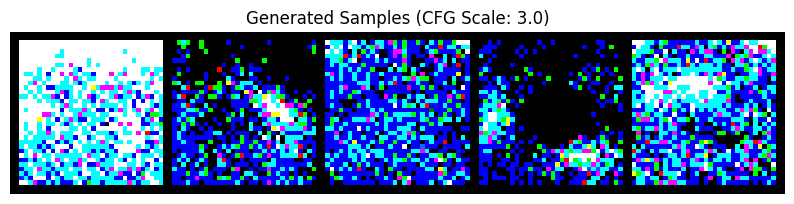

Generation function 'generate_samples' redefined with CFG.
  Epoch 22, Step 600/1250, Avg Loss (last 100): 0.0589
  Epoch 22, Step 700/1250, Avg Loss (last 100): 0.0574
  Epoch 22, Step 800/1250, Avg Loss (last 100): 0.0605
  Epoch 22, Step 900/1250, Avg Loss (last 100): 0.0604
  Epoch 22, Step 1000/1250, Avg Loss (last 100): 0.0562
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


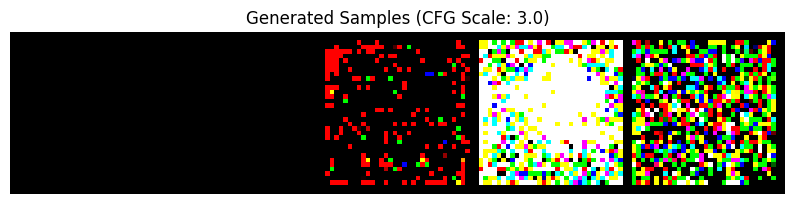

Generation function 'generate_samples' redefined with CFG.
  Epoch 22, Step 1100/1250, Avg Loss (last 100): 0.0595
  Epoch 22, Step 1200/1250, Avg Loss (last 100): 0.0612
Training Finished - Epoch 22 Avg Loss: 0.0592
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 22 Avg Loss: 0.0612
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 22)...
Generating samples with CFG (scale=3.0)...


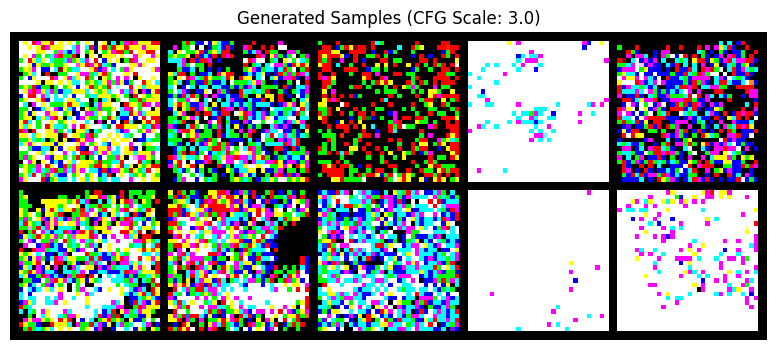

Generation function 'generate_samples' redefined with CFG.

--- Epoch 23/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 23, Step 100/1250, Avg Loss (last 100): 0.0603
  Epoch 23, Step 200/1250, Avg Loss (last 100): 0.0599
  Epoch 23, Step 300/1250, Avg Loss (last 100): 0.0597
  Epoch 23, Step 400/1250, Avg Loss (last 100): 0.0592
  Epoch 23, Step 500/1250, Avg Loss (last 100): 0.0606
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


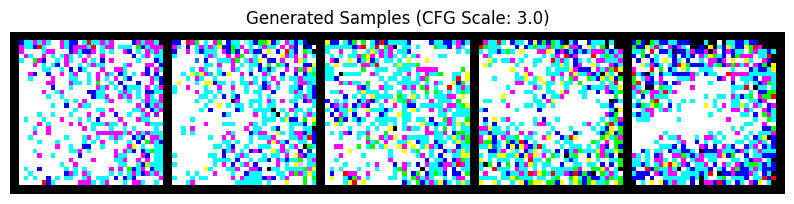

Generation function 'generate_samples' redefined with CFG.
  Epoch 23, Step 600/1250, Avg Loss (last 100): 0.0588
  Epoch 23, Step 700/1250, Avg Loss (last 100): 0.0617
  Epoch 23, Step 800/1250, Avg Loss (last 100): 0.0603
  Epoch 23, Step 900/1250, Avg Loss (last 100): 0.0581
  Epoch 23, Step 1000/1250, Avg Loss (last 100): 0.0601
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


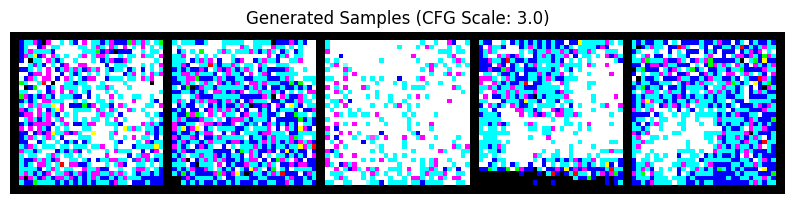

Generation function 'generate_samples' redefined with CFG.
  Epoch 23, Step 1100/1250, Avg Loss (last 100): 0.0613
  Epoch 23, Step 1200/1250, Avg Loss (last 100): 0.0609
Training Finished - Epoch 23 Avg Loss: 0.0600
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 23 Avg Loss: 0.0603
Validation loss did not improve for 2/10 epochs.

--- Epoch 24/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 24, Step 100/1250, Avg Loss (last 100): 0.0629
  Epoch 24, Step 200/1250, Avg Loss (last 100): 0.0626
  Epoch 24, Step 300/1250, Avg Loss (last 100): 0.0577
  Epoch 24, Step 400/1250, Avg Loss (last 100): 0.0598
  Epoch 24, Step 500/1250, Avg Loss (last 100): 0.0612
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


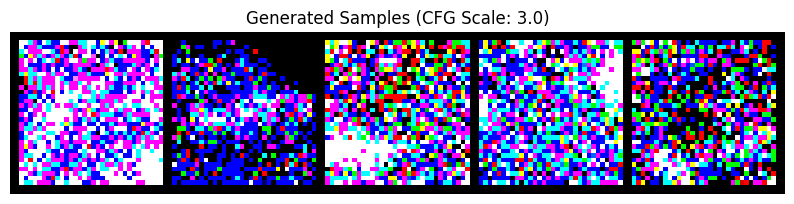

Generation function 'generate_samples' redefined with CFG.
  Epoch 24, Step 600/1250, Avg Loss (last 100): 0.0595
  Epoch 24, Step 700/1250, Avg Loss (last 100): 0.0583
  Epoch 24, Step 800/1250, Avg Loss (last 100): 0.0598
  Epoch 24, Step 900/1250, Avg Loss (last 100): 0.0590
  Epoch 24, Step 1000/1250, Avg Loss (last 100): 0.0596
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


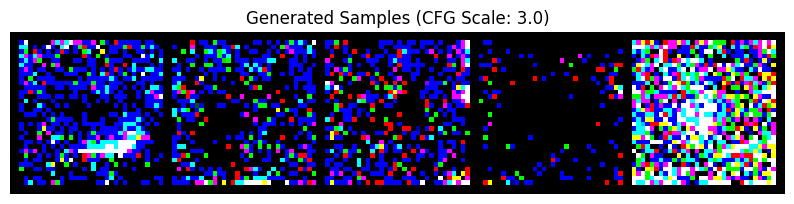

Generation function 'generate_samples' redefined with CFG.
  Epoch 24, Step 1100/1250, Avg Loss (last 100): 0.0592
  Epoch 24, Step 1200/1250, Avg Loss (last 100): 0.0598
Training Finished - Epoch 24 Avg Loss: 0.0601
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 24 Avg Loss: 0.0605
Validation loss did not improve for 3/10 epochs.

Generating samples for visual progress check (Epoch 24)...
Generating samples with CFG (scale=3.0)...


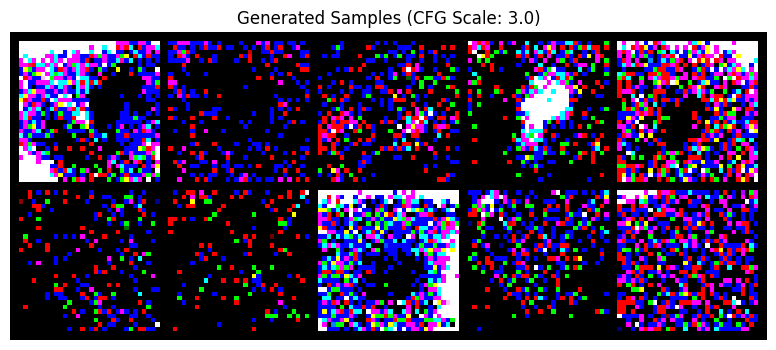

Generation function 'generate_samples' redefined with CFG.

--- Epoch 25/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 25, Step 100/1250, Avg Loss (last 100): 0.0593
  Epoch 25, Step 200/1250, Avg Loss (last 100): 0.0604
  Epoch 25, Step 300/1250, Avg Loss (last 100): 0.0601
  Epoch 25, Step 400/1250, Avg Loss (last 100): 0.0589
  Epoch 25, Step 500/1250, Avg Loss (last 100): 0.0587
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


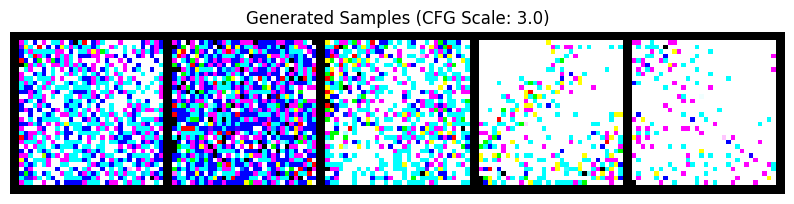

Generation function 'generate_samples' redefined with CFG.
  Epoch 25, Step 600/1250, Avg Loss (last 100): 0.0593
  Epoch 25, Step 700/1250, Avg Loss (last 100): 0.0607
  Epoch 25, Step 800/1250, Avg Loss (last 100): 0.0578
  Epoch 25, Step 900/1250, Avg Loss (last 100): 0.0594
  Epoch 25, Step 1000/1250, Avg Loss (last 100): 0.0627
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


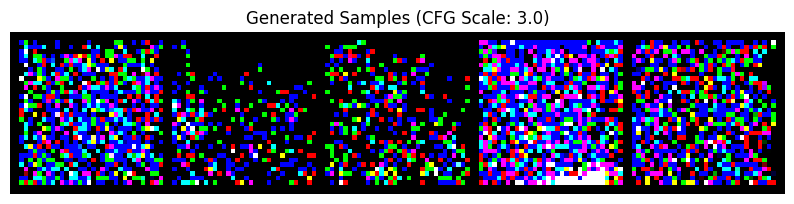

Generation function 'generate_samples' redefined with CFG.
  Epoch 25, Step 1100/1250, Avg Loss (last 100): 0.0602
  Epoch 25, Step 1200/1250, Avg Loss (last 100): 0.0614
Training Finished - Epoch 25 Avg Loss: 0.0600
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 25 Avg Loss: 0.0598
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0598)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth


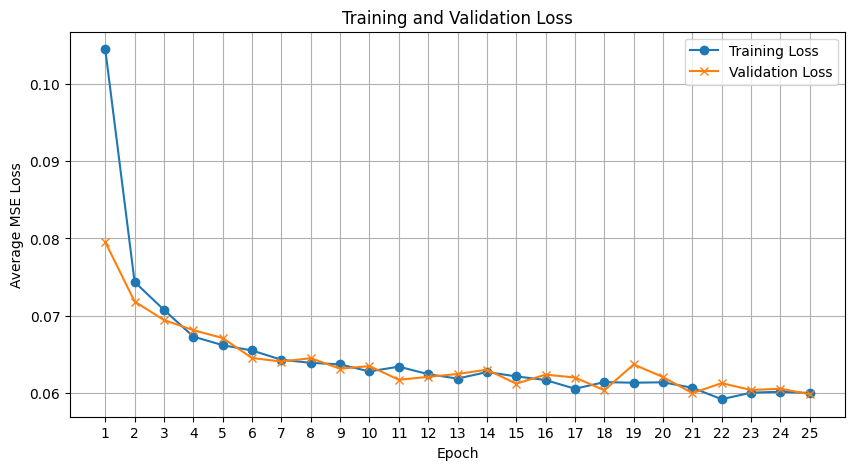


--- Epoch 26/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 26, Step 100/1250, Avg Loss (last 100): 0.0611
  Epoch 26, Step 200/1250, Avg Loss (last 100): 0.0619
  Epoch 26, Step 300/1250, Avg Loss (last 100): 0.0639
  Epoch 26, Step 400/1250, Avg Loss (last 100): 0.0600
  Epoch 26, Step 500/1250, Avg Loss (last 100): 0.0598
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


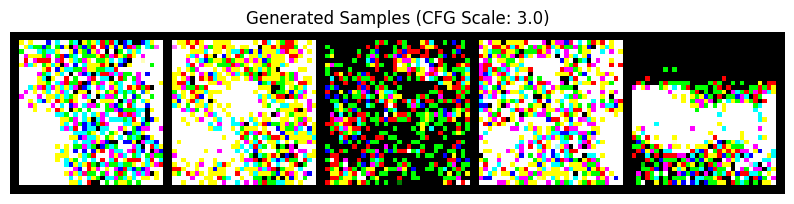

Generation function 'generate_samples' redefined with CFG.
  Epoch 26, Step 600/1250, Avg Loss (last 100): 0.0592
  Epoch 26, Step 700/1250, Avg Loss (last 100): 0.0625
  Epoch 26, Step 800/1250, Avg Loss (last 100): 0.0599
  Epoch 26, Step 900/1250, Avg Loss (last 100): 0.0619
  Epoch 26, Step 1000/1250, Avg Loss (last 100): 0.0612
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


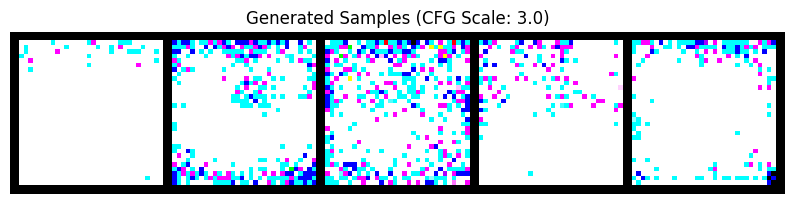

Generation function 'generate_samples' redefined with CFG.
  Epoch 26, Step 1100/1250, Avg Loss (last 100): 0.0596
  Epoch 26, Step 1200/1250, Avg Loss (last 100): 0.0599
Training Finished - Epoch 26 Avg Loss: 0.0609
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 26 Avg Loss: 0.0615
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 26)...
Generating samples with CFG (scale=3.0)...


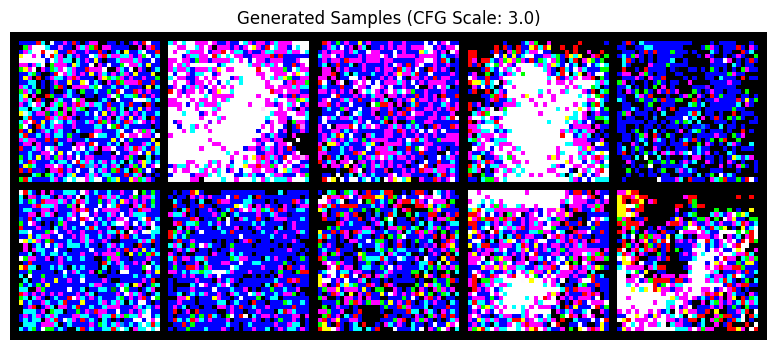

Generation function 'generate_samples' redefined with CFG.

--- Epoch 27/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 27, Step 100/1250, Avg Loss (last 100): 0.0621
  Epoch 27, Step 200/1250, Avg Loss (last 100): 0.0580
  Epoch 27, Step 300/1250, Avg Loss (last 100): 0.0594
  Epoch 27, Step 400/1250, Avg Loss (last 100): 0.0580
  Epoch 27, Step 500/1250, Avg Loss (last 100): 0.0586
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


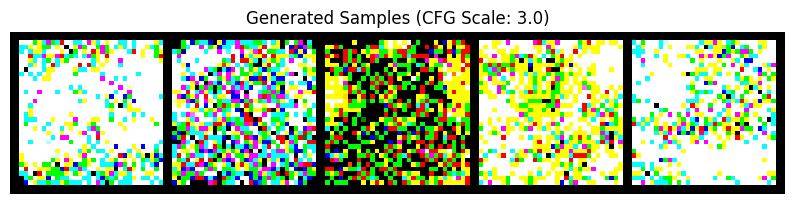

Generation function 'generate_samples' redefined with CFG.
  Epoch 27, Step 600/1250, Avg Loss (last 100): 0.0594
  Epoch 27, Step 700/1250, Avg Loss (last 100): 0.0570
  Epoch 27, Step 800/1250, Avg Loss (last 100): 0.0595
  Epoch 27, Step 900/1250, Avg Loss (last 100): 0.0633
  Epoch 27, Step 1000/1250, Avg Loss (last 100): 0.0623
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


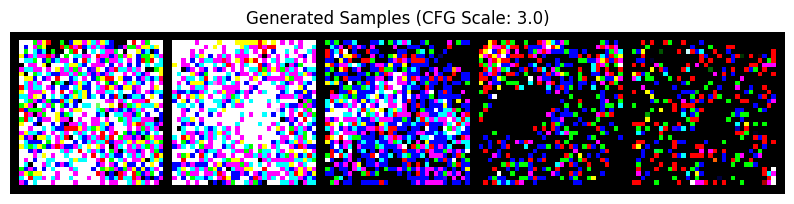

Generation function 'generate_samples' redefined with CFG.
  Epoch 27, Step 1100/1250, Avg Loss (last 100): 0.0590
  Epoch 27, Step 1200/1250, Avg Loss (last 100): 0.0602
Training Finished - Epoch 27 Avg Loss: 0.0598
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 27 Avg Loss: 0.0605
Validation loss did not improve for 2/10 epochs.

--- Epoch 28/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 28, Step 100/1250, Avg Loss (last 100): 0.0607
  Epoch 28, Step 200/1250, Avg Loss (last 100): 0.0591
  Epoch 28, Step 300/1250, Avg Loss (last 100): 0.0613
  Epoch 28, Step 400/1250, Avg Loss (last 100): 0.0583
  Epoch 28, Step 500/1250, Avg Loss (last 100): 0.0614
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


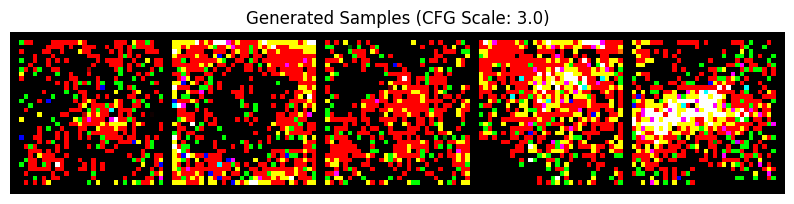

Generation function 'generate_samples' redefined with CFG.
  Epoch 28, Step 600/1250, Avg Loss (last 100): 0.0583
  Epoch 28, Step 700/1250, Avg Loss (last 100): 0.0592
  Epoch 28, Step 800/1250, Avg Loss (last 100): 0.0557
  Epoch 28, Step 900/1250, Avg Loss (last 100): 0.0599
  Epoch 28, Step 1000/1250, Avg Loss (last 100): 0.0585
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


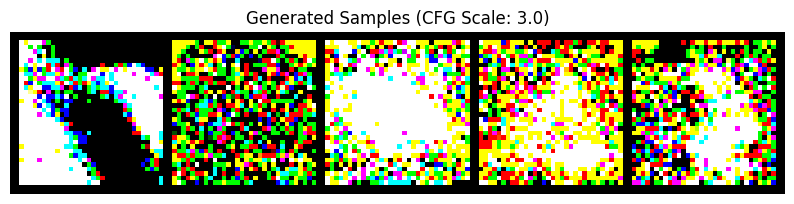

Generation function 'generate_samples' redefined with CFG.
  Epoch 28, Step 1100/1250, Avg Loss (last 100): 0.0598
  Epoch 28, Step 1200/1250, Avg Loss (last 100): 0.0588
Training Finished - Epoch 28 Avg Loss: 0.0593
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 28 Avg Loss: 0.0600
Validation loss did not improve for 3/10 epochs.

Generating samples for visual progress check (Epoch 28)...
Generating samples with CFG (scale=3.0)...


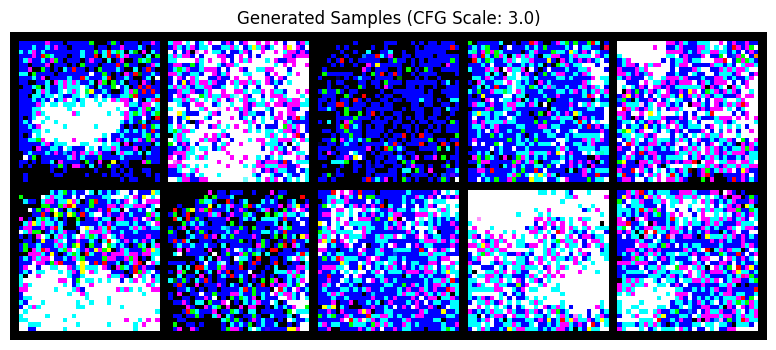

Generation function 'generate_samples' redefined with CFG.

--- Epoch 29/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 29, Step 100/1250, Avg Loss (last 100): 0.0586
  Epoch 29, Step 200/1250, Avg Loss (last 100): 0.0606
  Epoch 29, Step 300/1250, Avg Loss (last 100): 0.0589
  Epoch 29, Step 400/1250, Avg Loss (last 100): 0.0579
  Epoch 29, Step 500/1250, Avg Loss (last 100): 0.0625
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


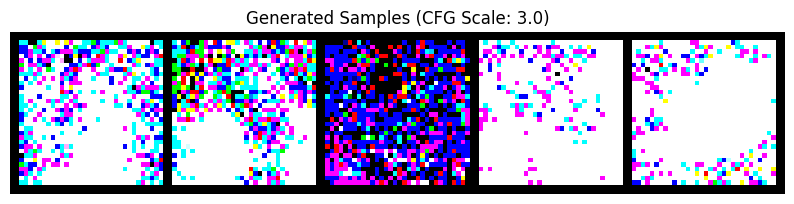

Generation function 'generate_samples' redefined with CFG.
  Epoch 29, Step 600/1250, Avg Loss (last 100): 0.0592
  Epoch 29, Step 700/1250, Avg Loss (last 100): 0.0597
  Epoch 29, Step 800/1250, Avg Loss (last 100): 0.0596
  Epoch 29, Step 900/1250, Avg Loss (last 100): 0.0598
  Epoch 29, Step 1000/1250, Avg Loss (last 100): 0.0620
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


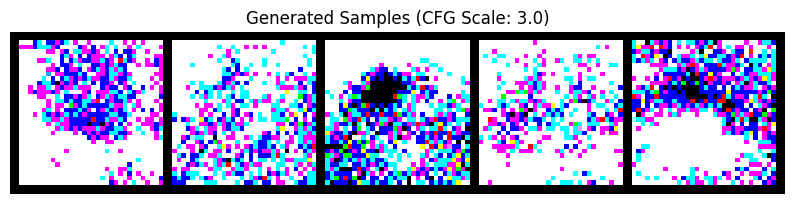

Generation function 'generate_samples' redefined with CFG.
  Epoch 29, Step 1100/1250, Avg Loss (last 100): 0.0594
  Epoch 29, Step 1200/1250, Avg Loss (last 100): 0.0597
Training Finished - Epoch 29 Avg Loss: 0.0597
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 29 Avg Loss: 0.0589
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0589)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 30/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 30, Step 100/1250, Avg Loss (last 100): 0.0595
  Epoch 30, Step 200/1250, Avg Loss (last 100): 0.0572
  Epoch 30, Step 300/1250, Avg Loss (last 100): 0.0614
  Epoch 30, Step 400/1250, Avg Loss (last 100): 0.0577
  Epoch 30, Step 500/1250, Avg Loss (last 100): 0.0604
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


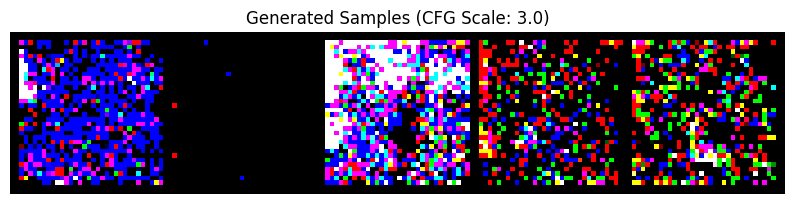

Generation function 'generate_samples' redefined with CFG.
  Epoch 30, Step 600/1250, Avg Loss (last 100): 0.0579
  Epoch 30, Step 700/1250, Avg Loss (last 100): 0.0568
  Epoch 30, Step 800/1250, Avg Loss (last 100): 0.0612
  Epoch 30, Step 900/1250, Avg Loss (last 100): 0.0609
  Epoch 30, Step 1000/1250, Avg Loss (last 100): 0.0589
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


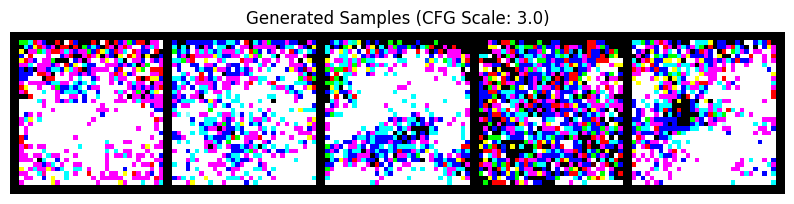

Generation function 'generate_samples' redefined with CFG.
  Epoch 30, Step 1100/1250, Avg Loss (last 100): 0.0574
  Epoch 30, Step 1200/1250, Avg Loss (last 100): 0.0565
Training Finished - Epoch 30 Avg Loss: 0.0591
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 30 Avg Loss: 0.0581
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0581)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 30)...
Generating samples with CFG (scale=3.0)...


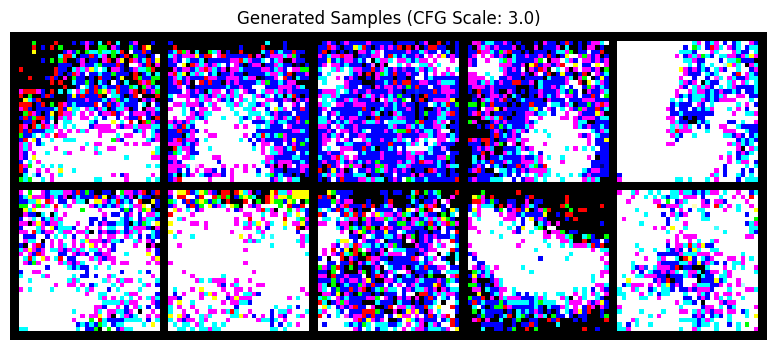

Generation function 'generate_samples' redefined with CFG.


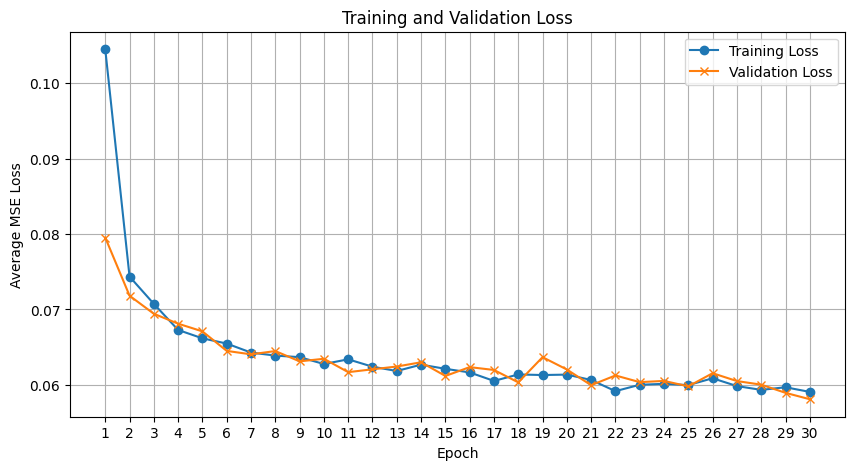


--- Epoch 31/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 31, Step 100/1250, Avg Loss (last 100): 0.0614
  Epoch 31, Step 200/1250, Avg Loss (last 100): 0.0602
  Epoch 31, Step 300/1250, Avg Loss (last 100): 0.0615
  Epoch 31, Step 400/1250, Avg Loss (last 100): 0.0628
  Epoch 31, Step 500/1250, Avg Loss (last 100): 0.0622
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


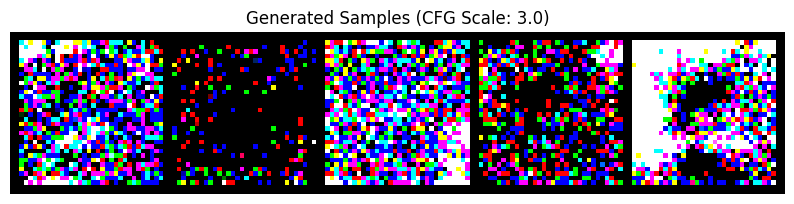

Generation function 'generate_samples' redefined with CFG.
  Epoch 31, Step 600/1250, Avg Loss (last 100): 0.0606
  Epoch 31, Step 700/1250, Avg Loss (last 100): 0.0593
  Epoch 31, Step 800/1250, Avg Loss (last 100): 0.0606
  Epoch 31, Step 900/1250, Avg Loss (last 100): 0.0567
  Epoch 31, Step 1000/1250, Avg Loss (last 100): 0.0582
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


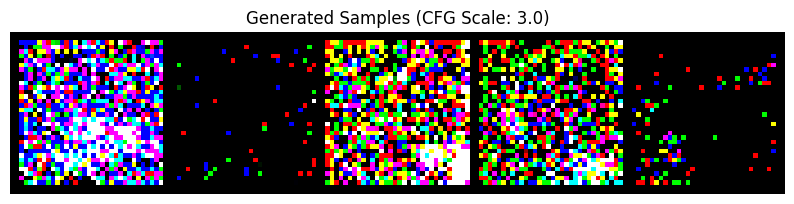

Generation function 'generate_samples' redefined with CFG.
  Epoch 31, Step 1100/1250, Avg Loss (last 100): 0.0592
  Epoch 31, Step 1200/1250, Avg Loss (last 100): 0.0605
Training Finished - Epoch 31 Avg Loss: 0.0602
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 31 Avg Loss: 0.0589
Validation loss did not improve for 1/10 epochs.

--- Epoch 32/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 32, Step 100/1250, Avg Loss (last 100): 0.0613
  Epoch 32, Step 200/1250, Avg Loss (last 100): 0.0617
  Epoch 32, Step 300/1250, Avg Loss (last 100): 0.0584
  Epoch 32, Step 400/1250, Avg Loss (last 100): 0.0578
  Epoch 32, Step 500/1250, Avg Loss (last 100): 0.0601
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


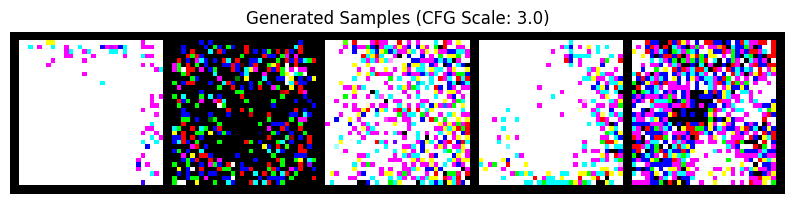

Generation function 'generate_samples' redefined with CFG.
  Epoch 32, Step 600/1250, Avg Loss (last 100): 0.0607
  Epoch 32, Step 700/1250, Avg Loss (last 100): 0.0584
  Epoch 32, Step 800/1250, Avg Loss (last 100): 0.0563
  Epoch 32, Step 900/1250, Avg Loss (last 100): 0.0592
  Epoch 32, Step 1000/1250, Avg Loss (last 100): 0.0583
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


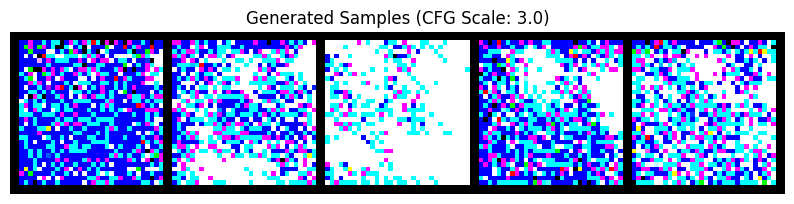

Generation function 'generate_samples' redefined with CFG.
  Epoch 32, Step 1100/1250, Avg Loss (last 100): 0.0602
  Epoch 32, Step 1200/1250, Avg Loss (last 100): 0.0615
Training Finished - Epoch 32 Avg Loss: 0.0598
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 32 Avg Loss: 0.0595
Validation loss did not improve for 2/10 epochs.

Generating samples for visual progress check (Epoch 32)...
Generating samples with CFG (scale=3.0)...


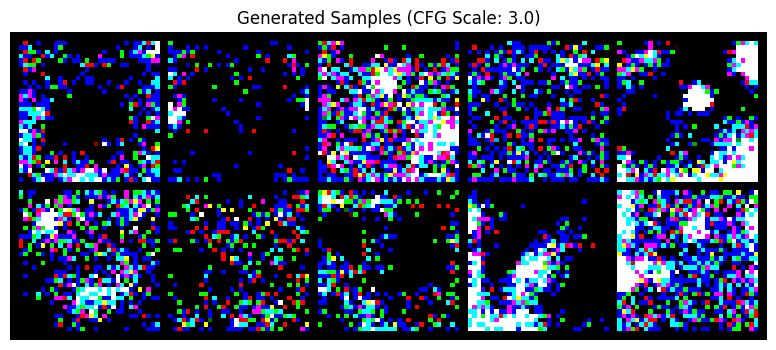

Generation function 'generate_samples' redefined with CFG.

--- Epoch 33/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 33, Step 100/1250, Avg Loss (last 100): 0.0595
  Epoch 33, Step 200/1250, Avg Loss (last 100): 0.0595
  Epoch 33, Step 300/1250, Avg Loss (last 100): 0.0568
  Epoch 33, Step 400/1250, Avg Loss (last 100): 0.0588
  Epoch 33, Step 500/1250, Avg Loss (last 100): 0.0599
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


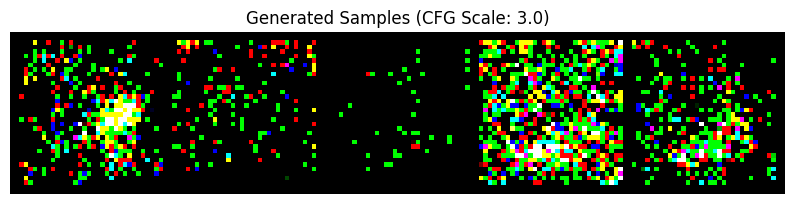

Generation function 'generate_samples' redefined with CFG.
  Epoch 33, Step 600/1250, Avg Loss (last 100): 0.0605
  Epoch 33, Step 700/1250, Avg Loss (last 100): 0.0603
  Epoch 33, Step 800/1250, Avg Loss (last 100): 0.0584
  Epoch 33, Step 900/1250, Avg Loss (last 100): 0.0604
  Epoch 33, Step 1000/1250, Avg Loss (last 100): 0.0582
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


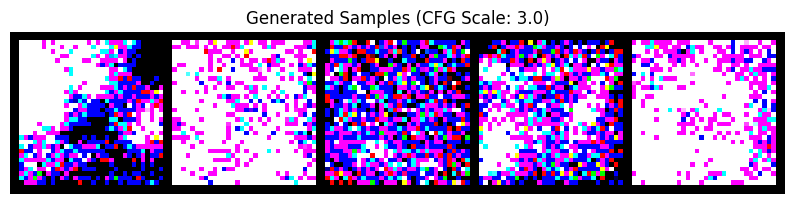

Generation function 'generate_samples' redefined with CFG.
  Epoch 33, Step 1100/1250, Avg Loss (last 100): 0.0601
  Epoch 33, Step 1200/1250, Avg Loss (last 100): 0.0583
Training Finished - Epoch 33 Avg Loss: 0.0592
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 33 Avg Loss: 0.0601
Validation loss did not improve for 3/10 epochs.

--- Epoch 34/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 34, Step 100/1250, Avg Loss (last 100): 0.0609
  Epoch 34, Step 200/1250, Avg Loss (last 100): 0.0602
  Epoch 34, Step 300/1250, Avg Loss (last 100): 0.0605
  Epoch 34, Step 400/1250, Avg Loss (last 100): 0.0606
  Epoch 34, Step 500/1250, Avg Loss (last 100): 0.0582
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


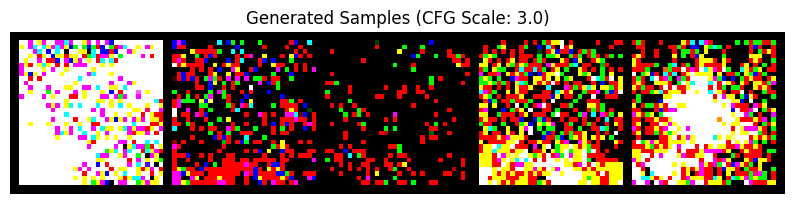

Generation function 'generate_samples' redefined with CFG.
  Epoch 34, Step 600/1250, Avg Loss (last 100): 0.0581
  Epoch 34, Step 700/1250, Avg Loss (last 100): 0.0602
  Epoch 34, Step 800/1250, Avg Loss (last 100): 0.0571
  Epoch 34, Step 900/1250, Avg Loss (last 100): 0.0603
  Epoch 34, Step 1000/1250, Avg Loss (last 100): 0.0608
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


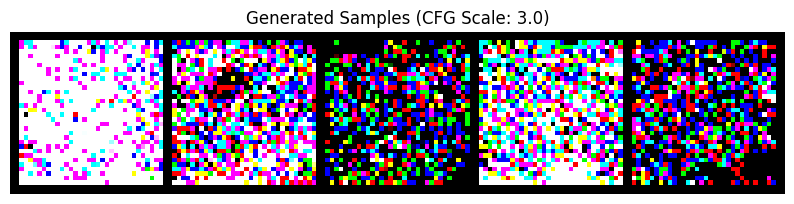

Generation function 'generate_samples' redefined with CFG.
  Epoch 34, Step 1100/1250, Avg Loss (last 100): 0.0616
  Epoch 34, Step 1200/1250, Avg Loss (last 100): 0.0599
Training Finished - Epoch 34 Avg Loss: 0.0599
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 34 Avg Loss: 0.0593
Validation loss did not improve for 4/10 epochs.

Generating samples for visual progress check (Epoch 34)...
Generating samples with CFG (scale=3.0)...


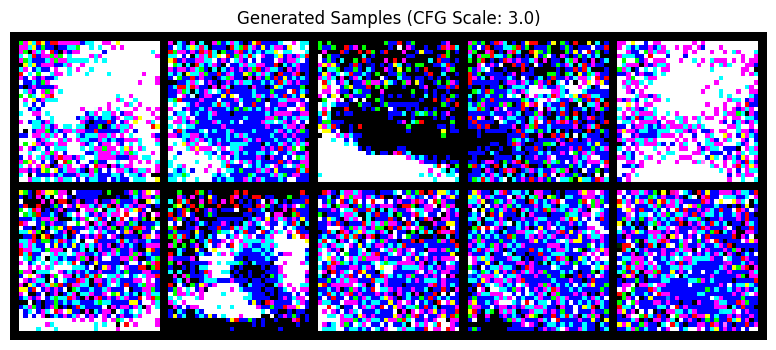

Generation function 'generate_samples' redefined with CFG.

--- Epoch 35/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 35, Step 100/1250, Avg Loss (last 100): 0.0597
  Epoch 35, Step 200/1250, Avg Loss (last 100): 0.0588
  Epoch 35, Step 300/1250, Avg Loss (last 100): 0.0606
  Epoch 35, Step 400/1250, Avg Loss (last 100): 0.0571
  Epoch 35, Step 500/1250, Avg Loss (last 100): 0.0566
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


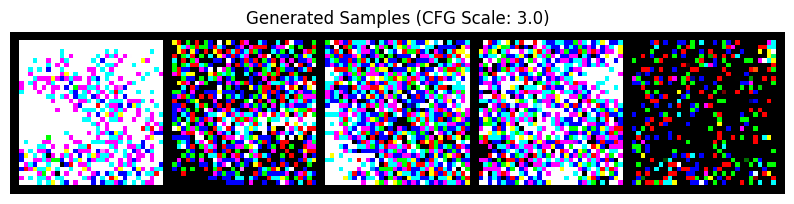

Generation function 'generate_samples' redefined with CFG.
  Epoch 35, Step 600/1250, Avg Loss (last 100): 0.0583
  Epoch 35, Step 700/1250, Avg Loss (last 100): 0.0601
  Epoch 35, Step 800/1250, Avg Loss (last 100): 0.0589
  Epoch 35, Step 900/1250, Avg Loss (last 100): 0.0611
  Epoch 35, Step 1000/1250, Avg Loss (last 100): 0.0582
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


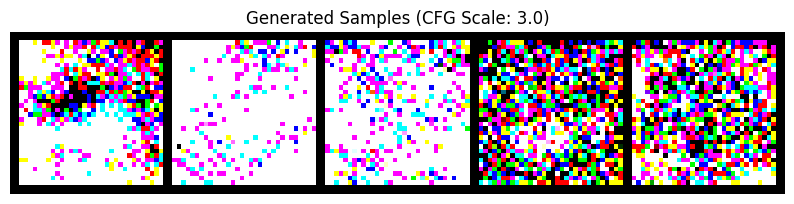

Generation function 'generate_samples' redefined with CFG.
  Epoch 35, Step 1100/1250, Avg Loss (last 100): 0.0596
  Epoch 35, Step 1200/1250, Avg Loss (last 100): 0.0598
Training Finished - Epoch 35 Avg Loss: 0.0591
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 35 Avg Loss: 0.0586
Validation loss did not improve for 5/10 epochs.


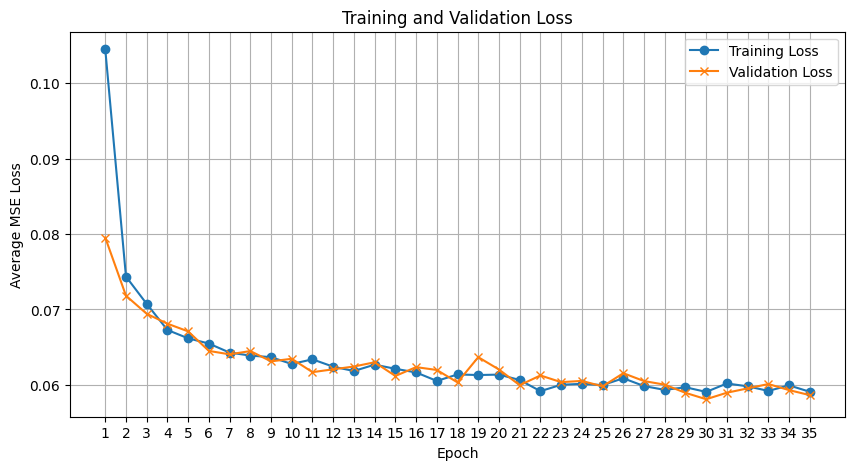


--- Epoch 36/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 36, Step 100/1250, Avg Loss (last 100): 0.0610
  Epoch 36, Step 200/1250, Avg Loss (last 100): 0.0590
  Epoch 36, Step 300/1250, Avg Loss (last 100): 0.0576
  Epoch 36, Step 400/1250, Avg Loss (last 100): 0.0567
  Epoch 36, Step 500/1250, Avg Loss (last 100): 0.0609
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


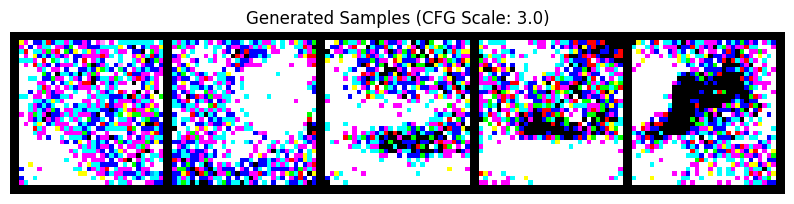

Generation function 'generate_samples' redefined with CFG.
  Epoch 36, Step 600/1250, Avg Loss (last 100): 0.0568
  Epoch 36, Step 700/1250, Avg Loss (last 100): 0.0583
  Epoch 36, Step 800/1250, Avg Loss (last 100): 0.0569
  Epoch 36, Step 900/1250, Avg Loss (last 100): 0.0587
  Epoch 36, Step 1000/1250, Avg Loss (last 100): 0.0575
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


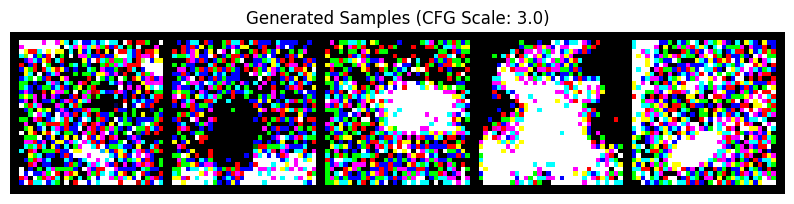

Generation function 'generate_samples' redefined with CFG.
  Epoch 36, Step 1100/1250, Avg Loss (last 100): 0.0606
  Epoch 36, Step 1200/1250, Avg Loss (last 100): 0.0589
Training Finished - Epoch 36 Avg Loss: 0.0587
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 36 Avg Loss: 0.0593
Validation loss did not improve for 6/10 epochs.

Generating samples for visual progress check (Epoch 36)...
Generating samples with CFG (scale=3.0)...


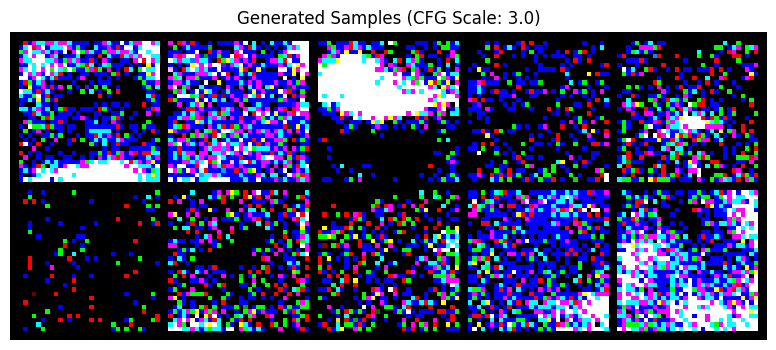

Generation function 'generate_samples' redefined with CFG.

--- Epoch 37/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 37, Step 100/1250, Avg Loss (last 100): 0.0564
  Epoch 37, Step 200/1250, Avg Loss (last 100): 0.0556
  Epoch 37, Step 300/1250, Avg Loss (last 100): 0.0579
  Epoch 37, Step 400/1250, Avg Loss (last 100): 0.0588
  Epoch 37, Step 500/1250, Avg Loss (last 100): 0.0589
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


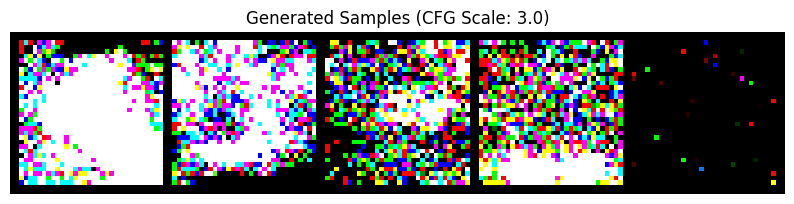

Generation function 'generate_samples' redefined with CFG.
  Epoch 37, Step 600/1250, Avg Loss (last 100): 0.0583
  Epoch 37, Step 700/1250, Avg Loss (last 100): 0.0545
  Epoch 37, Step 800/1250, Avg Loss (last 100): 0.0592
  Epoch 37, Step 900/1250, Avg Loss (last 100): 0.0592
  Epoch 37, Step 1000/1250, Avg Loss (last 100): 0.0580
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


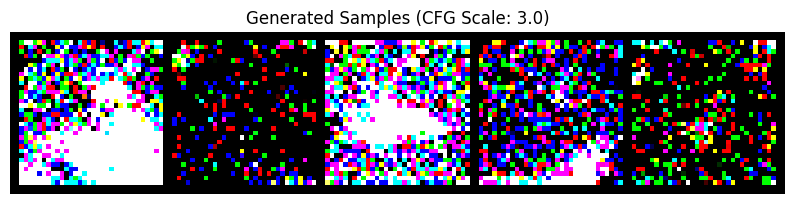

Generation function 'generate_samples' redefined with CFG.
  Epoch 37, Step 1100/1250, Avg Loss (last 100): 0.0582
  Epoch 37, Step 1200/1250, Avg Loss (last 100): 0.0575
Training Finished - Epoch 37 Avg Loss: 0.0579
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 37 Avg Loss: 0.0583
Validation loss did not improve for 7/10 epochs.

--- Epoch 38/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 38, Step 100/1250, Avg Loss (last 100): 0.0595
  Epoch 38, Step 200/1250, Avg Loss (last 100): 0.0598
  Epoch 38, Step 300/1250, Avg Loss (last 100): 0.0590
  Epoch 38, Step 400/1250, Avg Loss (last 100): 0.0600
  Epoch 38, Step 500/1250, Avg Loss (last 100): 0.0557
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


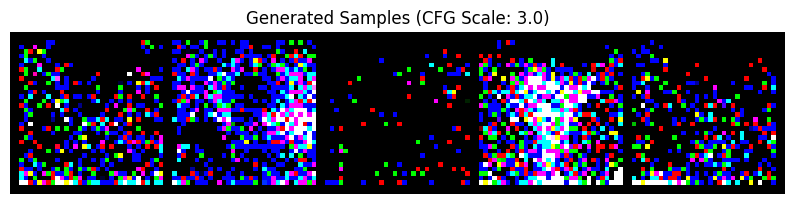

Generation function 'generate_samples' redefined with CFG.
  Epoch 38, Step 600/1250, Avg Loss (last 100): 0.0587
  Epoch 38, Step 700/1250, Avg Loss (last 100): 0.0561
  Epoch 38, Step 800/1250, Avg Loss (last 100): 0.0567
  Epoch 38, Step 900/1250, Avg Loss (last 100): 0.0560
  Epoch 38, Step 1000/1250, Avg Loss (last 100): 0.0581
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


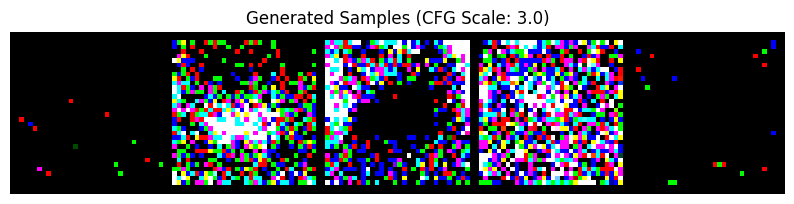

Generation function 'generate_samples' redefined with CFG.
  Epoch 38, Step 1100/1250, Avg Loss (last 100): 0.0577
  Epoch 38, Step 1200/1250, Avg Loss (last 100): 0.0588
Training Finished - Epoch 38 Avg Loss: 0.0579
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 38 Avg Loss: 0.0576
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0576)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 38)...
Generating samples with CFG (scale=3.0)...


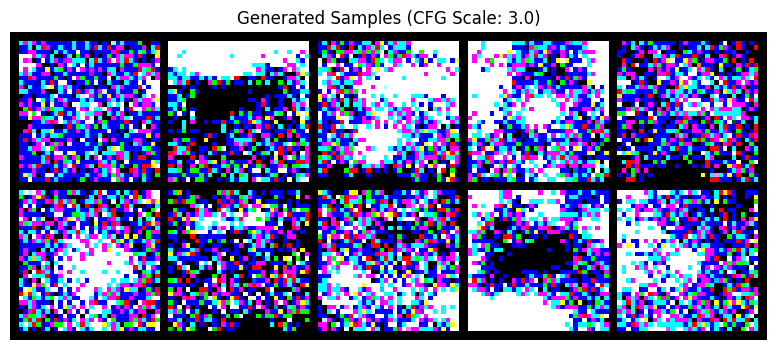

Generation function 'generate_samples' redefined with CFG.

--- Epoch 39/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 39, Step 100/1250, Avg Loss (last 100): 0.0587
  Epoch 39, Step 200/1250, Avg Loss (last 100): 0.0610
  Epoch 39, Step 300/1250, Avg Loss (last 100): 0.0594
  Epoch 39, Step 400/1250, Avg Loss (last 100): 0.0562
  Epoch 39, Step 500/1250, Avg Loss (last 100): 0.0577
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


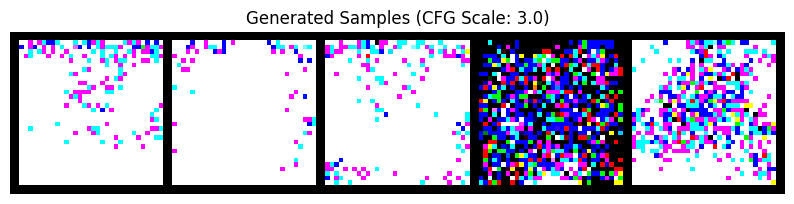

Generation function 'generate_samples' redefined with CFG.
  Epoch 39, Step 600/1250, Avg Loss (last 100): 0.0590
  Epoch 39, Step 700/1250, Avg Loss (last 100): 0.0561
  Epoch 39, Step 800/1250, Avg Loss (last 100): 0.0575
  Epoch 39, Step 900/1250, Avg Loss (last 100): 0.0577
  Epoch 39, Step 1000/1250, Avg Loss (last 100): 0.0569
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


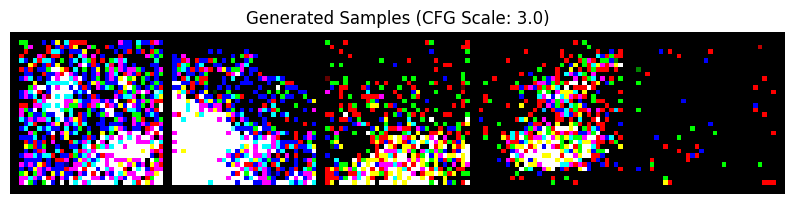

Generation function 'generate_samples' redefined with CFG.
  Epoch 39, Step 1100/1250, Avg Loss (last 100): 0.0588
  Epoch 39, Step 1200/1250, Avg Loss (last 100): 0.0593
Training Finished - Epoch 39 Avg Loss: 0.0583
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 39 Avg Loss: 0.0590
Validation loss did not improve for 1/10 epochs.

--- Epoch 40/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 40, Step 100/1250, Avg Loss (last 100): 0.0628
  Epoch 40, Step 200/1250, Avg Loss (last 100): 0.0553
  Epoch 40, Step 300/1250, Avg Loss (last 100): 0.0602
  Epoch 40, Step 400/1250, Avg Loss (last 100): 0.0577
  Epoch 40, Step 500/1250, Avg Loss (last 100): 0.0593
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


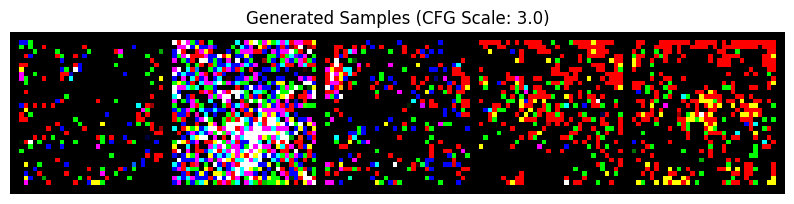

Generation function 'generate_samples' redefined with CFG.
  Epoch 40, Step 600/1250, Avg Loss (last 100): 0.0629
  Epoch 40, Step 700/1250, Avg Loss (last 100): 0.0604
  Epoch 40, Step 800/1250, Avg Loss (last 100): 0.0584
  Epoch 40, Step 900/1250, Avg Loss (last 100): 0.0570
  Epoch 40, Step 1000/1250, Avg Loss (last 100): 0.0594
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


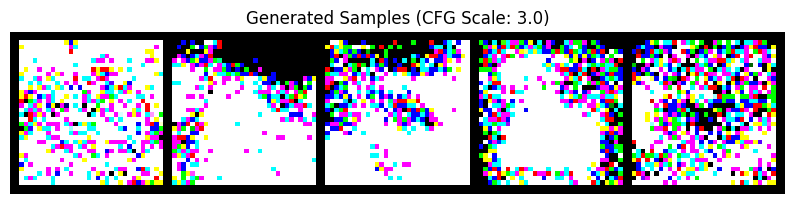

Generation function 'generate_samples' redefined with CFG.
  Epoch 40, Step 1100/1250, Avg Loss (last 100): 0.0571
  Epoch 40, Step 1200/1250, Avg Loss (last 100): 0.0577
Training Finished - Epoch 40 Avg Loss: 0.0590
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 40 Avg Loss: 0.0591
Validation loss did not improve for 2/10 epochs.

Generating samples for visual progress check (Epoch 40)...
Generating samples with CFG (scale=3.0)...


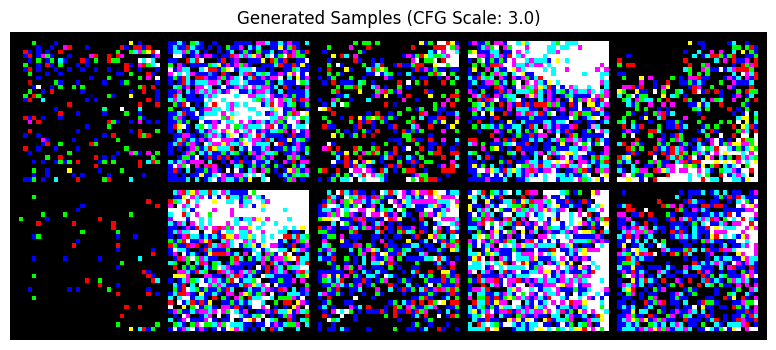

Generation function 'generate_samples' redefined with CFG.


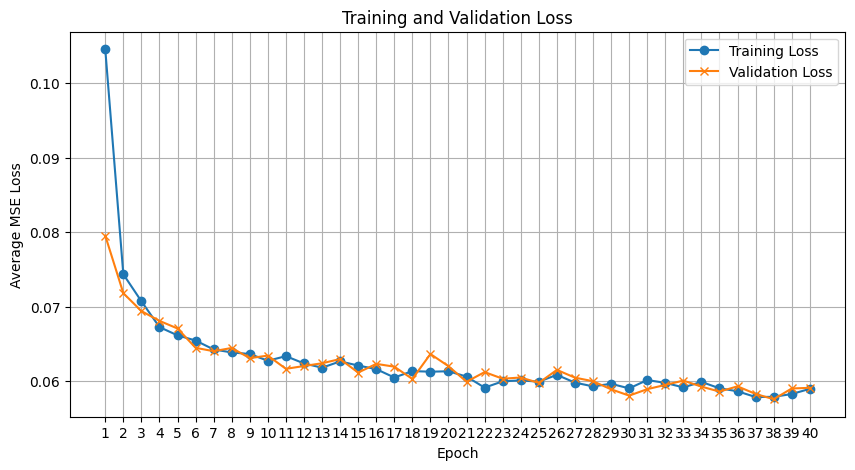


--- Epoch 41/50 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 41, Step 100/1250, Avg Loss (last 100): 0.0558
  Epoch 41, Step 200/1250, Avg Loss (last 100): 0.0573
  Epoch 41, Step 300/1250, Avg Loss (last 100): 0.0604
  Epoch 41, Step 400/1250, Avg Loss (last 100): 0.0600
  Epoch 41, Step 500/1250, Avg Loss (last 100): 0.0598
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...

--- Training interrupted by user ---

TRAINING PROCESS COMPLETE
Best validation loss achieved: 0.0576
Loading best model weights for final sample generation...
Best model loaded.
Generating final samples from best model...
Generating samples with CFG (scale=3.0)...


KeyboardInterrupt: 

In [ ]:
# --- Main Training Loop (Using User Template Structure) ---

# Ensure tqdm is imported
try:
    from tqdm.notebook import tqdm
except ImportError:
    try:
        from tqdm import tqdm
    except ImportError:
        print("Warning: tqdm not installed. Progress bars will not be shown.")
        # Define a dummy tqdm if not installed
        def tqdm(iterable, *args, **kwargs):
            return iterable

# Progress tracking variables
best_loss = float('inf')
train_losses = []
val_losses = []
no_improve_epochs = 0

# Training loop
print("\n" + "="*50)
print("STARTING TRAINING (with CFG, Cosine Schedule)")
print(f"Epochs: {EPOCHS}, Batch Size: {BATCH_SIZE}, Steps: {N_STEPS}")
print(f"Device: {device}")
print("="*50)

# Wrap the training loop in a try-except block
try:
    for epoch in range(EPOCHS):
        print(f"\n--- Epoch {epoch+1}/{EPOCHS} ---")

        # === Training phase ===
        model.train() # Set model to training mode
        epoch_train_losses = [] # Store losses for this epoch

        # Use tqdm for the training loader
        pbar_train = tqdm(enumerate(train_load), total=len(train_load), desc="Training", leave=False)

        for step, (images, labels) in pbar_train:
            images = images.to(device)
            labels = labels.to(device)

            # --- Training step ---
            optimizer.zero_grad() # Zero gradients before calculating loss

            # Calculate loss using the modified train_step (returns tensor)
            loss = train_step(images, labels)

            # Perform backpropagation
            loss.backward()

            # Apply gradient clipping
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip_value)

            # Update model weights
            optimizer.step()
            # ---------------------

            current_loss_item = loss.item()
            epoch_train_losses.append(current_loss_item)

            # Update progress bar description
            pbar_train.set_postfix(Loss=f"{current_loss_item:.4f}")

            # Show progress less frequently (using display_frequency)
            if (step + 1) % display_frequency == 0:
                 avg_recent_loss = sum(epoch_train_losses[-display_frequency:]) / len(epoch_train_losses[-display_frequency:])
                 print(f"  Epoch {epoch+1}, Step {step+1}/{len(train_load)}, Avg Loss (last {display_frequency}): {avg_recent_loss:.4f}")

            # Generate samples less frequently (using generate_frequency)
            # Ensure generate_samples function exists and works as expected
            if (step + 1) % generate_frequency == 0 and step > 0:
                 try:
                     print(f"  Generating samples at step {step+1}...")
                     # Call the generate_samples redefined earlier (includes CFG)
                     generate_samples(model, n_samples=5, cfg_scale=3.0)
                     model.train() # Ensure model is back in train mode after generation
                 except NameError:
                     print("  'generate_samples' function not found, skipping sample generation.")
                 except Exception as e:
                     print(f"  Error during sample generation: {e}")
                     model.train() # Ensure model is back in train mode

        # End of training epoch - calculate average training loss
        avg_train_loss = sum(epoch_train_losses) / len(epoch_train_losses)
        train_losses.append(avg_train_loss)
        print(f"Training Finished - Epoch {epoch+1} Avg Loss: {avg_train_loss:.4f}")

        # === Validation phase ===
        model.eval() # Set model to evaluation mode
        val_epoch_losses = []
        print("Running validation...")

        # Use tqdm for the validation loader
        pbar_val = tqdm(val_load, desc="Validation", leave=False)

        # No gradients needed for validation
        with torch.no_grad():
            for val_images, val_labels in pbar_val:
                val_images = val_images.to(device)
                val_labels = val_labels.to(device)

                # Calculate validation loss using the new function
                val_loss_item = calculate_val_loss(model, val_images, val_labels)
                val_epoch_losses.append(val_loss_item)
                pbar_val.set_postfix(Loss=f"{val_loss_item:.4f}")

        # Calculate average validation loss for the epoch
        avg_val_loss = sum(val_epoch_losses) / len(val_epoch_losses)
        val_losses.append(avg_val_loss)
        print(f"Validation Finished - Epoch {epoch+1} Avg Loss: {avg_val_loss:.4f}")

        # === LR Scheduling, Saving, Early Stopping ===

        # Update Learning Rate based on validation loss
        scheduler.step(avg_val_loss)
        current_lr = optimizer.param_groups[0]['lr']
        # Check if LR changed
        # Note: ReduceLROnPlateau might not change LR every epoch
        # print(f"Current learning rate: {current_lr:.6f}") # Optional: print LR every epoch

        # Save the best model based on validation loss
        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            # Ensure safe_save_model function exists
            try:
                 print(f"✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: {best_loss:.4f})")
                 safe_save_model(model, 'best_diffusion_model_cfg_cosine.pth', optimizer, epoch, best_loss)
            except NameError:
                 print("  'safe_save_model' not found, using basic torch.save.")
                 torch.save({
                     'epoch': epoch,
                     'model_state_dict': model.state_dict(),
                     'optimizer_state_dict': optimizer.state_dict(),
                     'best_loss': best_loss,
                 }, 'best_diffusion_model_cfg_cosine.pth')
            no_improve_epochs = 0 # Reset counter
        else:
            no_improve_epochs += 1
            print(f"Validation loss did not improve for {no_improve_epochs}/{early_stopping_patience} epochs.")

        # Check for early stopping
        if no_improve_epochs >= early_stopping_patience:
            print(f"\nEarly stopping triggered after {epoch+1} epochs due to no improvement in validation loss.")
            break # Exit the training loop

        # Generate samples at the end of every few epochs (e.g., every 2 epochs)
        if (epoch + 1) % 2 == 0 or epoch == EPOCHS - 1:
             try:
                 print(f"\nGenerating samples for visual progress check (Epoch {epoch+1})...")
                 generate_samples(model, n_samples=10, cfg_scale=3.0) # Use CFG version
                 model.train() # Back to train mode
             except NameError:
                 print("  'generate_samples' function not found.")
             except Exception as e:
                 print(f"  Error during sample generation: {e}")
                 model.train()

        # Plot loss curves periodically (e.g., every 5 epochs)
        if (epoch + 1) % 5 == 0 or epoch == EPOCHS - 1:
             try:
                 plt.figure(figsize=(10, 5))
                 plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss', marker='o')
                 plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss', marker='x')
                 plt.xlabel('Epoch')
                 plt.ylabel('Average MSE Loss')
                 plt.title('Training and Validation Loss')
                 plt.legend()
                 plt.grid(True)
                 plt.xticks(range(1, len(train_losses) + 1)) # Ensure integer ticks for epochs
                 plt.show()
             except NameError:
                 print("matplotlib.pyplot not imported as plt, cannot plot losses.")
             except Exception as e:
                 print(f"Error plotting losses: {e}")


# === End of Training Loop ===
except KeyboardInterrupt:
    print("\n--- Training interrupted by user ---")
except Exception as e:
    print(f"\n--- An error occurred during training: {e} ---")
    import traceback
    traceback.print_exc() # Print detailed traceback

# ––– Final wrap-up ––––––––––––––––––––––––––––––––––––––––––––––––––––––––––
print("\n" + "="*50)
print("TRAINING PROCESS COMPLETE")
print("="*50)
print(f"Best validation loss achieved: {best_loss:.4f}")

# Generate final samples using the *best* model weights if saved
try:
    print("Loading best model weights for final sample generation...")
    checkpoint = torch.load('best_diffusion_model_cfg_cosine.pth', map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    print("Best model loaded.")

    print("Generating final samples from best model...")
    generate_samples(model, n_samples=10, cfg_scale=3.0) # Use CFG version
except FileNotFoundError:
    print("Best model checkpoint not found. Generating samples from final model state.")
    print("Generating final samples...")
    generate_samples(model, n_samples=10, cfg_scale=3.0) # Use CFG version
except Exception as e:
    print(f"Could not load best model or generate final samples: {e}")

# Display final loss curves if training completed some epochs
if train_losses and val_losses:
    try:
        print("Displaying final loss curves...")
        plt.figure(figsize=(12, 5))
        plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss', marker='o')
        plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss', marker='x')
        plt.xlabel('Epoch')
        plt.ylabel('Average MSE Loss')
        plt.title('Final Training and Validation Loss')
        plt.legend()
        plt.grid(True)
        plt.xticks(range(1, len(train_losses) + 1))
        plt.show()
    except NameError:
        print("matplotlib.pyplot not imported as plt, cannot plot final losses.")
    except Exception as e:
        print(f"Error plotting final losses: {e}")

# Clean up memory (optional, useful in environments like Colab)
import gc
gc.collect() # Run garbage collection
torch.cuda.empty_cache() # Clear PyTorch's CUDA cache


### LAST LAST TIME


STARTING TRAINING (with CFG, Cosine Schedule)
Epochs: 15, Batch Size: 32, Steps: 1000
Device: cuda

--- Epoch 1/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 1, Step 100/1250, Avg Loss (last 100): 0.2460
  Epoch 1, Step 200/1250, Avg Loss (last 100): 0.1174
  Epoch 1, Step 300/1250, Avg Loss (last 100): 0.1122
  Epoch 1, Step 400/1250, Avg Loss (last 100): 0.0971
  Epoch 1, Step 500/1250, Avg Loss (last 100): 0.0941
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


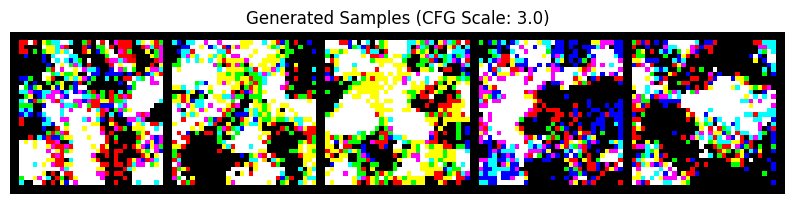

Generation function 'generate_samples' redefined with CFG.
  Epoch 1, Step 600/1250, Avg Loss (last 100): 0.0910
  Epoch 1, Step 700/1250, Avg Loss (last 100): 0.0865
  Epoch 1, Step 800/1250, Avg Loss (last 100): 0.0876
  Epoch 1, Step 900/1250, Avg Loss (last 100): 0.0865
  Epoch 1, Step 1000/1250, Avg Loss (last 100): 0.0798
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


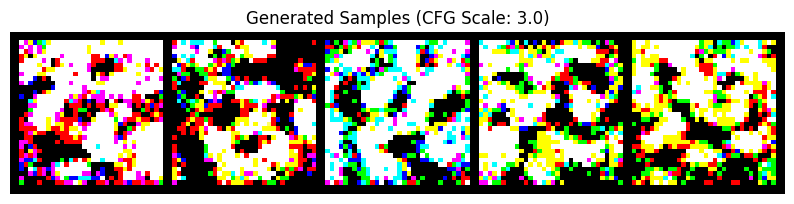

Generation function 'generate_samples' redefined with CFG.
  Epoch 1, Step 1100/1250, Avg Loss (last 100): 0.0849
  Epoch 1, Step 1200/1250, Avg Loss (last 100): 0.0841
Training Finished - Epoch 1 Avg Loss: 0.1045
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 1 Avg Loss: 0.0795
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0795)
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 2/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 2, Step 100/1250, Avg Loss (last 100): 0.0763
  Epoch 2, Step 200/1250, Avg Loss (last 100): 0.0765
  Epoch 2, Step 300/1250, Avg Loss (last 100): 0.0774
  Epoch 2, Step 400/1250, Avg Loss (last 100): 0.0770
  Epoch 2, Step 500/1250, Avg Loss (last 100): 0.0737
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


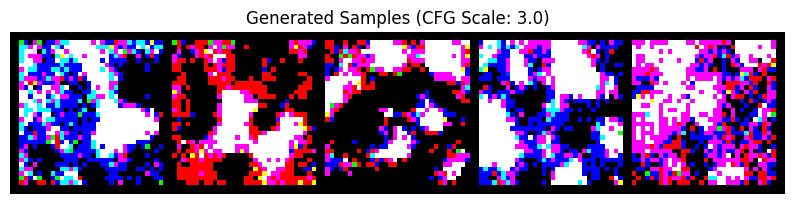

Generation function 'generate_samples' redefined with CFG.
  Epoch 2, Step 600/1250, Avg Loss (last 100): 0.0749
  Epoch 2, Step 700/1250, Avg Loss (last 100): 0.0746
  Epoch 2, Step 800/1250, Avg Loss (last 100): 0.0745
  Epoch 2, Step 900/1250, Avg Loss (last 100): 0.0749
  Epoch 2, Step 1000/1250, Avg Loss (last 100): 0.0704
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


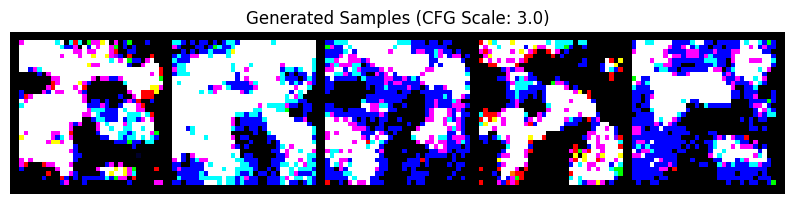

Generation function 'generate_samples' redefined with CFG.
  Epoch 2, Step 1100/1250, Avg Loss (last 100): 0.0722
  Epoch 2, Step 1200/1250, Avg Loss (last 100): 0.0726
Training Finished - Epoch 2 Avg Loss: 0.0744
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 2 Avg Loss: 0.0718
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0718)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 2)...
Generating samples with CFG (scale=3.0)...


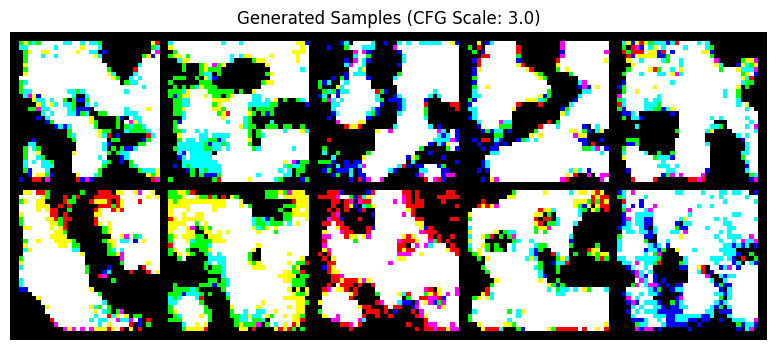

Generation function 'generate_samples' redefined with CFG.

--- Epoch 3/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 3, Step 100/1250, Avg Loss (last 100): 0.0744
  Epoch 3, Step 200/1250, Avg Loss (last 100): 0.0755
  Epoch 3, Step 300/1250, Avg Loss (last 100): 0.0711
  Epoch 3, Step 400/1250, Avg Loss (last 100): 0.0680
  Epoch 3, Step 500/1250, Avg Loss (last 100): 0.0677
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


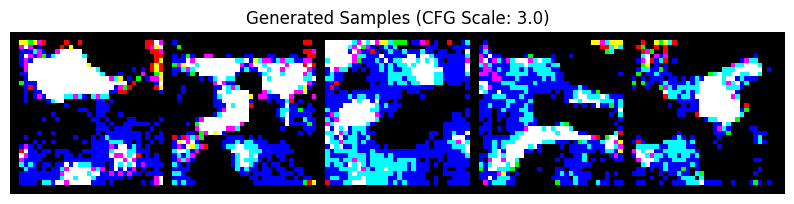

Generation function 'generate_samples' redefined with CFG.
  Epoch 3, Step 600/1250, Avg Loss (last 100): 0.0683
  Epoch 3, Step 700/1250, Avg Loss (last 100): 0.0736
  Epoch 3, Step 800/1250, Avg Loss (last 100): 0.0704
  Epoch 3, Step 900/1250, Avg Loss (last 100): 0.0715
  Epoch 3, Step 1000/1250, Avg Loss (last 100): 0.0704
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


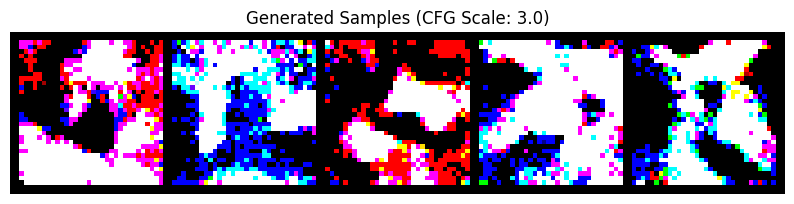

Generation function 'generate_samples' redefined with CFG.
  Epoch 3, Step 1100/1250, Avg Loss (last 100): 0.0696
  Epoch 3, Step 1200/1250, Avg Loss (last 100): 0.0694
Training Finished - Epoch 3 Avg Loss: 0.0707
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 3 Avg Loss: 0.0694
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0694)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 4/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 4, Step 100/1250, Avg Loss (last 100): 0.0669
  Epoch 4, Step 200/1250, Avg Loss (last 100): 0.0698
  Epoch 4, Step 300/1250, Avg Loss (last 100): 0.0687
  Epoch 4, Step 400/1250, Avg Loss (last 100): 0.0675
  Epoch 4, Step 500/1250, Avg Loss (last 100): 0.0669
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


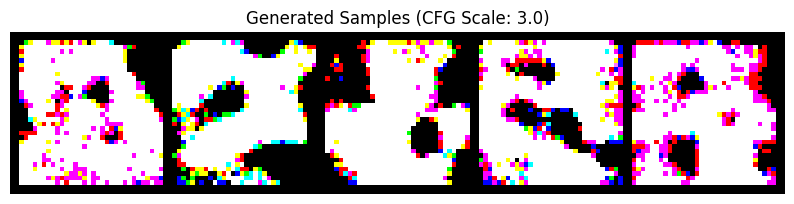

Generation function 'generate_samples' redefined with CFG.
  Epoch 4, Step 600/1250, Avg Loss (last 100): 0.0675
  Epoch 4, Step 700/1250, Avg Loss (last 100): 0.0675
  Epoch 4, Step 800/1250, Avg Loss (last 100): 0.0659
  Epoch 4, Step 900/1250, Avg Loss (last 100): 0.0664
  Epoch 4, Step 1000/1250, Avg Loss (last 100): 0.0657
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


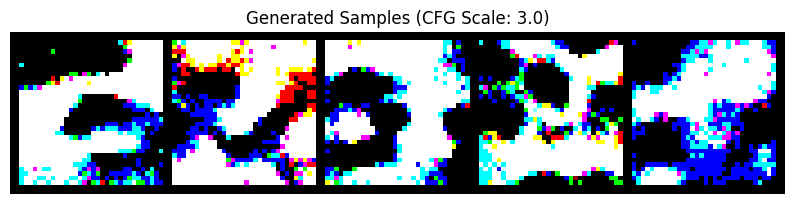

Generation function 'generate_samples' redefined with CFG.
  Epoch 4, Step 1100/1250, Avg Loss (last 100): 0.0645
  Epoch 4, Step 1200/1250, Avg Loss (last 100): 0.0685
Training Finished - Epoch 4 Avg Loss: 0.0673
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 4 Avg Loss: 0.0681
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0681)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 4)...
Generating samples with CFG (scale=3.0)...


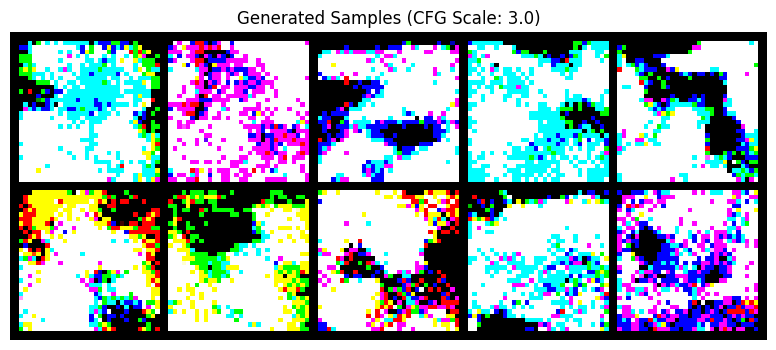

Generation function 'generate_samples' redefined with CFG.

--- Epoch 5/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 5, Step 100/1250, Avg Loss (last 100): 0.0653
  Epoch 5, Step 200/1250, Avg Loss (last 100): 0.0657
  Epoch 5, Step 300/1250, Avg Loss (last 100): 0.0652
  Epoch 5, Step 400/1250, Avg Loss (last 100): 0.0656
  Epoch 5, Step 500/1250, Avg Loss (last 100): 0.0666
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


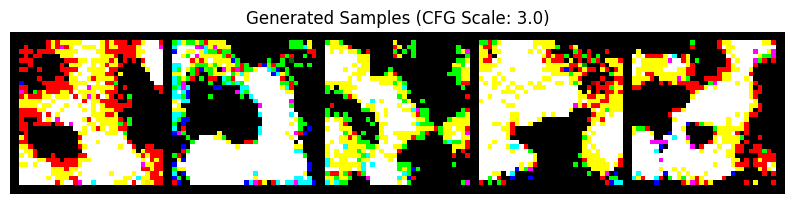

Generation function 'generate_samples' redefined with CFG.
  Epoch 5, Step 600/1250, Avg Loss (last 100): 0.0673
  Epoch 5, Step 700/1250, Avg Loss (last 100): 0.0678
  Epoch 5, Step 800/1250, Avg Loss (last 100): 0.0663
  Epoch 5, Step 900/1250, Avg Loss (last 100): 0.0668
  Epoch 5, Step 1000/1250, Avg Loss (last 100): 0.0644
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


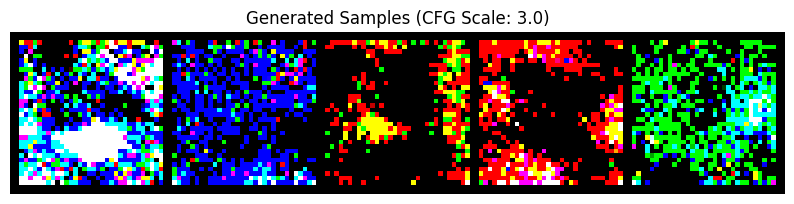

Generation function 'generate_samples' redefined with CFG.
  Epoch 5, Step 1100/1250, Avg Loss (last 100): 0.0655
  Epoch 5, Step 1200/1250, Avg Loss (last 100): 0.0648
Training Finished - Epoch 5 Avg Loss: 0.0662
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 5 Avg Loss: 0.0671
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0671)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth


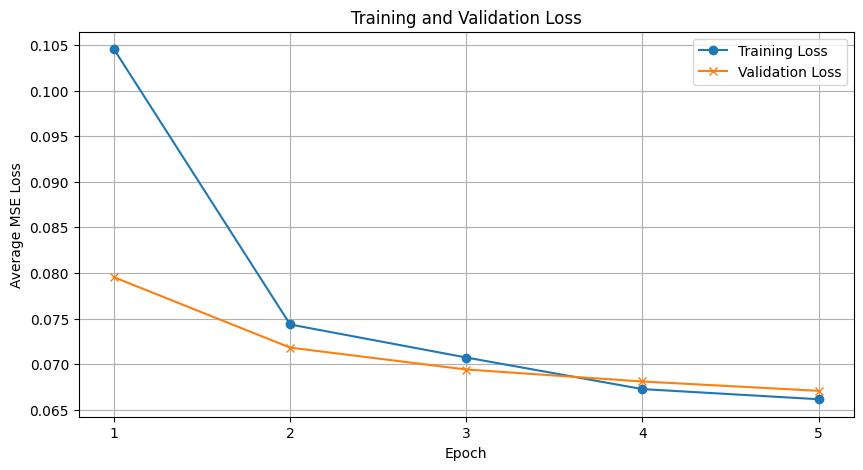


--- Epoch 6/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 6, Step 100/1250, Avg Loss (last 100): 0.0685
  Epoch 6, Step 200/1250, Avg Loss (last 100): 0.0651
  Epoch 6, Step 300/1250, Avg Loss (last 100): 0.0644
  Epoch 6, Step 400/1250, Avg Loss (last 100): 0.0648
  Epoch 6, Step 500/1250, Avg Loss (last 100): 0.0625
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


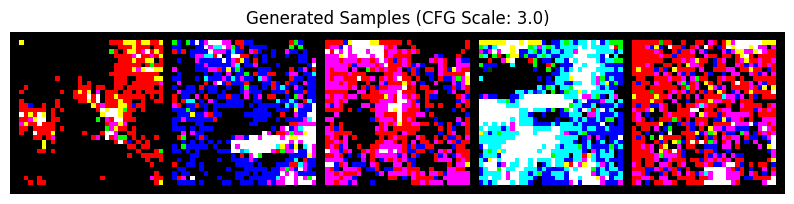

Generation function 'generate_samples' redefined with CFG.
  Epoch 6, Step 600/1250, Avg Loss (last 100): 0.0642
  Epoch 6, Step 700/1250, Avg Loss (last 100): 0.0643
  Epoch 6, Step 800/1250, Avg Loss (last 100): 0.0640
  Epoch 6, Step 900/1250, Avg Loss (last 100): 0.0665
  Epoch 6, Step 1000/1250, Avg Loss (last 100): 0.0646
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


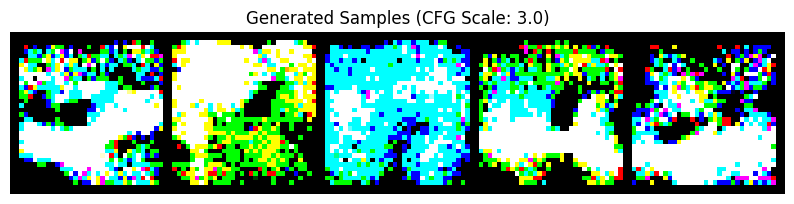

Generation function 'generate_samples' redefined with CFG.
  Epoch 6, Step 1100/1250, Avg Loss (last 100): 0.0665
  Epoch 6, Step 1200/1250, Avg Loss (last 100): 0.0674
Training Finished - Epoch 6 Avg Loss: 0.0655
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 6 Avg Loss: 0.0645
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0645)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 6)...
Generating samples with CFG (scale=3.0)...


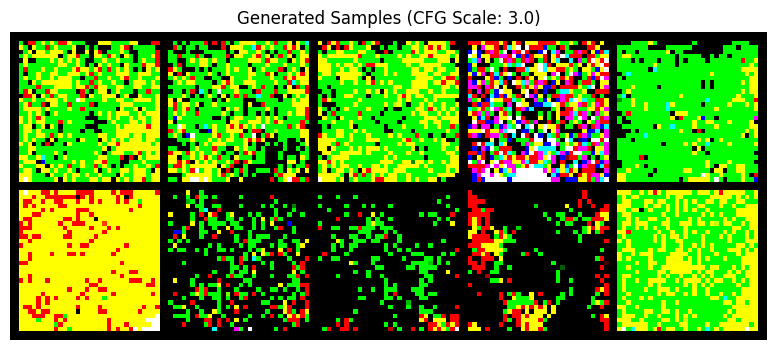

Generation function 'generate_samples' redefined with CFG.

--- Epoch 7/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 7, Step 100/1250, Avg Loss (last 100): 0.0652
  Epoch 7, Step 200/1250, Avg Loss (last 100): 0.0648
  Epoch 7, Step 300/1250, Avg Loss (last 100): 0.0668
  Epoch 7, Step 400/1250, Avg Loss (last 100): 0.0625
  Epoch 7, Step 500/1250, Avg Loss (last 100): 0.0657
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


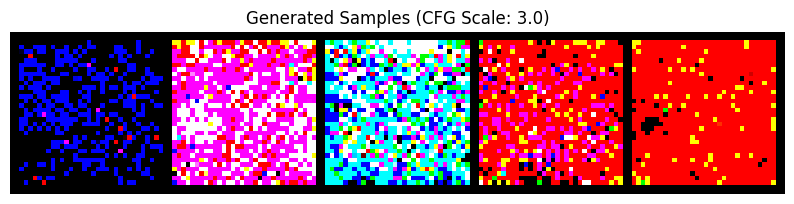

Generation function 'generate_samples' redefined with CFG.
  Epoch 7, Step 600/1250, Avg Loss (last 100): 0.0649
  Epoch 7, Step 700/1250, Avg Loss (last 100): 0.0624
  Epoch 7, Step 800/1250, Avg Loss (last 100): 0.0630
  Epoch 7, Step 900/1250, Avg Loss (last 100): 0.0664
  Epoch 7, Step 1000/1250, Avg Loss (last 100): 0.0609
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


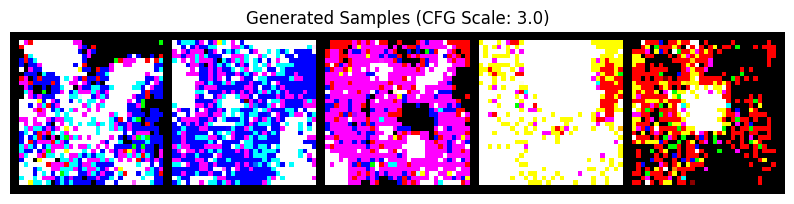

Generation function 'generate_samples' redefined with CFG.
  Epoch 7, Step 1100/1250, Avg Loss (last 100): 0.0629
  Epoch 7, Step 1200/1250, Avg Loss (last 100): 0.0654
Training Finished - Epoch 7 Avg Loss: 0.0643
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 7 Avg Loss: 0.0640
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0640)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 8/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 8, Step 100/1250, Avg Loss (last 100): 0.0665
  Epoch 8, Step 200/1250, Avg Loss (last 100): 0.0628
  Epoch 8, Step 300/1250, Avg Loss (last 100): 0.0652
  Epoch 8, Step 400/1250, Avg Loss (last 100): 0.0675
  Epoch 8, Step 500/1250, Avg Loss (last 100): 0.0626
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


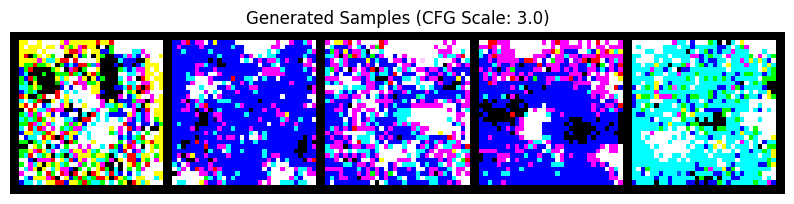

Generation function 'generate_samples' redefined with CFG.
  Epoch 8, Step 600/1250, Avg Loss (last 100): 0.0652
  Epoch 8, Step 700/1250, Avg Loss (last 100): 0.0609
  Epoch 8, Step 800/1250, Avg Loss (last 100): 0.0622
  Epoch 8, Step 900/1250, Avg Loss (last 100): 0.0642
  Epoch 8, Step 1000/1250, Avg Loss (last 100): 0.0629
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


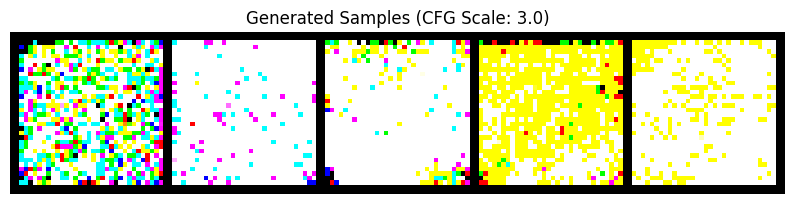

Generation function 'generate_samples' redefined with CFG.
  Epoch 8, Step 1100/1250, Avg Loss (last 100): 0.0634
  Epoch 8, Step 1200/1250, Avg Loss (last 100): 0.0632
Training Finished - Epoch 8 Avg Loss: 0.0639
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 8 Avg Loss: 0.0645
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 8)...
Generating samples with CFG (scale=3.0)...


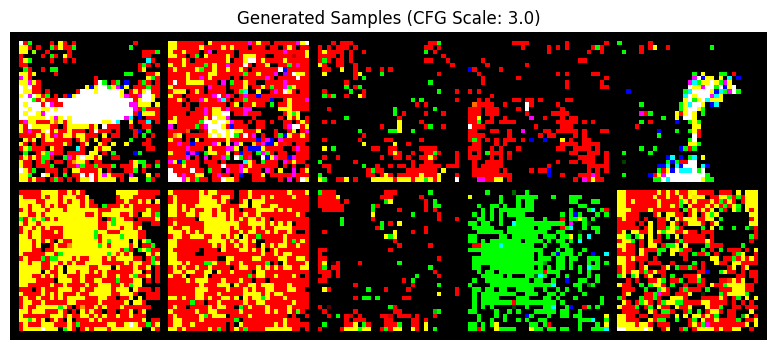

Generation function 'generate_samples' redefined with CFG.

--- Epoch 9/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 9, Step 100/1250, Avg Loss (last 100): 0.0641
  Epoch 9, Step 200/1250, Avg Loss (last 100): 0.0611
  Epoch 9, Step 300/1250, Avg Loss (last 100): 0.0665
  Epoch 9, Step 400/1250, Avg Loss (last 100): 0.0636
  Epoch 9, Step 500/1250, Avg Loss (last 100): 0.0622
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


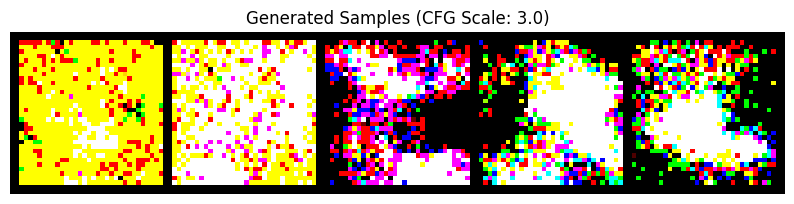

Generation function 'generate_samples' redefined with CFG.
  Epoch 9, Step 600/1250, Avg Loss (last 100): 0.0636
  Epoch 9, Step 700/1250, Avg Loss (last 100): 0.0647
  Epoch 9, Step 800/1250, Avg Loss (last 100): 0.0634
  Epoch 9, Step 900/1250, Avg Loss (last 100): 0.0620
  Epoch 9, Step 1000/1250, Avg Loss (last 100): 0.0628
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


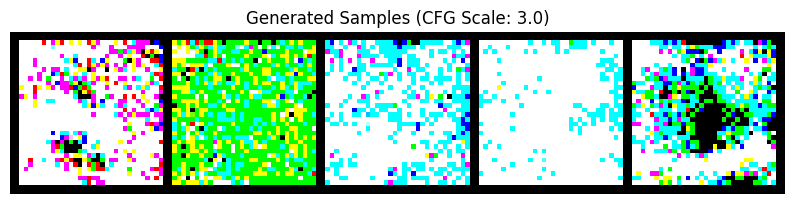

Generation function 'generate_samples' redefined with CFG.
  Epoch 9, Step 1100/1250, Avg Loss (last 100): 0.0649
  Epoch 9, Step 1200/1250, Avg Loss (last 100): 0.0658
Training Finished - Epoch 9 Avg Loss: 0.0637
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 9 Avg Loss: 0.0631
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0631)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 10/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 10, Step 100/1250, Avg Loss (last 100): 0.0621
  Epoch 10, Step 200/1250, Avg Loss (last 100): 0.0596
  Epoch 10, Step 300/1250, Avg Loss (last 100): 0.0644
  Epoch 10, Step 400/1250, Avg Loss (last 100): 0.0624
  Epoch 10, Step 500/1250, Avg Loss (last 100): 0.0615
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


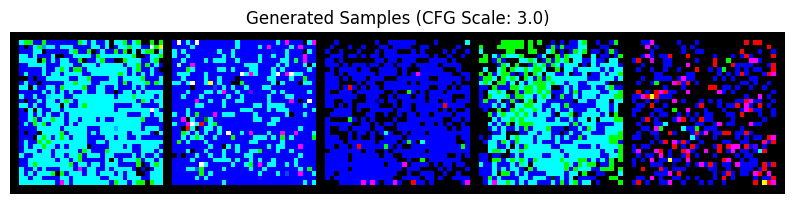

Generation function 'generate_samples' redefined with CFG.
  Epoch 10, Step 600/1250, Avg Loss (last 100): 0.0613
  Epoch 10, Step 700/1250, Avg Loss (last 100): 0.0650
  Epoch 10, Step 800/1250, Avg Loss (last 100): 0.0648
  Epoch 10, Step 900/1250, Avg Loss (last 100): 0.0605
  Epoch 10, Step 1000/1250, Avg Loss (last 100): 0.0609
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


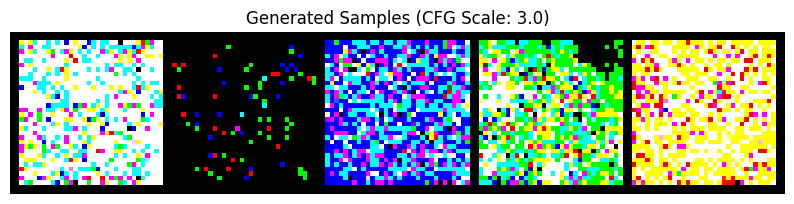

Generation function 'generate_samples' redefined with CFG.
  Epoch 10, Step 1100/1250, Avg Loss (last 100): 0.0661
  Epoch 10, Step 1200/1250, Avg Loss (last 100): 0.0639
Training Finished - Epoch 10 Avg Loss: 0.0628
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 10 Avg Loss: 0.0634
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 10)...
Generating samples with CFG (scale=3.0)...


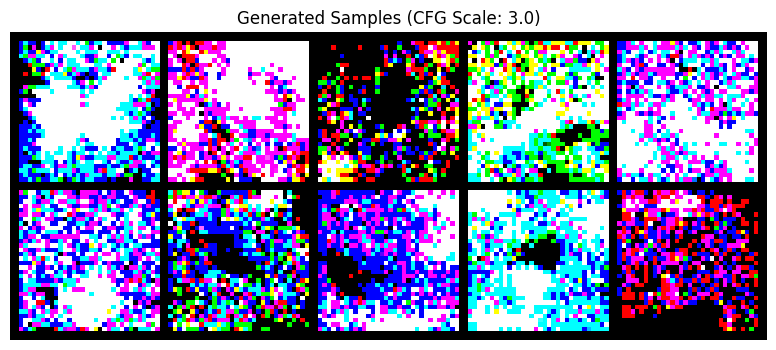

Generation function 'generate_samples' redefined with CFG.


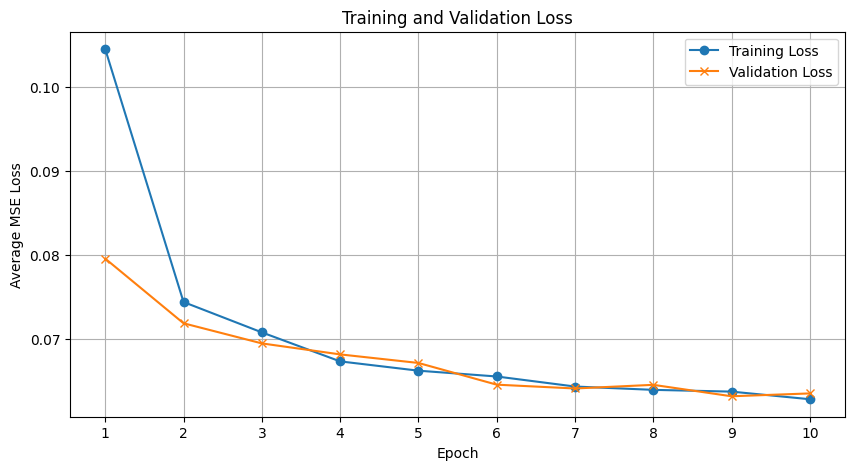


--- Epoch 11/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 11, Step 100/1250, Avg Loss (last 100): 0.0632
  Epoch 11, Step 200/1250, Avg Loss (last 100): 0.0610
  Epoch 11, Step 300/1250, Avg Loss (last 100): 0.0640
  Epoch 11, Step 400/1250, Avg Loss (last 100): 0.0641
  Epoch 11, Step 500/1250, Avg Loss (last 100): 0.0617
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


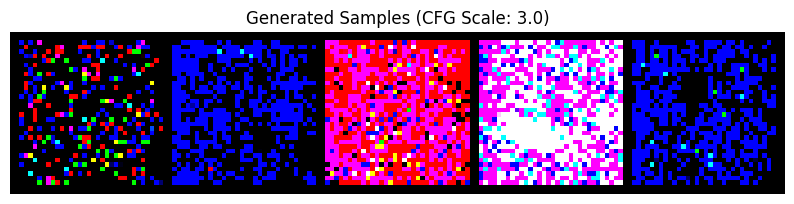

Generation function 'generate_samples' redefined with CFG.
  Epoch 11, Step 600/1250, Avg Loss (last 100): 0.0659
  Epoch 11, Step 700/1250, Avg Loss (last 100): 0.0644
  Epoch 11, Step 800/1250, Avg Loss (last 100): 0.0629
  Epoch 11, Step 900/1250, Avg Loss (last 100): 0.0609
  Epoch 11, Step 1000/1250, Avg Loss (last 100): 0.0638
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


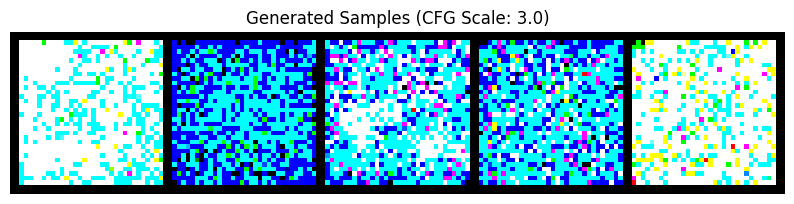

Generation function 'generate_samples' redefined with CFG.
  Epoch 11, Step 1100/1250, Avg Loss (last 100): 0.0635
  Epoch 11, Step 1200/1250, Avg Loss (last 100): 0.0641
Training Finished - Epoch 11 Avg Loss: 0.0634
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 11 Avg Loss: 0.0617
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0617)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

--- Epoch 12/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 12, Step 100/1250, Avg Loss (last 100): 0.0635
  Epoch 12, Step 200/1250, Avg Loss (last 100): 0.0635
  Epoch 12, Step 300/1250, Avg Loss (last 100): 0.0604
  Epoch 12, Step 400/1250, Avg Loss (last 100): 0.0630
  Epoch 12, Step 500/1250, Avg Loss (last 100): 0.0640
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


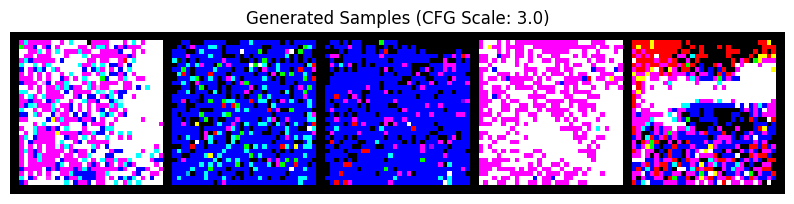

Generation function 'generate_samples' redefined with CFG.
  Epoch 12, Step 600/1250, Avg Loss (last 100): 0.0614
  Epoch 12, Step 700/1250, Avg Loss (last 100): 0.0598
  Epoch 12, Step 800/1250, Avg Loss (last 100): 0.0628
  Epoch 12, Step 900/1250, Avg Loss (last 100): 0.0614
  Epoch 12, Step 1000/1250, Avg Loss (last 100): 0.0628
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


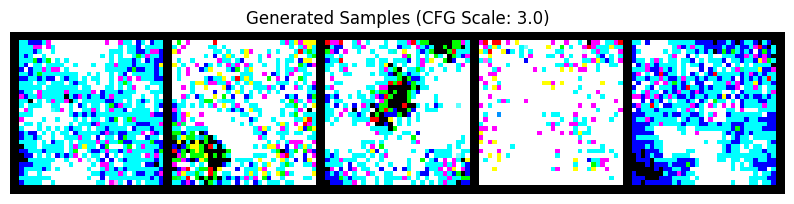

Generation function 'generate_samples' redefined with CFG.
  Epoch 12, Step 1100/1250, Avg Loss (last 100): 0.0648
  Epoch 12, Step 1200/1250, Avg Loss (last 100): 0.0627
Training Finished - Epoch 12 Avg Loss: 0.0624
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 12 Avg Loss: 0.0621
Validation loss did not improve for 1/10 epochs.

Generating samples for visual progress check (Epoch 12)...
Generating samples with CFG (scale=3.0)...


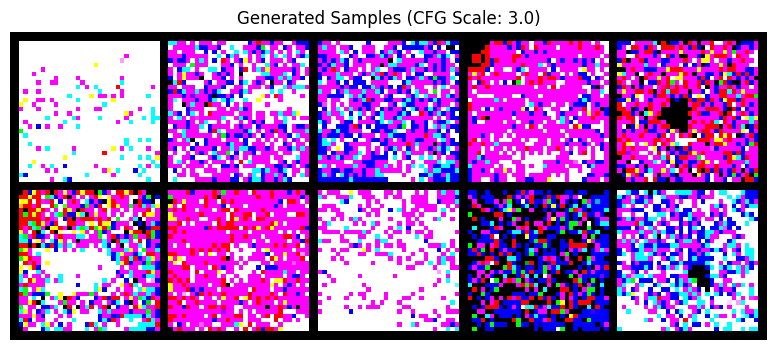

Generation function 'generate_samples' redefined with CFG.

--- Epoch 13/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 13, Step 100/1250, Avg Loss (last 100): 0.0611
  Epoch 13, Step 200/1250, Avg Loss (last 100): 0.0598
  Epoch 13, Step 300/1250, Avg Loss (last 100): 0.0611
  Epoch 13, Step 400/1250, Avg Loss (last 100): 0.0659
  Epoch 13, Step 500/1250, Avg Loss (last 100): 0.0590
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


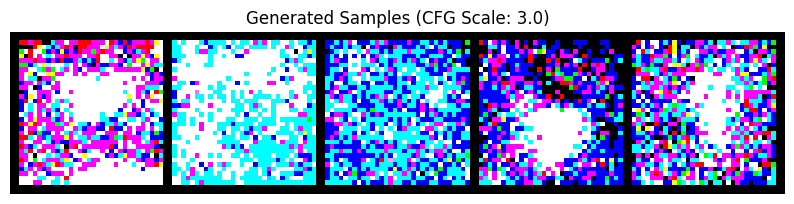

Generation function 'generate_samples' redefined with CFG.
  Epoch 13, Step 600/1250, Avg Loss (last 100): 0.0615
  Epoch 13, Step 700/1250, Avg Loss (last 100): 0.0625
  Epoch 13, Step 800/1250, Avg Loss (last 100): 0.0633
  Epoch 13, Step 900/1250, Avg Loss (last 100): 0.0618
  Epoch 13, Step 1000/1250, Avg Loss (last 100): 0.0631
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


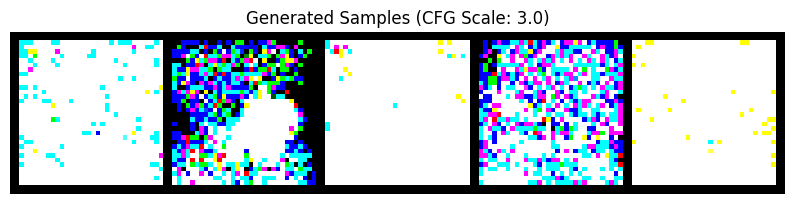

Generation function 'generate_samples' redefined with CFG.
  Epoch 13, Step 1100/1250, Avg Loss (last 100): 0.0592
  Epoch 13, Step 1200/1250, Avg Loss (last 100): 0.0617
Training Finished - Epoch 13 Avg Loss: 0.0618
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 13 Avg Loss: 0.0624
Validation loss did not improve for 2/10 epochs.

--- Epoch 14/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 14, Step 100/1250, Avg Loss (last 100): 0.0627
  Epoch 14, Step 200/1250, Avg Loss (last 100): 0.0615
  Epoch 14, Step 300/1250, Avg Loss (last 100): 0.0621
  Epoch 14, Step 400/1250, Avg Loss (last 100): 0.0624
  Epoch 14, Step 500/1250, Avg Loss (last 100): 0.0638
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


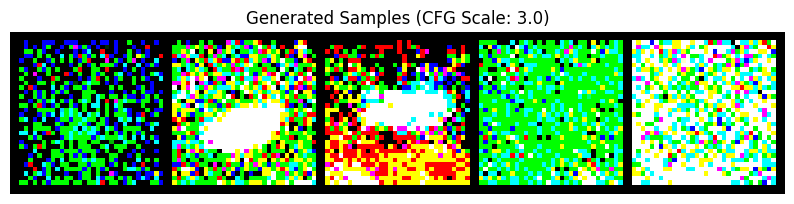

Generation function 'generate_samples' redefined with CFG.
  Epoch 14, Step 600/1250, Avg Loss (last 100): 0.0625
  Epoch 14, Step 700/1250, Avg Loss (last 100): 0.0626
  Epoch 14, Step 800/1250, Avg Loss (last 100): 0.0642
  Epoch 14, Step 900/1250, Avg Loss (last 100): 0.0603
  Epoch 14, Step 1000/1250, Avg Loss (last 100): 0.0649
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


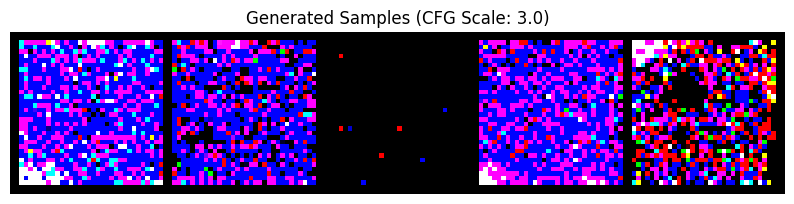

Generation function 'generate_samples' redefined with CFG.
  Epoch 14, Step 1100/1250, Avg Loss (last 100): 0.0603
  Epoch 14, Step 1200/1250, Avg Loss (last 100): 0.0630
Training Finished - Epoch 14 Avg Loss: 0.0627
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 14 Avg Loss: 0.0630
Validation loss did not improve for 3/10 epochs.

Generating samples for visual progress check (Epoch 14)...
Generating samples with CFG (scale=3.0)...


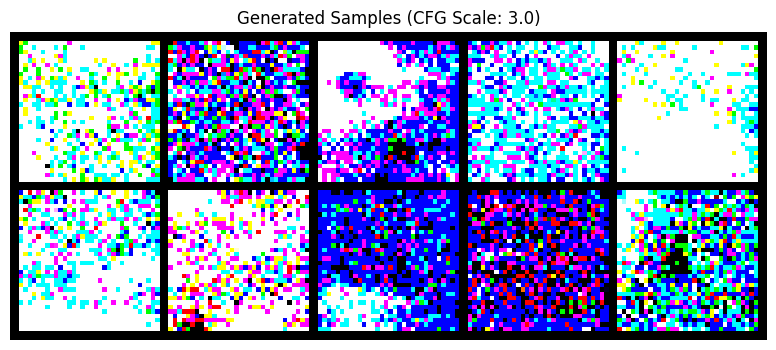

Generation function 'generate_samples' redefined with CFG.

--- Epoch 15/15 ---


Training:   0%|          | 0/1250 [00:00<?, ?it/s]

  Epoch 15, Step 100/1250, Avg Loss (last 100): 0.0596
  Epoch 15, Step 200/1250, Avg Loss (last 100): 0.0615
  Epoch 15, Step 300/1250, Avg Loss (last 100): 0.0593
  Epoch 15, Step 400/1250, Avg Loss (last 100): 0.0621
  Epoch 15, Step 500/1250, Avg Loss (last 100): 0.0632
  Generating samples at step 500...
Generating samples with CFG (scale=3.0)...


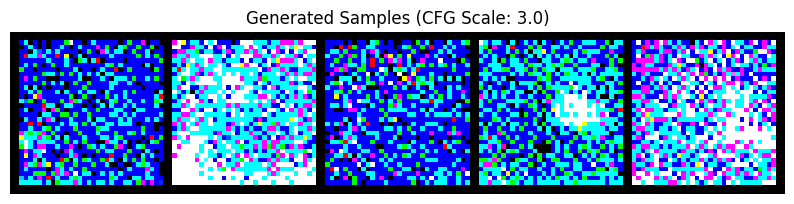

Generation function 'generate_samples' redefined with CFG.
  Epoch 15, Step 600/1250, Avg Loss (last 100): 0.0637
  Epoch 15, Step 700/1250, Avg Loss (last 100): 0.0640
  Epoch 15, Step 800/1250, Avg Loss (last 100): 0.0640
  Epoch 15, Step 900/1250, Avg Loss (last 100): 0.0612
  Epoch 15, Step 1000/1250, Avg Loss (last 100): 0.0609
  Generating samples at step 1000...
Generating samples with CFG (scale=3.0)...


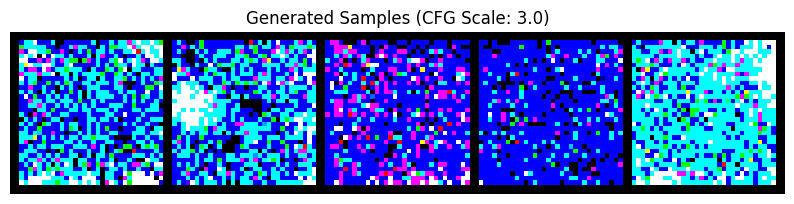

Generation function 'generate_samples' redefined with CFG.
  Epoch 15, Step 1100/1250, Avg Loss (last 100): 0.0667
  Epoch 15, Step 1200/1250, Avg Loss (last 100): 0.0586
Training Finished - Epoch 15 Avg Loss: 0.0621
Running validation...


Validation:   0%|          | 0/313 [00:00<?, ?it/s]

Validation Finished - Epoch 15 Avg Loss: 0.0612
✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: 0.0612)
Created backup at best_diffusion_model_cfg_cosine.pth.backup
Model successfully saved to best_diffusion_model_cfg_cosine.pth

Generating samples for visual progress check (Epoch 15)...
Generating samples with CFG (scale=3.0)...


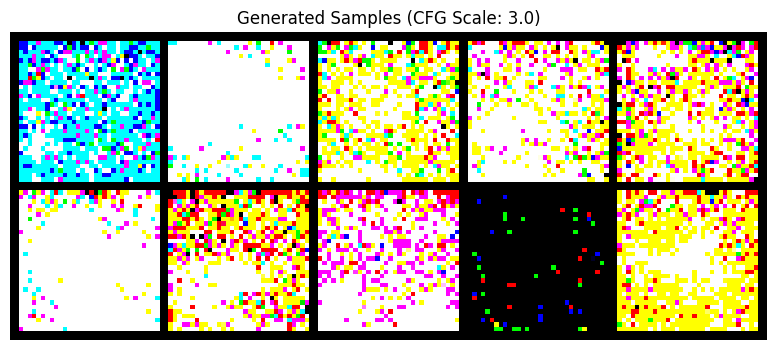

Generation function 'generate_samples' redefined with CFG.


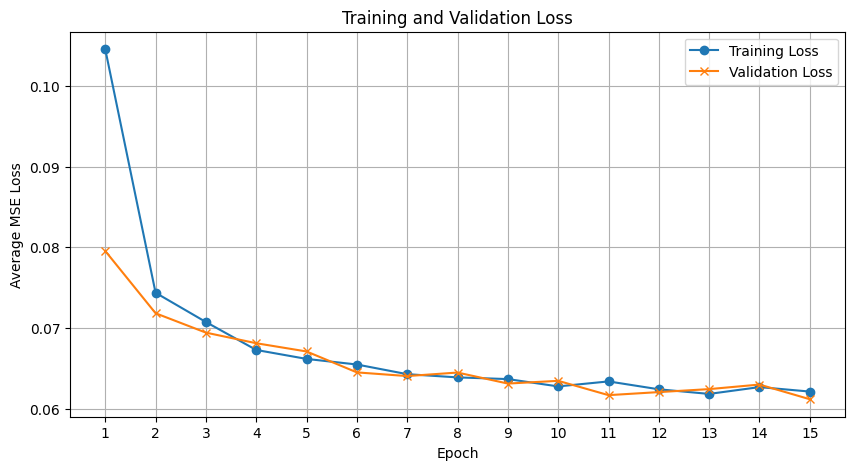


TRAINING PROCESS COMPLETE
Best validation loss achieved: 0.0612
Loading best model weights for final sample generation...
Best model loaded.
Generating final samples from best model...
Generating samples with CFG (scale=3.0)...


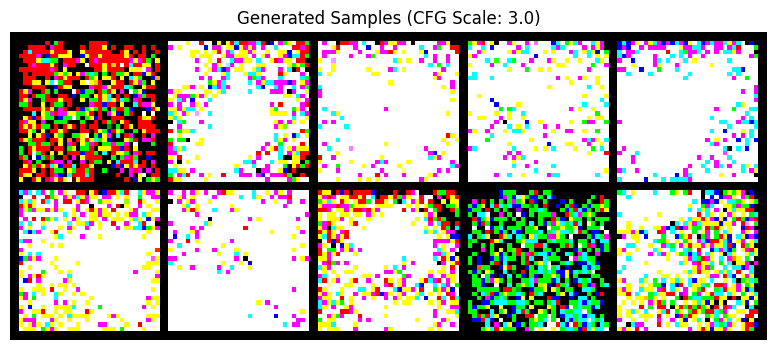

Generation function 'generate_samples' redefined with CFG.
Displaying final loss curves...


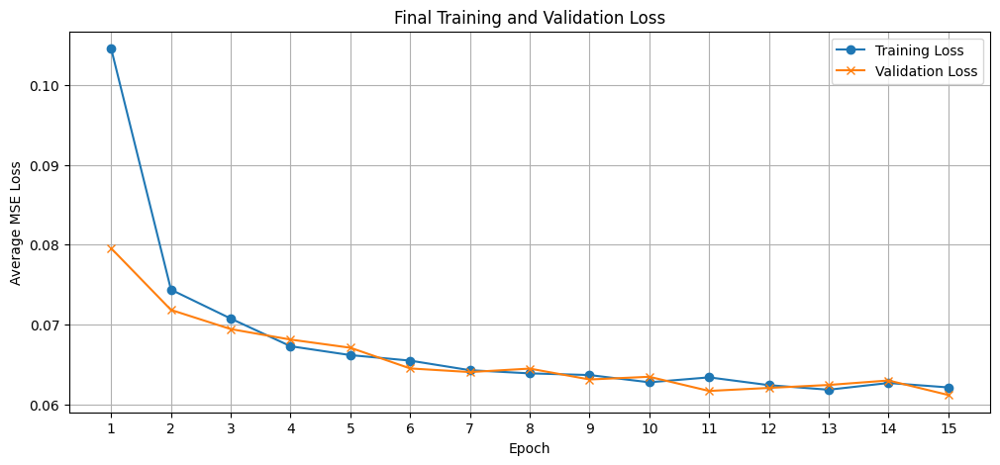

In [ ]:
# --- Main Training Loop (Using User Template Structure) ---

# Ensure tqdm is imported
try:
    from tqdm.notebook import tqdm
except ImportError:
    try:
        from tqdm import tqdm
    except ImportError:
        print("Warning: tqdm not installed. Progress bars will not be shown.")
        # Define a dummy tqdm if not installed
        def tqdm(iterable, *args, **kwargs):
            return iterable

# Progress tracking variables
best_loss = float('inf')
train_losses = []
val_losses = []
no_improve_epochs = 0
EPOCHS = 15 ## running for less epochs to test diff CFG values one last time

# Training loop
print("\n" + "="*50)
print("STARTING TRAINING (with CFG, Cosine Schedule)")
print(f"Epochs: {EPOCHS}, Batch Size: {BATCH_SIZE}, Steps: {N_STEPS}")
print(f"Device: {device}")
print("="*50)

# Wrap the training loop in a try-except block
try:
    for epoch in range(EPOCHS):
        print(f"\n--- Epoch {epoch+1}/{EPOCHS} ---")

        # === Training phase ===
        model.train() # Set model to training mode
        epoch_train_losses = [] # Store losses for this epoch

        # Use tqdm for the training loader
        pbar_train = tqdm(enumerate(train_load), total=len(train_load), desc="Training", leave=False)

        for step, (images, labels) in pbar_train:
            images = images.to(device)
            labels = labels.to(device)

            # --- Training step ---
            optimizer.zero_grad() # Zero gradients before calculating loss

            # Calculate loss using the modified train_step (returns tensor)
            loss = train_step(images, labels)

            # Perform backpropagation
            loss.backward()

            # Apply gradient clipping
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip_value)

            # Update model weights
            optimizer.step()
            # ---------------------

            current_loss_item = loss.item()
            epoch_train_losses.append(current_loss_item)

            # Update progress bar description
            pbar_train.set_postfix(Loss=f"{current_loss_item:.4f}")

            # Show progress less frequently (using display_frequency)
            if (step + 1) % display_frequency == 0:
                 avg_recent_loss = sum(epoch_train_losses[-display_frequency:]) / len(epoch_train_losses[-display_frequency:])
                 print(f"  Epoch {epoch+1}, Step {step+1}/{len(train_load)}, Avg Loss (last {display_frequency}): {avg_recent_loss:.4f}")

            # Generate samples less frequently (using generate_frequency)
            # Ensure generate_samples function exists and works as expected
            if (step + 1) % generate_frequency == 0 and step > 0:
                 try:
                     print(f"  Generating samples at step {step+1}...")
                     # Call the generate_samples redefined earlier (includes CFG)
                     generate_samples(model, n_samples=5, cfg_scale=3.0)
                     model.train() # Ensure model is back in train mode after generation
                 except NameError:
                     print("  'generate_samples' function not found, skipping sample generation.")
                 except Exception as e:
                     print(f"  Error during sample generation: {e}")
                     model.train() # Ensure model is back in train mode

        # End of training epoch - calculate average training loss
        avg_train_loss = sum(epoch_train_losses) / len(epoch_train_losses)
        train_losses.append(avg_train_loss)
        print(f"Training Finished - Epoch {epoch+1} Avg Loss: {avg_train_loss:.4f}")

        # === Validation phase ===
        model.eval() # Set model to evaluation mode
        val_epoch_losses = []
        print("Running validation...")

        # Use tqdm for the validation loader
        pbar_val = tqdm(val_load, desc="Validation", leave=False)

        # No gradients needed for validation
        with torch.no_grad():
            for val_images, val_labels in pbar_val:
                val_images = val_images.to(device)
                val_labels = val_labels.to(device)

                # Calculate validation loss using the new function
                val_loss_item = calculate_val_loss(model, val_images, val_labels)
                val_epoch_losses.append(val_loss_item)
                pbar_val.set_postfix(Loss=f"{val_loss_item:.4f}")

        # Calculate average validation loss for the epoch
        avg_val_loss = sum(val_epoch_losses) / len(val_epoch_losses)
        val_losses.append(avg_val_loss)
        print(f"Validation Finished - Epoch {epoch+1} Avg Loss: {avg_val_loss:.4f}")

        # === LR Scheduling, Saving, Early Stopping ===

        # Update Learning Rate based on validation loss
        scheduler.step(avg_val_loss)
        current_lr = optimizer.param_groups[0]['lr']
        # Check if LR changed
        # Note: ReduceLROnPlateau might not change LR every epoch
        # print(f"Current learning rate: {current_lr:.6f}") # Optional: print LR every epoch

        # Save the best model based on validation loss
        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            # Ensure safe_save_model function exists
            try:
                 print(f"✓ New best model found! Saving to 'best_diffusion_model_cfg_cosine.pth' (Val Loss: {best_loss:.4f})")
                 safe_save_model(model, 'best_diffusion_model_cfg_cosine.pth', optimizer, epoch, best_loss)
            except NameError:
                 print("  'safe_save_model' not found, using basic torch.save.")
                 torch.save({
                     'epoch': epoch,
                     'model_state_dict': model.state_dict(),
                     'optimizer_state_dict': optimizer.state_dict(),
                     'best_loss': best_loss,
                 }, 'best_diffusion_model_cfg_cosine.pth')
            no_improve_epochs = 0 # Reset counter
        else:
            no_improve_epochs += 1
            print(f"Validation loss did not improve for {no_improve_epochs}/{early_stopping_patience} epochs.")

        # Check for early stopping
        if no_improve_epochs >= early_stopping_patience:
            print(f"\nEarly stopping triggered after {epoch+1} epochs due to no improvement in validation loss.")
            break # Exit the training loop

        # Generate samples at the end of every few epochs (e.g., every 2 epochs)
        if (epoch + 1) % 2 == 0 or epoch == EPOCHS - 1:
             try:
                 print(f"\nGenerating samples for visual progress check (Epoch {epoch+1})...")
                 generate_samples(model, n_samples=10, cfg_scale=3.0) # Use CFG version
                 model.train() # Back to train mode
             except NameError:
                 print("  'generate_samples' function not found.")
             except Exception as e:
                 print(f"  Error during sample generation: {e}")
                 model.train()

        # Plot loss curves periodically (e.g., every 5 epochs)
        if (epoch + 1) % 5 == 0 or epoch == EPOCHS - 1:
             try:
                 plt.figure(figsize=(10, 5))
                 plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss', marker='o')
                 plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss', marker='x')
                 plt.xlabel('Epoch')
                 plt.ylabel('Average MSE Loss')
                 plt.title('Training and Validation Loss')
                 plt.legend()
                 plt.grid(True)
                 plt.xticks(range(1, len(train_losses) + 1)) # Ensure integer ticks for epochs
                 plt.show()
             except NameError:
                 print("matplotlib.pyplot not imported as plt, cannot plot losses.")
             except Exception as e:
                 print(f"Error plotting losses: {e}")


# === End of Training Loop ===
except KeyboardInterrupt:
    print("\n--- Training interrupted by user ---")
except Exception as e:
    print(f"\n--- An error occurred during training: {e} ---")
    import traceback
    traceback.print_exc() # Print detailed traceback

# ––– Final wrap-up ––––––––––––––––––––––––––––––––––––––––––––––––––––––––––
print("\n" + "="*50)
print("TRAINING PROCESS COMPLETE")
print("="*50)
print(f"Best validation loss achieved: {best_loss:.4f}")

# Generate final samples using the *best* model weights if saved
try:
    print("Loading best model weights for final sample generation...")
    checkpoint = torch.load('best_diffusion_model_cfg_cosine.pth', map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    print("Best model loaded.")

    print("Generating final samples from best model...")
    generate_samples(model, n_samples=10, cfg_scale=3.0) # Use CFG version
except FileNotFoundError:
    print("Best model checkpoint not found. Generating samples from final model state.")
    print("Generating final samples...")
    generate_samples(model, n_samples=10, cfg_scale=3.0) # Use CFG version
except Exception as e:
    print(f"Could not load best model or generate final samples: {e}")

# Display final loss curves if training completed some epochs
if train_losses and val_losses:
    try:
        print("Displaying final loss curves...")
        plt.figure(figsize=(12, 5))
        plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss', marker='o')
        plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss', marker='x')
        plt.xlabel('Epoch')
        plt.ylabel('Average MSE Loss')
        plt.title('Final Training and Validation Loss')
        plt.legend()
        plt.grid(True)
        plt.xticks(range(1, len(train_losses) + 1))
        plt.show()
    except NameError:
        print("matplotlib.pyplot not imported as plt, cannot plot final losses.")
    except Exception as e:
        print(f"Error plotting final losses: {e}")

# Clean up memory (optional, useful in environments like Colab)
import gc
gc.collect() # Run garbage collection
torch.cuda.empty_cache() # Clear PyTorch's CUDA cache



TESTING DIFFERENT CFG SCALES on the trained model

--- Generating with CFG Scale = 0.0 ---
Generating samples with CFG (scale=0.0)...


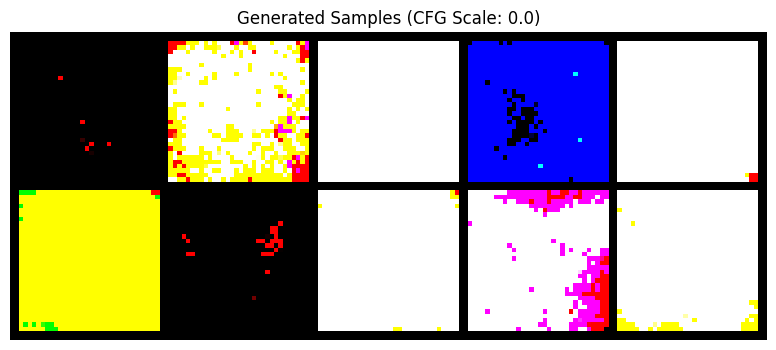

Generation function 'generate_samples' redefined with CFG.

--- Generating with CFG Scale = 1.0 ---
Generating samples with CFG (scale=1.0)...


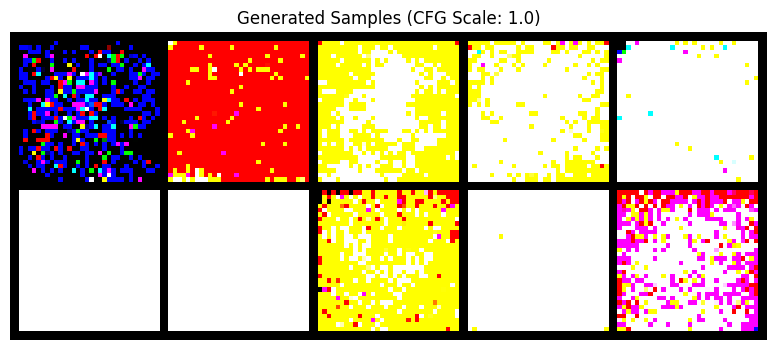

Generation function 'generate_samples' redefined with CFG.

--- Generating with CFG Scale = 2.0 ---
Generating samples with CFG (scale=2.0)...


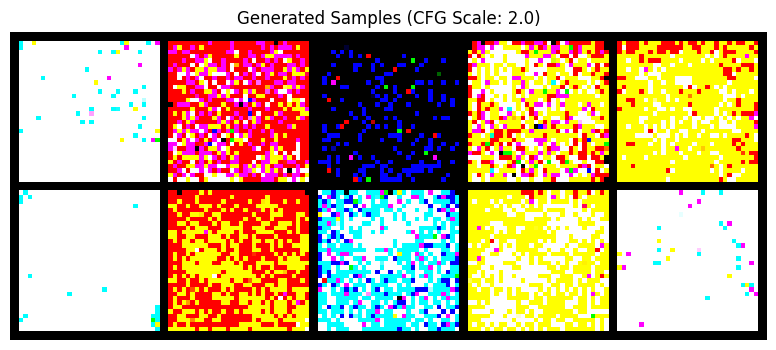

Generation function 'generate_samples' redefined with CFG.

--- Generating with CFG Scale = 3.0 ---
Generating samples with CFG (scale=3.0)...


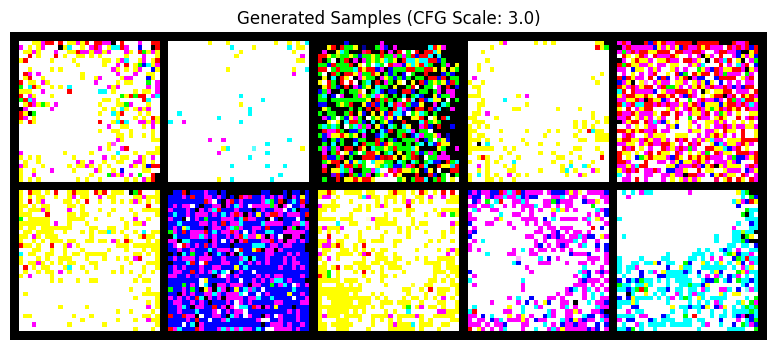

Generation function 'generate_samples' redefined with CFG.

--- Generating with CFG Scale = 5.0 ---
Generating samples with CFG (scale=5.0)...


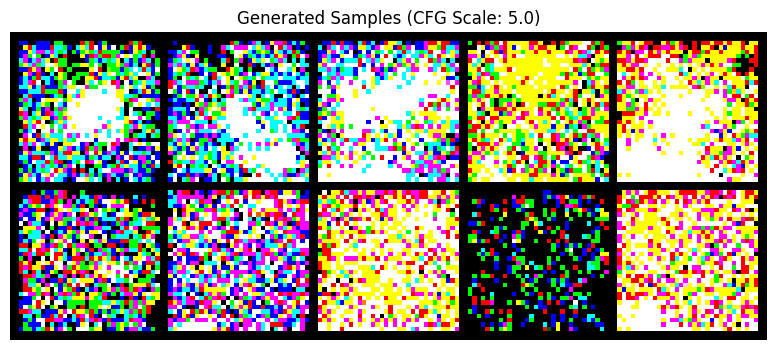

Generation function 'generate_samples' redefined with CFG.

--- Generating with CFG Scale = 7.0 ---
Generating samples with CFG (scale=7.0)...


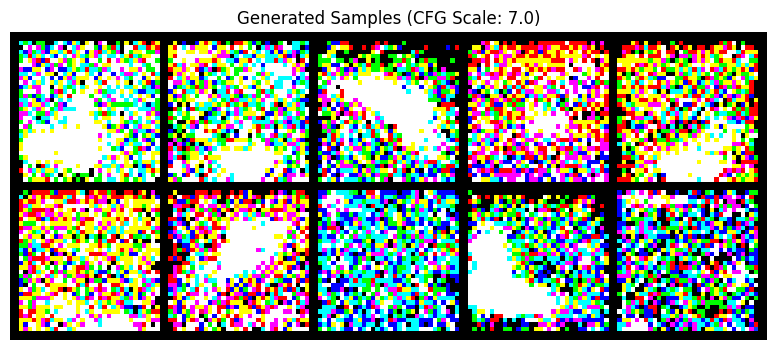

Generation function 'generate_samples' redefined with CFG.

--- Generating with CFG Scale = 10.0 ---
Generating samples with CFG (scale=10.0)...


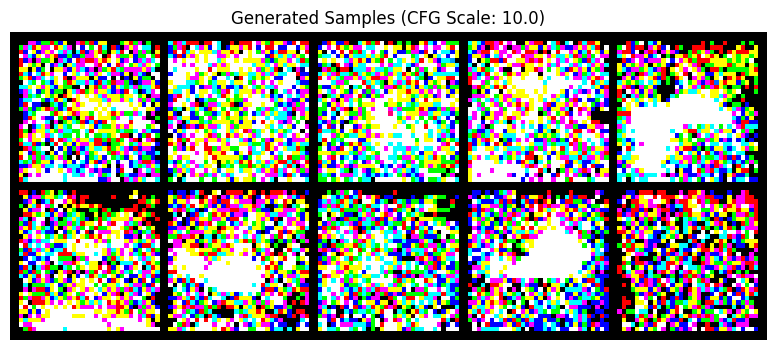

Generation function 'generate_samples' redefined with CFG.


In [ ]:
# --- Test Different CFG Scales ---
print("\n" + "="*50)
print("TESTING DIFFERENT CFG SCALES on the trained model")
print("="*50)

# Ensure model is in evaluation mode
model.eval()

cfg_scales_to_test = [0.0, 1.0, 2.0, 3.0, 5.0, 7.0, 10.0]

for scale in cfg_scales_to_test:
    print(f"\n--- Generating with CFG Scale = {scale} ---")
    try:
        # Uses the generate_samples function defined in Step 6
        generate_samples(model, n_samples=10, cfg_scale=scale)
    except Exception as e:
        print(f"  Error generating samples for scale {scale}: {e}")

# Set model back to train mode if you were to continue training later
# model.train()

# FASHION MNIST TRAINING

## STEP 6: MODEL INSTANTIATION

In [ ]:
# --- Step 6: Model Instantiation (Revised for Fashion-MNIST) ---
print("Instantiating U-Net for Fashion-MNIST...")
model = UNet(
    T=N_STEPS,          # Use N_STEPS = 200
    img_ch=IMG_CH,      # Use IMG_CH = 1
    img_size=IMG_SIZE,    # Use IMG_SIZE = 28
    down_chs=DOWN_CHS,  # Use (64, 128, 256)
    t_embed_dim=T_EMBED_DIM, # Use 256
    c_embed_dim=C_EMBED_DIM  # Use N_CLASSES
).to(device)

print(f"Model instantiated.")
validate_model_parameters(model) # Optional: check size

Instantiating U-Net for Fashion-MNIST...
Created DownBlock: in_chs=64, out_chs=128, spatial_reduction=2x
Created DownBlock: in_chs=128, out_chs=256, spatial_reduction=2x
Created UpBlock: in_chs=256, out_chs=128, spatial_increase=2x
Created UpBlock: in_chs=128, out_chs=64, spatial_increase=2x
Created UNet with 3 scale levels
Channel dimensions: (64, 128, 256)
Model instantiated.
Total parameters: 6,343,389
Trainable parameters: 6,343,389
Estimated GPU memory usage: 96.8 MB


## STEP 7: OPTIMIZER AND SCHEDULER

In [ ]:
# --- Step 7: Optimizer & Scheduler ---
import torch.optim.lr_scheduler as lr_scheduler

LR = 5e-4 # Slightly higher LR might work for Fashion-MNIST
optimizer = torch.optim.Adam(model.parameters(), lr=LR)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)

# Config constants from training loop template
early_stopping_patience = 10
gradient_clip_value = 1.0
display_frequency = 100
generate_frequency = 500 # Or less frequent for Fashion-MNIST

print("Optimizer and Scheduler defined.")

Optimizer and Scheduler defined.


/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


### TRAINING


STARTING Fashion-MNIST TRAINING (with CFG, Cosine Schedule)
Epochs: 30, Batch Size: 128, Steps: 200
Device: cuda

--- Epoch 1/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 1, Step 100/375, Avg Loss (last 100): 0.0961
  Epoch 1, Step 200/375, Avg Loss (last 100): 0.0892
  Epoch 1, Step 300/375, Avg Loss (last 100): 0.0883
Training Finished - Epoch 1 Avg Loss: 0.0900
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 1 Avg Loss: 0.0830
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0830)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 2/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 2, Step 100/375, Avg Loss (last 100): 0.0841
  Epoch 2, Step 200/375, Avg Loss (last 100): 0.0810
  Epoch 2, Step 300/375, Avg Loss (last 100): 0.0812
Training Finished - Epoch 2 Avg Loss: 0.0816
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 2 Avg Loss: 0.0805
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0805)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 3/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 3, Step 100/375, Avg Loss (last 100): 0.0796
  Epoch 3, Step 200/375, Avg Loss (last 100): 0.0764
  Epoch 3, Step 300/375, Avg Loss (last 100): 0.0759
Training Finished - Epoch 3 Avg Loss: 0.0771
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 3 Avg Loss: 0.0763
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0763)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 4/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 4, Step 100/375, Avg Loss (last 100): 0.0747
  Epoch 4, Step 200/375, Avg Loss (last 100): 0.0758
  Epoch 4, Step 300/375, Avg Loss (last 100): 0.0742
Training Finished - Epoch 4 Avg Loss: 0.0745
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 4 Avg Loss: 0.0745
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0745)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 5/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 5, Step 100/375, Avg Loss (last 100): 0.0735
  Epoch 5, Step 200/375, Avg Loss (last 100): 0.0722
  Epoch 5, Step 300/375, Avg Loss (last 100): 0.0742
Training Finished - Epoch 5 Avg Loss: 0.0734
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 5 Avg Loss: 0.0721
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0721)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

Generating samples (Epoch 5)...
Generating samples with CFG (scale=5.0)...


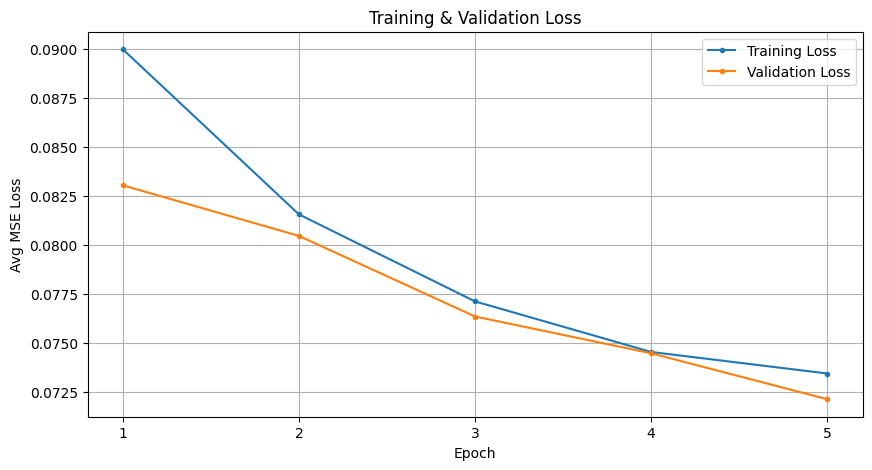


--- Epoch 6/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 6, Step 100/375, Avg Loss (last 100): 0.0717
  Epoch 6, Step 200/375, Avg Loss (last 100): 0.0721
  Epoch 6, Step 300/375, Avg Loss (last 100): 0.0723
Training Finished - Epoch 6 Avg Loss: 0.0719
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 6 Avg Loss: 0.0737
Validation loss did not improve for 1/10 epochs.

--- Epoch 7/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 7, Step 100/375, Avg Loss (last 100): 0.0703
  Epoch 7, Step 200/375, Avg Loss (last 100): 0.0696
  Epoch 7, Step 300/375, Avg Loss (last 100): 0.0709
Training Finished - Epoch 7 Avg Loss: 0.0699
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 7 Avg Loss: 0.0706
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0706)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 8/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 8, Step 100/375, Avg Loss (last 100): 0.0708
  Epoch 8, Step 200/375, Avg Loss (last 100): 0.0693
  Epoch 8, Step 300/375, Avg Loss (last 100): 0.0703
Training Finished - Epoch 8 Avg Loss: 0.0700
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 8 Avg Loss: 0.0689
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0689)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 9/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 9, Step 100/375, Avg Loss (last 100): 0.0694
  Epoch 9, Step 200/375, Avg Loss (last 100): 0.0701
  Epoch 9, Step 300/375, Avg Loss (last 100): 0.0688
Training Finished - Epoch 9 Avg Loss: 0.0691
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 9 Avg Loss: 0.0703
Validation loss did not improve for 1/10 epochs.

--- Epoch 10/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 10, Step 100/375, Avg Loss (last 100): 0.0698
  Epoch 10, Step 200/375, Avg Loss (last 100): 0.0684
  Epoch 10, Step 300/375, Avg Loss (last 100): 0.0683
Training Finished - Epoch 10 Avg Loss: 0.0689
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 10 Avg Loss: 0.0687
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0687)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

Generating samples (Epoch 10)...
Generating samples with CFG (scale=5.0)...


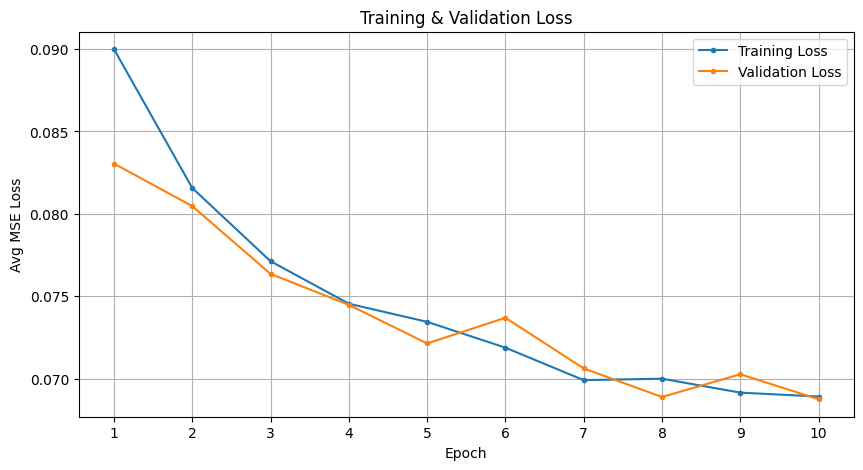


--- Epoch 11/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 11, Step 100/375, Avg Loss (last 100): 0.0685
  Epoch 11, Step 200/375, Avg Loss (last 100): 0.0695
  Epoch 11, Step 300/375, Avg Loss (last 100): 0.0693
Training Finished - Epoch 11 Avg Loss: 0.0690
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 11 Avg Loss: 0.0673
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0673)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 12/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 12, Step 100/375, Avg Loss (last 100): 0.0696
  Epoch 12, Step 200/375, Avg Loss (last 100): 0.0666
  Epoch 12, Step 300/375, Avg Loss (last 100): 0.0674
Training Finished - Epoch 12 Avg Loss: 0.0679
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 12 Avg Loss: 0.0690
Validation loss did not improve for 1/10 epochs.

--- Epoch 13/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 13, Step 100/375, Avg Loss (last 100): 0.0680
  Epoch 13, Step 200/375, Avg Loss (last 100): 0.0667
  Epoch 13, Step 300/375, Avg Loss (last 100): 0.0667
Training Finished - Epoch 13 Avg Loss: 0.0673
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 13 Avg Loss: 0.0680
Validation loss did not improve for 2/10 epochs.

--- Epoch 14/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 14, Step 100/375, Avg Loss (last 100): 0.0675
  Epoch 14, Step 200/375, Avg Loss (last 100): 0.0677
  Epoch 14, Step 300/375, Avg Loss (last 100): 0.0655
Training Finished - Epoch 14 Avg Loss: 0.0671
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 14 Avg Loss: 0.0689
Validation loss did not improve for 3/10 epochs.

--- Epoch 15/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 15, Step 100/375, Avg Loss (last 100): 0.0672
  Epoch 15, Step 200/375, Avg Loss (last 100): 0.0655
  Epoch 15, Step 300/375, Avg Loss (last 100): 0.0655
Training Finished - Epoch 15 Avg Loss: 0.0664
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 15 Avg Loss: 0.0673
Validation loss did not improve for 4/10 epochs.

Generating samples (Epoch 15)...
Generating samples with CFG (scale=5.0)...


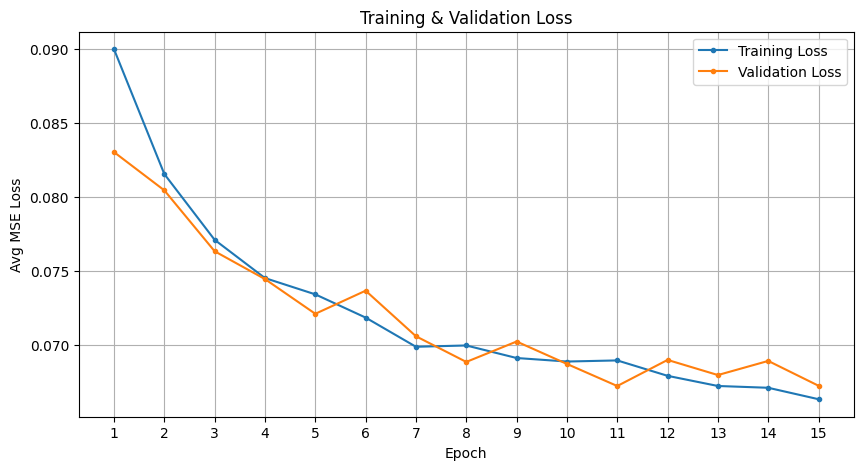


--- Epoch 16/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 16, Step 100/375, Avg Loss (last 100): 0.0654
  Epoch 16, Step 200/375, Avg Loss (last 100): 0.0637
  Epoch 16, Step 300/375, Avg Loss (last 100): 0.0639
Training Finished - Epoch 16 Avg Loss: 0.0646
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 16 Avg Loss: 0.0657
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0657)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 17/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 17, Step 100/375, Avg Loss (last 100): 0.0652
  Epoch 17, Step 200/375, Avg Loss (last 100): 0.0652
  Epoch 17, Step 300/375, Avg Loss (last 100): 0.0650
Training Finished - Epoch 17 Avg Loss: 0.0650
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 17 Avg Loss: 0.0652
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0652)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 18/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 18, Step 100/375, Avg Loss (last 100): 0.0648
  Epoch 18, Step 200/375, Avg Loss (last 100): 0.0655
  Epoch 18, Step 300/375, Avg Loss (last 100): 0.0657
Training Finished - Epoch 18 Avg Loss: 0.0652
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 18 Avg Loss: 0.0652
Validation loss did not improve for 1/10 epochs.

--- Epoch 19/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 19, Step 100/375, Avg Loss (last 100): 0.0645
  Epoch 19, Step 200/375, Avg Loss (last 100): 0.0653
  Epoch 19, Step 300/375, Avg Loss (last 100): 0.0645
Training Finished - Epoch 19 Avg Loss: 0.0649
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 19 Avg Loss: 0.0655
Validation loss did not improve for 2/10 epochs.

--- Epoch 20/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 20, Step 100/375, Avg Loss (last 100): 0.0650
  Epoch 20, Step 200/375, Avg Loss (last 100): 0.0641
  Epoch 20, Step 300/375, Avg Loss (last 100): 0.0658
Training Finished - Epoch 20 Avg Loss: 0.0651
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 20 Avg Loss: 0.0646
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0646)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

Generating samples (Epoch 20)...
Generating samples with CFG (scale=5.0)...


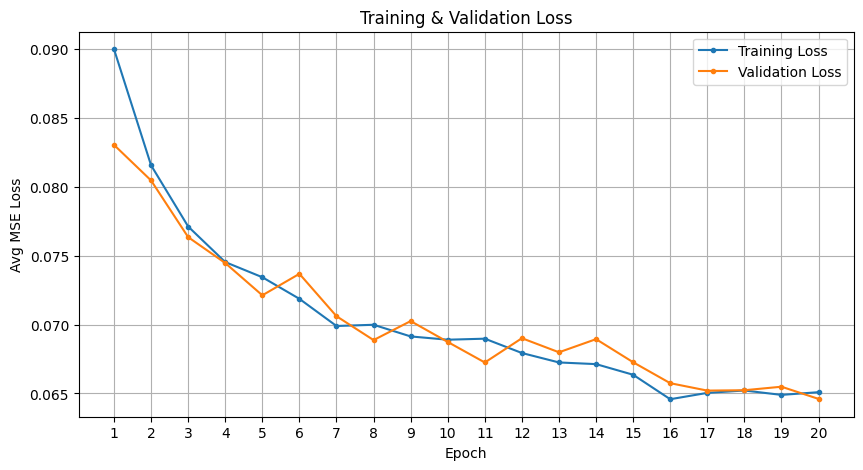


--- Epoch 21/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 21, Step 100/375, Avg Loss (last 100): 0.0647
  Epoch 21, Step 200/375, Avg Loss (last 100): 0.0649
  Epoch 21, Step 300/375, Avg Loss (last 100): 0.0644
Training Finished - Epoch 21 Avg Loss: 0.0642
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 21 Avg Loss: 0.0660
Validation loss did not improve for 1/10 epochs.

--- Epoch 22/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 22, Step 100/375, Avg Loss (last 100): 0.0658
  Epoch 22, Step 200/375, Avg Loss (last 100): 0.0652
  Epoch 22, Step 300/375, Avg Loss (last 100): 0.0645
Training Finished - Epoch 22 Avg Loss: 0.0653
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 22 Avg Loss: 0.0652
Validation loss did not improve for 2/10 epochs.

--- Epoch 23/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 23, Step 100/375, Avg Loss (last 100): 0.0637
  Epoch 23, Step 200/375, Avg Loss (last 100): 0.0651
  Epoch 23, Step 300/375, Avg Loss (last 100): 0.0641
Training Finished - Epoch 23 Avg Loss: 0.0642
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 23 Avg Loss: 0.0651
Validation loss did not improve for 3/10 epochs.

--- Epoch 24/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 24, Step 100/375, Avg Loss (last 100): 0.0639
  Epoch 24, Step 200/375, Avg Loss (last 100): 0.0644
  Epoch 24, Step 300/375, Avg Loss (last 100): 0.0650
Training Finished - Epoch 24 Avg Loss: 0.0643
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 24 Avg Loss: 0.0646
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0646)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 25/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 25, Step 100/375, Avg Loss (last 100): 0.0641
  Epoch 25, Step 200/375, Avg Loss (last 100): 0.0630
  Epoch 25, Step 300/375, Avg Loss (last 100): 0.0645
Training Finished - Epoch 25 Avg Loss: 0.0642
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 25 Avg Loss: 0.0646
Validation loss did not improve for 1/10 epochs.

Generating samples (Epoch 25)...
Generating samples with CFG (scale=5.0)...


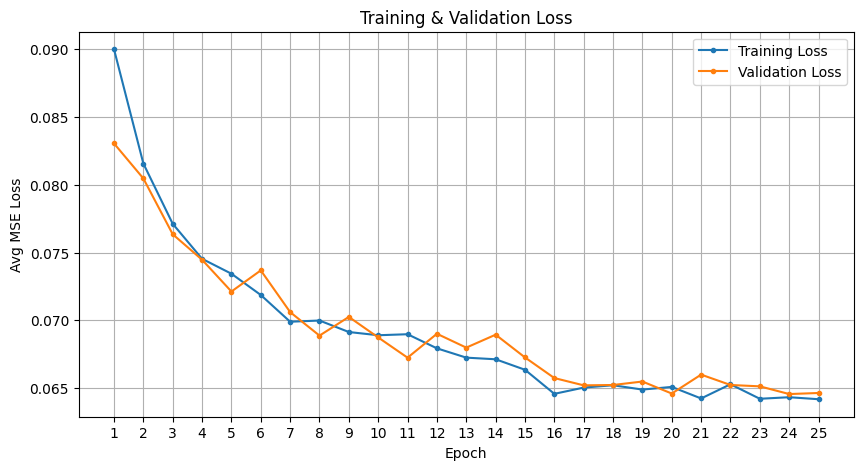


--- Epoch 26/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 26, Step 100/375, Avg Loss (last 100): 0.0638
  Epoch 26, Step 200/375, Avg Loss (last 100): 0.0648
  Epoch 26, Step 300/375, Avg Loss (last 100): 0.0649
Training Finished - Epoch 26 Avg Loss: 0.0645
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 26 Avg Loss: 0.0647
Validation loss did not improve for 2/10 epochs.

--- Epoch 27/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 27, Step 100/375, Avg Loss (last 100): 0.0646
  Epoch 27, Step 200/375, Avg Loss (last 100): 0.0650
  Epoch 27, Step 300/375, Avg Loss (last 100): 0.0644
Training Finished - Epoch 27 Avg Loss: 0.0646
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 27 Avg Loss: 0.0652
Validation loss did not improve for 3/10 epochs.

--- Epoch 28/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 28, Step 100/375, Avg Loss (last 100): 0.0646
  Epoch 28, Step 200/375, Avg Loss (last 100): 0.0641
  Epoch 28, Step 300/375, Avg Loss (last 100): 0.0634
Training Finished - Epoch 28 Avg Loss: 0.0639
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 28 Avg Loss: 0.0635
✓ New best model found! Saving to 'best_diffusion_model_fashion_mnist.pth' (Val Loss: 0.0635)
Created backup at best_diffusion_model_fashion_mnist.pth.backup
Model successfully saved to best_diffusion_model_fashion_mnist.pth

--- Epoch 29/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 29, Step 100/375, Avg Loss (last 100): 0.0636
  Epoch 29, Step 200/375, Avg Loss (last 100): 0.0643
  Epoch 29, Step 300/375, Avg Loss (last 100): 0.0636
Training Finished - Epoch 29 Avg Loss: 0.0636
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 29 Avg Loss: 0.0638
Validation loss did not improve for 1/10 epochs.

--- Epoch 30/30 ---


Training:   0%|          | 0/375 [00:00<?, ?it/s]

  Epoch 30, Step 100/375, Avg Loss (last 100): 0.0647
  Epoch 30, Step 200/375, Avg Loss (last 100): 0.0640
  Epoch 30, Step 300/375, Avg Loss (last 100): 0.0652
Training Finished - Epoch 30 Avg Loss: 0.0644
Running validation...


Validation:   0%|          | 0/94 [00:00<?, ?it/s]

Validation Finished - Epoch 30 Avg Loss: 0.0641
Validation loss did not improve for 2/10 epochs.

Generating samples (Epoch 30)...
Generating samples with CFG (scale=5.0)...


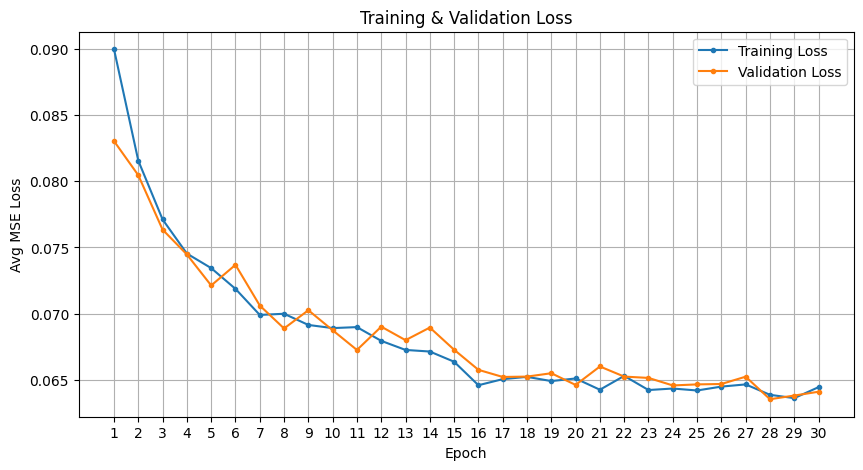


TRAINING PROCESS COMPLETE (Fashion-MNIST)
Best validation loss achieved: 0.0635
Loading best model weights ('best_diffusion_model_fashion_mnist.pth') for final samples...
Best model loaded.
Generating samples with CFG (scale=5.0)...
Could not load best model or generate final samples: name 'to_image' is not defined
Displaying final loss curves...


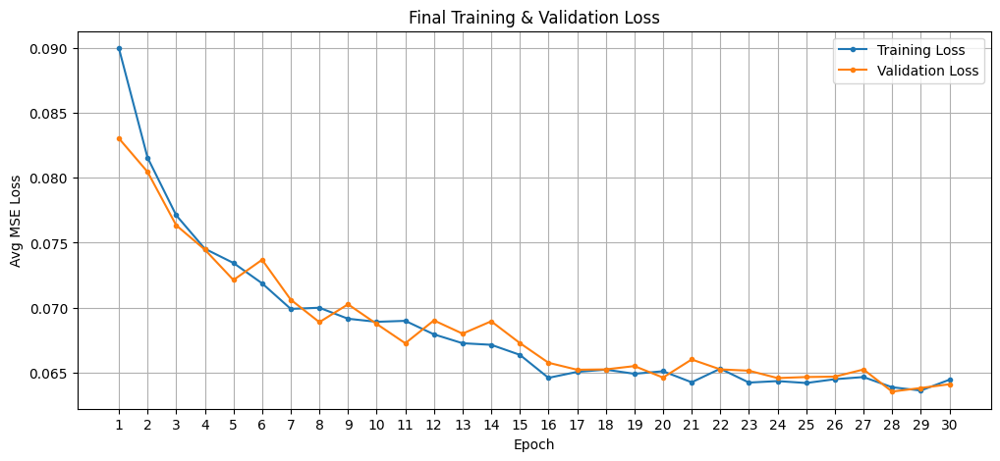

Cleaned up memory.


In [ ]:
# --- Step 8: Main Training Loop (for Fashion-MNIST) ---

# import tdqm
try:
    from tqdm.notebook import tqdm
except ImportError:
    try:
        from tqdm import tqdm
    except ImportError:
        print("Warning: tqdm not installed. Progress bars will not be shown.")
        # Define a dummy tqdm if not installed
        def tqdm(iterable, *args, **kwargs):
            return iterable

# matplotlib import for sanity - 10th time rerunning training = estra precaution
try:
    import matplotlib.pyplot as plt
except ImportError:
    print("Warning: matplotlib not imported as plt. Loss plots will not be shown.")
    plt = None # Set plt to None if not available

# check variables are instaniated
required_vars = ['model', 'EPOCHS', 'BATCH_SIZE', 'N_STEPS', 'train_load', 'val_load',
                 'device', 'N_CLASSES', 'optimizer', 'scheduler',
                 'train_step', 'calculate_val_loss', 'generate_samples', 'safe_save_model',
                 'early_stopping_patience', 'gradient_clip_value',
                 'display_frequency', 'generate_frequency']
for v in required_vars:
    if v not in locals():
        raise NameError(f"Variable '{v}' is not defined. Please ensure prerequisite cells were run successfully.")

# Progress tracking variables
best_loss = float('inf')
train_losses = []
val_losses = []
no_improve_epochs = 0

# Training loop
print("\n" + "="*50)
print("STARTING Fashion-MNIST TRAINING (with CFG, Cosine Schedule)")
print(f"Epochs: {EPOCHS}, Batch Size: {BATCH_SIZE}, Steps: {N_STEPS}")
print(f"Device: {device}")
print("="*50)

# Wrap the training loop in a try-except block
try:
    for epoch in range(EPOCHS):
        print(f"\n--- Epoch {epoch+1}/{EPOCHS} ---")

        # === Training phase ===
        model.train() # Set model to training mode
        epoch_train_losses = [] # Store losses for this epoch

        # Use tqdm for the training loader
        pbar_train = tqdm(enumerate(train_load), total=len(train_load), desc="Training", leave=False)

        for step, (images, labels) in pbar_train:
            images = images.to(device)
            labels = labels.to(device)

            # --- Training step ---
            optimizer.zero_grad() # Zero gradients before calculating loss
            loss = train_step(images, labels) # Calls the modified train_step
            loss.backward() # Perform backpropagation
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=gradient_clip_value) # Apply gradient clipping
            optimizer.step() # Update model weights
            # ---------------------

            current_loss_item = loss.item()
            epoch_train_losses.append(current_loss_item)
            pbar_train.set_postfix(Loss=f"{current_loss_item:.4f}") # Update progress bar

            # Show progress less frequently
            if (step + 1) % display_frequency == 0:
                 avg_recent_loss = sum(epoch_train_losses[-display_frequency:]) / len(epoch_train_losses[-display_frequency:])
                 print(f"  Epoch {epoch+1}, Step {step+1}/{len(train_load)}, Avg Loss (last {display_frequency}): {avg_recent_loss:.4f}")

            # Generate samples less frequently
            if (step + 1) % generate_frequency == 0 and step > 0:
                 try:
                     print(f"  Generating samples at step {step+1}...")
                     generate_samples(model, n_samples=10, cfg_scale=5.0) #CFG scale of 5.0 often works well for MNIST/Fashion
                     model.train() # Ensure model is back in train mode
                 except NameError: pass # Ignore if generate_samples not defined
                 except Exception as e: print(f"  Error during sample generation: {e}"); model.train()

        # End of training epoch
        avg_train_loss = sum(epoch_train_losses) / len(epoch_train_losses)
        train_losses.append(avg_train_loss)
        print(f"Training Finished - Epoch {epoch+1} Avg Loss: {avg_train_loss:.4f}")

        # === Validation phase ===
        model.eval()
        val_epoch_losses = []
        print("Running validation...")
        pbar_val = tqdm(val_load, desc="Validation", leave=False)
        with torch.no_grad():
            for val_images, val_labels in pbar_val:
                val_images = val_images.to(device)
                val_labels = val_labels.to(device)
                val_loss_item = calculate_val_loss(model, val_images, val_labels) # Use validation loss function
                val_epoch_losses.append(val_loss_item)
                pbar_val.set_postfix(Loss=f"{val_loss_item:.4f}")

        avg_val_loss = sum(val_epoch_losses) / len(val_epoch_losses)
        val_losses.append(avg_val_loss)
        print(f"Validation Finished - Epoch {epoch+1} Avg Loss: {avg_val_loss:.4f}")

        # === LR Scheduling, Saving, Early Stopping ===
        scheduler.step(avg_val_loss) # Update LR based on validation loss

        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            save_path = 'best_diffusion_model_fashion_mnist.pth' # Specific name for Fashion-MNIST
            try:
                 print(f"✓ New best model found! Saving to '{save_path}' (Val Loss: {best_loss:.4f})")
                 safe_save_model(model, save_path, optimizer, epoch, best_loss)
            except NameError: # Fallback if safe_save_model not defined
                 print(f"  Basic torch.save to '{save_path}'.")
                 torch.save({'epoch': epoch, 'model_state_dict': model.state_dict(), 'optimizer_state_dict': optimizer.state_dict(), 'best_loss': best_loss }, save_path)
            no_improve_epochs = 0
        else:
            no_improve_epochs += 1
            print(f"Validation loss did not improve for {no_improve_epochs}/{early_stopping_patience} epochs.")
            if no_improve_epochs >= early_stopping_patience:
                print(f"\nEarly stopping triggered after {epoch+1} epochs.")
                break # Exit loop

        # Generate samples periodically (e.g., every 5 epochs)
        if (epoch + 1) % 5 == 0 or epoch == EPOCHS - 1:
             try:
                 print(f"\nGenerating samples (Epoch {epoch+1})...")
                 generate_samples(model, n_samples=10, cfg_scale=5.0)
                 model.train()
             except NameError: pass
             except Exception as e: print(f"  Error generating samples: {e}"); model.train()

        # Plot loss curves periodically (e.g., every 5 epochs)
        if plt and ((epoch + 1) % 5 == 0 or epoch == EPOCHS - 1):
             try:
                 plt.figure(figsize=(10, 5))
                 plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss', marker='.')
                 plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss', marker='.')
                 plt.xlabel('Epoch'); plt.ylabel('Avg MSE Loss'); plt.title('Training & Validation Loss')
                 plt.legend(); plt.grid(True); plt.xticks(range(1, len(train_losses) + 1))
                 plt.show()
             except Exception as e: print(f"Error plotting losses: {e}")

# === End of Training Loop ===
except KeyboardInterrupt:
    print("\n--- Training interrupted by user ---")
except Exception as e:
    print(f"\n--- An error occurred during training: {e} ---")
    import traceback
    traceback.print_exc()

# ––– Final wrap-up ––––––––––––––––––––––––––––––––––––––––––––––––––––––––––
print("\n" + "="*50)
print("TRAINING PROCESS COMPLETE (Fashion-MNIST)")
print("="*50)
if val_losses: # Check if validation was run at least once
    print(f"Best validation loss achieved: {best_loss:.4f}")
else:
    print("No validation epochs completed.")

# Generate final samples using the *best* model weights if saved
final_save_path = 'best_diffusion_model_fashion_mnist.pth'
try:
    print(f"Loading best model weights ('{final_save_path}') for final samples...")
    checkpoint = torch.load(final_save_path, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    print("Best model loaded.")
    generate_samples(model, n_samples=10, cfg_scale=5.0)
except FileNotFoundError:
    print(f"Best model ('{final_save_path}') not found. Generating samples from final model state (if training ran).")
    try:
        generate_samples(model, n_samples=10, cfg_scale=5.0)
    except NameError: pass
    except Exception as e: print(f"Could not generate final samples: {e}")
except Exception as e:
    print(f"Could not load best model or generate final samples: {e}")

# Display final loss curves
if plt and train_losses and val_losses:
    try:
        print("Displaying final loss curves...")
        plt.figure(figsize=(12, 5))
        plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss', marker='.')
        plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss', marker='.')
        plt.xlabel('Epoch'); plt.ylabel('Avg MSE Loss'); plt.title('Final Training & Validation Loss')
        plt.legend(); plt.grid(True); plt.xticks(range(1, len(train_losses) + 1))
        plt.show()
    except Exception as e: print(f"Error plotting final losses: {e}")

# Optional: Clean up memory
try:
    import gc
    gc.collect()
    torch.cuda.empty_cache()
    print("Cleaned up memory.")
except Exception as e: pass
torch.cuda.empty_cache()

## Step 6: Generating New Images

Now that our model is trained, let's generate some new images! We can:
1. Generate specific numbers
2. Generate multiple versions of each number
3. See how the generation process works step by step

In [ ]:
# --- Define Image Un-normalization Function ---
def to_image(x):
    """
    Transforms a tensor from [-1, 1] range to [0, 1] for plotting/saving.
    Assumes input x is shape [B, C, H, W]. Clamps input first.
    """
    x = x.clamp(-1, 1) # Ensure input is within valid range
    img = (x + 1) * 0.5
    return img.clamp(0, 1) # Ensure output is valid range [0, 1]

print("Helper function 'to_image' defined.") # Optional print statement

Helper function 'to_image' defined.



Generating multiple versions of each Fashion-MNIST item class...
Generating 4 samples of item class 0 (CFG Scale: 5.0)...
Finished generating class 0.
Generating 4 samples of item class 1 (CFG Scale: 5.0)...
Finished generating class 1.
Generating 4 samples of item class 2 (CFG Scale: 5.0)...
Finished generating class 2.
Generating 4 samples of item class 3 (CFG Scale: 5.0)...
Finished generating class 3.
Generating 4 samples of item class 4 (CFG Scale: 5.0)...
Finished generating class 4.
Generating 4 samples of item class 5 (CFG Scale: 5.0)...
Finished generating class 5.
Generating 4 samples of item class 6 (CFG Scale: 5.0)...
Finished generating class 6.
Generating 4 samples of item class 7 (CFG Scale: 5.0)...
Finished generating class 7.
Generating 4 samples of item class 8 (CFG Scale: 5.0)...
Finished generating class 8.
Generating 4 samples of item class 9 (CFG Scale: 5.0)...
Finished generating class 9.


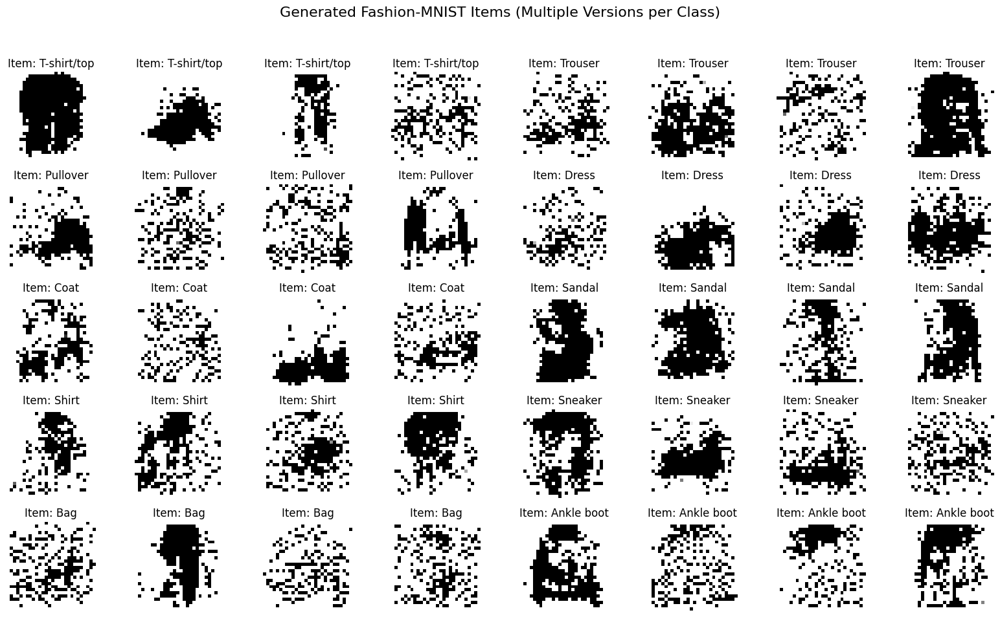


Generating items with different noise seeds...
Generating 1 samples of item class 8 (CFG Scale: 5.0)...
Finished generating class 8.
Generating 1 samples of item class 8 (CFG Scale: 5.0)...
Finished generating class 8.
Generating 1 samples of item class 8 (CFG Scale: 5.0)...
Finished generating class 8.
Generating 1 samples of item class 8 (CFG Scale: 5.0)...
Finished generating class 8.
Generating 1 samples of item class 8 (CFG Scale: 5.0)...
Finished generating class 8.


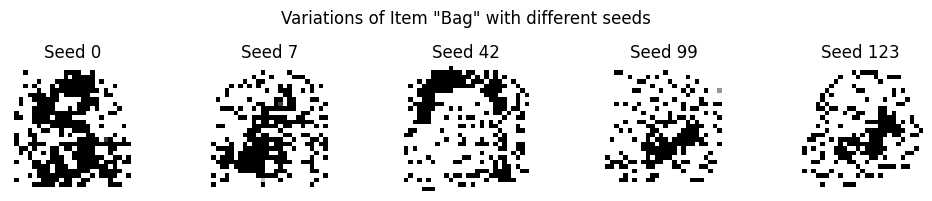

In [ ]:
# ============================================
# Step 6: Generating New Images (Revised with CFG)
# ============================================
import matplotlib.pyplot as plt # Ensure plt is imported
import torch.nn.functional as F # Ensure F is imported

# --- Define Generation Function for Specific Class with CFG ---
@torch.no_grad()
def generate_items_specific_class_cfg(model, item_class, n_samples=4, cfg_scale=5.0):
    """
    Generates multiple samples of a specific item class using CFG.
    Uses global N_STEPS, IMG_CH, IMG_SIZE, N_CLASSES, device, alpha, beta, alpha_bar, sqrt_one_minus_alpha_bar.
    """
    model.eval()
    # Start with random noise for all samples at once
    x = torch.randn(n_samples, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

    # Prepare conditioning vector (class label) for all samples
    c = torch.full((n_samples,), item_class, dtype=torch.long).to(device)
    c_one_hot = F.one_hot(c, num_classes=N_CLASSES).float()

    # Conditioning masks for CFG
    c_mask_cond = torch.ones(n_samples, dtype=torch.bool, device=device)
    c_mask_uncond = torch.zeros(n_samples, dtype=torch.bool, device=device)

    print(f"Generating {n_samples} samples of item class {item_class} (CFG Scale: {cfg_scale})...")
    # Use tqdm for progress bar if preferred
    # from tqdm.notebook import tqdm # Or standard tqdm
    # for t_val in tqdm(range(N_STEPS - 1, -1, -1), desc=f"Class {item_class}", leave=False):

    # Denoising loop
    for t_val in range(N_STEPS - 1, -1, -1):
        t_batch = torch.full((n_samples,), t_val, device=device, dtype=torch.long)

        # CFG Prediction
        eps_uncond = model(x, t_batch, c_one_hot, c_mask_uncond)
        eps_cond = model(x, t_batch, c_one_hot, c_mask_cond)
        eps = (1 + cfg_scale) * eps_cond - cfg_scale * eps_uncond

        # Denoising Step Calculation (DDPM)
        alpha_t = alpha[t_val] # Shape [] tensor, needs broadcasting
        beta_t = beta[t_val]   # Shape [] tensor
        sqrt_one_minus_alpha_bar_t = sqrt_one_minus_alpha_bar[t_val] # Shape [] tensor

        # Reshape schedule tensors for broadcasting: [1] -> [B, 1, 1, 1]
        alpha_t_rs = alpha_t.view(-1, 1, 1, 1)
        beta_t_rs = beta_t.view(-1, 1, 1, 1)
        sqrt_one_minus_alpha_bar_t_rs = sqrt_one_minus_alpha_bar_t.view(-1, 1, 1, 1)

        mean = (1 / torch.sqrt(alpha_t_rs)) * (x - (beta_t_rs / sqrt_one_minus_alpha_bar_t_rs) * eps)

        if t_val > 0:
            noise = torch.randn_like(x)
            variance = torch.sqrt(beta_t_rs) # DDPM variance
            x = mean + variance * noise
        else:
            x = mean # No noise added at the final step

    print(f"Finished generating class {item_class}.")
    return x # Return generated images in range [-1, 1]

# --- Generate and Display Multiple Versions of Each Item ---
print("\nGenerating multiple versions of each Fashion-MNIST item class...")
plt.figure(figsize=(16, 10)) # Adjusted figure size slightly
n_versions = 4 # Generate 4 versions of each

# Map class index to item name for titles (Fashion MNIST specific)
class_names = ["T-shirt/top", "Trouser", "Pullover", "Dress", "Coat",
               "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"]

for i in range(N_CLASSES): # Loop through 10 classes
    # Generate samples for current item class using the new CFG function
    # Using cfg_scale=5.0 as an example, adjust if needed
    samples = generate_items_specific_class_cfg(model, i, n_samples=n_versions, cfg_scale=5.0)

    # Un-normalize for display
    samples_display = to_image(samples) # Apply un-normalization here

    for j in range(n_versions):
        # Your template's subplot logic (adjust rows/cols if needed for n_versions)
        # This assumes n_versions=4, fitting into 8 columns, 5 rows
        plt.subplot(5, 8, i * n_versions + j + 1) # Simpler subplot indexing

        # Display the image (already un-normalized)
        if IMG_CH == 1: # Grayscale
            plt.imshow(samples_display[j, 0].cpu(), cmap='gray')
        else: # Color (won't be used for Fashion-MNIST)
            plt.imshow(samples_display[j].permute(1, 2, 0).cpu())

        plt.title(f'Item: {class_names[i]}')
        plt.axis('off')

plt.suptitle("Generated Fashion-MNIST Items (Multiple Versions per Class)", fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout
plt.show()


# --- STUDENT ACTIVITY: Generate with different seeds ---
print("\nGenerating items with different noise seeds...")

def generate_with_seed_cfg(item_class, seed_value=42, n_samples=1, cfg_scale=5.0):
    torch.manual_seed(seed_value)
    # Call the NEW CFG generation function
    return generate_items_specific_class_cfg(model, item_class, n_samples=n_samples, cfg_scale=cfg_scale)

# Pick an item class (e.g., 8 for Bag)
item_idx = 8
seed_list = [0, 7, 42, 99, 123]
plt.figure(figsize=(len(seed_list)*2, 2))

for i, seed in enumerate(seed_list):
    # Generate 1 sample with the specific seed
    sample = generate_with_seed_cfg(item_idx, seed_value=seed, n_samples=1, cfg_scale=5.0)[0]
    sample_display = to_image(sample) # Un-normalize

    plt.subplot(1, len(seed_list), i+1)
    if IMG_CH == 1:
        plt.imshow(sample_display[0].cpu(), cmap='gray')
    else:
        plt.imshow(sample_display.permute(1, 2, 0).cpu())
    plt.title(f'Seed {seed}')
    plt.axis('off')

plt.suptitle(f'Variations of Item "{class_names[item_idx]}" with different seeds')
plt.tight_layout()
plt.show()

# RUNNING ENTIRE CODE BLOCKS ON NEW NOTEBOOK FOR SAKE OF CLARITY

## Step 7: Watching the Generation Process

Let's see how our model turns random noise into clear images, step by step. This helps us understand how the diffusion process works!


Generating number 0:


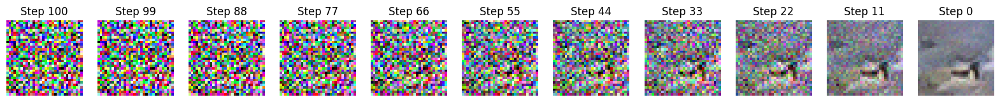


Generating number 3:


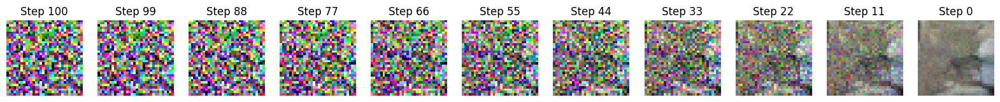


Generating number 7:


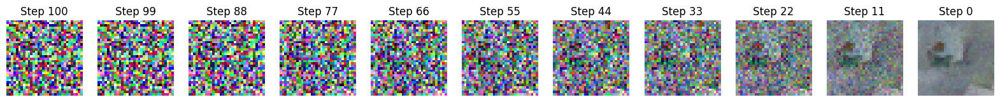

In [ ]:
def visualize_generation_steps(model, number, n_preview_steps=10):
    """
    Show how an image evolves from noise to a clear number
    """
    model.eval()
    with torch.no_grad():
        # Start with random noise
        x = torch.randn(1, IMG_CH, IMG_SIZE, IMG_SIZE).to(device)

        # Set up which number to generate
        c = torch.tensor([number]).to(device)
        c_one_hot = F.one_hot(c, N_CLASSES).float().to(device)
        # Make sure mask is [batch,1], not [batch, classes]
        c_mask = torch.ones_like(c.unsqueeze(-1)).to(device)

        # Calculate which steps to show
        steps_to_show = torch.linspace(n_steps-1, 0, n_preview_steps).long()

        # Store images for visualization
        images = []
        images.append(x[0].cpu())

        # Remove noise step by step
        for t in range(n_steps-1, -1, -1):
            t_batch = torch.full((1,), t).to(device)
            x = remove_noise(x, t_batch, model, c_one_hot, c_mask)

            if t in steps_to_show:
                images.append(x[0].cpu())

        # Show the progression
        plt.figure(figsize=(20, 3))
        for i, img in enumerate(images):
            plt.subplot(1, len(images), i+1)
            if IMG_CH == 1:
                plt.imshow(img[0], cmap='gray')
            else:
                img = img.permute(1, 2, 0)
                if img.min() < 0:
                    img = (img + 1) / 2
                plt.imshow(img)
            step = n_steps if i == 0 else steps_to_show[i-1]
            plt.title(f'Step {step}')
            plt.axis('off')
        plt.show()

# Show generation process for a few numbers
for number in [0, 3, 7]:
    print(f"\nGenerating number {number}:")
    visualize_generation_steps(model, number)

## Step 8: Adding CLIP Evaluation

[CLIP](https://openai.com/research/clip) is a powerful AI model that can understand both images and text. We'll use it to:
1. Evaluate how realistic our generated images are
2. Score how well they match their intended numbers
3. Help guide the generation process towards better quality

In [ ]:
## Step 8: Adding CLIP Evaluation

# CLIP (Contrastive Language-Image Pre-training) is a powerful model by OpenAI that connects text and images.
# We'll use it to evaluate how recognizable our generated digits are by measuring how strongly
# the CLIP model associates our generated images with text descriptions like "an image of the digit 7".

# First, we need to install CLIP and its dependencies
print("Setting up CLIP (Contrastive Language-Image Pre-training) model...")

# Track installation status
clip_available = False

try:
    # Install dependencies first - these help CLIP process text and images
    print("Installing CLIP dependencies...")
    !pip install -q ftfy regex tqdm

    # Install CLIP from GitHub
    print("Installing CLIP from GitHub repository...")
    !pip install -q git+https://github.com/openai/CLIP.git

    # Import and verify CLIP is working
    print("Importing CLIP...")
    import clip

    # Test that CLIP is functioning
    models = clip.available_models()
    print(f"✓ CLIP installation successful! Available models: {models}")
    clip_available = True

except ImportError:
    print("❌ Error importing CLIP. Installation might have failed.")
    print("Try manually running: !pip install git+https://github.com/openai/CLIP.git")
    print("If you're in a Colab notebook, try restarting the runtime after installation.")

except Exception as e:
    print(f"❌ Error during CLIP setup: {e}")
    print("Some CLIP functionality may not work correctly.")

# Provide guidance based on installation result
if clip_available:
    print("\nCLIP is now available for evaluating your generated images!")
else:
    print("\nWARNING: CLIP installation failed. We'll skip the CLIP evaluation parts.")

# Import necessary libraries
import functools
import torch.nn.functional as F


 Below we are createing  a helper function to manage GPU memory when using CLIP. CLIP can be memory-intensive, so this will help prevent out-of-memory errors:

In [ ]:
# Memory management decorator to prevent GPU OOM errors
def manage_gpu_memory(func):
    """
    Decorator that ensures proper GPU memory management.

    This wraps functions that might use large amounts of GPU memory,
    making sure memory is properly freed after function execution.
    """
    @functools.wraps(func)
    def wrapper(*args, **kwargs):
        if torch.cuda.is_available():
            # Clear cache before running function
            torch.cuda.empty_cache()
            try:
                return func(*args, **kwargs)
            finally:
                # Clear cache after running function regardless of success/failure
                torch.cuda.empty_cache()
        return func(*args, **kwargs)
    return wrapper

In [ ]:
#==============================================================================
# Step 8: CLIP Model Loading and Evaluation Setup
#==============================================================================
# CLIP (Contrastive Language-Image Pre-training) is a neural network that connects
# vision and language. It was trained on 400 million image-text pairs to understand
# the relationship between images and their descriptions.
# We use it here as an "evaluation judge" to assess our generated images.

# Load CLIP model with error handling
try:
    # Load the ViT-B/32 CLIP model (Vision Transformer-based)
    clip_model, clip_preprocess = clip.load("ViT-B/32", device=device)
    print(f"✓ Successfully loaded CLIP model: {clip_model.visual.__class__.__name__}")
except Exception as e:
    print(f"❌ Failed to load CLIP model: {e}")
    clip_available = False
    # Instead of raising an error, we'll continue with degraded functionality
    print("CLIP evaluation will be skipped. Generated images will still be displayed but without quality scores.")

def evaluate_with_clip(images, target_number, max_batch_size=16):
    """
    Use CLIP to evaluate generated images by measuring how well they match textual descriptions.

    This function acts like an "automatic critic" for our generated digits by measuring:
    1. How well they match the description of a handwritten digit
    2. How clear and well-formed they appear to be
    3. Whether they appear blurry or poorly formed

    The evaluation process works by:
    - Converting our images to a format CLIP understands
    - Creating text prompts that describe the qualities we want to measure
    - Computing similarity scores between images and these text descriptions
    - Returning normalized scores (probabilities) for each quality

    Args:
        images (torch.Tensor): Batch of generated images [batch_size, channels, height, width]
        target_number (int): The specific digit (0-9) the images should represent
        max_batch_size (int): Maximum images to process at once (prevents GPU out-of-memory errors)

    Returns:
        torch.Tensor: Similarity scores tensor of shape [batch_size, 3] with scores for:
                     [good handwritten digit, clear digit, blurry digit]
                     Each row sums to 1.0 (as probabilities)
    """
    # If CLIP isn't available, return placeholder scores
    if not clip_available:
        print("⚠️ CLIP not available. Returning default scores.")
        # Equal probabilities (0.33 for each category)
        return torch.ones(len(images), 3).to(device) / 3

    try:
        # For large batches, we process in chunks to avoid memory issues
        # This is crucial when working with big images or many samples
        if len(images) > max_batch_size:
            all_similarities = []

            # Process images in manageable chunks
            for i in range(0, len(images), max_batch_size):
                print(f"Processing CLIP batch {i//max_batch_size + 1}/{(len(images)-1)//max_batch_size + 1}")
                batch = images[i:i+max_batch_size]

                # Use context managers for efficiency and memory management:
                # - torch.no_grad(): disables gradient tracking (not needed for evaluation)
                # - torch.cuda.amp.autocast(): uses mixed precision to reduce memory usage
                with torch.no_grad(), torch.cuda.amp.autocast():
                    batch_similarities = _process_clip_batch(batch, target_number)
                    all_similarities.append(batch_similarities)

                # Explicitly free GPU memory between batches
                # This helps prevent cumulative memory buildup that could cause crashes
                torch.cuda.empty_cache()

            # Combine results from all batches into a single tensor
            return torch.cat(all_similarities, dim=0)
        else:
            # For small batches, process all at once
            with torch.no_grad(), torch.cuda.amp.autocast():
                return _process_clip_batch(images, target_number)

    except Exception as e:
        # If anything goes wrong, log the error but don't crash
        print(f"❌ Error in CLIP evaluation: {e}")
        print(f"Traceback: {traceback.format_exc()}")
        # Return default scores so the rest of the notebook can continue
        return torch.ones(len(images), 3).to(device) / 3

def _process_clip_batch(images, target_number):
    """
    Core CLIP processing function that computes similarity between images and text descriptions.

    This function handles the technical details of:
    1. Preparing relevant text prompts for evaluation
    2. Preprocessing images to CLIP's required format
    3. Extracting feature embeddings from both images and text
    4. Computing similarity scores between these embeddings

    The function includes advanced error handling for GPU memory issues,
    automatically reducing batch size if out-of-memory errors occur.

    Args:
        images (torch.Tensor): Batch of images to evaluate
        target_number (int): The digit these images should represent

    Returns:
        torch.Tensor: Normalized similarity scores between images and text descriptions
    """
    try:
        # Create text descriptions (prompts) to evaluate our generated digits
        # We check three distinct qualities:
        # 1. If it looks like a handwritten example of the target digit
        # 2. If it appears clear and well-formed
        # 3. If it appears blurry or poorly formed (negative case)
        text_inputs = torch.cat([
            clip.tokenize(f"A handwritten number {target_number}"),
            clip.tokenize(f"A clear, well-written digit {target_number}"),
            clip.tokenize(f"A blurry or unclear number")
        ]).to(device)

        # Process images for CLIP, which requires specific formatting:

        # 1. Handle different channel configurations (dataset-dependent)
        if IMG_CH == 1:
            # CLIP expects RGB images, so we repeat the grayscale channel 3 times
            # For example, MNIST/Fashion-MNIST are grayscale (1-channel)
            images_rgb = images.repeat(1, 3, 1, 1)
        else:
            # For RGB datasets like CIFAR-10/CelebA, we can use as-is
            images_rgb = images

        # 2. Normalize pixel values to [0,1] range if needed
        # Different datasets may have different normalization ranges
        if images_rgb.min() < 0:  # If normalized to [-1,1] range
            images_rgb = (images_rgb + 1) / 2  # Convert to [0,1] range

        # 3. Resize images to CLIP's expected input size (224x224 pixels)
        # CLIP was trained on this specific resolution
        resized_images = F.interpolate(images_rgb, size=(224, 224),
                                      mode='bilinear', align_corners=False)

        # Extract feature embeddings from both images and text prompts
        # These are high-dimensional vectors representing the content
        image_features = clip_model.encode_image(resized_images)
        text_features = clip_model.encode_text(text_inputs)

        # Normalize feature vectors to unit length (for cosine similarity)
        # This ensures we're measuring direction, not magnitude
        image_features = image_features / image_features.norm(dim=-1, keepdim=True)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)

        # Calculate similarity scores between image and text features
        # The matrix multiplication computes all pairwise dot products at once
        # Multiplying by 100 scales to percentage-like values before applying softmax
        similarity = (100.0 * image_features @ text_features.T).softmax(dim=-1)

        return similarity

    except RuntimeError as e:
        # Special handling for CUDA out-of-memory errors
        if "out of memory" in str(e):
            # Free GPU memory immediately
            torch.cuda.empty_cache()

            # If we're already at batch size 1, we can't reduce further
            if len(images) <= 1:
                print("❌ Out of memory even with batch size 1. Cannot process.")
                return torch.ones(len(images), 3).to(device) / 3

            # Adaptive batch size reduction - recursively try with smaller batches
            # This is an advanced technique to handle limited GPU memory gracefully
            half_size = len(images) // 2
            print(f"⚠️ Out of memory. Reducing batch size to {half_size}.")

            # Process each half separately and combine results
            # This recursive approach will keep splitting until processing succeeds
            first_half = _process_clip_batch(images[:half_size], target_number)
            second_half = _process_clip_batch(images[half_size:], target_number)

            # Combine results from both halves
            return torch.cat([first_half, second_half], dim=0)

        # For other errors, propagate upward
        raise e

#==============================================================================
# CLIP Evaluation - Generate and Analyze Sample Digits
#==============================================================================
# This section demonstrates how to use CLIP to evaluate generated digits
# We'll generate examples of all ten digits and visualize the quality scores

try:
    for number in range(10):
        print(f"\nGenerating and evaluating number {number}...")

        # Generate 4 different variations of the current digit
        samples = generate_number(model, number, n_samples=4)

        # Evaluate quality with CLIP (without tracking gradients for efficiency)
        with torch.no_grad():
            similarities = evaluate_with_clip(samples, number)

        # Create a figure to display results
        plt.figure(figsize=(15, 3))

        # Show each sample with its CLIP quality scores
        for i in range(4):
            plt.subplot(1, 4, i+1)

            # Display the image with appropriate formatting based on dataset type
            if IMG_CH == 1:  # Grayscale images (MNIST, Fashion-MNIST)
                plt.imshow(samples[i][0].cpu(), cmap='gray')
            else:  # Color images (CIFAR-10, CelebA)
                img = samples[i].permute(1, 2, 0).cpu()  # Change format for matplotlib
                if img.min() < 0:  # Handle [-1,1] normalization
                    img = (img + 1) / 2  # Convert to [0,1] range
                plt.imshow(img)

            # Extract individual quality scores for display
            # These represent how confidently CLIP associates the image with each description
            good_score = similarities[i][0].item() * 100  # Handwritten quality
            clear_score = similarities[i][1].item() * 100  # Clarity quality
            blur_score = similarities[i][2].item() * 100   # Blurriness assessment

            # Color-code the title based on highest score category:
            # - Green: if either "good handwritten" or "clear" score is highest
            # - Red: if "blurry" score is highest (poor quality)
            max_score_idx = torch.argmax(similarities[i]).item()
            title_color = 'green' if max_score_idx < 2 else 'red'

            # Show scores in the plot title
            plt.title(f'Number {number}\nGood: {good_score:.0f}%\nClear: {clear_score:.0f}%\nBlurry: {blur_score:.0f}%',
                      color=title_color)
            plt.axis('off')

        plt.tight_layout()
        plt.show()
        plt.close()  # Properly close figure to prevent memory leaks

        # Clean up GPU memory after processing each number
        # This is especially important for resource-constrained environments
        torch.cuda.empty_cache()

except Exception as e:
    # Comprehensive error handling to help students debug issues
    print(f"❌ Error in generation and evaluation loop: {e}")
    print("Detailed error information:")
    import traceback
    traceback.print_exc()

    # Clean up resources even if we encounter an error
    if torch.cuda.is_available():
        print("Clearing GPU cache...")
        torch.cuda.empty_cache()

#==============================================================================
# STUDENT ACTIVITY: Exploring CLIP Evaluation
#==============================================================================
# This section provides code templates for students to experiment with
# evaluating larger batches of generated digits using CLIP.

print("\nSTUDENT ACTIVITY:")
print("Try the code below to evaluate a larger sample of a specific digit")
print("""
# Example: Generate and evaluate 10 examples of the digit 6
# digit = 6
# samples = generate_number(model, digit, n_samples=10)
# similarities = evaluate_with_clip(samples, digit)
#
# # Calculate what percentage of samples CLIP considers "good quality"
# # (either "good handwritten" or "clear" score exceeds "blurry" score)
# good_or_clear = (similarities[:,0] + similarities[:,1] > similarities[:,2]).float().mean()
# print(f"CLIP recognized {good_or_clear.item()*100:.1f}% of the digits as good examples of {digit}")
#
# # Display a grid of samples with their quality scores
# plt.figure(figsize=(15, 8))
# for i in range(len(samples)):
#     plt.subplot(2, 5, i+1)
#     plt.imshow(samples[i][0].cpu(), cmap='gray')
#     quality = "Good" if similarities[i,0] + similarities[i,1] > similarities[i,2] else "Poor"
#     plt.title(f"Sample {i+1}: {quality}", color='green' if quality == "Good" else 'red')
#     plt.axis('off')
# plt.tight_layout()
# plt.show()
""")

## Assessment Questions

Now that you've completed the exercise, answer these questions include explanations, observations, and your analysis
Support your answers with specific examples from your experiments:

### 1. Understanding Diffusion
- Explain what happens during the forward diffusion process, using your own words and referencing the visualization examples from your notebook.

- Why do we add noise gradually instead of all at once? How does this affect the learning process?

- Look at the step-by-step visualization - at what point (approximately what percentage through the denoising process) can you first recognize the image? Does this vary by image?

### 2. Model Architecture
- Why is the U-Net architecture particularly well-suited for diffusion models? What advantages does it provide over simpler architectures?

- What are skip connections and why are they important? Explain them in relations to our model

- Describe in detail how our model is conditioned to generate specific images. How does the class conditioning mechanism work?

### 3. Training Analysis (20 points)
- What does the loss value tell of your model tell us?

- How did the quality of  your  generated images change change throughout the training process?

- Why do we need the time embedding in diffusion models? How does it help the model understand where it is in the denoising process?

### 4. CLIP Evaluation (20 points)
- What do the CLIP scores tell you about your generated images? Which  images got  the highest and lowest quality scores?

- Develop a hypothesis explaining why certain images might be easier or harder for the model to generate convincingly.

- How could CLIP scores be used to improve the diffusion model's generation process? Propose a specific technique.

### 5. Practical Applications (20 points)
- How could this type of model be useful in the real world?

- What are the limitations of our current model?

- If you were to continue developing this project, what three specific improvements would you make and why?

### Bonus Challenge (Extra 20 points)
Try one or more of these experiments:
1. If you were to continue developing this project, what three specific improvements would you make and why?

2. Modify the U-Net architecture (e.g., add more layers, increase channel dimensions) and train the model. How do these changes affect training time and generation quality?

3. CLIP-Guided Selection: Generate 10 samples of each image, use CLIP to evaluate them, and select the top 3 highest-quality examples of each. Analyze patterns in what CLIP considers "high quality."

4. tyle Conditioning: Modify the conditioning mechanism to generate multiple styles of the same digit (e.g., slanted, thick, thin). Document your approach and results.


Deliverables:
1. A PDF copy of your notebook with
    - Complete code, outputs, and generated images
    - Include all experiment results, training plots, and generated samples
    - CLIP evaluation scores of ythe images you generated
    - Answers and any interesting findings from the bonus challenges